<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Generate-Iris-data-for-model" data-toc-modified-id="Generate-Iris-data-for-model-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Generate Iris data for model</a></span></li><li><span><a href="#Define-Model" data-toc-modified-id="Define-Model-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Define Model</a></span></li><li><span><a href="#Train-model-and-write-out-Predictions" data-toc-modified-id="Train-model-and-write-out-Predictions-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Train model and write out Predictions</a></span></li><li><span><a href="#Extract-model-weight-dynamics" data-toc-modified-id="Extract-model-weight-dynamics-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Extract model weight dynamics</a></span></li><li><span><a href="#Analyze-Model-Dynamics-with-Gaussian-Process" data-toc-modified-id="Analyze-Model-Dynamics-with-Gaussian-Process-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Analyze Model Dynamics with Gaussian Process</a></span></li><li><span><a href="#Use-the-map-F-above-to-compute-the-Morse-graph" data-toc-modified-id="Use-the-map-F-above-to-compute-the-Morse-graph-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Use the map F above to compute the Morse graph</a></span></li><li><span><a href="#Compute-Retraction" data-toc-modified-id="Compute-Retraction-7"><span class="toc-item-num">7&nbsp;&nbsp;</span><b>Compute Retraction</b></a></span></li></ul></div>

# Generate Iris data for model

In [2]:
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler

iris = load_iris()
X = iris['data']
y = iris['target']
names = iris['target_names']
feature_names = iris['feature_names']

def create_train_test(X,y):
    # One hot encoding
    enc = OneHotEncoder()
    Y = enc.fit_transform(y[:, np.newaxis]).toarray()

    # Scale data to have mean 0 and variance 1 
    # which is importance for convergence of the neural network
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Split the data set into training and testing
    X_train, X_test, Y_train, Y_test = train_test_split(
        X_scaled, Y, test_size=0.5, random_state=2)
    return X_train, X_test, Y_train, Y_test

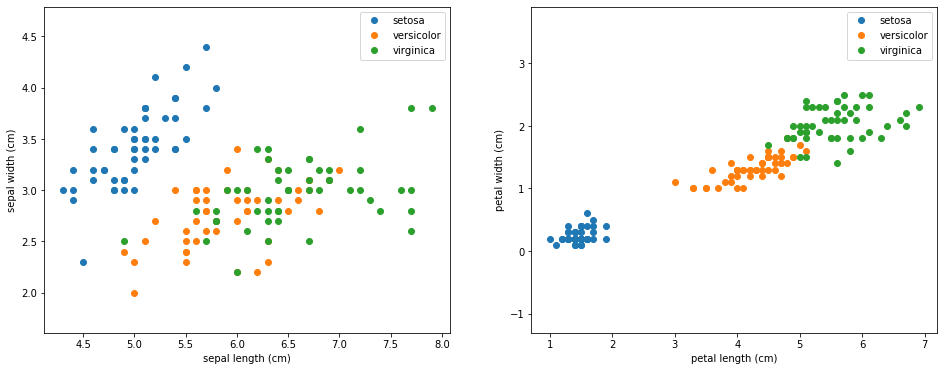

In [3]:
# Visualize the data sets
plt.figure(figsize=(16, 6))
plt.subplot(1, 2, 1)
for target, target_name in enumerate(names):
    X_plot = X[y == target]
    plt.plot(X_plot[:, 0], X_plot[:, 1], linestyle='none', marker='o', label=target_name)
plt.xlabel(feature_names[0])
plt.ylabel(feature_names[1])
plt.axis('equal')
plt.legend();

plt.subplot(1, 2, 2)
for target, target_name in enumerate(names):
    X_plot = X[y == target]
    plt.plot(X_plot[:, 2], X_plot[:, 3], linestyle='none', marker='o', label=target_name)
plt.xlabel(feature_names[2])
plt.ylabel(feature_names[3])
plt.axis('equal')
plt.legend();

# Define Model

In [4]:
# In order to ignore FutureWarning
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
from tensorflow.keras import initializers

from keras.models import Sequential
from keras.layers import Dense

X_train, X_test, Y_train, Y_test = create_train_test(X[:,[2,3]],y)

print("X",X_train.shape,X_test.shape)
print("Y",Y_train.shape,Y_test.shape)
initializer = initializers.RandomUniform(minval=-5, maxval=5, seed=None)

# define baseline model
def baseline_model(name):
    # create model
    model = Sequential(name=name)
#     model.add(Dense(2, input_dim=X_train.shape[1],activation='softmax',kernel_initializer=initializer))
    model.add(Dense(3, input_dim=X_train.shape[1],activation='softmax',kernel_initializer=initializer))
    # Compile model
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

baseline_model('model_test').summary()

X (75, 2) (75, 2)
Y (75, 3) (75, 3)
Model: "model_test"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 3)                 9         
Total params: 9
Trainable params: 9
Non-trainable params: 0
_________________________________________________________________


# Train model and write out Predictions

In [5]:
##Update this to your own path
# dirpath = '/Users/kalies/github/CMGDB/examples/'
# dirpathMC = '/Users/kalies/github/CMGDB/examples/MC/'
dirpathMC = '/Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations'
if not os.path.isdir(dirpathMC):
    os.makedirs(dirpathMC)
Y_preds = []
for i in range(500): #--> number of iterations
    name = 'model.'+str(i)
    cb_mc = tensorflow.keras.callbacks.ModelCheckpoint(os.path.join(dirpathMC,
                                         name+'-'+'{epoch:02d}-{val_loss:.2f}.hdf5'),
                            verbose=1,save_weights_only=True,)
#    cb_mc = ModelCheckpoint(os.path.join(dirpath,
#                                         name+'-'+'{epoch:02d}-{val_loss:.2f}.hdf5'),
#                            verbose=1,save_weights_only=True,)
    model = baseline_model(name)
    history_callback = model.fit(X_train, Y_train,batch_size=5,epochs=200,verbose=0,validation_data=(X_test, Y_test),callbacks=[cb_mc])
    score = model.evaluate(X_test, Y_test, verbose=0)
    Y_pred = pd.DataFrame(model.predict(X_test),columns=['p1','p2','p3'])
    Y_pred['class'] = Y_pred.idxmax(axis=1)
    Y_pred['model']=name
    Y_preds.append(Y_pred)
Y_predsDF = pd.concat(Y_preds)
Y_predsDF.to_csv(os.path.join(dirpathMC,'petal_predictions.csv'))


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-01-2.75.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-02-2.71.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-03-2.67.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-04-2.62.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-05-2.58.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-06-2.55.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-63-1.01.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-64-1.00.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-65-0.98.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-66-0.97.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-67-0.96.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-68-0.94.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-122-0.59.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-123-0.59.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-124-0.58.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-125-0.58.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-126-0.58.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-127-0.57.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-180-0.46.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-181-0.46.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-182-0.46.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-183-0.46.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-184-0.46.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.0-185-0.46.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-38-1.01.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-39-0.99.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-40-0.98.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-41-0.96.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-42-0.95.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-43-0.93.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-97-0.55.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-98-0.54.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-99-0.54.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-100-0.54.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-101-0.53.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-102-0.53.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/mod


Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-158-0.39.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-159-0.39.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-160-0.38.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-161-0.38.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-162-0.38.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.1-163-0.38.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-18-0.75.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-19-0.74.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-20-0.72.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-21-0.71.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-22-0.70.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-23-0.70.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-80-0.45.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-81-0.45.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-82-0.45.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-83-0.44.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-84-0.44.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-85-0.44.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-138-0.35.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-139-0.35.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-140-0.35.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-141-0.35.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-142-0.35.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-143-0.35.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-198-0.29.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-199-0.29.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.2-200-0.29.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-01-5.46.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-02-5.41.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-03-5.36.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/mod


Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-58-2.89.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-59-2.85.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-60-2.82.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-61-2.78.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-62-2.75.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-63-2.72.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-121-1.20.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-122-1.18.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-123-1.16.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-124-1.14.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-125-1.12.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-126-1.11.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-184-0.60.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-185-0.60.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-186-0.59.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-187-0.59.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-188-0.59.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.3-189-0.58.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-41-0.66.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-42-0.65.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-43-0.64.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-44-0.63.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-45-0.63.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-46-0.62.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-103-0.39.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-104-0.39.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-105-0.38.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-106-0.38.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-107-0.38.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-108-0.38.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-160-0.30.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-161-0.30.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-162-0.30.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-163-0.29.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-164-0.29.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.4-165-0.29.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-18-0.71.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-19-0.70.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-20-0.69.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-21-0.67.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-22-0.66.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-23-0.65.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-79-0.35.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-80-0.35.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-81-0.35.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-82-0.35.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-83-0.34.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-84-0.34.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-142-0.28.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-143-0.27.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-144-0.27.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-145-0.27.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-146-0.27.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.5-147-0.27.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-01-2.53.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-02-2.49.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-03-2.45.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-04-2.41.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-05-2.37.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-06-2.33.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-53-1.14.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-54-1.12.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-55-1.11.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-56-1.09.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-57-1.08.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-58-1.06.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-115-0.60.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-116-0.60.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-117-0.59.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-118-0.59.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-119-0.59.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-120-0.58.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-176-0.43.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-177-0.43.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-178-0.43.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-179-0.43.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-180-0.42.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.6-181-0.42.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-35-6.86.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-36-6.81.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-37-6.76.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-38-6.71.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-39-6.66.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-40-6.61.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-97-3.94.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-98-3.90.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-99-3.86.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-100-3.82.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-101-3.78.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-102-3.74.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/mod


Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-159-1.92.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-160-1.90.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-161-1.87.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-162-1.85.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-163-1.82.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.7-164-1.80.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-17-1.93.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-18-1.90.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-19-1.87.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-20-1.84.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-21-1.81.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-22-1.79.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-78-0.77.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-79-0.76.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-80-0.75.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-81-0.75.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-82-0.74.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-83-0.73.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-140-0.50.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-141-0.50.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-142-0.50.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-143-0.50.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-144-0.49.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.8-145-0.49.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-01-5.03.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-02-4.99.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-03-4.94.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-04-4.89.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-05-4.84.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-06-4.79.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-57-2.59.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-58-2.55.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-59-2.51.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-60-2.48.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-61-2.44.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-62-2.41.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.


Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-120-0.98.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-121-0.97.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-122-0.96.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-123-0.94.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-124-0.93.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-125-0.92.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-180-0.58.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-181-0.57.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-182-0.57.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-183-0.57.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-184-0.56.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.9-185-0.56.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-33-0.60.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-34-0.60.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-35-0.59.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-36-0.59.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-37-0.58.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-38-0.58.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-90-0.42.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-91-0.42.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-92-0.42.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-93-0.42.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-94-0.42.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-95-0.41.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-152-0.32.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-153-0.31.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-154-0.31.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-155-0.31.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-156-0.31.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.10-157-0.31.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-10-0.42.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-11-0.42.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-12-0.41.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-13-0.41.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-14-0.40.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-15-0.40.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-67-0.29.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-68-0.29.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-69-0.29.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-70-0.29.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-71-0.28.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-72-0.28.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-126-0.24.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-127-0.24.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-128-0.24.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-129-0.24.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-130-0.24.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-131-0.24.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-184-0.21.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-185-0.21.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-186-0.21.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-187-0.20.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-188-0.20.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.11-189-0.20.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-40-2.79.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-41-2.75.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-42-2.71.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-43-2.67.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-44-2.63.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-45-2.59.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-101-1.17.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-102-1.16.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-103-1.15.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-104-1.13.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-105-1.12.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-106-1.11.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-163-0.71.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-164-0.71.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-165-0.70.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-166-0.70.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-167-0.70.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.12-168-0.69.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-17-0.69.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-18-0.68.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-19-0.67.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-20-0.67.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-21-0.66.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-22-0.65.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-75-0.29.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-76-0.28.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-77-0.28.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-78-0.27.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-79-0.27.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-80-0.27.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-136-0.17.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-137-0.17.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-138-0.17.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-139-0.17.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-140-0.17.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-141-0.17.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-195-0.16.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-196-0.16.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-197-0.16.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-198-0.16.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-199-0.16.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.13-200-0.16.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-48-3.01.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-49-2.98.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-50-2.95.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-51-2.92.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-52-2.89.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-53-2.86.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-111-1.38.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-112-1.36.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-113-1.34.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-114-1.32.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-115-1.30.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-116-1.28.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-172-0.76.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-173-0.76.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-174-0.75.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-175-0.75.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-176-0.75.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.14-177-0.74.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-27-3.35.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-28-3.31.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-29-3.26.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-30-3.22.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-31-3.18.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-32-3.13.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-90-1.42.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-91-1.40.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-92-1.38.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-93-1.37.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-94-1.35.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-95-1.33.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-153-0.73.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-154-0.72.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-155-0.72.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-156-0.71.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-157-0.70.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.15-158-0.70.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-09-0.60.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-10-0.60.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-11-0.59.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-12-0.58.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-13-0.58.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-14-0.57.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-66-0.42.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-67-0.42.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-68-0.42.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-69-0.42.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-70-0.41.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-71-0.41.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-127-0.33.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-128-0.33.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-129-0.33.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-130-0.33.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-131-0.33.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-132-0.33.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-184-0.28.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-185-0.28.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-186-0.28.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-187-0.27.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-188-0.27.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.16-189-0.27.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-41-0.43.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-42-0.43.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-43-0.43.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-44-0.42.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-45-0.42.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-46-0.42.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-100-0.30.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-101-0.30.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-102-0.30.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-103-0.30.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-104-0.29.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-105-0.29.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-162-0.23.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-163-0.23.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-164-0.23.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-165-0.22.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-166-0.22.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.17-167-0.22.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-19-3.26.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-20-3.22.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-21-3.18.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-22-3.15.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-23-3.11.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-24-3.07.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-76-1.44.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-77-1.41.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-78-1.39.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-79-1.37.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-80-1.34.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-81-1.32.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-136-0.64.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-137-0.63.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-138-0.62.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-139-0.62.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-140-0.61.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-141-0.61.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-199-0.42.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.18-200-0.42.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-01-3.40.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-02-3.36.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-03-3.32.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-04-3.28.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteration


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-53-1.90.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-54-1.88.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-55-1.86.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-56-1.84.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-57-1.82.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-58-1.80.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-116-0.96.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-117-0.95.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-118-0.94.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-119-0.93.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-120-0.92.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-121-0.91.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-178-0.62.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-179-0.62.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-180-0.61.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-181-0.61.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-182-0.61.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.19-183-0.60.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-37-0.93.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-38-0.92.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-39-0.91.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-40-0.89.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-41-0.88.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-42-0.87.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-99-0.39.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-100-0.39.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-101-0.38.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-102-0.38.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-103-0.37.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-104-0.37.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterat


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-161-0.24.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-162-0.24.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-163-0.24.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-164-0.24.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-165-0.24.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.20-166-0.23.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-19-10.59.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-20-10.54.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-21-10.49.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-22-10.43.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-23-10.38.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-24-10.33.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-81-7.40.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-82-7.35.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-83-7.30.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-84-7.26.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-85-7.21.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-86-7.16.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-139-4.77.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-140-4.73.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-141-4.68.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-142-4.64.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-143-4.60.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.21-144-4.57.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-01-0.44.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-02-0.43.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-03-0.43.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-04-0.42.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-05-0.42.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-06-0.41.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-56-0.29.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-57-0.29.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-58-0.29.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-59-0.29.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-60-0.29.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-61-0.28.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-117-0.21.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-118-0.21.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-119-0.21.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-120-0.21.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-121-0.21.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-122-0.21.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-178-0.17.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-179-0.17.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-180-0.17.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-181-0.17.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-182-0.17.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.22-183-0.17.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-31-1.77.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-32-1.74.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-33-1.71.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-34-1.69.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-35-1.66.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-36-1.63.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-91-0.77.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-92-0.76.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-93-0.76.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-94-0.75.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-95-0.75.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-96-0.74.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-150-0.55.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-151-0.54.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-152-0.54.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-153-0.54.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-154-0.54.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.23-155-0.53.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-01-1.23.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-02-1.21.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-03-1.19.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-04-1.17.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-05-1.15.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-06-1.13.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-59-0.65.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-60-0.65.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-61-0.65.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-62-0.64.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-63-0.64.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-64-0.63.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-117-0.50.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-118-0.50.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-119-0.49.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-120-0.49.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-121-0.49.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-122-0.49.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-180-0.39.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-181-0.39.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-182-0.39.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-183-0.39.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-184-0.39.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.24-185-0.38.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-33-0.81.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-34-0.80.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-35-0.79.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-36-0.78.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-37-0.77.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-38-0.76.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-96-0.52.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-97-0.52.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-98-0.52.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-99-0.51.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-100-0.51.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-101-0.51.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteration


Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-158-0.39.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-159-0.39.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-160-0.39.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-161-0.39.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-162-0.39.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.25-163-0.38.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-10-6.60.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-11-6.55.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-12-6.49.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-13-6.44.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-14-6.39.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-15-6.34.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-73-3.60.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-74-3.56.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-75-3.52.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-76-3.49.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-77-3.44.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-78-3.41.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-134-1.71.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-135-1.69.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-136-1.67.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-137-1.65.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-138-1.62.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-139-1.60.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-194-0.81.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-195-0.80.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-196-0.79.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-197-0.79.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-198-0.78.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.26-199-0.77.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-46-0.35.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-47-0.35.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-48-0.35.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-49-0.35.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-50-0.34.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-51-0.34.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-109-0.25.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-110-0.25.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-111-0.25.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-112-0.24.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-113-0.24.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-114-0.24.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-172-0.19.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-173-0.19.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-174-0.19.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-175-0.19.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-176-0.19.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.27-177-0.19.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-28-4.73.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-29-4.68.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-30-4.64.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-31-4.59.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-32-4.54.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-33-4.49.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-91-2.15.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-92-2.12.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-93-2.09.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-94-2.06.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-95-2.03.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-96-2.00.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-154-0.83.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-155-0.82.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-156-0.81.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-157-0.80.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-158-0.80.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.28-159-0.79.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-09-0.52.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-10-0.51.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-11-0.50.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-12-0.49.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-13-0.49.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-14-0.48.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-70-0.25.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-71-0.24.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-72-0.24.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-73-0.24.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-74-0.24.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-75-0.24.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-133-0.21.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-134-0.21.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-135-0.21.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-136-0.21.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-137-0.21.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-138-0.21.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-195-0.19.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-196-0.19.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-197-0.19.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-198-0.18.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-199-0.18.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.29-200-0.18.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-53-1.15.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-54-1.14.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-55-1.13.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-56-1.11.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-57-1.10.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-58-1.09.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-116-0.71.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-117-0.70.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-118-0.70.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-119-0.70.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-120-0.69.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-121-0.69.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-178-0.53.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-179-0.53.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-180-0.53.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-181-0.52.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-182-0.52.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.30-183-0.52.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-37-1.17.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-38-1.15.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-39-1.13.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-40-1.12.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-41-1.10.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-42-1.09.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-99-0.60.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-100-0.59.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-101-0.59.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-102-0.59.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-103-0.58.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-104-0.58.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterat


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-162-0.42.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-163-0.42.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-164-0.42.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-165-0.41.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-166-0.41.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.31-167-0.41.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-19-8.79.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-20-8.74.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-21-8.69.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-22-8.65.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-23-8.60.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-24-8.55.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-82-5.93.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-83-5.89.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-84-5.84.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-85-5.80.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-86-5.75.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-87-5.71.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-145-3.28.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-146-3.24.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-147-3.20.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-148-3.17.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-149-3.13.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.32-150-3.09.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-01-0.63.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-02-0.62.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-03-0.61.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-04-0.60.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-05-0.59.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-06-0.58.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-64-0.36.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-65-0.36.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-66-0.36.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-67-0.36.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-68-0.36.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-69-0.35.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-121-0.28.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-122-0.27.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-123-0.27.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-124-0.27.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-125-0.27.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-126-0.27.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-180-0.22.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-181-0.22.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-182-0.22.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-183-0.22.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-184-0.22.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.33-185-0.22.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-35-1.25.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-36-1.22.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-37-1.20.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-38-1.18.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-39-1.16.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-40-1.13.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-94-0.52.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-95-0.52.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-96-0.51.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-97-0.51.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-98-0.50.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-99-0.50.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-156-0.35.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-157-0.35.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-158-0.35.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-159-0.35.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-160-0.34.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.34-161-0.34.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-09-2.51.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-10-2.47.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-11-2.43.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-12-2.40.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-13-2.36.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-14-2.32.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-69-1.03.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-70-1.02.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-71-1.01.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-72-1.00.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-73-0.99.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-74-0.98.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-126-0.67.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-127-0.67.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-128-0.67.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-129-0.66.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-130-0.66.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-131-0.66.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-182-0.55.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-183-0.54.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-184-0.54.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-185-0.54.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-186-0.54.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.35-187-0.54.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-36-8.76.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-37-8.72.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-38-8.68.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-39-8.63.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-40-8.59.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-41-8.54.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-93-6.28.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-94-6.23.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-95-6.19.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-96-6.15.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-97-6.10.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-98-6.06.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-150-3.87.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-151-3.83.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-152-3.79.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-153-3.75.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-154-3.71.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.36-155-3.67.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-01-5.51.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-02-5.46.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-03-5.41.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-04-5.37.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-05-5.32.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-06-5.27.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-58-2.96.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-59-2.93.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-60-2.89.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-61-2.85.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-62-2.81.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-63-2.78.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-120-1.43.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-121-1.41.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-122-1.40.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-123-1.38.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-124-1.37.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-125-1.35.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-176-0.84.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-177-0.84.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-178-0.83.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-179-0.83.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-180-0.82.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.37-181-0.81.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-33-0.40.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-34-0.40.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-35-0.39.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-36-0.39.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-37-0.39.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-38-0.39.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-90-0.29.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-91-0.29.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-92-0.29.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-93-0.28.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-94-0.28.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-95-0.28.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-146-0.22.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-147-0.22.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-148-0.22.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-149-0.22.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-150-0.22.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.38-151-0.22.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-01-6.27.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-02-6.23.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-03-6.20.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-04-6.16.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-05-6.13.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-06-6.09.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-58-4.49.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-59-4.46.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-60-4.43.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-61-4.40.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-62-4.37.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-63-4.34.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-116-2.82.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-117-2.79.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-118-2.77.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-119-2.74.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-120-2.71.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-121-2.68.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-173-1.32.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-174-1.30.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-175-1.28.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-176-1.26.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-177-1.23.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.39-178-1.22.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-24-0.40.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-25-0.39.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-26-0.38.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-27-0.38.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-28-0.37.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-29-0.37.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-88-0.23.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-89-0.23.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-90-0.23.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-91-0.23.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-92-0.23.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-93-0.22.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-145-0.20.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-146-0.20.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-147-0.20.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-148-0.20.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-149-0.20.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.40-150-0.20.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-01-4.01.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-02-3.96.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-03-3.92.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-04-3.87.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-05-3.83.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-06-3.79.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-57-1.95.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-58-1.92.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-59-1.89.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-60-1.87.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-61-1.84.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-62-1.82.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-114-0.95.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-115-0.94.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-116-0.93.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-117-0.93.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-118-0.92.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-119-0.91.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-172-0.63.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-173-0.63.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-174-0.62.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-175-0.62.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-176-0.62.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.41-177-0.61.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-28-0.45.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-29-0.45.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-30-0.45.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-31-0.45.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-32-0.45.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-33-0.44.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-91-0.37.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-92-0.37.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-93-0.36.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-94-0.36.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-95-0.36.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-96-0.36.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-154-0.31.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-155-0.31.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-156-0.31.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-157-0.31.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-158-0.31.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.42-159-0.31.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-10-2.61.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-11-2.57.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-12-2.54.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-13-2.51.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-14-2.47.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-15-2.44.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-73-1.20.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-74-1.19.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-75-1.18.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-76-1.16.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-77-1.15.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-78-1.13.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-136-0.68.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-137-0.68.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-138-0.67.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-139-0.67.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-140-0.66.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-141-0.66.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-198-0.49.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-199-0.49.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.43-200-0.48.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-01-6.92.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-02-6.89.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-03-6.86.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteratio


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-54-5.29.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-55-5.26.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-56-5.23.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-57-5.20.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-58-5.16.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-59-5.14.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-113-3.53.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-114-3.50.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-115-3.47.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-116-3.45.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-117-3.42.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-118-3.39.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-172-1.87.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-173-1.84.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-174-1.82.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-175-1.79.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-176-1.77.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.44-177-1.74.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-27-0.99.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-28-0.97.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-29-0.95.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-30-0.93.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-31-0.91.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-32-0.90.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-84-0.47.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-85-0.46.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-86-0.46.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-87-0.46.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-88-0.45.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-89-0.45.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-141-0.33.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-142-0.33.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-143-0.33.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-144-0.32.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-145-0.32.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.45-146-0.32.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-01-1.68.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-02-1.65.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-03-1.62.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-04-1.59.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-05-1.57.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-06-1.54.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-54-0.78.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-55-0.78.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-56-0.77.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-57-0.76.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-58-0.75.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-59-0.75.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-112-0.52.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-113-0.52.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-114-0.52.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-115-0.52.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-116-0.51.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-117-0.51.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-172-0.41.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-173-0.41.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-174-0.41.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-175-0.41.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-176-0.40.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.46-177-0.40.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-25-3.06.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-26-3.02.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-27-2.98.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-28-2.94.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-29-2.90.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-30-2.85.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-88-1.13.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-89-1.12.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-90-1.10.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-91-1.09.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-92-1.07.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-93-1.05.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-144-0.63.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-145-0.63.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-146-0.62.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-147-0.62.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-148-0.61.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-149-0.61.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.47-200-0.47.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-01-7.31.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-02-7.26.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-03-7.21.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-04-7.16.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-05-7.11.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-52-4.96.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-53-4.92.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-54-4.88.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-55-4.83.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-56-4.79.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-57-4.74.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-115-2.38.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-116-2.35.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-117-2.31.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-118-2.28.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-119-2.25.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-120-2.21.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-174-0.97.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-175-0.96.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-176-0.95.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-177-0.94.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-178-0.92.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.48-179-0.91.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-27-2.70.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-28-2.67.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-29-2.63.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-30-2.59.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-31-2.55.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-32-2.51.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-85-1.15.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-86-1.13.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-87-1.12.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-88-1.11.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-89-1.09.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-90-1.08.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-148-0.69.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-149-0.69.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-150-0.69.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-151-0.68.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-152-0.68.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.49-153-0.68.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-01-9.74.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-02-9.69.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-03-9.64.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-04-9.58.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-05-9.53.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-06-9.48.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-66-6.65.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-67-6.61.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-68-6.57.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-69-6.53.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-70-6.50.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-71-6.46.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-126-4.73.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-127-4.70.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-128-4.67.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-129-4.64.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-130-4.61.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-131-4.59.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-187-2.98.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-188-2.95.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-189-2.92.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-190-2.90.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-191-2.87.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.50-192-2.84.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-45-5.47.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-46-5.43.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-47-5.39.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-48-5.35.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-49-5.32.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-50-5.28.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-102-3.62.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-103-3.59.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-104-3.56.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-105-3.53.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-106-3.51.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-107-3.47.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-165-1.83.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-166-1.80.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-167-1.78.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-168-1.75.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-169-1.72.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.51-170-1.70.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-19-0.70.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-20-0.69.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-21-0.68.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-22-0.67.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-23-0.66.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-24-0.66.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-82-0.44.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-83-0.44.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-84-0.44.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-85-0.44.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-86-0.44.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-87-0.43.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-145-0.34.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-146-0.34.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-147-0.33.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-148-0.33.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-149-0.33.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.52-150-0.33.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-01-1.81.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-02-1.77.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-03-1.73.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-04-1.70.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-05-1.67.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-06-1.63.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-55-0.76.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-56-0.75.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-57-0.75.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-58-0.74.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-59-0.73.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-60-0.73.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-118-0.50.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-119-0.49.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-120-0.49.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-121-0.49.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-122-0.49.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-123-0.48.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-181-0.37.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-182-0.37.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-183-0.37.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-184-0.37.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-185-0.37.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.53-186-0.37.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-37-0.52.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-38-0.52.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-39-0.51.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-40-0.51.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-41-0.50.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-42-0.50.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-100-0.36.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-101-0.35.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-102-0.35.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-103-0.35.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-104-0.35.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-105-0.35.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-163-0.27.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-164-0.27.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-165-0.26.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-166-0.26.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-167-0.26.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.54-168-0.26.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-19-1.73.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-20-1.70.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-21-1.67.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-22-1.64.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-23-1.61.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-24-1.59.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-82-0.60.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-83-0.59.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-84-0.58.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-85-0.57.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-86-0.56.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-87-0.56.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-144-0.31.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-145-0.30.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-146-0.30.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-147-0.30.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-148-0.30.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.55-149-0.30.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-01-4.24.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-02-4.19.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-03-4.14.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-04-4.10.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-05-4.05.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-06-4.00.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-64-1.78.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-65-1.76.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-66-1.74.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-67-1.71.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-68-1.69.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-69-1.66.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-124-0.85.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-125-0.85.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-126-0.84.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-127-0.83.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-128-0.82.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-129-0.82.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-187-0.56.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-188-0.56.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-189-0.55.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-190-0.55.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-191-0.55.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.56-192-0.54.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-45-2.01.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-46-1.98.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-47-1.95.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-48-1.92.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-49-1.89.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-50-1.86.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-107-0.76.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-108-0.75.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-109-0.74.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-110-0.73.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-111-0.73.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-112-0.72.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-167-0.48.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-168-0.48.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-169-0.47.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-170-0.47.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-171-0.47.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.57-172-0.47.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-19-3.35.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-20-3.32.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-21-3.28.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-22-3.24.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-23-3.21.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-24-3.17.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-80-1.78.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-81-1.76.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-82-1.74.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-83-1.72.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-84-1.71.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-85-1.69.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-136-1.04.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-137-1.03.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-138-1.02.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-139-1.01.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-140-1.00.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-141-0.99.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-198-0.69.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-199-0.68.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.58-200-0.68.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-01-6.96.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-02-6.90.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-03-6.85.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteratio


Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-51-4.53.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-52-4.48.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-53-4.44.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-54-4.40.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-55-4.36.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-56-4.32.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-112-2.34.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-113-2.31.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-114-2.28.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-115-2.25.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-116-2.22.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-117-2.19.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-168-1.13.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-169-1.12.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-170-1.11.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-171-1.10.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-172-1.09.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.59-173-1.07.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-19-4.81.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-20-4.77.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-21-4.72.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-22-4.67.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-23-4.63.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-24-4.58.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-80-2.37.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-81-2.34.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-82-2.31.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-83-2.28.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-84-2.25.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-85-2.21.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-137-1.03.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-138-1.02.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-139-1.00.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-140-0.99.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-141-0.98.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-142-0.97.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-196-0.61.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-197-0.60.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-198-0.60.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-199-0.60.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.60-200-0.59.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-01-4.89.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterat


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-54-3.04.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-55-3.02.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-56-3.00.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-57-2.98.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-58-2.95.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-59-2.93.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-112-1.93.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-113-1.91.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-114-1.90.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-115-1.88.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-116-1.87.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-117-1.85.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-169-1.23.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-170-1.22.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-171-1.22.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-172-1.21.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-173-1.20.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.61-174-1.19.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-28-1.66.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-29-1.63.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-30-1.61.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-31-1.59.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-32-1.57.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-33-1.55.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-91-0.76.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-92-0.75.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-93-0.75.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-94-0.74.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-95-0.73.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-96-0.73.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-154-0.50.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-155-0.49.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-156-0.49.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-157-0.49.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-158-0.49.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.62-159-0.48.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-10-0.95.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-11-0.94.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-12-0.93.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-13-0.92.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-14-0.91.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-15-0.90.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-73-0.58.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-74-0.58.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-75-0.57.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-76-0.57.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-77-0.57.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-78-0.56.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-136-0.41.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-137-0.41.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-138-0.40.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-139-0.40.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-140-0.40.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-141-0.40.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-195-0.31.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-196-0.31.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-197-0.31.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-198-0.31.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-199-0.31.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.63-200-0.30.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-46-0.73.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-47-0.72.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-48-0.71.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-49-0.70.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-50-0.69.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-51-0.68.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-109-0.40.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-110-0.40.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-111-0.40.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-112-0.40.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-113-0.40.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-114-0.39.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-171-0.31.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-172-0.31.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-173-0.31.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-174-0.31.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-175-0.30.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.64-176-0.30.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-28-7.50.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-29-7.45.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-30-7.40.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-31-7.35.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-32-7.30.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-33-7.25.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-91-4.56.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-92-4.52.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-93-4.48.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-94-4.44.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-95-4.39.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-96-4.35.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-152-2.67.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-153-2.64.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-154-2.62.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-155-2.60.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-156-2.58.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.65-157-2.56.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-10-1.26.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-11-1.24.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-12-1.22.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-13-1.20.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-14-1.18.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-15-1.16.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-72-0.59.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-73-0.59.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-74-0.59.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-75-0.58.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-76-0.58.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-77-0.57.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-135-0.43.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-136-0.42.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-137-0.42.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-138-0.42.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-139-0.42.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-140-0.42.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-194-0.33.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-195-0.33.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-196-0.33.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-197-0.32.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-198-0.32.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.66-199-0.32.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-49-6.72.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-50-6.67.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-51-6.62.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-52-6.58.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-53-6.53.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-54-6.49.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-107-4.52.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-108-4.49.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-109-4.46.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-110-4.42.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-111-4.39.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-112-4.36.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-170-2.69.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-171-2.67.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-172-2.64.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-173-2.61.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-174-2.58.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.67-175-2.55.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-28-0.81.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-29-0.81.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-30-0.80.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-31-0.79.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-32-0.78.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-33-0.77.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-90-0.53.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-91-0.52.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-92-0.52.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-93-0.52.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-94-0.52.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-95-0.52.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-153-0.42.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-154-0.42.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-155-0.41.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-156-0.41.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-157-0.41.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.68-158-0.41.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-10-0.96.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-11-0.95.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-12-0.93.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-13-0.92.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-14-0.90.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-15-0.89.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-72-0.48.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-73-0.48.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-74-0.47.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-75-0.47.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-76-0.47.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-77-0.47.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-135-0.34.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-136-0.34.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-137-0.34.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-138-0.33.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-139-0.33.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-140-0.33.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-198-0.26.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-199-0.26.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.69-200-0.25.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-01-2.99.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-02-2.96.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-03-2.93.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteratio


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-55-1.76.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-56-1.74.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-57-1.72.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-58-1.71.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-59-1.69.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-60-1.67.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-116-0.94.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-117-0.93.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-118-0.92.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-119-0.91.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-120-0.91.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-121-0.90.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-179-0.65.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-180-0.65.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-181-0.65.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-182-0.65.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-183-0.64.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.70-184-0.64.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-36-6.71.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-37-6.67.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-38-6.62.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-39-6.58.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-40-6.53.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-41-6.49.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-98-3.97.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-99-3.93.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-100-3.88.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-101-3.84.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-102-3.80.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-103-3.75.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterati


Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-155-1.84.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-156-1.81.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-157-1.78.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-158-1.75.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-159-1.73.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.71-160-1.70.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-09-4.13.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-10-4.09.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-11-4.05.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-12-4.00.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-13-3.96.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-14-3.92.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-70-2.34.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-71-2.32.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-72-2.30.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-73-2.28.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-74-2.26.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-75-2.24.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-132-1.33.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-133-1.32.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-134-1.31.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-135-1.30.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-136-1.28.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-137-1.27.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-190-0.85.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-191-0.85.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-192-0.84.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-193-0.84.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-194-0.83.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.72-195-0.83.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-49-10.16.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-50-10.12.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-51-10.07.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-52-10.03.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-53-9.98.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-54-9.94.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterati


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-108-7.51.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-109-7.46.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-110-7.42.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-111-7.37.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-112-7.33.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-113-7.28.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-170-4.75.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-171-4.71.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-172-4.67.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-173-4.62.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-174-4.58.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.73-175-4.54.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-28-3.84.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-29-3.80.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-30-3.77.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-31-3.73.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-32-3.70.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-33-3.66.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-91-2.26.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-92-2.24.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-93-2.22.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-94-2.21.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-95-2.19.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-96-2.17.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-152-1.34.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-153-1.33.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-154-1.32.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-155-1.31.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-156-1.30.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.74-157-1.29.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-10-2.04.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-11-2.01.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-12-1.97.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-13-1.94.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-14-1.91.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-15-1.87.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-73-0.79.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-74-0.78.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-75-0.77.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-76-0.76.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-77-0.75.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-78-0.75.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-136-0.50.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-137-0.50.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-138-0.49.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-139-0.49.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-140-0.49.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-141-0.49.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-195-0.39.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-196-0.39.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-197-0.38.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-198-0.38.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-199-0.38.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.75-200-0.38.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-54-2.70.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-55-2.67.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-56-2.64.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-57-2.60.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-58-2.57.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-59-2.54.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-117-1.31.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-118-1.30.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-119-1.28.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-120-1.27.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-121-1.25.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-122-1.24.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-173-0.77.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-174-0.76.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-175-0.76.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-176-0.75.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-177-0.75.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.76-178-0.74.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-28-0.40.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-29-0.40.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-30-0.39.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-31-0.39.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-32-0.39.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-33-0.39.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-89-0.32.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-90-0.32.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-91-0.32.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-92-0.31.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-93-0.31.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-94-0.31.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-146-0.27.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-147-0.27.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-148-0.27.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-149-0.27.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-150-0.27.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.77-151-0.27.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-01-2.13.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-02-2.10.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-03-2.07.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-04-2.04.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-05-2.01.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-06-1.98.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-60-0.76.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-61-0.75.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-62-0.74.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-63-0.73.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-64-0.72.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-65-0.71.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-122-0.40.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-123-0.40.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-124-0.40.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-125-0.39.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-126-0.39.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-127-0.39.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-185-0.30.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-186-0.29.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-187-0.29.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-188-0.29.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-189-0.29.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.78-190-0.29.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-37-0.43.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-38-0.42.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-39-0.42.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-40-0.42.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-41-0.42.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-42-0.41.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-100-0.30.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-101-0.30.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-102-0.30.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-103-0.30.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-104-0.29.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-105-0.29.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-163-0.23.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-164-0.23.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-165-0.23.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-166-0.23.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-167-0.23.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.79-168-0.23.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-19-1.74.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-20-1.71.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-21-1.69.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-22-1.66.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-23-1.64.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-24-1.62.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-81-0.90.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-82-0.90.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-83-0.89.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-84-0.89.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-85-0.88.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-86-0.87.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-144-0.65.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-145-0.64.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-146-0.64.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-147-0.64.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-148-0.64.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.80-149-0.63.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-01-5.31.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-02-5.26.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-03-5.21.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-04-5.17.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-05-5.12.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-06-5.07.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-63-2.61.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-64-2.57.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-65-2.53.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-66-2.50.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-67-2.46.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-68-2.43.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-126-1.13.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-127-1.11.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-128-1.10.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-129-1.09.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-130-1.08.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-131-1.07.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-189-0.67.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-190-0.66.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-191-0.66.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-192-0.66.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-193-0.65.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.81-194-0.65.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-46-0.29.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-47-0.28.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-48-0.28.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-49-0.28.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-50-0.27.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-51-0.27.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-107-0.21.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-108-0.21.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-109-0.21.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-110-0.21.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-111-0.21.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-112-0.21.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-169-0.19.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-170-0.19.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-171-0.19.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-172-0.18.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-173-0.18.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.82-174-0.18.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-28-4.38.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-29-4.34.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-30-4.29.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-31-4.25.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-32-4.20.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-33-4.16.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-91-1.93.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-92-1.91.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-93-1.88.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-94-1.85.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-95-1.83.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-96-1.81.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-153-0.90.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-154-0.89.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-155-0.88.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-156-0.87.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-157-0.86.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.83-158-0.86.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-10-5.09.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-11-5.06.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-12-5.02.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-13-4.98.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-14-4.94.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-15-4.90.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-73-2.99.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-74-2.96.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-75-2.93.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-76-2.90.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-77-2.87.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-78-2.84.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-136-1.27.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-137-1.25.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-138-1.23.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-139-1.21.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-140-1.19.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-141-1.17.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-199-0.55.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.84-200-0.54.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-01-1.08.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-02-1.05.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-03-1.03.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-04-1.01.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteration


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-54-0.53.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-55-0.52.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-56-0.52.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-57-0.52.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-58-0.51.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-59-0.51.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-117-0.38.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-118-0.38.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-119-0.38.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-120-0.38.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-121-0.37.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-122-0.37.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-179-0.30.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-180-0.29.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-181-0.29.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-182-0.29.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-183-0.29.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.85-184-0.29.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-33-1.60.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-34-1.58.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-35-1.55.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-36-1.52.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-37-1.50.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-38-1.47.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-94-0.70.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-95-0.69.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-96-0.69.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-97-0.68.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-98-0.68.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-99-0.67.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-157-0.48.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-158-0.48.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-159-0.48.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-160-0.47.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-161-0.47.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.86-162-0.47.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-09-1.15.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-10-1.13.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-11-1.11.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-12-1.10.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-13-1.08.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-14-1.06.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-71-0.54.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-72-0.54.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-73-0.53.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-74-0.53.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-75-0.53.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-76-0.52.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-129-0.38.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-130-0.38.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-131-0.38.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-132-0.37.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-133-0.37.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-134-0.37.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-191-0.28.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-192-0.28.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-193-0.28.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-194-0.27.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-195-0.27.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.87-196-0.27.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-46-0.69.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-47-0.69.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-48-0.68.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-49-0.67.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-50-0.67.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-51-0.66.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-109-0.47.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-110-0.47.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-111-0.47.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-112-0.47.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-113-0.46.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-114-0.46.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-172-0.36.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-173-0.36.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-174-0.36.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-175-0.35.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-176-0.35.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.88-177-0.35.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-27-0.33.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-28-0.33.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-29-0.33.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-30-0.32.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-31-0.32.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-32-0.32.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-86-0.26.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-87-0.26.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-88-0.26.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-89-0.26.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-90-0.26.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-91-0.26.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-147-0.22.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-148-0.22.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-149-0.22.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-150-0.22.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-151-0.22.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.89-152-0.21.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-01-3.11.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-02-3.07.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-03-3.03.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-04-2.98.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-05-2.94.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-06-2.90.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-63-1.21.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-64-1.19.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-65-1.17.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-66-1.15.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-67-1.14.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-68-1.12.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-126-0.65.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-127-0.64.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-128-0.64.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-129-0.63.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-130-0.63.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-131-0.63.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-189-0.49.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-190-0.49.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-191-0.49.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-192-0.49.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-193-0.49.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.90-194-0.49.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-44-0.41.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-45-0.41.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-46-0.41.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-47-0.41.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-48-0.40.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-49-0.40.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-106-0.34.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-107-0.34.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-108-0.34.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-109-0.34.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-110-0.34.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-111-0.34.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-166-0.30.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-167-0.30.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-168-0.30.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-169-0.30.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-170-0.30.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.91-171-0.30.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-20-8.40.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-21-8.36.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-22-8.32.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-23-8.29.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-24-8.25.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-25-8.21.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-81-6.43.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-82-6.40.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-83-6.37.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-84-6.34.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-85-6.31.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-86-6.28.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-143-4.60.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-144-4.57.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-145-4.54.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-146-4.51.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-147-4.48.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-148-4.45.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-199-2.98.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.92-200-2.95.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-01-6.20.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-02-6.14.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-03-6.09.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-04-6.04.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteration


Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-56-3.71.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-57-3.67.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-58-3.63.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-59-3.60.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-60-3.56.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-61-3.52.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-113-1.90.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-114-1.87.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-115-1.85.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-116-1.83.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-117-1.80.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-118-1.78.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-169-1.05.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-170-1.04.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-171-1.03.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-172-1.02.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-173-1.01.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.93-174-1.01.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-23-0.47.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-24-0.46.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-25-0.45.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-26-0.44.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-27-0.44.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-28-0.43.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-82-0.23.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-83-0.23.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-84-0.23.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-85-0.23.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-86-0.23.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-87-0.23.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-144-0.19.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-145-0.19.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-146-0.19.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-147-0.19.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-148-0.19.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-149-0.19.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.94-200-0.16.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-01-2.34.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-02-2.30.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-03-2.26.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-04-2.22.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-05-2.18.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-52-1.01.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-53-1.00.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-54-0.98.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-55-0.97.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-56-0.96.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-57-0.95.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-111-0.57.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-112-0.57.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-113-0.56.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-114-0.56.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-115-0.56.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-116-0.55.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-168-0.42.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-169-0.42.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-170-0.42.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-171-0.42.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-172-0.42.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.95-173-0.42.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-19-0.75.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-20-0.74.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-21-0.73.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-22-0.72.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-23-0.71.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-24-0.70.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-82-0.43.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-83-0.43.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-84-0.43.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-85-0.42.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-86-0.42.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-87-0.42.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-138-0.32.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-139-0.32.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-140-0.32.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-141-0.32.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-142-0.32.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-143-0.32.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-198-0.25.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-199-0.25.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.96-200-0.25.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-01-0.75.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-02-0.74.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-03-0.73.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iteratio


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-54-0.48.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-55-0.48.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-56-0.47.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-57-0.47.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-58-0.47.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-59-0.46.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-117-0.34.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-118-0.34.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-119-0.34.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-120-0.33.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-121-0.33.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-122-0.33.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-179-0.26.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-180-0.26.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-181-0.25.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-182-0.25.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-183-0.25.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.97-184-0.25.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-37-6.76.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-38-6.71.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-39-6.66.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-40-6.61.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-41-6.55.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-42-6.50.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-98-3.97.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-99-3.94.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-100-3.90.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-101-3.86.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-102-3.82.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-103-3.79.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterati


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-160-1.99.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-161-1.96.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-162-1.94.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-163-1.91.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-164-1.88.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.98-165-1.86.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-19-7.33.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-20-7.28.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-21-7.23.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-22-7.17.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-23-7.12.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-24-7.07.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-80-4.37.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-81-4.32.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-82-4.28.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-83-4.23.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-84-4.19.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-85-4.14.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/


Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-139-2.16.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-140-2.13.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-141-2.10.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-142-2.08.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-143-2.05.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-144-2.02.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-198-0.89.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-199-0.87.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.99-200-0.86.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-01-1.97.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-02-1.95.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-03-1.92.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-53-1.06.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-54-1.05.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-55-1.04.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-56-1.02.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-57-1.01.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-58-1.00.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-113-0.64.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-114-0.63.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-115-0.63.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-116-0.62.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-117-0.62.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-118-0.62.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-171-0.45.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-172-0.45.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-173-0.45.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-174-0.45.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-175-0.44.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.100-176-0.44.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-25-2.65.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-26-2.62.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-27-2.59.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-28-2.56.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-29-2.53.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-30-2.49.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-86-1.06.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-87-1.04.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-88-1.03.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-89-1.01.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-90-0.99.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-91-0.98.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-145-0.53.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-146-0.52.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-147-0.52.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-148-0.52.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-149-0.51.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.101-150-0.51.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-01-0.42.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-02-0.42.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-03-0.41.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-04-0.41.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-05-0.41.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-06-0.40.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-61-0.31.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-62-0.31.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-63-0.31.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-64-0.31.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-65-0.31.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-66-0.31.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-121-0.26.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-122-0.26.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-123-0.26.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-124-0.25.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-125-0.25.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-126-0.25.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-181-0.22.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-182-0.22.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-183-0.22.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-184-0.22.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-185-0.22.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.102-186-0.22.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-34-4.24.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-35-4.19.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-36-4.14.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-37-4.10.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-38-4.06.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-39-4.01.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-95-1.86.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-96-1.83.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-97-1.80.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-98-1.78.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-99-1.75.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-100-1.73.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-153-0.90.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-154-0.89.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-155-0.88.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-156-0.87.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-157-0.86.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.103-158-0.86.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-09-1.12.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-10-1.10.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-11-1.09.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-12-1.07.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-13-1.06.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-14-1.04.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-67-0.52.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-68-0.51.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-69-0.51.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-70-0.50.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-71-0.49.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-72-0.49.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-130-0.20.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-131-0.20.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-132-0.20.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-133-0.20.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-134-0.19.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-135-0.19.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-191-0.14.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-192-0.14.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-193-0.14.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-194-0.14.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-195-0.14.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.104-196-0.14.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-43-1.75.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-44-1.73.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-45-1.70.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-46-1.67.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-47-1.65.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-48-1.62.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-105-0.71.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-106-0.70.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-107-0.70.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-108-0.69.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-109-0.68.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-110-0.68.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-164-0.49.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-165-0.49.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-166-0.48.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-167-0.48.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-168-0.48.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.105-169-0.48.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-19-0.41.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-20-0.41.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-21-0.41.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-22-0.40.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-23-0.40.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-24-0.40.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-82-0.28.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-83-0.28.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-84-0.28.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-85-0.28.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-86-0.27.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-87-0.27.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-143-0.20.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-144-0.20.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-145-0.20.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-146-0.20.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-147-0.20.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.106-148-0.20.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-01-0.53.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-02-0.52.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-03-0.51.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-04-0.50.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-05-0.50.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-06-0.49.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-52-0.28.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-53-0.28.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-54-0.28.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-55-0.28.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-56-0.28.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-57-0.28.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-114-0.22.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-115-0.22.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-116-0.22.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-117-0.22.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-118-0.22.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-119-0.22.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-177-0.18.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-178-0.18.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-179-0.18.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-180-0.18.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-181-0.18.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.107-182-0.18.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-35-1.33.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-36-1.31.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-37-1.30.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-38-1.29.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-39-1.28.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-40-1.27.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-94-0.93.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-95-0.93.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-96-0.93.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-97-0.92.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-98-0.92.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-99-0.92.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-154-0.75.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-155-0.75.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-156-0.74.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-157-0.74.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-158-0.74.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.108-159-0.74.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-10-7.24.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-11-7.19.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-12-7.14.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-13-7.09.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-14-7.04.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-15-6.99.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-70-4.32.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-71-4.28.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-72-4.24.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-73-4.19.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-74-4.15.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-75-4.11.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-133-2.14.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-134-2.11.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-135-2.09.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-136-2.06.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-137-2.03.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-138-2.01.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-195-0.85.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-196-0.84.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-197-0.82.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-198-0.81.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-199-0.80.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.109-200-0.79.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-50-2.74.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-51-2.71.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-52-2.69.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-53-2.66.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-54-2.63.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-55-2.61.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-112-1.46.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-113-1.44.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-114-1.43.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-115-1.41.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-116-1.39.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-117-1.38.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-175-0.82.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-176-0.81.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-177-0.80.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-178-0.80.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-179-0.79.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.110-180-0.79.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-28-5.01.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-29-4.97.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-30-4.92.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-31-4.88.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-32-4.83.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-33-4.79.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-91-2.34.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-92-2.30.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-93-2.27.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-94-2.23.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-95-2.20.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-96-2.16.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-154-0.94.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-155-0.93.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-156-0.92.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-157-0.91.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-158-0.90.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.111-159-0.89.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-09-1.45.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-10-1.43.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-11-1.42.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-12-1.40.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-13-1.39.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-14-1.37.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-71-0.93.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-72-0.93.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-73-0.93.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-74-0.92.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-75-0.92.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-76-0.91.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-134-0.70.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-135-0.70.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-136-0.70.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-137-0.69.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-138-0.69.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-139-0.69.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-197-0.55.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-198-0.54.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-199-0.54.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.112-200-0.54.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-01-0.93.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-02-0.92.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-54-0.59.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-55-0.58.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-56-0.58.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-57-0.57.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-58-0.57.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-59-0.57.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-116-0.41.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-117-0.41.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-118-0.41.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-119-0.41.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-120-0.41.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-121-0.40.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-179-0.31.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-180-0.31.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-181-0.31.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-182-0.30.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-183-0.30.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.113-184-0.30.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-36-0.83.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-37-0.81.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-38-0.80.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-39-0.79.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-40-0.78.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-41-0.77.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-97-0.50.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-98-0.50.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-99-0.49.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-100-0.49.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-101-0.49.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-102-0.49.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-158-0.39.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-159-0.39.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-160-0.39.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-161-0.39.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-162-0.39.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.114-163-0.39.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-09-3.41.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-10-3.37.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-11-3.34.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-12-3.31.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-13-3.27.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-14-3.24.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-72-1.48.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-73-1.45.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-74-1.43.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-75-1.41.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-76-1.38.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-77-1.36.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-135-0.60.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-136-0.59.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-137-0.58.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-138-0.58.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-139-0.57.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-140-0.56.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-197-0.32.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-198-0.32.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-199-0.32.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.115-200-0.31.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-01-0.50.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-02-0.50.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-52-0.36.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-53-0.36.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-54-0.36.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-55-0.35.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-56-0.35.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-57-0.35.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-115-0.26.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-116-0.26.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-117-0.26.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-118-0.26.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-119-0.25.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-120-0.25.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-171-0.21.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-172-0.21.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-173-0.21.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-174-0.20.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-175-0.20.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.116-176-0.20.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-26-1.46.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-27-1.44.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-28-1.42.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-29-1.40.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-30-1.38.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-31-1.36.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-88-0.68.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-89-0.68.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-90-0.67.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-91-0.67.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-92-0.66.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-93-0.66.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-151-0.47.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-152-0.47.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-153-0.46.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-154-0.46.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-155-0.46.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.117-156-0.46.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-08-2.53.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-09-2.49.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-10-2.45.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-11-2.41.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-12-2.38.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-13-2.34.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-67-1.08.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-68-1.07.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-69-1.05.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-70-1.04.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-71-1.03.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-72-1.02.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-124-0.68.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-125-0.68.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-126-0.68.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-127-0.67.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-128-0.67.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-129-0.67.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-181-0.52.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-182-0.51.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-183-0.51.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-184-0.51.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-185-0.51.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.118-186-0.50.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-33-0.44.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-34-0.44.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-35-0.44.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-36-0.43.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-37-0.43.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-38-0.43.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-90-0.32.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-91-0.32.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-92-0.32.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-93-0.32.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-94-0.32.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-95-0.31.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-152-0.25.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-153-0.25.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-154-0.25.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-155-0.25.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-156-0.25.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.119-157-0.25.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-09-0.69.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-10-0.68.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-11-0.67.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-12-0.67.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-13-0.66.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-14-0.65.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-67-0.30.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-68-0.29.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-69-0.29.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-70-0.28.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-71-0.28.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-72-0.27.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-124-0.17.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-125-0.17.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-126-0.17.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-127-0.16.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-128-0.16.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-129-0.16.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-184-0.15.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-185-0.15.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-186-0.15.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-187-0.15.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-188-0.15.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.120-189-0.15.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-36-7.82.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-37-7.77.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-38-7.73.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-39-7.69.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-40-7.64.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-41-7.60.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-94-5.59.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-95-5.56.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-96-5.52.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-97-5.49.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-98-5.46.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-99-5.42.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-154-3.67.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-155-3.64.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-156-3.61.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-157-3.58.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-158-3.55.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.121-159-3.52.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-09-3.23.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-10-3.20.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-11-3.17.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-12-3.13.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-13-3.11.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-14-3.08.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-69-1.49.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-70-1.47.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-71-1.44.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-72-1.42.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-73-1.39.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-74-1.37.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-132-0.57.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-133-0.57.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-134-0.56.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-135-0.55.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-136-0.55.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-137-0.54.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-193-0.36.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-194-0.35.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-195-0.35.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-196-0.35.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-197-0.35.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.122-198-0.35.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-46-0.30.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-47-0.30.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-48-0.29.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-49-0.29.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-50-0.29.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-51-0.29.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-109-0.23.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-110-0.23.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-111-0.23.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-112-0.23.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-113-0.23.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-114-0.23.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-171-0.20.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-172-0.20.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-173-0.20.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-174-0.20.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-175-0.19.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.123-176-0.19.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-28-1.15.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-29-1.14.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-30-1.12.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-31-1.11.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-32-1.10.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-33-1.09.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-90-0.75.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-91-0.75.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-92-0.74.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-93-0.74.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-94-0.74.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-95-0.73.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-152-0.60.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-153-0.59.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-154-0.59.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-155-0.59.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-156-0.59.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.124-157-0.59.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-10-6.97.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-11-6.92.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-12-6.87.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-13-6.82.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-14-6.76.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-15-6.72.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-72-4.07.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-73-4.03.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-74-3.99.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-75-3.95.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-76-3.91.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-77-3.87.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-135-1.94.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-136-1.91.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-137-1.88.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-138-1.85.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-139-1.83.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-140-1.80.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-198-0.77.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-199-0.77.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.125-200-0.76.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-01-4.44.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-02-4.40.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-03-4.37.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-55-2.72.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-56-2.69.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-57-2.66.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-58-2.63.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-59-2.60.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-60-2.57.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-118-1.08.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-119-1.06.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-120-1.04.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-121-1.02.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-122-1.01.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-123-0.99.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-181-0.48.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-182-0.47.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-183-0.47.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-184-0.46.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-185-0.46.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.126-186-0.46.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-32-0.62.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-33-0.61.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-34-0.61.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-35-0.60.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-36-0.60.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-37-0.59.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-93-0.44.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-94-0.43.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-95-0.43.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-96-0.43.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-97-0.43.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-98-0.43.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-155-0.35.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-156-0.35.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-157-0.34.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-158-0.34.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-159-0.34.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.127-160-0.34.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-09-7.97.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-10-7.92.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-11-7.87.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-12-7.82.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-13-7.77.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-14-7.72.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-69-5.20.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-70-5.16.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-71-5.12.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-72-5.08.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-73-5.05.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-74-5.01.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-132-3.21.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-133-3.18.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-134-3.16.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-135-3.13.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-136-3.10.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-137-3.07.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-193-1.54.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-194-1.51.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-195-1.49.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-196-1.47.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-197-1.44.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.128-198-1.42.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-45-0.48.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-46-0.48.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-47-0.48.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-48-0.47.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-49-0.47.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-50-0.47.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-104-0.39.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-105-0.39.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-106-0.39.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-107-0.39.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-108-0.38.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-109-0.38.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-167-0.33.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-168-0.33.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-169-0.32.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-170-0.32.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-171-0.32.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.129-172-0.32.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-18-1.46.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-19-1.43.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-20-1.41.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-21-1.38.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-22-1.36.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-23-1.34.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-81-0.60.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-82-0.60.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-83-0.59.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-84-0.59.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-85-0.58.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-86-0.57.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-143-0.40.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-144-0.39.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-145-0.39.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-146-0.39.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-147-0.39.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-148-0.39.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-199-0.32.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.130-200-0.31.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-01-1.83.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-02-1.80.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-03-1.77.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-04-1.75.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-56-0.87.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-57-0.86.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-58-0.85.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-59-0.84.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-60-0.83.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-61-0.83.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-116-0.54.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-117-0.54.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-118-0.54.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-119-0.53.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-120-0.53.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-121-0.53.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-177-0.39.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-178-0.39.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-179-0.39.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-180-0.38.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-181-0.38.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.131-182-0.38.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-33-1.11.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-34-1.10.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-35-1.09.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-36-1.08.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-37-1.07.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-38-1.06.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-89-0.75.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-90-0.75.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-91-0.74.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-92-0.74.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-93-0.74.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-94-0.73.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-147-0.57.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-148-0.57.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-149-0.57.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-150-0.56.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-151-0.56.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.132-152-0.56.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-01-1.67.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-02-1.64.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-03-1.60.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-04-1.57.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-05-1.54.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-06-1.50.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-61-0.65.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-62-0.64.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-63-0.64.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-64-0.63.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-65-0.62.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-66-0.62.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-121-0.45.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-122-0.45.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-123-0.45.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-124-0.44.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-125-0.44.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-126-0.44.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-179-0.36.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-180-0.36.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-181-0.36.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-182-0.35.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-183-0.35.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.133-184-0.35.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-34-0.90.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-35-0.89.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-36-0.88.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-37-0.87.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-38-0.87.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-39-0.86.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-92-0.63.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-93-0.63.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-94-0.62.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-95-0.62.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-96-0.62.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-97-0.62.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-154-0.52.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-155-0.52.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-156-0.52.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-157-0.52.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-158-0.51.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.134-159-0.51.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-09-4.26.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-10-4.22.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-11-4.19.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-12-4.16.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-13-4.12.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-14-4.09.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-71-2.34.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-72-2.31.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-73-2.28.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-74-2.25.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-75-2.22.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-76-2.19.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-130-0.94.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-131-0.93.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-132-0.91.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-133-0.90.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-134-0.88.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-135-0.87.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-188-0.46.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-189-0.45.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-190-0.45.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-191-0.45.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-192-0.44.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.135-193-0.44.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-44-0.58.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-45-0.57.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-46-0.57.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-47-0.56.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-48-0.56.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-49-0.55.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-105-0.38.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-106-0.38.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-107-0.38.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-108-0.38.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-109-0.37.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-110-0.37.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-167-0.27.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-168-0.27.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-169-0.27.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-170-0.27.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-171-0.27.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.136-172-0.27.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-18-8.18.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-19-8.13.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-20-8.09.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-21-8.04.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-22-8.00.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-23-7.95.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-75-5.62.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-76-5.57.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-77-5.53.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-78-5.48.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-79-5.44.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-80-5.39.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-133-3.09.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-134-3.04.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-135-3.00.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-136-2.96.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-137-2.92.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-138-2.88.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-194-1.21.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-195-1.19.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-196-1.17.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-197-1.15.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-198-1.14.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.137-199-1.12.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-49-1.91.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-50-1.89.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-51-1.88.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-52-1.86.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-53-1.84.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-54-1.82.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-108-1.10.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-109-1.09.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-110-1.08.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-111-1.07.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-112-1.06.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-113-1.05.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-169-0.72.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-170-0.71.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-171-0.71.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-172-0.70.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-173-0.70.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.138-174-0.70.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-25-0.59.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-26-0.59.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-27-0.58.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-28-0.58.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-29-0.58.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-30-0.57.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-84-0.44.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-85-0.44.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-86-0.44.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-87-0.43.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-88-0.43.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-89-0.43.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-144-0.35.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-145-0.35.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-146-0.35.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-147-0.35.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-148-0.35.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.139-149-0.35.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-01-2.30.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-02-2.27.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-03-2.25.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-04-2.22.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-05-2.20.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-06-2.18.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-64-1.15.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-65-1.14.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-66-1.13.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-67-1.11.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-68-1.10.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-69-1.09.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-124-0.69.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-125-0.69.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-126-0.68.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-127-0.68.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-128-0.67.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-129-0.67.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-180-0.49.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-181-0.49.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-182-0.49.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-183-0.49.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-184-0.48.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.140-185-0.48.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-36-7.84.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-37-7.79.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-38-7.73.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-39-7.68.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-40-7.63.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-41-7.58.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-99-4.80.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-100-4.75.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-101-4.71.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-102-4.67.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-103-4.63.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-104-4.59.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-162-2.57.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-163-2.54.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-164-2.51.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-165-2.48.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-166-2.45.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.141-167-2.42.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-18-0.81.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-19-0.79.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-20-0.78.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-21-0.77.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-22-0.76.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-23-0.75.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-76-0.46.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-77-0.46.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-78-0.45.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-79-0.45.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-80-0.45.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-81-0.45.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-134-0.34.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-135-0.34.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-136-0.34.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-137-0.34.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-138-0.34.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-139-0.34.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-194-0.27.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-195-0.27.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-196-0.27.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-197-0.27.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-198-0.27.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.142-199-0.27.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-45-0.34.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-46-0.34.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-47-0.34.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-48-0.34.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-49-0.34.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-50-0.34.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-108-0.27.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-109-0.27.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-110-0.27.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-111-0.27.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-112-0.27.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-113-0.26.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-169-0.23.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-170-0.23.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-171-0.23.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-172-0.22.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-173-0.22.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.143-174-0.22.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-28-7.45.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-29-7.41.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-30-7.36.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-31-7.31.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-32-7.27.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-33-7.22.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-91-4.59.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-92-4.55.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-93-4.50.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-94-4.46.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-95-4.41.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-96-4.37.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-154-2.19.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-155-2.17.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-156-2.14.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-157-2.11.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-158-2.09.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.144-159-2.06.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-09-3.17.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-10-3.13.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-11-3.08.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-12-3.04.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-13-3.00.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-14-2.96.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-72-1.29.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-73-1.28.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-74-1.26.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-75-1.25.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-76-1.23.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-77-1.22.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-133-0.74.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-134-0.74.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-135-0.73.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-136-0.73.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-137-0.72.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-138-0.72.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-196-0.53.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-197-0.53.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-198-0.53.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-199-0.52.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.145-200-0.52.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-01-12.48.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-54-9.81.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-55-9.76.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-56-9.72.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-57-9.67.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-58-9.63.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-59-9.58.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-116-7.08.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-117-7.03.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-118-6.99.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-119-6.95.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-120-6.90.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-121-6.86.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-179-4.40.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-180-4.36.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-181-4.32.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-182-4.29.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-183-4.25.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.146-184-4.21.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-35-5.40.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-36-5.35.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-37-5.30.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-38-5.25.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-39-5.21.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-40-5.16.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-97-2.69.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-98-2.66.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-99-2.62.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-100-2.59.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-101-2.55.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-102-2.52.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-160-1.05.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-161-1.03.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-162-1.02.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-163-1.00.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-164-0.99.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.147-165-0.97.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-18-1.36.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-19-1.34.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-20-1.31.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-21-1.28.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-22-1.26.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-23-1.23.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-81-0.48.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-82-0.47.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-83-0.47.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-84-0.46.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-85-0.46.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-86-0.45.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-140-0.31.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-141-0.30.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-142-0.30.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-143-0.30.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-144-0.30.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.148-145-0.30.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-01-5.51.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-02-5.46.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-03-5.41.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-04-5.37.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-05-5.32.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-06-5.27.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-54-3.20.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-55-3.17.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-56-3.13.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-57-3.10.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-58-3.06.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-59-3.03.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-116-1.64.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-117-1.62.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-118-1.61.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-119-1.59.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-120-1.57.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-121-1.55.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-179-0.88.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-180-0.87.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-181-0.86.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-182-0.86.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-183-0.85.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.149-184-0.85.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-34-1.22.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-35-1.21.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-36-1.19.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-37-1.18.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-38-1.16.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-39-1.15.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-92-0.76.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-93-0.76.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-94-0.76.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-95-0.75.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-96-0.75.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-97-0.75.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-150-0.60.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-151-0.59.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-152-0.59.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-153-0.59.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-154-0.59.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.150-155-0.58.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-01-0.60.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-02-0.59.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-03-0.58.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-04-0.57.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-05-0.56.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-06-0.55.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-63-0.34.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-64-0.34.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-65-0.34.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-66-0.33.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-67-0.33.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-68-0.33.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-126-0.26.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-127-0.26.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-128-0.26.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-129-0.26.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-130-0.26.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-131-0.26.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-189-0.22.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-190-0.21.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-191-0.21.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-192-0.21.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-193-0.21.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.151-194-0.21.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-44-0.58.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-45-0.57.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-46-0.56.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-47-0.55.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-48-0.54.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-49-0.53.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-107-0.31.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-108-0.31.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-109-0.31.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-110-0.31.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-111-0.30.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-112-0.30.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-170-0.24.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-171-0.24.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-172-0.24.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-173-0.24.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-174-0.24.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.152-175-0.24.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-27-0.79.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-28-0.78.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-29-0.77.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-30-0.76.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-31-0.75.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-32-0.74.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-84-0.48.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-85-0.48.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-86-0.48.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-87-0.47.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-88-0.47.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-89-0.47.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-145-0.35.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-146-0.35.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-147-0.35.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-148-0.34.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-149-0.34.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.153-150-0.34.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-01-6.15.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-02-6.10.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-03-6.05.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-04-6.00.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-05-5.95.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-06-5.90.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-57-3.76.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-58-3.73.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-59-3.70.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-60-3.66.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-61-3.63.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-62-3.60.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-116-2.02.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-117-2.00.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-118-1.97.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-119-1.94.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-120-1.92.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-121-1.89.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-178-0.83.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-179-0.82.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-180-0.81.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-181-0.80.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-182-0.79.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.154-183-0.78.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-37-0.36.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-38-0.35.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-39-0.35.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-40-0.34.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-41-0.34.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-42-0.34.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-100-0.25.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-101-0.24.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-102-0.24.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-103-0.24.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-104-0.24.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-105-0.24.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-162-0.22.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-163-0.22.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-164-0.22.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-165-0.22.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-166-0.22.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.155-167-0.22.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-18-1.02.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-19-1.01.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-20-0.99.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-21-0.97.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-22-0.95.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-23-0.93.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-76-0.42.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-77-0.42.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-78-0.41.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-79-0.41.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-80-0.40.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-81-0.40.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-134-0.27.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-135-0.27.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-136-0.27.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-137-0.27.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-138-0.27.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-139-0.27.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-197-0.21.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-198-0.21.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-199-0.21.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.156-200-0.21.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-01-3.18.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-02-3.13.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-55-1.37.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-56-1.35.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-57-1.33.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-58-1.31.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-59-1.29.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-60-1.27.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-117-0.74.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-118-0.74.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-119-0.73.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-120-0.73.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-121-0.72.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-122-0.72.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-179-0.56.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-180-0.55.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-181-0.55.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-182-0.55.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-183-0.55.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.157-184-0.55.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-36-0.45.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-37-0.44.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-38-0.43.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-39-0.43.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-40-0.42.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-41-0.41.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-98-0.24.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-99-0.24.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-100-0.24.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-101-0.24.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-102-0.24.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-103-0.24.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-161-0.20.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-162-0.20.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-163-0.20.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-164-0.20.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-165-0.20.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.158-166-0.20.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-19-9.56.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-20-9.50.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-21-9.45.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-22-9.40.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-23-9.34.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-24-9.29.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-82-6.39.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-83-6.34.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-84-6.29.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-85-6.25.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-86-6.20.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-87-6.16.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-143-3.84.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-144-3.80.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-145-3.77.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-146-3.73.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-147-3.69.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.159-148-3.66.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-01-3.97.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-02-3.92.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-03-3.88.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-04-3.83.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-05-3.79.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-06-3.74.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-55-2.01.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-56-1.99.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-57-1.97.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-58-1.95.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-59-1.92.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-60-1.90.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-118-1.05.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-119-1.04.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-120-1.03.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-121-1.03.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-122-1.02.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-123-1.01.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-181-0.68.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-182-0.68.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-183-0.67.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-184-0.67.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-185-0.67.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.160-186-0.66.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-37-3.10.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-38-3.07.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-39-3.04.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-40-3.01.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-41-2.98.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-42-2.95.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-93-1.80.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-94-1.78.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-95-1.76.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-96-1.74.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-97-1.72.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-98-1.70.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-154-1.02.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-155-1.01.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-156-1.01.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-157-1.00.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-158-0.99.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.161-159-0.99.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-10-4.21.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-11-4.16.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-12-4.12.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-13-4.07.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-14-4.03.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-15-3.98.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-72-1.85.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-73-1.82.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-74-1.80.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-75-1.77.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-76-1.75.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-77-1.72.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-132-0.89.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-133-0.88.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-134-0.87.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-135-0.86.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-136-0.86.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-137-0.85.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-195-0.56.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-196-0.55.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-197-0.55.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-198-0.55.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-199-0.54.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.162-200-0.54.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-46-3.08.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-47-3.05.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-48-3.01.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-49-2.97.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-50-2.94.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-51-2.90.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-109-1.30.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-110-1.28.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-111-1.27.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-112-1.25.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-113-1.23.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-114-1.21.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-172-0.65.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-173-0.65.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-174-0.64.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-175-0.64.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-176-0.63.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.163-177-0.63.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-28-0.66.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-29-0.66.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-30-0.65.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-31-0.65.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-32-0.64.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-33-0.64.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-91-0.43.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-92-0.43.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-93-0.43.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-94-0.43.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-95-0.43.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-96-0.42.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-154-0.31.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-155-0.31.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-156-0.31.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-157-0.31.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-158-0.31.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.164-159-0.31.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-10-1.55.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-11-1.52.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-12-1.49.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-13-1.47.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-14-1.45.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-15-1.42.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-71-0.74.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-72-0.73.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-73-0.73.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-74-0.72.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-75-0.72.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-76-0.71.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-134-0.50.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-135-0.50.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-136-0.50.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-137-0.49.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-138-0.49.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-139-0.49.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-197-0.38.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-198-0.38.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-199-0.37.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.165-200-0.37.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-01-5.29.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-02-5.24.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-55-3.14.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-56-3.11.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-57-3.08.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-58-3.06.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-59-3.03.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-60-3.00.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-118-1.77.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-119-1.75.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-120-1.74.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-121-1.72.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-122-1.70.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-123-1.69.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-181-1.00.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-182-0.99.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-183-0.98.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-184-0.97.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-185-0.97.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.166-186-0.96.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-35-8.64.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-36-8.59.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-37-8.54.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-38-8.49.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-39-8.44.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-40-8.39.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-94-5.76.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-95-5.71.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-96-5.67.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-97-5.62.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-98-5.58.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-99-5.53.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-157-3.20.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-158-3.17.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-159-3.13.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-160-3.10.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-161-3.07.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.167-162-3.04.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-10-3.23.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-11-3.19.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-12-3.16.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-13-3.13.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-14-3.10.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-15-3.07.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-73-1.37.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-74-1.35.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-75-1.33.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-76-1.30.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-77-1.28.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-78-1.26.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-135-0.55.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-136-0.54.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-137-0.54.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-138-0.53.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-139-0.52.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-140-0.52.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-198-0.30.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-199-0.30.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.168-200-0.29.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-01-1.55.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-02-1.52.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-03-1.49.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-53-0.63.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-54-0.62.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-55-0.62.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-56-0.61.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-57-0.60.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-58-0.60.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-116-0.42.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-117-0.42.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-118-0.41.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-119-0.41.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-120-0.41.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-121-0.41.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-179-0.33.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-180-0.33.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-181-0.33.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-182-0.32.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-183-0.32.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.169-184-0.32.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-37-4.57.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-38-4.53.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-39-4.48.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-40-4.44.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-41-4.39.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-42-4.35.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-100-2.12.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-101-2.09.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-102-2.07.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-103-2.04.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-104-2.01.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-105-1.99.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-163-1.02.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-164-1.01.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-165-1.00.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-166-0.99.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-167-0.98.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.170-168-0.97.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-18-2.33.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-19-2.29.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-20-2.25.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-21-2.22.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-22-2.18.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-23-2.14.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-81-0.94.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-82-0.93.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-83-0.92.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-84-0.91.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-85-0.91.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-86-0.90.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-144-0.64.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-145-0.63.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-146-0.63.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-147-0.63.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-148-0.63.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.171-149-0.62.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-01-2.54.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-02-2.50.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-03-2.46.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-04-2.42.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-05-2.38.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-06-2.34.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-64-0.95.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-65-0.94.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-66-0.93.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-67-0.92.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-68-0.91.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-69-0.90.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-127-0.63.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-128-0.62.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-129-0.62.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-130-0.62.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-131-0.62.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-132-0.61.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-190-0.51.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-191-0.51.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-192-0.51.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-193-0.50.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-194-0.50.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.172-195-0.50.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-46-0.29.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-47-0.29.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-48-0.29.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-49-0.29.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-50-0.29.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-51-0.29.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-109-0.23.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-110-0.23.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-111-0.23.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-112-0.23.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-113-0.23.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-114-0.23.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-172-0.19.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-173-0.19.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-174-0.19.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-175-0.19.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-176-0.19.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.173-177-0.19.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-28-5.46.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-29-5.41.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-30-5.36.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-31-5.31.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-32-5.26.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-33-5.21.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-91-2.78.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-92-2.75.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-93-2.72.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-94-2.69.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-95-2.66.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-96-2.62.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-154-1.17.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-155-1.15.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-156-1.13.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-157-1.11.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-158-1.10.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.174-159-1.08.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-10-1.65.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-11-1.62.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-12-1.59.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-13-1.56.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-14-1.53.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-15-1.50.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-73-0.67.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-74-0.67.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-75-0.66.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-76-0.66.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-77-0.65.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-78-0.65.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-136-0.46.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-137-0.46.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-138-0.46.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-139-0.46.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-140-0.45.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-141-0.45.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-199-0.36.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.175-200-0.36.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-01-1.15.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-02-1.12.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-03-1.10.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-04-1.08.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-55-0.46.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-56-0.45.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-57-0.45.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-58-0.44.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-59-0.43.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-60-0.43.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-117-0.22.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-118-0.22.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-119-0.22.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-120-0.22.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-121-0.22.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-122-0.22.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-180-0.18.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-181-0.18.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-182-0.18.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-183-0.18.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-184-0.18.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.176-185-0.18.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-37-6.96.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-38-6.91.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-39-6.87.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-40-6.82.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-41-6.78.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-42-6.73.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-100-4.19.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-101-4.14.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-102-4.10.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-103-4.06.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-104-4.01.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-105-3.97.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-163-1.87.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-164-1.84.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-165-1.81.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-166-1.78.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-167-1.76.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.177-168-1.73.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-19-0.52.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-20-0.51.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-21-0.51.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-22-0.50.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-23-0.50.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-24-0.49.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-82-0.33.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-83-0.33.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-84-0.33.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-85-0.32.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-86-0.32.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-87-0.32.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-145-0.24.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-146-0.24.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-147-0.24.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-148-0.24.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-149-0.24.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.178-150-0.24.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-01-3.08.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-02-3.05.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-03-3.01.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-04-2.97.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-05-2.93.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-06-2.90.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-62-1.28.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-63-1.26.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-64-1.24.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-65-1.22.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-66-1.20.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-67-1.18.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-125-0.54.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-126-0.53.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-127-0.53.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-128-0.52.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-129-0.52.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-130-0.51.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-188-0.36.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-189-0.36.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-190-0.36.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-191-0.36.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-192-0.35.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.179-193-0.35.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-46-3.05.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-47-3.01.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-48-2.97.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-49-2.94.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-50-2.90.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-51-2.87.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-109-1.28.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-110-1.25.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-111-1.24.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-112-1.22.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-113-1.20.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-114-1.18.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-172-0.58.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-173-0.57.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-174-0.57.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-175-0.57.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-176-0.56.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.180-177-0.56.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-28-1.11.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-29-1.09.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-30-1.07.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-31-1.06.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-32-1.04.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-33-1.03.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-91-0.56.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-92-0.56.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-93-0.55.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-94-0.55.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-95-0.55.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-96-0.54.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-154-0.40.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-155-0.40.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-156-0.40.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-157-0.39.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-158-0.39.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.181-159-0.39.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-10-0.62.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-11-0.61.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-12-0.60.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-13-0.59.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-14-0.58.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-15-0.57.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-71-0.35.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-72-0.35.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-73-0.35.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-74-0.34.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-75-0.34.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-76-0.34.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-134-0.27.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-135-0.27.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-136-0.27.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-137-0.27.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-138-0.27.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-139-0.27.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-197-0.22.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-198-0.22.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-199-0.22.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.182-200-0.22.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-01-0.85.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-02-0.83.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-55-0.36.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-56-0.35.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-57-0.35.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-58-0.35.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-59-0.34.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-60-0.34.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-118-0.25.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-119-0.25.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-120-0.25.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-121-0.25.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-122-0.25.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-123-0.25.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-178-0.21.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-179-0.21.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-180-0.20.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-181-0.20.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-182-0.20.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.183-183-0.20.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-37-0.36.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-38-0.36.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-39-0.35.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-40-0.35.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-41-0.35.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-42-0.35.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-97-0.28.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-98-0.28.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-99-0.28.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-100-0.28.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-101-0.28.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-102-0.28.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-160-0.24.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-161-0.24.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-162-0.24.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-163-0.23.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-164-0.23.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.184-165-0.23.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-19-1.47.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-20-1.45.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-21-1.42.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-22-1.40.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-23-1.38.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-24-1.36.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-82-0.74.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-83-0.74.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-84-0.73.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-85-0.73.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-86-0.72.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-87-0.72.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-145-0.54.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-146-0.53.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-147-0.53.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-148-0.53.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-149-0.53.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.185-150-0.52.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-01-4.88.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-02-4.84.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-03-4.79.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-04-4.74.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-05-4.69.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-06-4.65.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-64-2.20.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-65-2.17.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-66-2.14.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-67-2.11.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-68-2.08.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-69-2.05.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-127-0.96.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-128-0.95.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-129-0.94.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-130-0.93.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-131-0.92.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-132-0.91.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-190-0.59.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-191-0.58.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-192-0.58.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-193-0.58.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-194-0.57.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.186-195-0.57.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-46-1.14.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-47-1.12.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-48-1.11.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-49-1.09.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-50-1.08.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-51-1.06.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-109-0.64.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-110-0.64.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-111-0.63.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-112-0.63.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-113-0.63.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-114-0.62.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-172-0.47.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-173-0.47.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-174-0.47.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-175-0.46.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-176-0.46.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.187-177-0.46.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-26-10.32.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-27-10.27.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-28-10.22.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-29-10.17.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-30-10.11.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-31-10.06.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-89-7.33.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-90-7.29.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-91-7.24.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-92-7.20.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-93-7.15.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-94-7.11.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-152-4.59.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-153-4.55.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-154-4.51.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-155-4.47.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-156-4.43.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.188-157-4.39.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-10-0.81.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-11-0.80.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-12-0.79.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-13-0.78.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-14-0.76.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-15-0.75.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-73-0.47.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-74-0.47.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-75-0.47.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-76-0.47.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-77-0.46.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-78-0.46.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-136-0.35.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-137-0.34.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-138-0.34.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-139-0.34.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-140-0.34.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-141-0.34.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-199-0.26.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.189-200-0.26.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-01-1.04.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-02-1.02.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-03-1.01.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-04-0.99.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-55-0.56.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-56-0.56.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-57-0.56.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-58-0.55.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-59-0.55.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-60-0.55.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-118-0.39.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-119-0.39.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-120-0.39.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-121-0.39.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-122-0.39.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-123-0.38.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-181-0.30.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-182-0.29.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-183-0.29.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-184-0.29.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-185-0.29.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.190-186-0.29.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-36-0.63.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-37-0.63.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-38-0.62.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-39-0.61.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-40-0.61.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-41-0.60.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-99-0.41.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-100-0.41.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-101-0.40.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-102-0.40.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-103-0.40.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-104-0.40.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-162-0.31.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-163-0.31.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-164-0.31.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-165-0.31.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-166-0.31.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.191-167-0.30.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-19-1.16.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-20-1.15.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-21-1.13.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-22-1.12.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-23-1.11.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-24-1.09.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-82-0.66.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-83-0.65.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-84-0.65.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-85-0.64.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-86-0.64.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-87-0.63.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-145-0.45.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-146-0.45.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-147-0.45.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-148-0.45.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-149-0.44.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.192-150-0.44.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-01-2.46.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-02-2.43.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-03-2.40.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-04-2.37.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-05-2.34.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-06-2.31.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-62-0.89.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-63-0.88.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-64-0.86.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-65-0.85.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-66-0.83.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-67-0.82.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-125-0.42.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-126-0.41.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-127-0.41.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-128-0.41.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-129-0.41.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-130-0.40.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-186-0.30.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-187-0.30.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-188-0.29.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-189-0.29.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-190-0.29.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.193-191-0.29.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-37-3.82.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-38-3.79.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-39-3.76.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-40-3.73.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-41-3.70.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-42-3.66.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-100-2.00.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-101-1.97.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-102-1.94.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-103-1.92.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-104-1.89.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-105-1.87.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-161-0.78.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-162-0.77.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-163-0.76.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-164-0.75.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-165-0.75.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.194-166-0.74.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-19-3.40.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-20-3.36.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-21-3.32.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-22-3.28.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-23-3.23.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-24-3.19.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-81-1.40.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-82-1.38.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-83-1.36.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-84-1.34.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-85-1.32.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-86-1.30.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-144-0.72.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-145-0.71.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-146-0.71.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-147-0.70.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-148-0.70.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.195-149-0.69.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-01-10.39.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-02-10.34.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-03-10.28.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-04-10.23.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-05-10.18.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-06-10.12.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-64-7.12.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-65-7.07.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-66-7.02.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-67-6.97.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-68-6.92.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-69-6.87.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-127-4.23.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-128-4.19.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-129-4.15.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-130-4.11.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-131-4.07.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-132-4.03.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-190-2.10.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-191-2.07.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-192-2.04.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-193-2.02.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-194-1.99.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.196-195-1.96.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-45-2.07.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-46-2.05.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-47-2.03.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-48-2.01.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-49-2.00.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-50-1.98.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-108-1.24.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-109-1.23.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-110-1.22.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-111-1.21.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-112-1.20.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-113-1.19.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-170-0.84.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-171-0.83.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-172-0.83.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-173-0.82.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-174-0.82.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.197-175-0.82.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-28-2.50.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-29-2.46.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-30-2.43.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-31-2.40.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-32-2.36.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-33-2.33.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-91-0.93.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-92-0.91.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-93-0.90.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-94-0.89.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-95-0.87.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-96-0.86.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-154-0.49.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-155-0.49.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-156-0.49.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-157-0.48.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-158-0.48.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.198-159-0.48.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-10-3.16.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-11-3.11.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-12-3.07.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-13-3.03.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-14-2.99.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-15-2.94.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-72-1.22.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-73-1.20.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-74-1.19.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-75-1.17.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-76-1.15.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-77-1.13.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-135-0.61.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-136-0.60.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-137-0.60.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-138-0.59.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-139-0.59.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-140-0.59.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-197-0.45.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-198-0.45.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-199-0.45.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.199-200-0.45.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-01-0.42.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-02-0.42.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-55-0.27.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-56-0.27.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-57-0.27.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-58-0.27.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-59-0.27.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-60-0.27.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-116-0.21.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-117-0.21.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-118-0.21.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-119-0.21.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-120-0.21.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-121-0.21.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-178-0.18.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-179-0.18.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-180-0.18.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-181-0.18.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-182-0.18.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.200-183-0.18.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-37-1.61.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-38-1.58.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-39-1.56.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-40-1.53.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-41-1.50.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-42-1.48.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-100-0.59.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-101-0.59.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-102-0.58.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-103-0.57.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-104-0.57.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-105-0.56.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-163-0.36.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-164-0.35.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-165-0.35.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-166-0.35.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-167-0.35.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.201-168-0.35.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-19-5.24.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-20-5.19.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-21-5.15.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-22-5.10.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-23-5.05.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-24-5.01.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-82-2.81.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-83-2.78.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-84-2.75.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-85-2.71.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-86-2.68.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-87-2.65.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-145-1.27.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-146-1.25.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-147-1.23.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-148-1.22.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-149-1.20.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.202-150-1.19.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-01-0.53.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-02-0.53.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-03-0.52.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-04-0.52.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-05-0.51.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-06-0.51.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-60-0.37.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-61-0.37.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-62-0.37.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-63-0.37.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-64-0.37.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-65-0.37.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-122-0.30.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-123-0.30.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-124-0.30.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-125-0.30.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-126-0.30.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-127-0.30.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-185-0.25.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-186-0.25.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-187-0.25.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-188-0.25.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-189-0.25.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.203-190-0.25.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-37-3.11.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-38-3.07.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-39-3.03.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-40-2.99.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-41-2.94.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-42-2.90.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-100-1.22.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-101-1.20.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-102-1.18.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-103-1.16.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-104-1.15.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-105-1.13.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-162-0.63.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-163-0.62.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-164-0.62.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-165-0.61.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-166-0.61.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.204-167-0.61.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-17-0.36.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-18-0.36.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-19-0.35.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-20-0.35.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-21-0.34.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-22-0.34.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-80-0.25.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-81-0.25.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-82-0.25.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-83-0.25.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-84-0.25.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-85-0.25.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-143-0.20.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-144-0.20.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-145-0.20.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-146-0.20.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-147-0.20.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.205-148-0.20.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-01-2.15.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-02-2.13.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-03-2.10.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-04-2.08.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-05-2.06.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-06-2.04.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-64-1.09.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-65-1.08.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-66-1.07.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-67-1.06.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-68-1.05.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-69-1.04.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-127-0.68.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-128-0.67.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-129-0.67.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-130-0.66.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-131-0.66.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-132-0.66.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-190-0.47.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-191-0.47.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-192-0.47.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-193-0.47.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-194-0.46.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.206-195-0.46.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-46-1.18.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-47-1.17.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-48-1.15.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-49-1.14.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-50-1.13.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-51-1.12.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-109-0.69.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-110-0.69.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-111-0.68.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-112-0.68.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-113-0.67.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-114-0.67.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-172-0.47.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-173-0.47.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-174-0.47.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-175-0.47.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-176-0.46.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.207-177-0.46.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-28-1.11.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-29-1.09.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-30-1.07.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-31-1.05.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-32-1.04.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-33-1.02.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-91-0.56.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-92-0.56.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-93-0.55.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-94-0.55.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-95-0.55.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-96-0.54.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-154-0.41.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-155-0.41.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-156-0.41.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-157-0.40.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-158-0.40.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.208-159-0.40.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-10-0.71.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-11-0.70.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-12-0.70.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-13-0.69.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-14-0.69.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-15-0.68.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-73-0.48.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-74-0.48.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-75-0.48.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-76-0.47.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-77-0.47.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-78-0.47.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-135-0.35.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-136-0.35.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-137-0.35.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-138-0.35.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-139-0.35.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-140-0.34.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-198-0.27.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-199-0.27.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.209-200-0.27.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-01-5.38.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-02-5.33.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-03-5.28.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-55-2.93.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-56-2.89.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-57-2.86.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-58-2.82.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-59-2.78.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-60-2.75.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-118-1.28.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-119-1.26.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-120-1.25.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-121-1.23.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-122-1.22.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-123-1.20.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-179-0.77.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-180-0.77.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-181-0.77.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-182-0.76.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-183-0.76.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.210-184-0.75.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-36-0.54.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-37-0.53.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-38-0.53.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-39-0.52.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-40-0.52.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-41-0.51.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-99-0.37.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-100-0.37.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-101-0.37.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-102-0.37.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-103-0.36.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-104-0.36.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-162-0.29.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-163-0.29.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-164-0.29.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-165-0.28.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-166-0.28.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.211-167-0.28.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-19-1.03.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-20-1.01.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-21-0.99.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-22-0.97.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-23-0.96.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-24-0.94.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-82-0.51.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-83-0.51.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-84-0.50.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-85-0.50.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-86-0.50.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-87-0.49.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-145-0.39.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-146-0.38.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-147-0.38.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-148-0.38.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-149-0.38.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.212-150-0.38.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-01-3.84.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-02-3.80.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-03-3.75.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-04-3.70.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-05-3.65.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-06-3.61.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-64-1.44.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-65-1.42.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-66-1.39.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-67-1.37.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-68-1.35.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-69-1.32.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-127-0.65.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-128-0.65.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-129-0.65.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-130-0.64.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-131-0.64.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-132-0.63.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-190-0.47.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-191-0.46.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-192-0.46.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-193-0.46.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-194-0.46.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.213-195-0.46.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-46-6.51.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-47-6.46.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-48-6.41.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-49-6.36.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-50-6.31.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-51-6.26.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-109-3.62.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-110-3.58.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-111-3.54.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-112-3.50.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-113-3.46.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-114-3.42.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-172-1.64.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-173-1.62.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-174-1.59.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-175-1.57.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-176-1.55.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.214-177-1.52.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-28-0.44.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-29-0.44.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-30-0.43.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-31-0.43.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-32-0.43.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-33-0.42.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-90-0.31.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-91-0.31.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-92-0.31.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-93-0.30.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-94-0.30.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-95-0.30.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-153-0.24.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-154-0.24.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-155-0.24.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-156-0.24.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-157-0.24.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.215-158-0.24.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-10-6.04.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-11-5.98.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-12-5.93.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-13-5.88.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-14-5.83.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-15-5.78.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-73-3.24.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-74-3.21.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-75-3.17.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-76-3.14.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-77-3.10.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-78-3.07.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-136-1.40.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-137-1.38.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-138-1.36.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-139-1.34.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-140-1.32.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-141-1.30.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-198-0.69.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-199-0.69.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.216-200-0.68.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-01-4.40.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-02-4.35.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-03-4.31.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-55-2.19.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-56-2.16.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-57-2.12.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-58-2.09.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-59-2.06.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-60-2.03.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-118-0.88.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-119-0.87.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-120-0.86.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-121-0.85.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-122-0.85.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-123-0.84.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-181-0.58.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-182-0.58.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-183-0.58.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-184-0.58.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-185-0.57.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.217-186-0.57.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-37-0.81.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-38-0.80.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-39-0.79.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-40-0.78.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-41-0.77.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-42-0.76.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-100-0.47.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-101-0.47.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-102-0.46.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-103-0.46.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-104-0.46.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-105-0.46.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-158-0.35.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-159-0.34.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-160-0.34.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-161-0.34.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-162-0.34.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.218-163-0.34.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-10-0.69.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-11-0.67.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-12-0.66.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-13-0.65.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-14-0.64.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-15-0.63.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-70-0.32.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-71-0.32.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-72-0.32.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-73-0.32.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-74-0.32.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-75-0.31.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-130-0.26.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-131-0.26.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-132-0.26.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-133-0.26.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-134-0.26.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-135-0.26.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-192-0.22.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-193-0.22.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-194-0.22.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-195-0.22.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-196-0.22.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.219-197-0.22.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-49-6.50.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-50-6.45.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-51-6.41.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-52-6.36.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-53-6.32.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-54-6.27.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-110-3.87.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-111-3.84.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-112-3.80.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-113-3.76.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-114-3.72.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-115-3.68.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-173-1.73.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-174-1.71.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-175-1.68.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-176-1.65.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-177-1.63.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.220-178-1.60.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-28-6.30.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-29-6.25.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-30-6.21.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-31-6.16.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-32-6.11.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-33-6.07.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-91-4.00.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-92-3.97.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-93-3.94.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-94-3.91.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-95-3.88.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-96-3.85.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-153-2.23.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-154-2.20.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-155-2.17.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-156-2.14.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-157-2.12.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.221-158-2.09.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-10-5.17.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-11-5.13.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-12-5.08.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-13-5.03.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-14-4.99.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-15-4.94.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-68-2.76.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-69-2.73.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-70-2.69.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-71-2.65.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-72-2.62.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-73-2.58.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-130-1.12.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-131-1.11.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-132-1.09.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-133-1.08.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-134-1.07.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-135-1.05.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-193-0.63.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-194-0.63.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-195-0.62.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-196-0.62.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-197-0.62.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.222-198-0.61.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-46-1.32.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-47-1.30.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-48-1.27.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-49-1.25.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-50-1.22.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-51-1.20.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-109-0.51.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-110-0.50.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-111-0.50.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-112-0.49.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-113-0.49.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-114-0.48.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-172-0.32.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-173-0.32.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-174-0.31.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-175-0.31.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-176-0.31.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.223-177-0.31.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-28-1.91.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-29-1.89.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-30-1.86.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-31-1.84.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-32-1.82.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-33-1.79.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-91-0.95.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-92-0.94.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-93-0.94.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-94-0.93.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-95-0.92.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-96-0.91.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-154-0.62.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-155-0.62.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-156-0.62.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-157-0.61.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-158-0.61.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.224-159-0.61.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-10-0.57.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-11-0.57.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-12-0.56.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-13-0.55.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-14-0.54.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-15-0.54.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-73-0.35.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-74-0.35.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-75-0.35.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-76-0.34.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-77-0.34.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-78-0.34.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-136-0.26.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-137-0.26.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-138-0.25.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-139-0.25.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-140-0.25.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-141-0.25.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-196-0.21.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-197-0.21.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-198-0.20.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-199-0.20.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.225-200-0.20.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-01-2.78.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-55-1.17.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-56-1.15.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-57-1.13.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-58-1.11.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-59-1.09.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-60-1.07.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-118-0.54.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-119-0.53.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-120-0.53.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-121-0.53.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-122-0.52.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-123-0.52.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-181-0.38.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-182-0.38.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-183-0.37.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-184-0.37.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-185-0.37.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.226-186-0.37.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-37-2.64.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-38-2.61.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-39-2.57.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-40-2.54.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-41-2.51.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-42-2.47.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-100-1.22.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-101-1.21.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-102-1.20.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-103-1.19.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-104-1.18.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-105-1.17.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-161-0.78.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-162-0.77.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-163-0.77.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-164-0.77.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-165-0.76.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.227-166-0.76.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-19-6.57.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-20-6.52.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-21-6.47.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-22-6.42.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-23-6.37.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-24-6.32.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-79-3.96.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-80-3.93.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-81-3.89.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-82-3.86.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-83-3.83.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-84-3.80.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-138-2.50.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-139-2.48.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-140-2.46.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-141-2.44.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-142-2.42.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.228-143-2.40.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-01-1.49.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-02-1.46.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-03-1.44.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-04-1.42.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-05-1.39.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-06-1.37.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-55-0.73.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-56-0.72.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-57-0.71.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-58-0.70.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-59-0.69.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-60-0.68.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-115-0.31.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-116-0.31.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-117-0.30.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-118-0.30.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-119-0.29.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-120-0.29.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-178-0.15.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-179-0.15.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-180-0.15.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-181-0.15.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-182-0.14.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.229-183-0.14.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-37-0.45.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-38-0.45.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-39-0.44.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-40-0.44.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-41-0.44.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-42-0.44.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-100-0.34.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-101-0.34.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-102-0.34.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-103-0.34.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-104-0.34.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-105-0.34.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-163-0.28.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-164-0.28.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-165-0.28.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-166-0.28.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-167-0.28.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.230-168-0.28.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-19-1.23.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-20-1.21.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-21-1.20.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-22-1.18.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-23-1.16.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-24-1.14.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-82-0.59.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-83-0.58.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-84-0.58.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-85-0.58.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-86-0.57.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-87-0.57.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-145-0.40.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-146-0.40.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-147-0.40.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-148-0.40.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-149-0.40.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.231-150-0.39.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-01-6.71.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-02-6.67.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-03-6.63.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-04-6.59.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-05-6.54.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-06-6.50.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-64-4.42.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-65-4.39.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-66-4.36.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-67-4.32.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-68-4.29.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-69-4.26.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-127-2.51.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-128-2.48.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-129-2.45.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-130-2.42.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-131-2.39.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-132-2.36.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-190-0.99.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-191-0.97.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-192-0.96.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-193-0.94.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-194-0.93.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.232-195-0.92.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-46-0.36.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-47-0.36.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-48-0.36.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-49-0.35.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-50-0.35.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-51-0.35.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-108-0.27.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-109-0.27.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-110-0.27.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-111-0.26.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-112-0.26.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-113-0.26.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-171-0.21.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-172-0.21.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-173-0.21.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-174-0.21.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-175-0.20.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.233-176-0.20.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-28-0.65.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-29-0.64.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-30-0.63.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-31-0.63.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-32-0.62.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-33-0.61.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-91-0.42.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-92-0.41.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-93-0.41.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-94-0.41.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-95-0.41.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-96-0.41.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-154-0.32.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-155-0.31.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-156-0.31.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-157-0.31.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-158-0.31.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.234-159-0.31.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-10-5.07.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-11-5.03.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-12-4.99.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-13-4.95.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-14-4.90.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-15-4.86.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-73-2.41.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-74-2.38.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-75-2.34.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-76-2.31.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-77-2.27.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-78-2.23.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-135-0.96.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-136-0.95.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-137-0.94.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-138-0.92.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-139-0.91.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-140-0.90.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-198-0.57.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-199-0.57.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.235-200-0.57.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-01-8.70.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-02-8.65.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-03-8.60.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-55-6.24.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-56-6.19.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-57-6.15.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-58-6.10.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-59-6.06.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-60-6.01.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-118-3.47.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-119-3.42.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-120-3.38.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-121-3.34.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-122-3.30.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-123-3.26.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-180-1.47.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-181-1.45.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-182-1.43.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-183-1.41.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-184-1.39.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.236-185-1.37.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-37-0.60.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-38-0.59.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-39-0.58.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-40-0.58.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-41-0.57.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-42-0.56.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-100-0.22.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-101-0.22.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-102-0.22.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-103-0.21.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-104-0.21.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-105-0.21.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-163-0.15.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-164-0.15.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-165-0.15.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-166-0.15.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-167-0.15.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.237-168-0.15.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-18-5.34.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-19-5.30.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-20-5.25.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-21-5.21.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-22-5.16.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-23-5.12.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-81-2.90.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-82-2.87.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-83-2.84.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-84-2.80.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-85-2.77.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-86-2.74.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-144-1.19.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-145-1.17.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-146-1.15.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-147-1.13.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-148-1.12.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.238-149-1.10.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-01-1.46.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-02-1.43.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-03-1.40.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-04-1.37.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-05-1.35.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-06-1.32.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-61-0.52.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-62-0.51.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-63-0.51.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-64-0.50.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-65-0.49.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-66-0.49.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-124-0.32.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-125-0.32.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-126-0.32.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-127-0.32.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-128-0.32.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-129-0.31.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-187-0.26.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-188-0.26.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-189-0.26.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-190-0.26.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-191-0.26.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.239-192-0.25.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-46-0.34.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-47-0.34.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-48-0.34.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-49-0.34.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-50-0.33.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-51-0.33.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-107-0.26.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-108-0.26.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-109-0.25.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-110-0.25.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-111-0.25.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-112-0.25.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-170-0.20.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-171-0.20.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-172-0.20.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-173-0.20.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-174-0.20.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.240-175-0.20.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-28-5.00.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-29-4.97.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-30-4.93.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-31-4.90.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-32-4.87.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-33-4.84.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-88-3.18.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-89-3.15.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-90-3.12.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-91-3.09.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-92-3.07.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-93-3.03.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-151-1.44.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-152-1.42.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-153-1.39.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-154-1.37.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-155-1.35.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.241-156-1.33.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-09-2.55.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-10-2.51.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-11-2.48.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-12-2.44.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-13-2.41.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-14-2.37.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-69-0.99.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-70-0.97.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-71-0.96.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-72-0.94.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-73-0.93.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-74-0.91.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-130-0.53.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-131-0.53.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-132-0.52.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-133-0.52.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-134-0.52.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-135-0.51.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-191-0.39.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-192-0.38.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-193-0.38.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-194-0.38.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-195-0.38.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.242-196-0.38.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-46-0.29.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-47-0.29.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-48-0.29.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-49-0.29.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-50-0.29.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-51-0.29.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-109-0.23.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-110-0.23.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-111-0.23.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-112-0.23.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-113-0.23.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-114-0.23.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-170-0.19.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-171-0.19.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-172-0.19.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-173-0.19.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-174-0.19.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.243-175-0.19.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-28-7.09.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-29-7.04.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-30-7.00.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-31-6.95.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-32-6.90.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-33-6.86.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-91-4.26.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-92-4.21.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-93-4.17.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-94-4.13.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-95-4.09.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-96-4.05.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-150-2.39.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-151-2.37.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-152-2.35.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-153-2.33.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-154-2.31.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.244-155-2.28.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-01-7.68.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-02-7.63.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-03-7.57.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-04-7.52.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-05-7.47.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-06-7.42.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-58-4.83.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-59-4.79.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-60-4.74.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-61-4.70.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-62-4.66.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-63-4.61.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-117-2.54.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-118-2.51.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-119-2.48.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-120-2.45.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-121-2.41.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-122-2.38.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-180-1.00.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-181-0.99.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-182-0.97.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-183-0.96.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-184-0.95.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.245-185-0.93.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-37-0.55.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-38-0.55.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-39-0.55.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-40-0.55.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-41-0.55.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-42-0.54.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-100-0.45.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-101-0.45.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-102-0.45.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-103-0.45.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-104-0.45.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-105-0.45.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-163-0.39.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-164-0.39.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-165-0.39.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-166-0.39.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-167-0.38.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.246-168-0.38.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-19-1.69.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-20-1.66.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-21-1.64.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-22-1.62.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-23-1.59.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-24-1.57.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-82-0.87.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-83-0.87.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-84-0.86.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-85-0.86.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-86-0.85.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-87-0.84.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-145-0.60.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-146-0.60.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-147-0.60.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-148-0.59.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-149-0.59.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.247-150-0.59.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-01-1.13.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-02-1.11.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-03-1.09.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-04-1.07.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-05-1.05.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-06-1.04.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-64-0.51.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-65-0.51.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-66-0.50.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-67-0.50.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-68-0.49.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-69-0.49.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-127-0.35.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-128-0.35.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-129-0.35.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-130-0.35.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-131-0.35.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-132-0.34.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-190-0.27.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-191-0.26.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-192-0.26.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-193-0.26.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-194-0.26.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.248-195-0.26.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-46-3.47.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-47-3.43.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-48-3.39.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-49-3.35.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-50-3.31.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-51-3.28.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-109-1.55.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-110-1.53.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-111-1.50.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-112-1.48.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-113-1.46.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-114-1.43.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-172-0.65.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-173-0.64.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-174-0.64.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-175-0.63.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-176-0.63.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.249-177-0.62.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-28-5.67.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-29-5.63.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-30-5.58.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-31-5.54.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-32-5.49.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-33-5.45.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-88-3.08.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-89-3.04.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-90-3.00.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-91-2.96.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-92-2.92.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-93-2.88.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-150-1.29.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-151-1.27.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-152-1.26.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-153-1.24.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-154-1.23.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.250-155-1.21.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-01-0.48.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-02-0.48.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-03-0.47.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-04-0.47.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-05-0.46.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-06-0.46.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-64-0.34.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-65-0.34.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-66-0.33.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-67-0.33.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-68-0.33.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-69-0.33.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-127-0.28.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-128-0.28.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-129-0.28.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-130-0.28.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-131-0.28.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-132-0.28.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-190-0.25.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-191-0.25.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-192-0.25.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-193-0.25.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-194-0.25.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.251-195-0.25.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-46-2.92.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-47-2.88.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-48-2.84.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-49-2.80.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-50-2.76.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-51-2.73.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-109-1.28.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-110-1.26.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-111-1.25.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-112-1.23.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-113-1.22.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-114-1.20.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-171-0.70.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-172-0.69.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-173-0.69.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-174-0.68.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-175-0.68.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.252-176-0.67.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-28-0.44.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-29-0.44.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-30-0.44.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-31-0.43.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-32-0.43.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-33-0.43.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-91-0.31.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-92-0.31.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-93-0.31.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-94-0.30.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-95-0.30.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-96-0.30.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-154-0.24.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-155-0.24.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-156-0.23.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-157-0.23.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-158-0.23.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.253-159-0.23.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-10-0.81.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-11-0.80.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-12-0.79.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-13-0.77.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-14-0.76.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-15-0.75.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-73-0.45.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-74-0.45.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-75-0.45.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-76-0.44.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-77-0.44.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-78-0.44.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-136-0.34.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-137-0.34.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-138-0.34.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-139-0.34.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-140-0.34.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-141-0.34.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-199-0.28.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.254-200-0.28.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-01-1.16.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-02-1.13.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-03-1.11.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-04-1.08.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-54-0.45.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-55-0.44.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-56-0.43.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-57-0.43.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-58-0.42.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-59-0.42.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-117-0.27.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-118-0.27.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-119-0.27.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-120-0.27.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-121-0.27.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-122-0.27.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-180-0.22.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-181-0.22.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-182-0.22.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-183-0.22.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-184-0.22.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.255-185-0.21.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-36-0.77.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-37-0.76.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-38-0.75.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-39-0.74.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-40-0.73.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-41-0.72.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-99-0.45.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-100-0.45.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-101-0.44.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-102-0.44.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-103-0.44.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-104-0.44.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-162-0.33.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-163-0.33.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-164-0.33.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-165-0.33.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-166-0.33.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.256-167-0.33.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-19-2.32.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-20-2.29.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-21-2.25.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-22-2.22.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-23-2.18.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-24-2.15.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-82-0.92.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-83-0.91.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-84-0.90.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-85-0.89.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-86-0.88.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-87-0.87.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-145-0.57.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-146-0.57.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-147-0.57.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-148-0.56.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-149-0.56.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.257-150-0.56.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-01-4.24.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-02-4.20.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-03-4.16.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-04-4.11.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-05-4.07.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-06-4.02.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-64-1.73.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-65-1.70.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-66-1.67.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-67-1.64.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-68-1.61.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-69-1.59.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-127-0.78.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-128-0.77.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-129-0.77.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-130-0.76.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-131-0.75.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-132-0.75.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-190-0.57.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-191-0.57.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-192-0.56.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-193-0.56.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-194-0.56.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.258-195-0.56.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-46-2.51.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-47-2.48.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-48-2.44.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-49-2.40.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-50-2.37.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-51-2.33.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-109-0.97.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-110-0.96.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-111-0.95.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-112-0.94.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-113-0.93.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-114-0.91.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-172-0.57.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-173-0.57.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-174-0.56.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-175-0.56.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-176-0.56.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.259-177-0.56.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-28-0.46.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-29-0.45.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-30-0.45.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-31-0.45.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-32-0.44.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-33-0.44.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-91-0.32.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-92-0.31.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-93-0.31.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-94-0.31.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-95-0.31.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-96-0.31.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-154-0.24.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-155-0.24.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-156-0.24.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-157-0.24.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-158-0.24.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.260-159-0.24.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-10-2.40.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-11-2.37.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-12-2.34.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-13-2.31.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-14-2.29.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-15-2.26.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-73-1.12.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-74-1.10.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-75-1.09.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-76-1.08.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-77-1.06.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-78-1.05.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-136-0.64.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-137-0.63.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-138-0.63.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-139-0.63.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-140-0.62.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-141-0.62.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-198-0.45.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-199-0.45.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.261-200-0.45.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-01-4.70.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-02-4.65.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-03-4.61.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-54-2.97.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-55-2.94.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-56-2.91.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-57-2.88.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-58-2.85.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-59-2.82.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-117-1.29.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-118-1.27.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-119-1.25.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-120-1.23.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-121-1.21.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-122-1.19.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-180-0.59.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-181-0.59.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-182-0.58.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-183-0.58.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-184-0.57.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.262-185-0.57.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-37-0.37.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-38-0.36.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-39-0.36.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-40-0.36.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-41-0.36.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-42-0.36.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-100-0.30.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-101-0.30.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-102-0.30.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-103-0.30.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-104-0.30.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-105-0.30.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-162-0.26.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-163-0.26.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-164-0.26.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-165-0.26.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-166-0.26.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.263-167-0.26.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-19-3.49.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-20-3.46.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-21-3.43.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-22-3.41.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-23-3.38.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-24-3.35.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-82-2.06.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-83-2.04.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-84-2.02.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-85-2.00.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-86-1.98.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-87-1.96.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-145-1.14.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-146-1.13.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-147-1.12.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-148-1.11.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-149-1.10.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.264-150-1.09.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-01-3.45.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-02-3.40.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-03-3.36.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-04-3.31.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-05-3.27.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-06-3.23.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-55-1.50.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-56-1.48.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-57-1.46.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-58-1.44.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-59-1.42.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-60-1.39.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-118-0.80.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-119-0.79.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-120-0.79.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-121-0.78.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-122-0.78.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-123-0.77.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-181-0.59.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-182-0.59.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-183-0.59.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-184-0.59.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-185-0.58.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.265-186-0.58.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-37-0.89.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-38-0.88.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-39-0.86.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-40-0.85.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-41-0.84.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-42-0.83.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-100-0.51.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-101-0.51.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-102-0.51.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-103-0.51.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-104-0.50.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-105-0.50.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-163-0.39.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-164-0.38.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-165-0.38.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-166-0.38.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-167-0.38.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.266-168-0.38.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-19-0.75.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-20-0.74.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-21-0.73.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-22-0.72.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-23-0.72.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-24-0.71.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-81-0.47.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-82-0.47.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-83-0.47.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-84-0.47.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-85-0.46.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-86-0.46.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-139-0.36.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-140-0.35.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-141-0.35.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-142-0.35.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-143-0.35.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.267-144-0.35.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-01-1.97.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-02-1.94.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-03-1.91.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-04-1.88.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-05-1.85.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-06-1.82.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-54-0.79.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-55-0.78.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-56-0.77.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-57-0.76.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-58-0.75.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-59-0.74.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-117-0.45.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-118-0.45.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-119-0.45.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-120-0.44.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-121-0.44.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-122-0.44.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-180-0.33.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-181-0.33.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-182-0.33.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-183-0.33.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-184-0.33.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.268-185-0.33.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-37-3.58.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-38-3.55.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-39-3.53.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-40-3.50.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-41-3.47.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-42-3.44.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-100-1.81.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-101-1.78.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-102-1.75.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-103-1.73.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-104-1.70.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-105-1.67.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-161-0.69.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-162-0.68.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-163-0.68.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-164-0.67.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-165-0.66.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.269-166-0.65.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-19-3.17.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-20-3.13.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-21-3.09.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-22-3.06.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-23-3.02.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-24-2.98.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-82-1.58.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-83-1.56.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-84-1.54.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-85-1.53.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-86-1.51.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-87-1.49.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-145-0.84.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-146-0.83.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-147-0.82.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-148-0.82.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-149-0.81.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.270-150-0.81.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-01-3.79.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-02-3.74.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-03-3.70.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-04-3.65.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-05-3.61.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-06-3.56.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-64-1.51.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-65-1.49.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-66-1.46.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-67-1.44.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-68-1.42.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-69-1.39.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-127-0.71.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-128-0.70.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-129-0.70.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-130-0.69.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-131-0.69.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-132-0.68.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-190-0.52.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-191-0.52.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-192-0.52.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-193-0.51.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-194-0.51.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.271-195-0.51.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-46-1.28.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-47-1.25.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-48-1.23.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-49-1.21.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-50-1.19.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-51-1.17.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-109-0.58.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-110-0.58.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-111-0.57.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-112-0.57.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-113-0.56.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-114-0.56.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-172-0.41.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-173-0.41.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-174-0.41.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-175-0.41.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-176-0.41.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.272-177-0.41.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-28-3.75.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-29-3.72.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-30-3.69.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-31-3.66.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-32-3.63.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-33-3.60.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-89-1.98.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-90-1.95.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-91-1.92.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-92-1.89.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-93-1.87.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-94-1.84.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-152-0.74.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-153-0.73.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-154-0.72.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-155-0.71.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-156-0.70.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.273-157-0.69.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-10-3.93.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-11-3.88.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-12-3.83.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-13-3.79.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-14-3.74.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-15-3.69.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-73-1.64.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-74-1.61.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-75-1.59.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-76-1.56.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-77-1.54.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-78-1.51.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-135-0.66.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-136-0.66.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-137-0.65.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-138-0.64.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-139-0.64.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-140-0.63.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-198-0.44.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-199-0.44.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.274-200-0.44.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-01-2.07.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-02-2.03.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-03-1.99.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-55-0.87.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-56-0.86.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-57-0.85.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-58-0.84.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-59-0.83.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-60-0.82.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-114-0.58.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-115-0.57.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-116-0.57.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-117-0.57.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-118-0.57.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-119-0.56.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-177-0.47.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-178-0.46.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-179-0.46.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-180-0.46.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-181-0.46.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.275-182-0.46.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-28-1.61.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-29-1.58.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-30-1.56.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-31-1.53.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-32-1.50.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-33-1.48.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-91-0.58.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-92-0.57.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-93-0.56.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-94-0.55.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-95-0.55.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-96-0.54.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-153-0.33.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-154-0.33.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-155-0.32.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-156-0.32.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-157-0.32.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.276-158-0.32.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-10-1.45.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-11-1.43.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-12-1.40.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-13-1.37.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-14-1.35.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-15-1.32.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-73-0.55.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-74-0.55.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-75-0.54.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-76-0.54.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-77-0.54.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-78-0.53.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-136-0.38.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-137-0.38.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-138-0.38.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-139-0.38.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-140-0.37.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-141-0.37.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-199-0.30.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.277-200-0.30.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-01-1.26.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-02-1.24.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-03-1.21.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-04-1.19.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-55-0.59.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-56-0.58.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-57-0.58.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-58-0.57.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-59-0.57.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-60-0.56.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-115-0.40.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-116-0.40.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-117-0.39.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-118-0.39.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-119-0.39.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-120-0.39.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-178-0.30.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-179-0.29.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-180-0.29.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-181-0.29.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-182-0.29.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.278-183-0.29.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-35-0.89.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-36-0.87.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-37-0.86.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-38-0.85.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-39-0.84.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-40-0.83.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-98-0.50.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-99-0.50.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-100-0.50.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-101-0.50.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-102-0.49.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-103-0.49.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-161-0.38.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-162-0.38.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-163-0.38.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-164-0.38.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-165-0.38.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.279-166-0.37.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-19-2.06.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-20-2.04.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-21-2.02.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-22-1.99.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-23-1.97.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-24-1.94.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-82-0.97.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-83-0.96.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-84-0.95.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-85-0.95.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-86-0.94.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-87-0.93.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-144-0.66.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-145-0.66.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-146-0.66.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-147-0.65.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-148-0.65.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.280-149-0.65.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-01-4.23.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-02-4.19.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-03-4.16.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-04-4.13.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-05-4.10.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-06-4.07.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-64-2.36.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-65-2.33.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-66-2.30.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-67-2.27.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-68-2.25.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-69-2.21.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-127-0.88.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-128-0.87.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-129-0.85.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-130-0.84.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-131-0.83.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-132-0.81.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-190-0.43.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-191-0.42.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-192-0.42.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-193-0.42.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-194-0.41.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.281-195-0.41.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-45-0.29.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-46-0.28.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-47-0.28.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-48-0.28.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-49-0.28.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-50-0.28.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-108-0.21.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-109-0.21.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-110-0.21.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-111-0.21.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-112-0.21.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-113-0.21.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-170-0.18.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-171-0.18.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-172-0.17.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-173-0.17.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-174-0.17.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.282-175-0.17.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-28-6.31.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-29-6.26.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-30-6.22.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-31-6.17.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-32-6.12.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-33-6.08.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-91-3.70.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-92-3.66.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-93-3.62.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-94-3.59.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-95-3.55.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-96-3.52.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-154-1.78.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-155-1.76.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-156-1.73.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-157-1.71.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-158-1.69.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.283-159-1.67.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-10-2.68.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-11-2.65.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-12-2.62.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-13-2.59.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-14-2.55.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-15-2.52.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-73-1.03.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-74-1.02.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-75-1.00.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-76-0.99.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-77-0.98.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-78-0.96.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-136-0.46.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-137-0.45.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-138-0.44.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-139-0.44.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-140-0.43.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-141-0.43.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-198-0.22.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-199-0.22.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.284-200-0.22.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-01-1.59.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-02-1.57.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-03-1.55.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-55-0.77.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-56-0.76.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-57-0.75.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-58-0.75.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-59-0.74.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-60-0.73.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-118-0.49.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-119-0.48.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-120-0.48.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-121-0.48.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-122-0.47.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-123-0.47.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-181-0.34.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-182-0.34.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-183-0.34.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-184-0.34.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-185-0.34.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.285-186-0.33.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-37-9.41.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-38-9.36.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-39-9.32.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-40-9.27.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-41-9.23.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-42-9.18.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-100-6.59.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-101-6.54.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-102-6.50.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-103-6.45.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-104-6.41.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-105-6.36.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-163-3.85.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-164-3.81.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-165-3.77.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-166-3.73.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-167-3.69.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.286-168-3.65.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-19-1.00.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-20-0.98.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-21-0.96.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-22-0.94.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-23-0.92.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-24-0.90.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-82-0.38.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-83-0.38.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-84-0.38.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-85-0.37.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-86-0.37.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-87-0.37.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-145-0.27.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-146-0.27.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-147-0.26.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-148-0.26.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-149-0.26.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.287-150-0.26.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-01-2.42.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-02-2.39.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-03-2.36.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-04-2.33.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-05-2.29.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-06-2.26.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-64-0.95.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-65-0.93.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-66-0.92.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-67-0.91.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-68-0.90.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-69-0.88.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-127-0.51.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-128-0.50.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-129-0.50.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-130-0.50.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-131-0.49.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-132-0.49.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-190-0.36.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-191-0.36.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-192-0.35.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-193-0.35.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-194-0.35.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.288-195-0.35.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-46-3.51.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-47-3.48.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-48-3.45.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-49-3.41.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-50-3.38.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-51-3.35.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-109-2.02.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-110-2.00.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-111-1.98.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-112-1.96.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-113-1.95.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-114-1.93.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-172-1.16.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-173-1.15.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-174-1.14.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-175-1.13.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-176-1.12.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.289-177-1.11.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-28-1.85.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-29-1.83.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-30-1.80.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-31-1.78.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-32-1.76.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-33-1.74.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-89-0.98.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-90-0.97.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-91-0.96.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-92-0.95.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-93-0.95.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-94-0.94.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-148-0.68.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-149-0.67.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-150-0.67.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-151-0.67.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-152-0.67.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.290-153-0.66.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-01-6.18.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-02-6.14.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-03-6.09.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-04-6.05.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-05-6.00.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-06-5.96.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-64-3.38.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-65-3.34.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-66-3.29.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-67-3.25.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-68-3.21.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-69-3.17.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-127-1.39.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-128-1.38.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-129-1.36.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-130-1.34.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-131-1.32.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-132-1.30.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-190-0.73.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-191-0.72.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-192-0.72.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-193-0.71.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-194-0.71.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.291-195-0.70.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-46-0.38.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-47-0.38.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-48-0.37.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-49-0.37.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-50-0.36.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-51-0.35.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-109-0.19.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-110-0.19.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-111-0.19.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-112-0.19.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-113-0.19.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-114-0.19.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-172-0.17.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-173-0.17.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-174-0.17.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-175-0.17.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-176-0.16.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.292-177-0.16.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-28-3.10.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-29-3.06.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-30-3.03.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-31-2.99.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-32-2.95.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-33-2.91.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-91-1.26.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-92-1.24.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-93-1.22.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-94-1.20.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-95-1.19.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-96-1.17.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-154-0.64.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-155-0.63.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-156-0.63.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-157-0.63.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-158-0.62.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.293-159-0.62.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-10-9.07.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-11-9.02.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-12-8.97.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-13-8.92.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-14-8.87.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-15-8.82.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-73-6.12.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-74-6.08.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-75-6.03.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-76-5.99.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-77-5.95.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-78-5.91.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-136-3.81.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-137-3.77.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-138-3.74.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-139-3.71.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-140-3.67.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-141-3.64.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-199-1.88.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.294-200-1.85.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-01-0.83.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-02-0.82.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-03-0.81.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-04-0.79.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-55-0.37.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-56-0.36.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-57-0.35.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-58-0.35.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-59-0.34.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-60-0.34.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-118-0.17.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-119-0.17.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-120-0.17.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-121-0.17.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-122-0.17.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-123-0.17.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-181-0.15.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-182-0.15.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-183-0.15.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-184-0.15.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-185-0.15.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.295-186-0.15.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-37-0.39.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-38-0.38.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-39-0.38.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-40-0.38.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-41-0.38.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-42-0.37.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-99-0.28.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-100-0.28.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-101-0.28.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-102-0.28.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-103-0.28.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-104-0.28.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-162-0.23.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-163-0.23.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-164-0.23.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-165-0.23.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-166-0.23.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.296-167-0.23.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-19-8.91.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-20-8.86.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-21-8.81.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-22-8.76.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-23-8.70.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-24-8.65.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-82-5.84.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-83-5.80.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-84-5.75.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-85-5.70.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-86-5.66.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-87-5.62.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-145-3.38.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-146-3.35.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-147-3.31.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-148-3.28.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-149-3.25.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.297-150-3.22.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-01-0.49.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-02-0.48.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-03-0.47.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-04-0.47.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-05-0.46.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-06-0.45.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-64-0.26.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-65-0.26.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-66-0.26.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-67-0.26.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-68-0.25.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-69-0.25.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-127-0.21.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-128-0.21.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-129-0.21.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-130-0.21.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-131-0.20.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-132-0.20.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-190-0.18.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-191-0.18.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-192-0.18.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-193-0.18.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-194-0.18.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.298-195-0.18.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-44-2.71.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-45-2.69.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-46-2.67.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-47-2.65.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-48-2.63.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-49-2.61.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-102-1.67.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-103-1.66.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-104-1.64.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-105-1.63.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-106-1.61.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-107-1.60.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-162-1.03.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-163-1.03.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-164-1.02.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-165-1.01.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-166-1.01.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.299-167-1.00.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-17-1.60.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-18-1.57.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-19-1.55.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-20-1.52.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-21-1.49.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-22-1.46.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-79-0.58.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-80-0.57.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-81-0.56.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-82-0.55.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-83-0.55.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-84-0.54.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-141-0.33.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-142-0.32.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-143-0.32.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-144-0.32.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-145-0.32.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.300-146-0.32.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-01-5.11.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-02-5.07.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-03-5.02.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-04-4.98.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-05-4.94.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-06-4.89.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-60-2.61.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-61-2.57.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-62-2.54.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-63-2.50.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-64-2.46.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-65-2.43.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-121-1.04.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-122-1.03.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-123-1.02.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-124-1.01.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-125-0.99.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-126-0.98.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-180-0.62.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-181-0.61.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-182-0.61.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-183-0.61.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-184-0.60.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.301-185-0.60.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-36-0.65.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-37-0.64.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-38-0.64.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-39-0.63.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-40-0.62.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-41-0.62.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-96-0.43.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-97-0.43.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-98-0.42.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-99-0.42.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-100-0.42.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-101-0.42.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-157-0.33.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-158-0.33.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-159-0.33.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-160-0.33.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-161-0.32.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.302-162-0.32.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-10-2.21.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-11-2.19.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-12-2.17.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-13-2.14.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-14-2.12.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-15-2.10.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-72-1.06.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-73-1.04.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-74-1.03.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-75-1.02.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-76-1.01.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-77-1.00.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-129-0.66.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-130-0.66.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-131-0.65.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-132-0.65.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-133-0.65.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-134-0.64.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-185-0.49.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-186-0.49.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-187-0.49.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-188-0.49.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-189-0.48.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.303-190-0.48.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-41-0.33.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-42-0.32.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-43-0.32.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-44-0.31.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-45-0.31.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-46-0.30.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-103-0.19.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-104-0.19.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-105-0.19.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-106-0.19.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-107-0.19.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-108-0.19.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-165-0.17.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-166-0.17.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-167-0.17.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-168-0.17.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-169-0.17.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.304-170-0.17.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-19-10.01.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-20-9.96.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-21-9.91.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-22-9.85.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-23-9.80.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-24-9.75.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-80-6.97.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-81-6.93.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-82-6.88.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-83-6.84.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-84-6.79.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-85-6.75.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-140-4.47.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-141-4.43.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-142-4.39.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-143-4.35.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-144-4.31.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-145-4.28.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.305-200-2.42.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-01-3.61.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-02-3.57.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-03-3.53.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-04-3.48.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-05-3.44.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-55-1.95.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-56-1.92.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-57-1.90.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-58-1.88.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-59-1.86.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-60-1.84.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-118-0.98.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-119-0.97.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-120-0.96.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-121-0.95.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-122-0.94.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-123-0.93.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-179-0.66.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-180-0.65.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-181-0.65.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-182-0.65.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-183-0.64.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.306-184-0.64.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-37-0.65.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-38-0.64.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-39-0.63.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-40-0.63.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-41-0.62.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-42-0.62.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-99-0.44.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-100-0.44.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-101-0.43.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-102-0.43.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-103-0.43.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-104-0.43.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-156-0.34.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-157-0.34.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-158-0.34.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-159-0.34.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-160-0.34.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.307-161-0.34.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-09-1.84.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-10-1.82.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-11-1.80.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-12-1.78.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-13-1.76.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-14-1.74.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-67-1.01.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-68-1.00.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-69-0.99.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-70-0.98.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-71-0.97.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-72-0.96.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-127-0.65.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-128-0.65.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-129-0.64.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-130-0.64.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-131-0.64.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-132-0.63.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-186-0.46.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-187-0.46.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-188-0.46.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-189-0.46.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-190-0.45.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.308-191-0.45.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-37-4.42.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-38-4.37.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-39-4.33.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-40-4.28.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-41-4.23.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-42-4.19.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-98-2.17.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-99-2.15.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-100-2.13.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-101-2.10.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-102-2.08.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-103-2.06.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-158-1.14.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-159-1.13.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-160-1.11.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-161-1.10.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-162-1.09.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.309-163-1.08.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-09-5.39.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-10-5.34.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-11-5.30.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-12-5.25.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-13-5.21.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-14-5.16.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-71-2.74.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-72-2.70.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-73-2.66.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-74-2.63.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-75-2.59.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-76-2.55.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-131-1.14.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-132-1.13.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-133-1.11.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-134-1.10.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-135-1.08.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-136-1.07.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-192-0.66.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-193-0.65.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-194-0.65.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-195-0.65.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-196-0.64.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.310-197-0.64.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-43-0.45.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-44-0.44.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-45-0.44.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-46-0.44.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-47-0.43.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-48-0.43.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-104-0.30.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-105-0.30.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-106-0.30.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-107-0.30.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-108-0.29.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-109-0.29.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-166-0.22.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-167-0.22.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-168-0.22.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-169-0.22.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-170-0.22.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.311-171-0.22.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-18-1.02.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-19-1.01.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-20-1.00.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-21-0.99.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-22-0.98.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-23-0.97.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-80-0.64.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-81-0.64.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-82-0.64.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-83-0.63.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-84-0.63.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-85-0.63.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-136-0.48.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-137-0.48.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-138-0.47.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-139-0.47.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-140-0.47.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-141-0.47.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-197-0.36.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-198-0.36.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-199-0.36.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.312-200-0.36.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-01-1.13.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-02-1.11.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-54-0.57.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-55-0.57.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-56-0.56.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-57-0.56.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-58-0.55.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-59-0.55.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-115-0.41.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-116-0.41.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-117-0.40.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-118-0.40.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-119-0.40.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-120-0.40.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-176-0.31.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-177-0.31.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-178-0.31.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-179-0.31.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-180-0.31.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.313-181-0.31.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-28-0.38.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-29-0.37.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-30-0.37.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-31-0.37.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-32-0.37.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-33-0.36.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-90-0.26.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-91-0.26.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-92-0.26.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-93-0.26.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-94-0.26.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-95-0.26.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-151-0.20.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-152-0.20.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-153-0.20.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-154-0.20.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-155-0.20.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.314-156-0.20.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-10-0.47.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-11-0.46.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-12-0.46.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-13-0.45.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-14-0.44.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-15-0.44.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-73-0.26.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-74-0.25.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-75-0.25.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-76-0.25.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-77-0.25.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-78-0.25.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-135-0.19.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-136-0.19.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-137-0.19.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-138-0.19.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-139-0.19.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-140-0.19.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-198-0.16.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-199-0.16.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.315-200-0.16.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-01-1.57.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-02-1.54.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-03-1.50.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-55-0.66.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-56-0.65.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-57-0.64.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-58-0.64.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-59-0.63.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-60-0.63.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-116-0.45.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-117-0.44.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-118-0.44.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-119-0.44.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-120-0.44.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-121-0.44.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-177-0.35.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-178-0.35.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-179-0.35.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-180-0.35.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-181-0.35.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.316-182-0.34.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-28-6.91.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-29-6.86.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-30-6.82.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-31-6.77.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-32-6.72.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-33-6.68.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-90-4.17.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-91-4.13.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-92-4.08.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-93-4.04.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-94-4.00.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-95-3.96.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-152-1.93.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-153-1.90.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-154-1.88.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-155-1.85.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-156-1.82.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.317-157-1.80.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-10-6.02.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-11-5.97.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-12-5.92.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-13-5.88.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-14-5.83.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-15-5.78.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-72-3.23.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-73-3.19.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-74-3.15.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-75-3.11.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-76-3.07.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-77-3.03.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-134-1.45.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-135-1.44.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-136-1.42.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-137-1.40.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-138-1.39.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-139-1.37.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-192-0.80.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-193-0.79.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-194-0.79.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-195-0.78.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-196-0.77.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.318-197-0.77.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-49-0.92.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-50-0.91.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-51-0.91.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-52-0.90.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-53-0.89.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-54-0.88.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-108-0.63.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-109-0.63.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-110-0.63.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-111-0.62.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-112-0.62.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-113-0.62.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-170-0.48.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-171-0.48.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-172-0.47.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-173-0.47.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-174-0.47.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.319-175-0.47.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-28-3.50.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-29-3.46.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-30-3.41.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-31-3.37.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-32-3.32.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-33-3.28.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-87-1.56.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-88-1.54.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-89-1.52.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-90-1.50.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-91-1.48.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-92-1.46.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-149-0.83.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-150-0.83.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-151-0.82.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-152-0.82.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-153-0.81.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.320-154-0.81.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-01-0.99.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-02-0.97.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-03-0.94.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-04-0.92.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-05-0.90.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-06-0.88.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-62-0.38.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-63-0.37.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-64-0.37.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-65-0.37.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-66-0.36.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-67-0.36.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-123-0.28.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-124-0.28.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-125-0.28.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-126-0.28.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-127-0.28.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-128-0.28.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-185-0.24.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-186-0.24.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-187-0.24.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-188-0.24.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-189-0.24.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.321-190-0.24.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-43-2.95.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-44-2.92.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-45-2.89.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-46-2.86.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-47-2.83.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-48-2.80.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-103-1.32.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-104-1.30.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-105-1.28.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-106-1.26.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-107-1.24.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-108-1.22.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-162-0.61.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-163-0.61.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-164-0.60.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-165-0.60.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-166-0.59.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.322-167-0.59.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-19-2.79.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-20-2.76.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-21-2.73.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-22-2.70.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-23-2.67.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-24-2.63.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-77-1.17.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-78-1.15.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-79-1.13.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-80-1.11.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-81-1.09.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-82-1.07.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-138-0.49.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-139-0.49.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-140-0.48.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-141-0.48.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-142-0.47.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.323-143-0.47.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-01-1.42.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-02-1.40.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-03-1.38.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-04-1.36.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-05-1.34.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-06-1.32.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-55-0.67.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-56-0.66.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-57-0.66.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-58-0.65.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-59-0.65.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-60-0.64.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-114-0.44.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-115-0.44.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-116-0.44.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-117-0.44.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-118-0.43.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-119-0.43.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-172-0.32.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-173-0.32.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-174-0.32.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-175-0.32.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-176-0.32.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.324-177-0.32.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-27-8.70.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-28-8.65.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-29-8.60.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-30-8.55.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-31-8.50.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-32-8.45.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-87-5.95.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-88-5.90.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-89-5.86.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-90-5.82.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-91-5.77.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-92-5.73.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-148-3.38.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-149-3.35.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-150-3.31.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-151-3.27.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-152-3.23.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.325-153-3.20.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-01-0.69.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-02-0.69.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-03-0.68.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-04-0.68.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-05-0.67.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-06-0.67.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-62-0.51.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-63-0.51.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-64-0.50.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-65-0.50.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-66-0.50.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-67-0.50.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-120-0.39.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-121-0.39.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-122-0.39.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-123-0.39.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-124-0.38.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-125-0.38.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-181-0.30.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-182-0.30.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-183-0.30.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-184-0.30.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-185-0.30.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.326-186-0.30.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-37-3.22.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-38-3.19.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-39-3.16.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-40-3.13.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-41-3.10.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-42-3.07.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-99-1.45.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-100-1.43.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-101-1.41.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-102-1.38.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-103-1.36.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-104-1.34.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-160-0.59.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-161-0.58.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-162-0.58.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-163-0.57.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-164-0.56.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.327-165-0.56.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-16-2.19.hdf5

Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-17-2.17.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-18-2.14.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-19-2.11.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-20-2.08.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-21-2.06.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-79-0.87.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-80-0.86.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-81-0.85.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-82-0.84.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-83-0.83.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-84-0.82.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-140-0.48.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-141-0.47.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-142-0.47.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-143-0.47.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-144-0.46.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-145-0.46.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-196-0.34.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-197-0.34.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-198-0.33.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-199-0.33.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.328-200-0.33.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-01-4.56.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-53-2.83.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-54-2.80.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-55-2.77.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-56-2.74.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-57-2.71.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-58-2.67.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-113-1.22.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-114-1.21.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-115-1.19.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-116-1.17.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-117-1.16.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-118-1.14.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-174-0.59.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-175-0.58.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-176-0.57.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-177-0.57.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-178-0.56.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.329-179-0.55.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-27-2.83.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-28-2.80.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-29-2.77.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-30-2.74.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-31-2.71.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-32-2.69.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-86-1.55.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-87-1.54.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-88-1.52.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-89-1.50.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-90-1.49.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-91-1.47.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-149-0.87.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-150-0.86.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-151-0.85.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-152-0.85.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-153-0.84.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.330-154-0.84.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-01-2.74.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-02-2.70.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-03-2.66.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-04-2.62.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-05-2.57.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-06-2.53.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-57-1.14.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-58-1.13.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-59-1.12.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-60-1.10.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-61-1.09.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-62-1.07.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-117-0.62.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-118-0.61.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-119-0.61.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-120-0.60.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-121-0.60.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-122-0.60.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-173-0.45.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-174-0.45.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-175-0.45.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-176-0.44.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-177-0.44.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.331-178-0.44.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-25-9.93.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-26-9.89.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-27-9.84.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-28-9.80.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-29-9.76.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-30-9.71.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-88-7.14.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-89-7.09.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-90-7.04.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-91-7.00.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-92-6.96.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-93-6.91.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-145-4.61.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-146-4.57.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-147-4.52.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-148-4.48.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-149-4.43.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.332-150-4.39.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-01-1.65.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-02-1.62.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-03-1.59.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-04-1.57.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-05-1.54.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-06-1.51.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-59-0.59.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-60-0.58.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-61-0.57.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-62-0.57.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-63-0.56.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-64-0.55.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-118-0.36.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-119-0.36.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-120-0.36.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-121-0.35.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-122-0.35.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-123-0.35.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-181-0.27.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-182-0.27.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-183-0.27.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-184-0.27.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-185-0.27.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.333-186-0.27.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-32-2.35.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-33-2.31.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-34-2.27.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-35-2.23.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-36-2.20.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-37-2.16.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-95-0.84.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-96-0.83.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-97-0.82.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-98-0.81.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-99-0.80.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-100-0.79.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-156-0.52.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-157-0.51.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-158-0.51.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-159-0.51.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-160-0.51.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.334-161-0.50.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-10-0.61.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-11-0.60.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-12-0.59.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-13-0.58.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-14-0.57.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-15-0.56.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-66-0.33.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-67-0.33.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-68-0.33.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-69-0.33.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-70-0.33.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-71-0.33.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-129-0.26.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-130-0.25.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-131-0.25.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-132-0.25.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-133-0.25.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-134-0.25.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-188-0.21.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-189-0.21.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-190-0.21.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-191-0.21.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-192-0.21.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.335-193-0.21.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-44-2.16.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-45-2.13.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-46-2.09.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-47-2.06.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-48-2.03.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-49-2.00.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-106-0.99.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-107-0.98.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-108-0.97.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-109-0.96.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-110-0.96.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-111-0.95.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-167-0.69.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-168-0.69.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-169-0.68.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-170-0.68.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-171-0.68.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.336-172-0.67.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-19-0.51.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-20-0.50.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-21-0.50.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-22-0.49.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-23-0.49.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-24-0.48.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-79-0.35.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-80-0.35.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-81-0.35.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-82-0.35.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-83-0.34.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-84-0.34.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-135-0.28.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-136-0.28.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-137-0.28.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-138-0.28.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-139-0.27.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-140-0.27.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-196-0.23.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-197-0.23.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-198-0.23.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-199-0.23.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.337-200-0.23.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-01-5.47.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-54-3.11.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-55-3.07.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-56-3.03.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-57-2.99.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-58-2.94.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-59-2.90.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-114-1.18.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-115-1.16.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-116-1.14.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-117-1.13.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-118-1.11.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-119-1.10.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-173-0.67.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-174-0.67.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-175-0.67.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-176-0.66.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-177-0.66.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.338-178-0.65.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-27-5.24.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-28-5.21.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-29-5.18.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-30-5.15.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-31-5.12.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-32-5.09.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-89-3.37.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-90-3.34.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-91-3.31.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-92-3.28.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-93-3.25.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-94-3.22.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-145-1.78.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-146-1.76.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-147-1.73.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-148-1.70.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-149-1.68.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.339-150-1.65.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-01-3.65.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-02-3.61.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-03-3.56.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-04-3.52.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-05-3.48.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-06-3.43.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-60-1.49.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-61-1.47.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-62-1.44.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-63-1.42.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-64-1.40.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-65-1.38.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-118-0.71.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-119-0.71.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-120-0.70.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-121-0.69.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-122-0.69.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-123-0.68.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-181-0.49.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-182-0.49.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-183-0.49.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-184-0.49.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-185-0.48.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.340-186-0.48.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-37-0.87.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-38-0.86.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-39-0.85.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-40-0.84.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-41-0.83.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-42-0.82.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-99-0.54.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-100-0.54.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-101-0.54.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-102-0.54.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-103-0.53.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-104-0.53.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-159-0.42.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-160-0.42.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-161-0.41.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-162-0.41.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-163-0.41.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.341-164-0.41.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-17-4.07.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-18-4.03.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-19-3.98.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-20-3.94.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-21-3.89.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-22-3.85.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-73-2.06.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-74-2.03.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-75-2.01.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-76-1.98.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-77-1.95.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-78-1.93.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-132-0.92.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-133-0.91.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-134-0.90.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-135-0.89.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-136-0.88.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-137-0.87.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-188-0.58.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-189-0.57.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-190-0.57.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-191-0.57.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-192-0.56.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.342-193-0.56.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-41-4.24.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-42-4.20.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-43-4.16.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-44-4.12.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-45-4.08.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-46-4.04.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-103-1.96.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-104-1.93.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-105-1.90.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-106-1.88.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-107-1.85.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-108-1.82.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-161-0.88.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-162-0.87.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-163-0.86.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-164-0.85.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-165-0.84.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.343-166-0.83.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-19-6.75.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-20-6.70.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-21-6.65.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-22-6.60.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-23-6.55.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-24-6.50.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-78-3.98.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-79-3.94.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-80-3.90.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-81-3.86.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-82-3.82.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-83-3.78.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-139-1.99.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-140-1.96.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-141-1.93.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-142-1.91.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-143-1.88.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-144-1.86.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-198-0.96.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-199-0.95.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.344-200-0.94.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-01-8.01.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-02-7.96.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-03-7.91.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-57-5.47.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-58-5.42.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-59-5.38.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-60-5.33.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-61-5.29.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-62-5.25.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-119-2.83.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-120-2.80.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-121-2.76.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-122-2.72.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-123-2.68.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-124-2.65.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-177-1.22.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-178-1.21.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-179-1.19.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-180-1.18.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-181-1.16.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.345-182-1.15.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-34-6.85.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-35-6.80.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-36-6.75.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-37-6.70.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-38-6.66.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-39-6.61.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-95-4.08.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-96-4.03.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-97-3.99.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-98-3.95.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-99-3.90.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-100-3.86.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-157-1.94.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-158-1.92.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-159-1.90.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-160-1.88.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-161-1.86.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.346-162-1.83.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-09-1.12.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-10-1.11.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-11-1.10.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-12-1.09.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-13-1.08.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-14-1.07.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-71-0.55.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-72-0.55.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-73-0.54.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-74-0.53.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-75-0.52.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-76-0.52.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-133-0.21.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-134-0.21.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-135-0.21.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-136-0.20.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-137-0.20.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-138-0.20.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-192-0.11.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-193-0.11.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-194-0.11.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-195-0.11.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-196-0.11.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.347-197-0.11.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-45-0.45.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-46-0.45.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-47-0.44.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-48-0.44.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-49-0.44.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-50-0.43.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-108-0.32.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-109-0.32.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-110-0.32.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-111-0.32.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-112-0.31.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-113-0.31.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-169-0.25.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-170-0.25.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-171-0.25.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-172-0.25.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-173-0.25.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.348-174-0.25.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-24-0.41.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-25-0.41.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-26-0.41.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-27-0.41.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-28-0.40.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-29-0.40.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-84-0.31.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-85-0.31.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-86-0.31.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-87-0.31.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-88-0.31.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-89-0.31.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-142-0.25.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-143-0.25.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-144-0.25.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-145-0.25.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-146-0.25.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.349-147-0.25.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-01-1.07.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-02-1.06.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-03-1.05.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-04-1.04.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-05-1.03.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-06-1.02.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-58-0.77.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-59-0.77.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-60-0.77.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-61-0.76.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-62-0.76.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-63-0.76.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-116-0.61.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-117-0.61.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-118-0.60.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-119-0.60.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-120-0.60.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-121-0.60.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-175-0.48.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-176-0.48.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-177-0.48.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-178-0.47.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-179-0.47.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.350-180-0.47.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-30-0.39.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-31-0.39.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-32-0.38.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-33-0.38.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-34-0.38.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-35-0.37.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-93-0.28.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-94-0.28.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-95-0.28.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-96-0.27.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-97-0.27.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-98-0.27.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-153-0.22.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-154-0.22.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-155-0.22.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-156-0.22.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-157-0.22.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.351-158-0.22.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-08-1.11.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-09-1.09.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-10-1.07.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-11-1.05.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-12-1.04.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-13-1.02.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-68-0.62.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-69-0.62.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-70-0.61.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-71-0.61.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-72-0.61.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-73-0.60.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-131-0.47.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-132-0.47.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-133-0.47.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-134-0.46.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-135-0.46.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-136-0.46.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-194-0.38.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-195-0.38.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-196-0.38.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-197-0.38.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-198-0.38.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.352-199-0.38.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-46-0.36.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-47-0.36.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-48-0.36.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-49-0.35.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-50-0.35.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-51-0.35.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-109-0.27.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-110-0.27.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-111-0.27.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-112-0.26.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-113-0.26.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-114-0.26.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-169-0.22.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-170-0.22.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-171-0.22.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-172-0.22.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-173-0.22.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.353-174-0.21.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-28-3.27.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-29-3.23.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-30-3.19.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-31-3.15.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-32-3.11.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-33-3.07.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-91-1.48.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-92-1.46.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-93-1.44.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-94-1.43.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-95-1.41.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-96-1.39.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-154-0.91.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-155-0.91.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-156-0.90.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-157-0.90.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-158-0.90.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.354-159-0.89.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-10-2.89.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-11-2.86.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-12-2.83.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-13-2.80.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-14-2.77.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-15-2.74.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-73-1.18.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-74-1.16.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-75-1.14.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-76-1.12.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-77-1.10.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-78-1.08.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-136-0.50.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-137-0.50.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-138-0.49.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-139-0.49.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-140-0.48.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-141-0.48.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-199-0.33.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.355-200-0.33.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-01-1.24.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-02-1.22.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-03-1.19.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-04-1.17.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-54-0.61.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-55-0.61.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-56-0.60.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-57-0.60.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-58-0.59.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-59-0.59.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-117-0.42.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-118-0.42.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-119-0.42.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-120-0.42.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-121-0.42.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-122-0.41.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-180-0.32.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-181-0.32.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-182-0.32.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-183-0.32.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-184-0.32.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.356-185-0.31.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-37-1.44.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-38-1.42.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-39-1.40.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-40-1.38.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-41-1.36.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-42-1.33.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-100-0.69.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-101-0.69.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-102-0.68.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-103-0.68.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-104-0.67.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-105-0.67.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-163-0.48.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-164-0.48.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-165-0.48.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-166-0.48.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-167-0.48.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.357-168-0.47.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-19-6.05.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-20-6.01.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-21-5.96.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-22-5.92.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-23-5.87.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-24-5.83.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-82-3.26.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-83-3.22.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-84-3.18.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-85-3.14.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-86-3.10.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-87-3.05.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-139-1.40.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-140-1.38.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-141-1.36.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-142-1.34.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-143-1.33.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-144-1.31.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-199-0.74.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.358-200-0.73.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-01-5.07.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-02-5.02.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-03-4.97.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-04-4.92.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-55-2.71.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-56-2.67.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-57-2.64.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-58-2.60.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-59-2.56.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-60-2.53.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-118-1.04.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-119-1.03.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-120-1.02.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-121-1.00.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-122-0.99.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-123-0.98.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-181-0.62.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-182-0.62.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-183-0.61.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-184-0.61.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-185-0.61.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.359-186-0.60.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-36-1.56.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-37-1.53.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-38-1.51.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-39-1.49.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-40-1.46.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-41-1.44.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-99-0.70.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-100-0.69.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-101-0.69.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-102-0.68.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-103-0.67.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-104-0.67.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-160-0.48.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-161-0.47.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-162-0.47.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-163-0.47.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-164-0.47.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.360-165-0.46.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-19-5.71.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-20-5.66.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-21-5.62.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-22-5.57.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-23-5.53.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-24-5.48.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-79-3.14.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-80-3.11.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-81-3.07.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-82-3.03.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-83-2.99.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-84-2.96.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-142-1.32.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-143-1.30.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-144-1.28.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-145-1.26.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-146-1.24.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.361-147-1.23.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-01-2.06.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-02-2.03.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-03-2.00.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-04-1.97.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-05-1.94.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-06-1.91.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-55-0.79.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-56-0.78.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-57-0.77.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-58-0.76.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-59-0.75.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-60-0.74.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-118-0.42.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-119-0.42.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-120-0.42.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-121-0.41.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-122-0.41.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-123-0.41.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-181-0.32.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-182-0.32.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-183-0.31.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-184-0.31.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-185-0.31.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.362-186-0.31.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-37-0.49.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-38-0.49.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-39-0.49.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-40-0.48.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-41-0.48.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-42-0.48.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-100-0.35.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-101-0.35.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-102-0.35.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-103-0.35.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-104-0.35.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-105-0.34.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-163-0.28.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-164-0.27.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-165-0.27.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-166-0.27.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-167-0.27.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.363-168-0.27.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-19-0.36.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-20-0.36.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-21-0.35.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-22-0.35.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-23-0.34.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-24-0.34.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-82-0.23.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-83-0.23.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-84-0.23.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-85-0.23.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-86-0.23.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-87-0.23.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-144-0.19.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-145-0.19.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-146-0.18.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-147-0.18.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-148-0.18.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.364-149-0.18.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-01-6.41.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-02-6.36.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-03-6.31.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-04-6.26.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-05-6.22.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-06-6.17.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-63-4.06.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-64-4.03.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-65-4.00.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-66-3.97.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-67-3.94.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-68-3.91.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-126-2.26.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-127-2.23.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-128-2.20.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-129-2.17.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-130-2.15.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-131-2.12.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-189-0.87.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-190-0.86.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-191-0.85.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-192-0.84.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-193-0.83.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.365-194-0.82.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-45-4.28.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-46-4.25.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-47-4.21.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-48-4.18.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-49-4.15.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-50-4.12.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-104-2.53.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-105-2.50.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-106-2.47.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-107-2.44.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-108-2.42.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-109-2.39.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-167-1.00.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-168-0.98.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-169-0.97.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-170-0.95.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-171-0.94.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.366-172-0.92.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-19-2.52.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-20-2.50.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-21-2.48.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-22-2.46.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-23-2.43.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-24-2.41.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-82-1.33.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-83-1.32.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-84-1.31.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-85-1.29.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-86-1.28.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-87-1.26.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-145-0.76.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-146-0.76.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-147-0.75.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-148-0.75.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-149-0.74.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.367-150-0.74.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-01-5.97.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-02-5.92.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-03-5.87.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-04-5.82.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-05-5.77.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-06-5.72.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-63-3.29.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-64-3.26.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-65-3.23.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-66-3.20.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-67-3.17.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-68-3.15.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-126-1.88.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-127-1.86.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-128-1.84.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-129-1.82.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-130-1.81.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-131-1.79.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-189-1.07.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-190-1.06.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-191-1.05.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-192-1.04.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-193-1.04.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.368-194-1.03.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-46-0.32.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-47-0.31.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-48-0.31.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-49-0.31.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-50-0.31.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-51-0.31.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-109-0.25.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-110-0.25.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-111-0.25.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-112-0.25.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-113-0.24.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-114-0.24.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-172-0.21.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-173-0.21.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-174-0.21.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-175-0.21.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-176-0.20.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.369-177-0.20.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-28-3.14.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-29-3.10.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-30-3.06.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-31-3.02.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-32-2.98.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-33-2.94.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-91-1.38.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-92-1.37.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-93-1.36.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-94-1.35.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-95-1.33.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-96-1.32.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-154-0.88.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-155-0.88.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-156-0.87.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-157-0.87.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-158-0.87.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.370-159-0.86.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-10-1.77.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-11-1.73.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-12-1.70.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-13-1.66.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-14-1.63.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-15-1.60.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-73-0.66.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-74-0.65.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-75-0.65.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-76-0.64.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-77-0.63.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-78-0.63.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-136-0.45.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-137-0.44.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-138-0.44.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-139-0.44.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-140-0.44.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-141-0.44.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-196-0.35.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-197-0.35.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-198-0.35.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-199-0.34.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.371-200-0.34.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-01-8.22.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-52-5.70.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-53-5.66.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-54-5.61.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-55-5.57.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-56-5.52.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-57-5.48.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-115-3.16.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-116-3.12.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-117-3.09.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-118-3.05.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-119-3.02.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-120-2.99.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-178-1.36.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-179-1.34.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-180-1.32.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-181-1.30.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-182-1.29.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.372-183-1.27.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-37-0.48.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-38-0.48.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-39-0.47.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-40-0.47.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-41-0.47.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-42-0.46.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-100-0.34.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-101-0.34.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-102-0.34.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-103-0.34.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-104-0.33.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-105-0.33.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-163-0.26.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-164-0.26.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-165-0.25.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-166-0.25.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-167-0.25.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.373-168-0.25.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-18-0.36.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-19-0.36.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-20-0.35.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-21-0.35.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-22-0.35.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-23-0.35.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-81-0.25.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-82-0.25.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-83-0.25.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-84-0.25.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-85-0.24.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-86-0.24.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-144-0.19.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-145-0.19.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-146-0.19.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-147-0.19.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-148-0.19.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.374-149-0.19.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-01-8.18.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-02-8.13.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-03-8.07.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-04-8.02.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-05-7.97.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-06-7.92.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-63-5.12.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-64-5.07.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-65-5.03.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-66-4.98.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-67-4.94.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-68-4.89.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-126-2.69.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-127-2.66.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-128-2.63.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-129-2.60.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-130-2.57.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-131-2.54.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-189-1.29.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-190-1.27.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-191-1.26.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-192-1.25.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-193-1.23.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.375-194-1.22.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-46-2.35.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-47-2.31.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-48-2.28.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-49-2.25.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-50-2.22.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-51-2.19.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-109-0.90.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-110-0.89.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-111-0.88.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-112-0.86.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-113-0.85.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-114-0.84.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-172-0.53.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-173-0.52.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-174-0.52.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-175-0.52.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-176-0.51.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.376-177-0.51.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-28-0.55.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-29-0.54.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-30-0.54.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-31-0.53.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-32-0.53.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-33-0.52.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-88-0.37.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-89-0.37.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-90-0.37.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-91-0.37.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-92-0.36.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-93-0.36.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-147-0.28.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-148-0.28.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-149-0.28.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-150-0.28.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-151-0.28.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.377-152-0.28.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-01-6.31.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-02-6.26.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-03-6.22.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-04-6.17.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-05-6.12.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-06-6.08.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-63-3.50.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-64-3.46.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-65-3.42.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-66-3.38.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-67-3.33.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-68-3.29.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-126-1.46.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-127-1.44.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-128-1.42.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-129-1.40.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-130-1.38.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-131-1.36.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-189-0.72.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-190-0.72.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-191-0.71.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-192-0.71.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-193-0.70.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.378-194-0.69.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-45-1.80.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-46-1.77.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-47-1.74.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-48-1.71.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-49-1.69.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-50-1.66.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-108-0.78.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-109-0.77.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-110-0.77.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-111-0.76.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-112-0.75.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-113-0.75.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-171-0.54.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-172-0.54.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-173-0.54.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-174-0.54.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-175-0.54.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.379-176-0.53.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-28-0.39.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-29-0.39.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-30-0.38.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-31-0.38.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-32-0.38.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-33-0.37.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-91-0.27.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-92-0.27.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-93-0.27.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-94-0.27.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-95-0.27.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-96-0.26.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-154-0.21.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-155-0.21.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-156-0.21.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-157-0.21.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-158-0.21.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.380-159-0.21.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-10-0.60.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-11-0.60.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-12-0.59.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-13-0.59.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-14-0.58.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-15-0.58.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-73-0.38.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-74-0.38.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-75-0.38.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-76-0.37.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-77-0.37.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-78-0.37.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-133-0.27.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-134-0.27.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-135-0.27.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-136-0.27.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-137-0.27.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-138-0.27.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-196-0.21.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-197-0.21.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-198-0.21.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-199-0.21.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.381-200-0.21.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-01-0.41.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-54-0.29.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-55-0.29.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-56-0.29.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-57-0.29.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-58-0.29.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-59-0.29.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-117-0.22.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-118-0.22.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-119-0.22.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-120-0.22.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-121-0.22.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-122-0.22.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-179-0.19.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-180-0.19.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-181-0.19.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-182-0.19.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-183-0.18.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.382-184-0.18.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-35-0.37.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-36-0.37.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-37-0.37.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-38-0.37.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-39-0.37.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-40-0.36.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-98-0.27.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-99-0.27.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-100-0.27.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-101-0.27.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-102-0.27.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-103-0.27.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-161-0.21.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-162-0.21.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-163-0.21.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-164-0.21.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-165-0.21.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.383-166-0.21.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-19-1.93.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-20-1.90.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-21-1.87.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-22-1.84.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-23-1.81.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-24-1.78.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-79-0.73.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-80-0.72.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-81-0.71.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-82-0.70.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-83-0.69.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-84-0.68.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-142-0.33.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-143-0.32.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-144-0.32.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-145-0.31.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-146-0.31.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.384-147-0.31.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-01-1.32.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-02-1.29.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-03-1.27.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-04-1.25.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-05-1.22.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-06-1.20.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-53-0.61.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-54-0.60.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-55-0.60.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-56-0.59.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-57-0.59.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-58-0.58.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-116-0.40.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-117-0.40.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-118-0.40.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-119-0.39.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-120-0.39.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-121-0.39.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-179-0.30.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-180-0.30.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-181-0.30.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-182-0.29.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-183-0.29.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.385-184-0.29.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-35-1.58.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-36-1.56.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-37-1.54.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-38-1.52.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-39-1.50.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-40-1.49.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-98-0.83.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-99-0.83.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-100-0.82.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-101-0.81.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-102-0.81.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-103-0.80.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-161-0.56.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-162-0.56.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-163-0.55.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-164-0.55.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-165-0.55.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.386-166-0.55.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-19-0.37.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-20-0.36.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-21-0.36.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-22-0.36.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-23-0.35.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-24-0.35.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-81-0.26.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-82-0.26.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-83-0.26.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-84-0.26.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-85-0.25.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-86-0.25.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-143-0.20.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-144-0.20.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-145-0.20.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-146-0.20.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-147-0.20.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.387-148-0.20.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-01-2.49.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-02-2.46.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-03-2.42.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-04-2.39.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-05-2.36.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-06-2.33.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-64-0.89.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-65-0.87.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-66-0.86.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-67-0.85.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-68-0.83.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-69-0.82.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-127-0.45.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-128-0.45.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-129-0.45.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-130-0.44.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-131-0.44.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-132-0.44.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-189-0.33.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-190-0.33.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-191-0.32.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-192-0.32.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-193-0.32.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.388-194-0.32.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-45-1.44.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-46-1.42.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-47-1.39.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-48-1.36.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-49-1.34.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-50-1.32.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-108-0.53.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-109-0.53.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-110-0.52.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-111-0.52.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-112-0.51.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-113-0.50.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-171-0.32.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-172-0.32.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-173-0.32.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-174-0.31.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-175-0.31.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.389-176-0.31.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-28-2.21.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-29-2.18.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-30-2.15.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-31-2.12.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-32-2.10.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-33-2.07.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-91-1.11.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-92-1.10.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-93-1.09.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-94-1.08.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-95-1.07.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-96-1.07.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-154-0.72.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-155-0.72.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-156-0.71.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-157-0.71.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-158-0.71.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.390-159-0.70.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-10-0.43.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-11-0.42.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-12-0.42.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-13-0.41.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-14-0.41.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-15-0.40.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-73-0.27.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-74-0.26.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-75-0.26.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-76-0.26.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-77-0.26.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-78-0.26.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-135-0.21.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-136-0.21.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-137-0.21.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-138-0.21.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-139-0.21.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-140-0.21.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-198-0.17.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-199-0.17.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.391-200-0.17.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-01-3.14.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-02-3.11.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-03-3.09.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-54-1.96.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-55-1.94.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-56-1.92.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-57-1.90.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-58-1.89.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-59-1.87.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-117-1.09.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-118-1.08.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-119-1.07.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-120-1.06.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-121-1.05.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-122-1.04.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-180-0.71.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-181-0.70.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-182-0.70.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-183-0.70.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-184-0.69.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.392-185-0.69.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-37-3.20.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-38-3.16.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-39-3.12.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-40-3.08.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-41-3.04.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-42-3.00.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-100-1.44.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-101-1.42.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-102-1.40.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-103-1.39.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-104-1.37.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-105-1.36.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-163-0.79.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-164-0.78.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-165-0.78.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-166-0.77.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-167-0.77.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.393-168-0.76.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-18-9.07.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-19-9.02.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-20-8.97.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-21-8.91.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-22-8.86.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-23-8.81.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-79-6.03.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-80-5.99.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-81-5.94.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-82-5.90.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-83-5.85.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-84-5.81.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-140-3.53.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-141-3.49.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-142-3.46.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-143-3.42.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-144-3.38.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.394-145-3.35.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-01-4.44.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-02-4.39.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-03-4.35.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-04-4.30.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-05-4.25.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-06-4.21.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-55-2.27.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-56-2.24.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-57-2.22.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-58-2.19.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-59-2.16.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-60-2.13.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-117-1.06.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-118-1.05.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-119-1.03.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-120-1.02.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-121-1.01.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-122-1.00.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-178-0.65.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-179-0.65.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-180-0.64.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-181-0.64.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-182-0.64.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.395-183-0.63.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-37-8.31.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-38-8.26.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-39-8.22.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-40-8.17.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-41-8.12.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-42-8.07.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-97-5.64.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-98-5.60.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-99-5.56.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-100-5.51.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-101-5.47.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-102-5.43.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-158-3.19.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-159-3.15.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-160-3.12.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-161-3.08.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-162-3.05.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.396-163-3.01.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-09-0.76.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-10-0.74.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-11-0.73.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-12-0.72.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-13-0.70.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-14-0.69.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-69-0.33.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-70-0.32.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-71-0.32.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-72-0.32.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-73-0.32.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-74-0.31.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-129-0.25.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-130-0.25.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-131-0.25.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-132-0.25.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-133-0.25.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-134-0.25.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-188-0.22.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-189-0.22.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-190-0.22.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-191-0.22.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-192-0.22.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.397-193-0.22.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-42-5.20.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-43-5.15.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-44-5.10.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-45-5.06.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-46-5.01.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-47-4.97.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-105-2.75.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-106-2.72.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-107-2.68.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-108-2.65.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-109-2.62.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-110-2.59.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-163-1.19.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-164-1.17.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-165-1.15.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-166-1.13.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-167-1.11.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.398-168-1.10.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-19-0.34.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-20-0.34.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-21-0.34.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-22-0.34.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-23-0.33.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-24-0.33.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-79-0.25.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-80-0.25.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-81-0.24.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-82-0.24.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-83-0.24.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-84-0.24.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-136-0.20.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-137-0.20.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-138-0.20.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-139-0.20.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-140-0.20.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-141-0.20.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-195-0.17.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-196-0.17.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-197-0.17.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-198-0.17.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-199-0.17.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.399-200-0.17.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-49-1.52.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-50-1.50.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-51-1.48.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-52-1.46.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-53-1.44.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-54-1.42.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-112-0.86.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-113-0.85.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-114-0.85.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-115-0.84.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-116-0.84.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-117-0.83.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-175-0.65.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-176-0.65.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-177-0.64.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-178-0.64.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-179-0.64.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.400-180-0.64.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-27-9.79.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-28-9.74.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-29-9.69.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-30-9.64.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-31-9.59.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-32-9.54.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-89-6.91.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-90-6.86.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-91-6.82.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-92-6.77.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-93-6.73.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-94-6.69.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-152-4.20.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-153-4.16.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-154-4.12.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-155-4.08.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-156-4.04.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.401-157-4.00.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-08-4.08.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-09-4.04.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-10-3.99.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-11-3.94.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-12-3.90.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-13-3.85.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-64-1.97.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-65-1.94.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-66-1.92.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-67-1.89.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-68-1.86.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-69-1.84.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-125-0.85.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-126-0.84.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-127-0.83.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-128-0.82.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-129-0.82.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-130-0.81.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-186-0.54.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-187-0.54.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-188-0.54.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-189-0.53.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-190-0.53.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.402-191-0.53.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-37-7.28.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-38-7.23.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-39-7.18.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-40-7.14.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-41-7.09.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-42-7.05.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-96-4.87.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-97-4.83.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-98-4.80.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-99-4.76.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-100-4.73.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-101-4.70.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-157-2.96.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-158-2.93.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-159-2.90.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-160-2.87.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-161-2.84.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.403-162-2.81.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-09-4.96.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-10-4.91.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-11-4.86.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-12-4.81.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-13-4.76.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-14-4.71.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-65-2.55.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-66-2.51.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-67-2.48.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-68-2.45.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-69-2.42.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-70-2.39.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-125-1.07.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-126-1.06.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-127-1.04.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-128-1.03.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-129-1.01.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-130-1.00.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-187-0.61.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-188-0.61.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-189-0.60.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-190-0.60.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-191-0.60.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.404-192-0.60.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-46-0.65.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-47-0.64.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-48-0.64.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-49-0.63.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-50-0.62.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-51-0.62.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-110-0.42.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-111-0.42.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-112-0.41.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-113-0.41.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-114-0.41.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-115-0.41.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-168-0.31.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-169-0.31.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-170-0.30.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-171-0.30.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-172-0.30.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.405-173-0.30.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-27-2.08.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-28-2.05.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-29-2.02.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-30-1.99.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-31-1.97.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-32-1.94.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-89-0.75.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-90-0.74.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-91-0.73.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-92-0.72.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-93-0.71.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-94-0.70.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-152-0.41.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-153-0.41.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-154-0.40.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-155-0.40.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-156-0.40.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.406-157-0.40.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-08-3.20.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-09-3.16.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-10-3.11.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-11-3.07.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-12-3.03.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-13-2.99.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-66-1.33.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-67-1.31.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-68-1.29.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-69-1.27.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-70-1.26.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-71-1.24.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-126-0.75.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-127-0.75.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-128-0.74.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-129-0.74.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-130-0.73.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-131-0.73.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-189-0.57.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-190-0.56.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-191-0.56.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-192-0.56.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-193-0.56.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.407-194-0.56.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-40-2.04.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-41-2.01.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-42-1.98.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-43-1.95.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-44-1.92.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-45-1.89.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-98-0.91.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-99-0.90.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-100-0.89.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-101-0.88.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-102-0.87.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-103-0.86.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-157-0.56.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-158-0.56.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-159-0.56.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-160-0.55.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-161-0.55.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.408-162-0.55.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-10-2.96.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-11-2.94.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-12-2.91.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-13-2.88.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-14-2.85.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-15-2.82.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-68-1.36.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-69-1.33.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-70-1.31.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-71-1.29.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-72-1.27.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-73-1.24.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-131-0.54.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-132-0.54.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-133-0.53.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-134-0.52.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-135-0.52.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-136-0.51.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-189-0.34.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-190-0.34.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-191-0.34.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-192-0.34.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-193-0.33.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.409-194-0.33.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-40-1.22.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-41-1.21.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-42-1.19.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-43-1.18.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-44-1.16.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-45-1.15.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-99-0.68.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-100-0.67.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-101-0.67.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-102-0.66.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-103-0.66.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-104-0.65.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-155-0.48.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-156-0.48.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-157-0.47.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-158-0.47.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-159-0.47.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.410-160-0.46.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-09-0.53.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-10-0.53.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-11-0.52.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-12-0.52.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-13-0.52.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-14-0.52.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-70-0.41.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-71-0.41.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-72-0.41.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-73-0.41.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-74-0.41.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-75-0.41.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-132-0.35.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-133-0.35.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-134-0.34.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-135-0.34.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-136-0.34.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-137-0.34.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-195-0.30.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-196-0.30.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-197-0.30.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-198-0.30.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-199-0.30.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.411-200-0.30.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-52-2.42.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-53-2.38.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-54-2.35.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-55-2.32.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-56-2.28.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-57-2.25.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-114-0.96.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-115-0.95.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-116-0.93.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-117-0.92.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-118-0.91.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-119-0.90.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-171-0.59.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-172-0.58.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-173-0.58.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-174-0.58.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-175-0.57.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.412-176-0.57.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-27-0.45.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-28-0.45.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-29-0.45.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-30-0.44.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-31-0.44.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-32-0.44.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-87-0.30.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-88-0.30.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-89-0.30.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-90-0.30.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-91-0.30.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-92-0.29.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-145-0.22.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-146-0.22.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-147-0.22.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-148-0.22.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-149-0.22.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.413-150-0.22.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-01-1.19.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-02-1.16.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-03-1.14.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-04-1.12.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-05-1.09.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-06-1.07.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-57-0.56.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-58-0.56.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-59-0.56.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-60-0.55.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-61-0.55.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-62-0.54.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-116-0.41.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-117-0.41.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-118-0.40.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-119-0.40.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-120-0.40.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-121-0.40.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-179-0.32.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-180-0.32.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-181-0.32.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-182-0.32.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-183-0.31.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.414-184-0.31.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-38-0.52.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-39-0.51.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-40-0.50.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-41-0.50.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-42-0.49.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-43-0.48.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-100-0.29.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-101-0.29.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-102-0.29.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-103-0.29.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-104-0.29.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-105-0.29.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-159-0.24.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-160-0.24.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-161-0.23.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-162-0.23.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-163-0.23.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.415-164-0.23.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-10-1.43.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-11-1.40.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-12-1.38.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-13-1.35.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-14-1.33.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-15-1.31.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-67-0.64.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-68-0.64.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-69-0.63.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-70-0.62.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-71-0.62.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-72-0.61.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-123-0.45.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-124-0.45.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-125-0.44.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-126-0.44.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-127-0.44.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-128-0.44.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-184-0.34.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-185-0.34.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-186-0.34.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-187-0.34.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-188-0.34.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.416-189-0.33.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-41-0.32.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-42-0.32.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-43-0.32.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-44-0.32.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-45-0.31.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-46-0.31.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-104-0.23.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-105-0.23.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-106-0.22.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-107-0.22.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-108-0.22.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-109-0.22.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-167-0.18.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-168-0.17.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-169-0.17.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-170-0.17.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-171-0.17.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.417-172-0.17.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-19-1.40.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-20-1.38.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-21-1.36.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-22-1.34.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-23-1.33.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-24-1.31.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-79-0.68.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-80-0.68.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-81-0.67.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-82-0.67.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-83-0.66.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-84-0.66.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-140-0.46.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-141-0.46.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-142-0.45.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-143-0.45.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-144-0.45.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.418-145-0.45.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-01-1.97.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-02-1.93.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-03-1.90.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-04-1.86.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-05-1.83.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-06-1.79.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-58-0.80.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-59-0.80.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-60-0.79.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-61-0.78.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-62-0.77.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-63-0.77.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-117-0.53.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-118-0.52.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-119-0.52.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-120-0.52.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-121-0.52.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-122-0.51.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-176-0.40.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-177-0.40.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-178-0.39.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-179-0.39.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-180-0.39.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.419-181-0.39.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-27-3.69.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-28-3.66.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-29-3.62.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-30-3.58.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-31-3.54.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-32-3.51.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-90-2.09.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-91-2.07.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-92-2.05.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-93-2.04.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-94-2.02.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-95-2.00.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-148-1.30.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-149-1.29.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-150-1.28.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-151-1.28.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-152-1.27.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.420-153-1.26.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-01-4.15.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-02-4.11.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-03-4.07.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-04-4.03.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-05-3.99.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-06-3.95.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-60-2.18.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-61-2.15.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-62-2.12.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-63-2.09.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-64-2.06.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-65-2.03.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-124-0.80.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-125-0.79.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-126-0.78.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-127-0.77.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-128-0.76.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-129-0.75.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-187-0.44.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-188-0.43.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-189-0.43.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-190-0.43.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-191-0.43.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.421-192-0.42.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-41-6.84.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-42-6.79.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-43-6.74.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-44-6.69.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-45-6.64.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-46-6.59.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-101-4.03.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-102-3.98.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-103-3.94.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-104-3.90.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-105-3.86.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-106-3.82.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-164-1.89.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-165-1.86.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-166-1.84.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-167-1.81.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-168-1.79.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.422-169-1.76.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-18-0.39.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-19-0.39.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-20-0.38.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-21-0.38.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-22-0.38.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-23-0.37.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-81-0.28.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-82-0.28.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-83-0.28.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-84-0.27.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-85-0.27.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-86-0.27.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-141-0.22.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-142-0.22.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-143-0.22.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-144-0.22.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-145-0.22.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.423-146-0.22.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-01-1.63.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-02-1.60.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-03-1.57.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-04-1.54.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-05-1.51.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-06-1.48.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-57-0.59.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-58-0.59.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-59-0.58.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-60-0.57.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-61-0.56.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-62-0.56.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-113-0.37.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-114-0.36.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-115-0.36.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-116-0.36.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-117-0.36.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-118-0.36.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-175-0.28.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-176-0.28.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-177-0.28.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-178-0.28.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-179-0.27.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.424-180-0.27.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-28-6.87.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-29-6.82.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-30-6.77.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-31-6.72.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-32-6.66.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-33-6.62.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-86-4.21.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-87-4.17.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-88-4.13.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-89-4.09.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-90-4.05.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-91-4.01.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-143-2.19.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-144-2.16.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-145-2.13.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-146-2.10.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-147-2.07.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-148-2.04.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.425-200-0.95.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-01-4.55.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-02-4.52.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-03-4.49.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-04-4.46.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-05-4.42.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-55-2.90.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-56-2.87.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-57-2.84.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-58-2.82.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-59-2.79.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-60-2.76.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-112-1.33.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-113-1.31.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-114-1.29.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-115-1.26.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-116-1.24.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-117-1.22.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-175-0.54.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-176-0.53.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-177-0.53.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-178-0.52.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-179-0.52.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.426-180-0.51.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-26-1.33.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-27-1.31.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-28-1.28.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-29-1.26.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-30-1.24.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-31-1.23.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-86-0.67.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-87-0.66.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-88-0.66.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-89-0.65.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-90-0.65.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-91-0.64.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-148-0.47.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-149-0.47.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-150-0.47.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-151-0.46.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-152-0.46.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.427-153-0.46.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-01-5.77.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-02-5.72.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-03-5.67.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-04-5.62.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-05-5.57.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-06-5.53.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-62-3.37.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-63-3.34.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-64-3.31.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-65-3.28.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-66-3.25.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-67-3.22.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-118-1.78.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-119-1.75.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-120-1.73.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-121-1.70.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-122-1.67.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-123-1.65.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-175-0.72.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-176-0.71.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-177-0.70.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-178-0.69.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-179-0.68.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.428-180-0.68.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-28-5.80.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-29-5.76.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-30-5.71.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-31-5.67.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-32-5.62.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-33-5.58.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-91-3.16.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-92-3.12.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-93-3.08.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-94-3.04.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-95-3.01.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-96-2.97.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-154-1.42.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-155-1.41.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-156-1.39.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-157-1.38.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-158-1.36.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.429-159-1.34.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-08-0.66.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-09-0.65.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-10-0.64.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-11-0.64.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-12-0.63.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-13-0.62.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-69-0.40.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-70-0.40.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-71-0.40.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-72-0.39.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-73-0.39.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-74-0.39.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-131-0.29.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-132-0.29.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-133-0.29.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-134-0.29.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-135-0.29.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-136-0.29.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-191-0.23.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-192-0.23.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-193-0.23.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-194-0.23.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-195-0.23.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.430-196-0.23.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-42-2.90.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-43-2.86.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-44-2.82.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-45-2.78.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-46-2.75.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-47-2.71.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-105-1.13.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-106-1.12.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-107-1.10.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-108-1.09.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-109-1.07.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-110-1.06.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-161-0.67.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-162-0.66.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-163-0.66.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-164-0.65.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-165-0.65.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.431-166-0.65.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-19-0.49.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-20-0.48.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-21-0.48.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-22-0.48.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-23-0.47.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-24-0.47.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-77-0.34.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-78-0.34.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-79-0.34.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-80-0.34.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-81-0.34.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-82-0.34.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-140-0.25.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-141-0.25.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-142-0.25.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-143-0.25.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-144-0.25.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-145-0.25.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-198-0.20.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-199-0.20.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.432-200-0.20.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-01-4.71.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-02-4.66.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-03-4.61.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-55-2.55.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-56-2.52.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-57-2.49.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-58-2.46.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-59-2.43.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-60-2.40.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-115-1.06.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-116-1.04.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-117-1.02.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-118-1.01.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-119-0.99.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-120-0.97.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-178-0.53.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-179-0.52.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-180-0.52.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-181-0.52.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-182-0.51.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.433-183-0.51.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-33-2.28.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-34-2.25.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-35-2.22.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-36-2.19.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-37-2.16.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-38-2.13.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-92-0.89.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-93-0.88.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-94-0.86.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-95-0.85.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-96-0.84.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-97-0.82.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-148-0.48.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-149-0.47.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-150-0.47.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-151-0.46.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-152-0.46.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.434-153-0.46.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-01-1.93.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-02-1.89.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-03-1.86.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-04-1.82.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-05-1.79.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-06-1.75.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-59-0.78.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-60-0.77.hdf5

Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-61-0.76.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-62-0.75.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-63-0.75.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-64-0.74.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-119-0.53.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-120-0.53.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-121-0.53.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-122-0.53.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-123-0.52.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-124-0.52.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-177-0.43.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-178-0.43.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-179-0.43.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-180-0.43.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-181-0.43.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.435-182-0.43.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-33-4.60.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-34-4.55.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-35-4.51.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-36-4.46.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-37-4.42.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-38-4.38.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-95-2.39.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-96-2.36.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-97-2.33.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-98-2.30.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-99-2.27.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-100-2.25.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-157-1.05.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-158-1.03.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-159-1.02.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-160-1.01.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-161-1.00.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.436-162-0.99.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-10-4.87.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-11-4.82.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-12-4.78.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-13-4.73.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-14-4.69.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-15-4.64.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-70-2.65.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-71-2.62.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-72-2.59.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-73-2.56.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-74-2.54.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-75-2.51.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-133-1.12.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-134-1.10.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-135-1.08.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-136-1.07.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-137-1.05.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-138-1.04.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-190-0.64.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-191-0.64.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-192-0.63.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-193-0.63.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-194-0.63.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.437-195-0.62.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-41-2.97.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-42-2.93.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-43-2.89.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-44-2.85.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-45-2.81.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-46-2.77.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-98-1.38.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-99-1.36.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-100-1.35.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-101-1.33.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-102-1.32.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-103-1.30.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-154-0.79.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-155-0.79.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-156-0.78.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-157-0.78.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-158-0.77.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.438-159-0.76.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-08-5.65.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-09-5.61.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-10-5.56.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-11-5.52.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-12-5.47.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-13-5.43.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-69-3.00.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-70-2.96.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-71-2.92.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-72-2.88.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-73-2.84.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-74-2.80.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-127-1.28.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-128-1.26.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-129-1.25.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-130-1.23.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-131-1.22.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-132-1.20.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-189-0.76.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-190-0.75.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-191-0.75.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-192-0.74.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-193-0.74.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.439-194-0.73.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-44-0.61.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-45-0.61.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-46-0.60.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-47-0.60.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-48-0.59.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-49-0.59.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-104-0.42.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-105-0.41.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-106-0.41.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-107-0.41.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-108-0.41.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-109-0.40.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-165-0.30.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-166-0.29.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-167-0.29.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-168-0.29.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-169-0.29.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.440-170-0.29.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-16-6.58.hdf5

Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-17-6.53.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-18-6.49.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-19-6.44.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-20-6.39.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-21-6.34.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-78-3.79.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-79-3.76.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-80-3.72.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-81-3.68.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-82-3.65.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-83-3.61.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-141-2.14.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-142-2.12.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-143-2.10.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-144-2.08.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-145-2.06.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.441-146-2.04.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-01-2.69.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-02-2.65.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-03-2.61.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-04-2.57.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-05-2.52.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-06-2.48.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-54-1.15.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-55-1.13.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-56-1.12.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-57-1.10.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-58-1.09.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-59-1.07.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-117-0.63.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-118-0.63.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-119-0.62.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-120-0.62.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-121-0.62.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-122-0.61.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-177-0.47.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-178-0.47.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-179-0.47.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-180-0.46.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-181-0.46.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.442-182-0.46.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-28-4.50.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-29-4.46.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-30-4.41.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-31-4.37.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-32-4.33.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-33-4.28.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-89-2.16.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-90-2.13.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-91-2.10.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-92-2.07.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-93-2.04.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-94-2.01.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-150-0.95.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-151-0.94.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-152-0.93.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-153-0.92.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-154-0.92.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.443-155-0.91.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-01-3.82.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-02-3.78.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-03-3.73.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-04-3.69.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-05-3.64.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-06-3.60.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-62-1.73.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-63-1.71.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-64-1.68.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-65-1.66.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-66-1.64.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-67-1.62.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-124-0.84.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-125-0.84.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-126-0.83.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-127-0.82.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-128-0.81.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-129-0.81.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-186-0.56.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-187-0.56.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-188-0.56.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-189-0.55.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-190-0.55.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.444-191-0.55.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-45-3.57.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-46-3.53.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-47-3.48.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-48-3.45.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-49-3.41.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-50-3.37.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-106-1.83.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-107-1.81.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-108-1.79.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-109-1.77.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-110-1.75.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-111-1.74.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-167-0.99.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-168-0.99.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-169-0.98.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-170-0.97.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-171-0.96.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.445-172-0.96.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-19-1.27.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-20-1.25.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-21-1.23.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-22-1.22.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-23-1.20.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-24-1.19.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-78-0.74.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-79-0.73.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-80-0.73.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-81-0.72.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-82-0.72.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-83-0.71.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-139-0.56.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-140-0.55.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-141-0.55.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-142-0.55.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-143-0.55.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.446-144-0.55.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-01-0.68.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-02-0.67.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-03-0.66.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-04-0.64.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-05-0.63.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-06-0.62.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-54-0.39.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-55-0.39.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-56-0.38.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-57-0.38.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-58-0.38.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-59-0.38.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-114-0.32.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-115-0.32.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-116-0.32.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-117-0.32.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-118-0.32.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-119-0.31.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-175-0.27.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-176-0.27.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-177-0.27.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-178-0.27.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-179-0.27.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.447-180-0.27.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-27-9.86.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-28-9.81.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-29-9.76.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-30-9.72.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-31-9.67.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-32-9.62.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-88-7.09.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-89-7.04.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-90-7.00.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-91-6.95.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-92-6.91.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-93-6.87.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-149-4.42.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-150-4.38.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-151-4.34.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-152-4.30.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-153-4.26.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.448-154-4.21.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-01-3.92.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-02-3.89.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-03-3.86.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-04-3.83.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-05-3.80.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-06-3.76.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00061: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-61-2.03.hdf5

Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-62-2.00.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-63-1.97.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-64-1.95.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-65-1.92.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-66-1.89.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-123-0.78.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-124-0.77.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-125-0.76.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-126-0.75.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-127-0.74.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-128-0.73.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-186-0.40.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-187-0.40.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-188-0.40.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-189-0.39.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-190-0.39.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.449-191-0.39.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-37-0.33.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-38-0.33.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-39-0.33.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-40-0.32.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-41-0.32.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-42-0.32.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-97-0.24.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-98-0.24.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-99-0.24.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-100-0.24.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-101-0.24.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-102-0.24.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-160-0.20.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-161-0.20.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-162-0.20.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-163-0.20.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-164-0.19.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.450-165-0.19.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-19-1.16.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-20-1.14.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-21-1.12.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-22-1.11.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-23-1.09.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-24-1.07.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-79-0.57.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-80-0.57.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-81-0.56.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-82-0.56.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-83-0.56.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-84-0.55.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-142-0.40.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-143-0.39.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-144-0.39.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-145-0.39.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-146-0.39.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-147-0.38.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.451-200-0.29.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-01-3.41.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-02-3.37.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-03-3.33.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-04-3.29.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-05-3.26.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-53-2.04.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-54-2.02.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-55-2.00.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-56-1.98.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-57-1.97.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-58-1.94.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-116-1.08.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-117-1.07.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-118-1.06.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-119-1.05.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-120-1.04.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-121-1.03.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-179-0.68.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-180-0.68.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-181-0.67.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-182-0.67.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-183-0.67.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.452-184-0.66.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-37-6.08.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-38-6.03.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-39-5.99.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-40-5.94.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-41-5.90.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-42-5.86.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-100-3.30.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-101-3.26.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-102-3.22.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-103-3.18.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-104-3.13.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-105-3.09.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-160-1.30.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-161-1.28.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-162-1.26.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-163-1.24.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-164-1.22.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.453-165-1.21.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-19-3.84.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-20-3.80.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-21-3.76.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-22-3.72.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-23-3.68.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-24-3.64.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-81-2.08.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-82-2.06.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-83-2.04.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-84-2.02.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-85-2.00.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-86-1.98.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-142-1.13.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-143-1.12.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-144-1.11.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-145-1.10.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-146-1.09.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.454-147-1.07.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-01-4.18.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-02-4.13.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-03-4.09.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-04-4.04.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-05-4.00.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-06-3.95.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-54-1.99.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-55-1.95.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-56-1.92.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-57-1.89.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-58-1.86.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-59-1.83.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-116-0.82.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-117-0.81.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-118-0.80.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-119-0.79.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-120-0.79.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-121-0.78.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-179-0.52.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-180-0.52.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-181-0.52.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-182-0.51.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-183-0.51.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.455-184-0.51.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-34-1.64.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-35-1.62.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-36-1.60.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-37-1.58.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-38-1.56.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-39-1.54.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-97-0.78.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-98-0.78.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-99-0.77.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-100-0.76.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-101-0.76.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-102-0.75.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-160-0.54.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-161-0.53.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-162-0.53.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-163-0.53.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-164-0.53.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.456-165-0.52.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-18-1.34.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-19-1.31.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-20-1.29.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-21-1.27.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-22-1.24.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-23-1.22.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-77-0.51.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-78-0.51.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-79-0.50.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-80-0.49.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-81-0.49.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-82-0.48.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-136-0.29.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-137-0.28.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-138-0.28.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-139-0.28.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-140-0.28.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-141-0.28.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-197-0.23.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-198-0.23.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-199-0.23.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.457-200-0.23.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-01-5.35.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-02-5.29.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-54-3.09.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-55-3.05.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-56-3.02.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-57-2.99.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-58-2.96.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-59-2.92.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-117-1.33.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-118-1.31.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-119-1.29.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-120-1.27.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-121-1.25.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-122-1.23.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-177-0.59.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-178-0.59.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-179-0.58.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-180-0.58.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-181-0.57.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.458-182-0.57.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-36-0.71.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-37-0.70.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-38-0.70.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-39-0.69.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-40-0.68.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-41-0.68.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-98-0.48.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-99-0.48.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-100-0.48.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-101-0.48.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-102-0.47.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-103-0.47.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500i


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-161-0.37.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-162-0.37.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-163-0.37.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-164-0.37.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-165-0.37.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.459-166-0.37.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-18-3.39.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-19-3.35.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-20-3.31.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-21-3.27.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-22-3.22.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-23-3.18.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-81-1.58.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-82-1.57.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-83-1.55.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-84-1.53.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-85-1.52.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-86-1.50.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-143-0.89.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-144-0.88.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-145-0.88.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-146-0.87.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-147-0.87.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.460-148-0.86.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-01-2.66.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-02-2.62.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-03-2.58.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-04-2.54.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-05-2.50.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-06-2.45.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-54-1.10.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-55-1.08.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-56-1.07.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-57-1.05.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-58-1.04.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-59-1.02.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-114-0.60.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-115-0.59.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-116-0.59.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-117-0.59.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-118-0.58.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-119-0.58.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-175-0.44.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-176-0.44.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-177-0.43.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-178-0.43.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-179-0.43.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.461-180-0.43.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-28-1.28.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-29-1.26.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-30-1.24.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-31-1.21.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-32-1.19.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-33-1.17.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-87-0.53.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-88-0.53.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-89-0.52.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-90-0.52.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-91-0.52.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-92-0.51.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-144-0.37.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-145-0.37.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-146-0.37.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-147-0.36.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-148-0.36.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.462-149-0.36.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-01-3.28.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-02-3.24.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-03-3.20.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-04-3.16.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-05-3.12.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-06-3.08.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-63-1.37.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-64-1.36.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-65-1.34.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-66-1.32.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-67-1.31.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-68-1.29.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-123-0.79.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-124-0.78.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-125-0.78.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-126-0.77.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-127-0.77.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-128-0.77.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-184-0.58.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-185-0.58.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-186-0.58.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-187-0.57.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-188-0.57.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.463-189-0.57.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-36-1.51.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-37-1.48.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-38-1.46.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-39-1.43.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-40-1.41.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-41-1.38.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-97-0.60.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-98-0.60.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-99-0.59.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-100-0.59.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-101-0.58.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-102-0.57.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-159-0.39.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-160-0.38.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-161-0.38.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-162-0.38.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-163-0.38.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.464-164-0.38.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-10-3.38.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-11-3.33.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-12-3.29.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-13-3.25.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-14-3.20.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-15-3.16.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-70-1.36.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-71-1.34.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-72-1.31.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-73-1.29.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-74-1.27.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-75-1.25.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-130-0.64.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-131-0.63.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-132-0.63.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-133-0.62.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-134-0.62.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-135-0.61.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-191-0.45.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-192-0.45.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-193-0.45.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-194-0.44.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-195-0.44.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.465-196-0.44.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-45-1.69.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-46-1.66.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-47-1.65.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-48-1.63.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-49-1.61.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-50-1.59.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-104-0.94.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-105-0.93.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-106-0.92.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-107-0.92.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-108-0.91.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-109-0.90.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-166-0.65.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-167-0.64.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-168-0.64.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-169-0.64.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-170-0.63.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.466-171-0.63.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-19-0.71.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-20-0.70.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-21-0.69.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-22-0.68.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-23-0.67.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-24-0.66.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-78-0.41.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-79-0.41.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-80-0.41.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-81-0.41.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-82-0.41.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-83-0.40.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-140-0.31.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-141-0.31.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-142-0.30.hdf5

Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-143-0.30.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-144-0.30.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.467-145-0.30.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-01-4.04.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-02-4.00.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-03-3.95.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-04-3.91.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-05-3.87.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-06-3.82.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-52-2.11.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-53-2.08.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-54-2.05.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-55-2.02.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-56-1.99.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-57-1.97.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-113-0.91.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-114-0.91.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-115-0.90.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-116-0.89.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-117-0.88.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-118-0.87.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-172-0.57.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-173-0.57.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-174-0.57.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-175-0.56.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-176-0.56.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.468-177-0.56.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-27-0.88.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-28-0.86.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-29-0.85.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-30-0.84.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-31-0.82.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-32-0.81.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-86-0.46.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-87-0.45.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-88-0.45.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-89-0.45.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-90-0.44.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-91-0.44.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-145-0.33.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-146-0.33.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-147-0.33.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-148-0.33.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-149-0.32.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.469-150-0.32.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-01-2.27.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-02-2.24.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-03-2.21.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-04-2.18.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-05-2.15.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-06-2.11.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-54-0.91.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-55-0.90.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-56-0.88.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-57-0.87.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-58-0.85.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-59-0.84.hdf5

Epoch 00060: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-115-0.40.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-116-0.39.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-117-0.39.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-118-0.38.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-119-0.38.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-120-0.38.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-176-0.26.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-177-0.26.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-178-0.26.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-179-0.26.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-180-0.26.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.470-181-0.25.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-28-1.29.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-29-1.27.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-30-1.26.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-31-1.25.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-32-1.23.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-33-1.22.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-89-0.83.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-90-0.82.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-91-0.82.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-92-0.81.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-93-0.81.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-94-0.81.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-151-0.63.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-152-0.63.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-153-0.62.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-154-0.62.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-155-0.62.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.471-156-0.62.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-10-2.29.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-11-2.25.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-12-2.22.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-13-2.18.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-14-2.15.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-15-2.12.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-71-0.88.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-72-0.87.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-73-0.86.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-74-0.85.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-75-0.84.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-76-0.83.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-134-0.50.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-135-0.49.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-136-0.49.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-137-0.49.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-138-0.49.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-139-0.48.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-195-0.36.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-196-0.36.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-197-0.36.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-198-0.36.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-199-0.36.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.472-200-0.35.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-51-6.13.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-52-6.08.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-53-6.03.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-54-5.99.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-55-5.94.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-56-5.89.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-112-3.47.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-113-3.43.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-114-3.40.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-115-3.36.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-116-3.33.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-117-3.29.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-171-1.94.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-172-1.93.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-173-1.91.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-174-1.89.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-175-1.87.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.473-176-1.85.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-28-1.42.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-29-1.40.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-30-1.39.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-31-1.37.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-32-1.35.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-33-1.33.hdf5

Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-89-0.73.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-90-0.72.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-91-0.72.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-92-0.71.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-93-0.71.hdf5

Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-94-0.70.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-149-0.50.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-150-0.49.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-151-0.49.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-152-0.49.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-153-0.48.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.474-154-0.48.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-01-5.08.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-02-5.03.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-03-4.99.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-04-4.94.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-05-4.89.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-06-4.85.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-64-2.38.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-65-2.34.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-66-2.31.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-67-2.27.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-68-2.24.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-69-2.20.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-123-0.95.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-124-0.94.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-125-0.93.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-126-0.92.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-127-0.91.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-128-0.90.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-185-0.57.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-186-0.57.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-187-0.56.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-188-0.56.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-189-0.56.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.475-190-0.55.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-37-3.05.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-38-3.01.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-39-2.97.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-40-2.93.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-41-2.89.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-42-2.85.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-99-1.15.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-100-1.14.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-101-1.12.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-102-1.11.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-103-1.09.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-104-1.08.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-161-0.65.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-162-0.64.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-163-0.64.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-164-0.63.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-165-0.63.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.476-166-0.63.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-18-1.09.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-19-1.07.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-20-1.06.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-21-1.04.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-22-1.03.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-23-1.02.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-76-0.63.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-77-0.62.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-78-0.62.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-79-0.61.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-80-0.61.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-81-0.61.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-136-0.45.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-137-0.45.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-138-0.45.hdf5

Epoch 00139: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-139-0.45.hdf5

Epoch 00140: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-140-0.44.hdf5

Epoch 00141: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-141-0.44.hdf5

Epoch 00142: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-195-0.35.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-196-0.35.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-197-0.35.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-198-0.34.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-199-0.34.hdf5

Epoch 00200: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.477-200-0.34.hdf5

Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-46-0.99.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-47-0.97.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-48-0.96.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-49-0.94.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-50-0.93.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-51-0.91.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-109-0.52.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-110-0.52.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-111-0.52.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-112-0.51.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-113-0.51.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-114-0.51.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-169-0.39.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-170-0.39.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-171-0.39.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-172-0.39.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-173-0.39.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.478-174-0.38.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-26-2.24.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-27-2.21.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-28-2.18.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-29-2.15.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-30-2.12.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-31-2.09.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-86-0.82.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-87-0.80.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-88-0.79.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-89-0.78.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-90-0.77.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-91-0.76.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-147-0.40.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-148-0.40.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-149-0.40.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-150-0.39.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-151-0.39.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.479-152-0.39.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-01-1.00.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-02-0.98.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-03-0.96.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-04-0.94.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-05-0.93.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-06-0.91.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00062: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-62-0.50.hdf5

Epoch 00063: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-63-0.50.hdf5

Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-64-0.50.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-65-0.49.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-66-0.49.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-67-0.49.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-120-0.37.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-121-0.37.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-122-0.37.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-123-0.36.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-124-0.36.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-125-0.36.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-180-0.29.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-181-0.29.hdf5

Epoch 00182: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-182-0.29.hdf5

Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-183-0.29.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-184-0.29.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.480-185-0.29.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-37-2.87.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-38-2.83.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-39-2.79.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-40-2.74.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-41-2.70.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-42-2.66.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-95-1.11.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-96-1.09.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-97-1.08.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-98-1.06.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-99-1.04.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-100-1.03.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iter


Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-154-0.59.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-155-0.58.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-156-0.58.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-157-0.58.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-158-0.57.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.481-159-0.57.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-10-0.40.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-11-0.40.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-12-0.39.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-13-0.38.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-14-0.38.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-15-0.37.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-67-0.25.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-68-0.25.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-69-0.24.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-70-0.24.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-71-0.24.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-72-0.24.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-126-0.20.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-127-0.20.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-128-0.20.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-129-0.20.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-130-0.20.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-131-0.20.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-185-0.17.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-186-0.17.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-187-0.17.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-188-0.17.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-189-0.17.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.482-190-0.17.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-36-3.06.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-37-3.02.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-38-2.98.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-39-2.94.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-40-2.90.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-41-2.86.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-96-1.35.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-97-1.33.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-98-1.32.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-99-1.30.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-100-1.29.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-101-1.27.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500ite


Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-153-0.80.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-154-0.80.hdf5

Epoch 00155: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-155-0.79.hdf5

Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-156-0.79.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-157-0.79.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.483-158-0.78.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-08-0.65.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-09-0.64.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-10-0.63.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-11-0.62.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-12-0.61.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-13-0.61.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00064: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-64-0.41.hdf5

Epoch 00065: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-65-0.40.hdf5

Epoch 00066: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-66-0.40.hdf5

Epoch 00067: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-67-0.40.hdf5

Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-68-0.40.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-69-0.40.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-121-0.31.hdf5

Epoch 00122: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-122-0.31.hdf5

Epoch 00123: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-123-0.31.hdf5

Epoch 00124: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-124-0.31.hdf5

Epoch 00125: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-125-0.31.hdf5

Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-126-0.31.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-185-0.25.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-186-0.25.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-187-0.25.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-188-0.25.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-189-0.25.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.484-190-0.24.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-36-1.05.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-37-1.03.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-38-1.01.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-39-1.00.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-40-0.98.hdf5

Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-41-0.97.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-97-0.55.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-98-0.55.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-99-0.54.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-100-0.54.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-101-0.54.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-102-0.53.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500it


Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-156-0.41.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-157-0.41.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-158-0.40.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-159-0.40.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-160-0.40.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.485-161-0.40.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-10-5.26.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-11-5.23.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-12-5.20.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-13-5.17.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-14-5.14.hdf5

Epoch 00015: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-15-5.10.hdf5

Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-71-3.42.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-72-3.39.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-73-3.37.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-74-3.34.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-75-3.31.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-76-3.28.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-129-1.78.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-130-1.75.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-131-1.73.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-132-1.70.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-133-1.68.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-134-1.65.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-188-0.70.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-189-0.69.hdf5

Epoch 00190: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-190-0.68.hdf5

Epoch 00191: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-191-0.67.hdf5

Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-192-0.66.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.486-193-0.66.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-44-0.39.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-45-0.38.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-46-0.38.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-47-0.38.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-48-0.37.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-49-0.37.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-105-0.27.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-106-0.27.hdf5

Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-107-0.27.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-108-0.27.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-109-0.27.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-110-0.27.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-163-0.22.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-164-0.22.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-165-0.22.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-166-0.22.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-167-0.22.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.487-168-0.22.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-16-3.23.hdf5

Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-17-3.20.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-18-3.16.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-19-3.13.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-20-3.09.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-21-3.06.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-72-1.81.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-73-1.79.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-74-1.77.hdf5

Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-75-1.75.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-76-1.73.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-77-1.72.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-132-0.98.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-133-0.98.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-134-0.97.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-135-0.96.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-136-0.95.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-137-0.95.hdf5

Epoch 00138: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-193-0.69.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-194-0.69.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-195-0.69.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-196-0.68.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-197-0.68.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.488-198-0.68.hdf5

Epoch 00199: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-46-4.69.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-47-4.65.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-48-4.60.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-49-4.55.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-50-4.51.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-51-4.46.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-107-2.27.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-108-2.24.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-109-2.21.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-110-2.18.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-111-2.15.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-112-2.12.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-167-0.93.hdf5

Epoch 00168: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-168-0.92.hdf5

Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-169-0.91.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-170-0.90.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-171-0.88.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.489-172-0.87.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-19-0.36.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-20-0.36.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-21-0.36.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-22-0.36.hdf5

Epoch 00023: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-23-0.36.hdf5

Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-24-0.35.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-81-0.27.hdf5

Epoch 00082: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-82-0.27.hdf5

Epoch 00083: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-83-0.27.hdf5

Epoch 00084: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-84-0.27.hdf5

Epoch 00085: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-85-0.27.hdf5

Epoch 00086: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-86-0.27.hdf5

Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00143: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-143-0.22.hdf5

Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-144-0.22.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-145-0.22.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-146-0.22.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-147-0.22.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.490-148-0.22.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-01-0.50.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-02-0.50.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-03-0.49.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-04-0.49.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-05-0.48.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-06-0.48.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-53-0.36.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-54-0.35.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-55-0.35.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-56-0.35.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-57-0.35.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-58-0.35.hdf5

Epoch 00059: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-115-0.26.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-116-0.26.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-117-0.26.hdf5

Epoch 00118: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-118-0.26.hdf5

Epoch 00119: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-119-0.26.hdf5

Epoch 00120: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-120-0.26.hdf5

Epoch 00121: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-175-0.21.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-176-0.20.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-177-0.20.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-178-0.20.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-179-0.20.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.491-180-0.20.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-27-7.18.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-28-7.14.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-29-7.09.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-30-7.05.hdf5

Epoch 00031: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-31-7.01.hdf5

Epoch 00032: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-32-6.96.hdf5

Epoch 00033: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-87-5.06.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-88-5.03.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-89-5.00.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-90-4.97.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-91-4.94.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-92-4.91.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00144: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-144-3.41.hdf5

Epoch 00145: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-145-3.37.hdf5

Epoch 00146: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-146-3.35.hdf5

Epoch 00147: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-147-3.32.hdf5

Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-148-3.29.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.492-149-3.26.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00001: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-01-2.44.hdf5

Epoch 00002: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-02-2.42.hdf5

Epoch 00003: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-03-2.39.hdf5

Epoch 00004: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-04-2.37.hdf5

Epoch 00005: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-05-2.35.hdf5

Epoch 00006: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-06-2.32.hdf5

Epoch 00007: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-52-1.42.hdf5

Epoch 00053: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-53-1.40.hdf5

Epoch 00054: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-54-1.39.hdf5

Epoch 00055: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-55-1.37.hdf5

Epoch 00056: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-56-1.36.hdf5

Epoch 00057: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-57-1.34.hdf5

Epoch 00058: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-111-0.78.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-112-0.78.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-113-0.77.hdf5

Epoch 00114: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-114-0.77.hdf5

Epoch 00115: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-115-0.76.hdf5

Epoch 00116: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-116-0.76.hdf5

Epoch 00117: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-175-0.53.hdf5

Epoch 00176: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-176-0.52.hdf5

Epoch 00177: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-177-0.52.hdf5

Epoch 00178: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-178-0.52.hdf5

Epoch 00179: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-179-0.51.hdf5

Epoch 00180: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.493-180-0.51.hdf5

Epoch 00181: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00034: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-34-1.99.hdf5

Epoch 00035: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-35-1.97.hdf5

Epoch 00036: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-36-1.94.hdf5

Epoch 00037: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-37-1.91.hdf5

Epoch 00038: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-38-1.88.hdf5

Epoch 00039: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-39-1.86.hdf5

Epoch 00040: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00094: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-94-0.76.hdf5

Epoch 00095: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-95-0.75.hdf5

Epoch 00096: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-96-0.74.hdf5

Epoch 00097: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-97-0.73.hdf5

Epoch 00098: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-98-0.72.hdf5

Epoch 00099: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-99-0.71.hdf5

Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00156: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-156-0.44.hdf5

Epoch 00157: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-157-0.44.hdf5

Epoch 00158: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-158-0.44.hdf5

Epoch 00159: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-159-0.43.hdf5

Epoch 00160: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-160-0.43.hdf5

Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.494-161-0.43.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00008: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-08-11.24.hdf5

Epoch 00009: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-09-11.19.hdf5

Epoch 00010: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-10-11.15.hdf5

Epoch 00011: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-11-11.10.hdf5

Epoch 00012: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-12-11.06.hdf5

Epoch 00013: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-13-11.01.hdf5

Epoch 00014: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00068: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-68-8.53.hdf5

Epoch 00069: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-69-8.48.hdf5

Epoch 00070: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-70-8.44.hdf5

Epoch 00071: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-71-8.39.hdf5

Epoch 00072: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-72-8.35.hdf5

Epoch 00073: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-73-8.30.hdf5

Epoch 00074: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00126: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-126-5.93.hdf5

Epoch 00127: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-127-5.88.hdf5

Epoch 00128: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-128-5.84.hdf5

Epoch 00129: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-129-5.79.hdf5

Epoch 00130: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-130-5.75.hdf5

Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-131-5.70.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00183: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-183-3.44.hdf5

Epoch 00184: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-184-3.40.hdf5

Epoch 00185: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-185-3.36.hdf5

Epoch 00186: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-186-3.32.hdf5

Epoch 00187: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-187-3.28.hdf5

Epoch 00188: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.495-188-3.24.hdf5

Epoch 00189: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00041: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-41-1.63.hdf5

Epoch 00042: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-42-1.61.hdf5

Epoch 00043: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-43-1.60.hdf5

Epoch 00044: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-44-1.58.hdf5

Epoch 00045: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-45-1.57.hdf5

Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-46-1.55.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00100: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-100-1.01.hdf5

Epoch 00101: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-101-1.00.hdf5

Epoch 00102: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-102-0.99.hdf5

Epoch 00103: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-103-0.99.hdf5

Epoch 00104: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-104-0.98.hdf5

Epoch 00105: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-105-0.97.hdf5

Epoch 00106: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00161: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-161-0.70.hdf5

Epoch 00162: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-162-0.69.hdf5

Epoch 00163: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-163-0.69.hdf5

Epoch 00164: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-164-0.69.hdf5

Epoch 00165: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-165-0.68.hdf5

Epoch 00166: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.496-166-0.68.hdf5

Epoch 00167: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00016: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-16-2.04.hdf5

Epoch 00017: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-17-2.00.hdf5

Epoch 00018: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-18-1.97.hdf5

Epoch 00019: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-19-1.93.hdf5

Epoch 00020: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-20-1.89.hdf5

Epoch 00021: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-21-1.86.hdf5

Epoch 00022: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00075: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-75-0.78.hdf5

Epoch 00076: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-76-0.77.hdf5

Epoch 00077: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-77-0.77.hdf5

Epoch 00078: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-78-0.76.hdf5

Epoch 00079: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-79-0.75.hdf5

Epoch 00080: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-80-0.74.hdf5

Epoch 00081: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00131: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-131-0.52.hdf5

Epoch 00132: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-132-0.52.hdf5

Epoch 00133: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-133-0.52.hdf5

Epoch 00134: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-134-0.51.hdf5

Epoch 00135: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-135-0.51.hdf5

Epoch 00136: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-136-0.51.hdf5

Epoch 00137: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00192: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-192-0.40.hdf5

Epoch 00193: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-193-0.40.hdf5

Epoch 00194: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-194-0.40.hdf5

Epoch 00195: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-195-0.40.hdf5

Epoch 00196: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-196-0.40.hdf5

Epoch 00197: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.497-197-0.40.hdf5

Epoch 00198: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00046: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-46-3.66.hdf5

Epoch 00047: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-47-3.61.hdf5

Epoch 00048: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-48-3.57.hdf5

Epoch 00049: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-49-3.53.hdf5

Epoch 00050: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-50-3.49.hdf5

Epoch 00051: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-51-3.45.hdf5

Epoch 00052: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00107: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-107-1.65.hdf5

Epoch 00108: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-108-1.63.hdf5

Epoch 00109: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-109-1.60.hdf5

Epoch 00110: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-110-1.58.hdf5

Epoch 00111: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-111-1.56.hdf5

Epoch 00112: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-112-1.54.hdf5

Epoch 00113: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00169: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-169-0.88.hdf5

Epoch 00170: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-170-0.87.hdf5

Epoch 00171: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-171-0.87.hdf5

Epoch 00172: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-172-0.86.hdf5

Epoch 00173: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-173-0.86.hdf5

Epoch 00174: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.498-174-0.85.hdf5

Epoch 00175: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50


Epoch 00024: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-24-2.38.hdf5

Epoch 00025: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-25-2.35.hdf5

Epoch 00026: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-26-2.31.hdf5

Epoch 00027: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-27-2.28.hdf5

Epoch 00028: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-28-2.25.hdf5

Epoch 00029: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-29-2.21.hdf5

Epoch 00030: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00087: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-87-0.92.hdf5

Epoch 00088: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-88-0.90.hdf5

Epoch 00089: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-89-0.89.hdf5

Epoch 00090: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-90-0.88.hdf5

Epoch 00091: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-91-0.87.hdf5

Epoch 00092: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-92-0.86.hdf5

Epoch 00093: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500itera


Epoch 00148: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-148-0.55.hdf5

Epoch 00149: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-149-0.55.hdf5

Epoch 00150: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-150-0.55.hdf5

Epoch 00151: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-151-0.54.hdf5

Epoch 00152: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-152-0.54.hdf5

Epoch 00153: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_500iterations/model.499-153-0.54.hdf5

Epoch 00154: saving model to /Users/meslami/Documents/GitRepos/deep_chaos/data/logs/cp_larger_random_weights_50

In [6]:
X_testDF = pd.DataFrame(X_test,columns=['feature1','feature2'])
Y_testDF = pd.DataFrame(Y_test,columns=['p1','p2','p3'])
Y_testDF['class_actual']=Y_testDF.idxmax(axis=1)
testDF =X_testDF.merge(Y_testDF,left_index=True,right_index=True)
testDF.drop(['p1','p2','p3'],axis=1,inplace=True)
Y_predsDF2=Y_predsDF.merge(testDF,left_index=True,right_index=True)

Y_predsDF2.to_csv(os.path.join(dirpathMC,'petal_predictions.csv'))

# Extract model weight dynamics

In [7]:
import os, h5py
def get_bias(name):
    if 'bias' in name:
        print(name)
        return name

def get_kernel(name):
    if 'kernel' in name:
        print(name)
        return name
    
model_weights={}
for fname in os.listdir(dirpathMC):
    if 'hdf5' in fname:
        print(fname)
        f = h5py.File(os.path.join(dirpathMC,fname), 'r')
        model_weights[fname]={}
#         model_weights[fname]['model_id']=fname[:-5]
        model_weights[fname]['model_id']=fname.split('-')[0]
        model_weights[fname]['epoch']=fname.split('-')[1]
        model_weights[fname]['val_loss']=fname.split('-')[2].replace('.hdf5','')
        bias_name = f.visit(get_bias)
        model_weights[fname]['bias']=f[bias_name][:]
        kernel_name = f.visit(get_kernel)
        model_weights[fname]['kernel']=f[kernel_name][:]
        
df_weights = pd.DataFrame.from_dict(model_weights).T

def flatten_array(kk):
    flat_list = [item for sublist in kk for item in sublist]
    return flat_list

def explode_to_cols(df,col_name):
    if len(df[col_name].iloc[0].shape)>1:
        df[col_name]=df[col_name].apply(flatten_array)
    return pd.DataFrame(df[col_name].tolist(),index=df.index,columns=[col_name+'_'+str(i) for i in range(len(df[col_name].iloc[0]))])

df_bias = explode_to_cols(df_weights,'bias')
df_kernel = explode_to_cols(df_weights,'kernel')

df_tot = pd.concat([df_weights,df_bias,df_kernel],axis=1,join='inner')

df_tot.drop(['bias','kernel'],axis=1,inplace=True)

#Write model dynamics out to file used by next section
df_tot.to_csv(os.path.join(dirpathMC,'model_dynamics.csv')) #--> file to read in
#df_tot.to_csv('/Volumes/GoogleDrive/Shared drives/Deep Chaos/data/petals_9_params/model_dynamics.csv') #--> file to read in

model.273-170-0.59.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.134-09-1.31.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.274-127-0.72.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.302-27-0.72.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.180-45-3.08.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.94-162-0.18.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.218-82-0.53.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.161-121-1.34.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.46-185-0.39.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.53-185-0.37.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.25-89-0.54.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.83-118-1.35.hdf5
dense_84/dense_84/bias:0
dense_84/dense_84/kernel:0
model.229-101-0.39.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230

dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.248-199-0.26.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.35-85-0.88.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.174-200-0.67.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.482-05-0.43.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.423-53-0.32.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.387-22-0.36.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.275-98-0.62.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.244-165-2.08.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.345-25-6.90.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.126-157-0.63.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.30-198-0.49.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.187-184-0.45.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0


dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.481-09-4.12.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.222-39-3.89.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.94-11-0.56.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.337-177-0.24.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.249-56-3.09.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.403-113-4.30.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.37-20-4.62.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.241-153-1.39.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.387-39-0.32.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.444-139-0.75.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.492-152-3.18.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.373-89-0.36.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model

model.356-103-0.45.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.233-79-0.31.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.237-01-0.95.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.322-110-1.18.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.338-67-2.57.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.76-90-1.78.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.114-34-0.85.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.305-156-3.88.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.121-90-5.73.hdf5
dense_122/dense_122/bias:0
dense_122/dense_122/kernel:0
model.24-82-0.58.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.188-161-4.22.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.143-121-0.26.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.453-194-0.87.hdf5
dense_454/dense_454/bias:0
dense_

dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.170-150-1.17.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.125-31-5.93.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.339-77-3.72.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.254-72-0.45.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.234-87-0.42.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.487-44-0.39.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.64-38-0.84.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.331-200-0.40.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.210-69-2.44.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.50-01-9.74.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.232-22-5.87.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.425-124-2.80.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
mod

model.356-70-0.55.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.116-174-0.20.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.231-96-0.54.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.68-46-0.68.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.108-42-1.25.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.38-18-0.44.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.473-156-2.24.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.353-144-0.24.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.147-174-0.86.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.288-04-2.33.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.396-156-3.26.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.98-126-2.99.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.177-122-3.28.hdf5
dense_178/dense_178/bias:0
dense_178/

dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.92-92-6.10.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.113-161-0.33.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.143-195-0.21.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.494-191-0.37.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.123-76-0.26.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.321-21-0.65.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.207-14-1.70.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.322-32-3.31.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.361-165-0.98.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.183-125-0.25.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.258-24-3.24.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.227-122-1.01.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kern

dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.498-19-4.85.hdf5
dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.225-126-0.27.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.58-27-3.06.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.371-156-0.41.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.50-96-5.62.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.370-05-4.11.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.453-197-0.85.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.230-73-0.38.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.299-43-2.73.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.371-54-0.81.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.4-164-0.29.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.444-144-0.72.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.185-25-1.

dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.420-16-4.15.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.234-45-0.55.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.376-109-0.90.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.46-100-0.56.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.191-151-0.32.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.331-168-0.46.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.243-186-0.19.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.21-11-11.02.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.482-119-0.20.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.42-170-0.30.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.459-65-0.57.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.416-168-0.36.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
mo

model.213-06-3.61.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.199-69-1.29.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.78-138-0.36.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.428-199-0.56.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.380-192-0.19.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.489-41-4.93.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.244-180-1.80.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.209-151-0.33.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.57-141-0.56.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.459-113-0.45.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.207-156-0.52.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.34-156-0.35.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.17-196-0.20.hdf5
dense_18/dense_18/bias:0
dense_18/d

dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.284-30-2.05.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.389-199-0.28.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.124-137-0.63.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.161-82-2.01.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.120-21-0.59.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.348-104-0.33.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.240-28-0.42.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.411-22-0.50.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.45-175-0.28.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.54-56-0.46.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.42-164-0.30.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.78-98-0.49.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.63-12

dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.325-121-4.48.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.342-113-1.17.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.16-101-0.36.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.81-144-0.93.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.155-164-0.22.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.466-35-1.91.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.456-44-1.44.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.177-42-6.73.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.200-35-0.30.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.473-52-6.08.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.298-135-0.20.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.264-11-3.74.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0


dense_52/dense_52/kernel:0
model.174-33-5.21.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.454-195-0.75.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.234-18-0.74.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.438-111-1.19.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.439-185-0.77.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.403-10-8.60.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.209-142-0.34.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.498-05-5.52.hdf5
dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.485-41-0.97.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.239-03-1.40.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.298-60-0.26.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.304-121-0.19.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.96-69-0.47.hdf

dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.129-35-0.50.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.250-190-0.85.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.302-189-0.29.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.14-15-4.15.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.157-65-1.19.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.6-186-0.41.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.271-81-1.16.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.203-199-0.24.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.319-139-0.55.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.266-189-0.35.hdf5
dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.146-140-6.04.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.31-46-1.02.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.56-44-2

model.185-144-0.54.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.389-139-0.39.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.193-80-0.68.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.300-148-0.32.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.84-158-0.89.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.194-19-4.47.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.104-136-0.19.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.302-141-0.35.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.316-129-0.42.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.440-168-0.29.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.456-95-0.80.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.495-172-3.91.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.290-55-1.35.hdf5
dense_291/dense_291/bias:

dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.348-32-0.49.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.255-194-0.21.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.62-168-0.46.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.235-31-4.15.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.40-186-0.19.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.127-174-0.33.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.457-37-0.94.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.157-19-2.45.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.272-124-0.52.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.215-178-0.22.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.398-137-1.79.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.326-154-0.34.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:

dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.401-186-2.92.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.26-145-1.47.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.289-172-1.16.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.19-68-1.61.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.222-127-1.17.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.160-84-1.46.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.432-24-0.47.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.449-89-1.31.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.70-124-0.88.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.207-09-1.79.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.325-194-1.85.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.28-56-3.47.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.256-08-1

model.358-15-6.23.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.129-195-0.31.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.282-51-0.27.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.191-29-0.69.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.216-182-0.79.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.133-59-0.66.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.72-97-1.84.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.252-148-0.84.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.390-199-0.58.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.230-190-0.26.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.472-82-0.77.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.223-88-0.65.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.241-98-2.89.hdf5
dense_242/dense_242/bias:0
de

model.207-193-0.42.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.464-132-0.45.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.324-76-0.56.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.72-04-4.35.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.296-76-0.31.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.24-107-0.52.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.179-100-0.70.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.251-48-0.35.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.412-40-2.86.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.343-141-1.11.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.220-199-1.15.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.125-178-1.00.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.339-69-3.96.hdf5
dense_340/dense_340/bias:0
dense

dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.102-61-0.31.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.26-91-2.94.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.1-36-1.04.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.457-101-0.38.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.264-95-1.82.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.212-178-0.35.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.167-51-7.83.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.151-149-0.24.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.446-171-0.50.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.492-155-3.09.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.294-75-6.03.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.247-60-1.05.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.

dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.77-160-0.26.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.490-135-0.23.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.66-64-0.63.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.342-63-2.35.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.414-79-0.49.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.117-180-0.41.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.29-161-0.20.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.248-67-0.50.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.484-118-0.32.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.53-07-1.60.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.51-127-2.89.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.134-140-0.54.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.423-178-0.20.hdf

dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.6-02-2.49.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.398-195-0.77.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.205-178-0.19.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.281-87-1.72.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.92-185-3.38.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.321-69-0.35.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.146-161-5.14.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.357-42-1.33.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.42-189-0.29.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.71-51-6.04.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.127-134-0.37.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.93-21-5.21.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.99-84-4.19.hdf

dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.238-163-0.89.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.244-173-1.92.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.134-78-0.66.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.458-42-3.51.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.19-94-1.20.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.127-183-0.32.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.473-33-6.98.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.98-156-2.10.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.455-162-0.57.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.136-12-0.83.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.67-184-2.30.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.133-122-0.45.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
mode

dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.404-140-0.88.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.181-125-0.46.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.423-106-0.25.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.307-59-0.54.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.388-44-1.26.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.168-173-0.36.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.223-107-0.52.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.446-115-0.61.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.420-107-1.81.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.222-93-1.94.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.262-83-2.15.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.254-143-0.33.hdf5
dense_255/dense_255/bias:0
dense_255/dense_2

dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.365-142-1.82.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.128-49-6.02.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.366-189-0.73.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.96-85-0.42.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.96-166-0.29.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.385-133-0.37.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.373-143-0.28.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.269-87-2.16.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.194-48-3.48.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.87-116-0.41.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.51-102-3.62.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.429-57-4.53.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.358-98-

dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.271-11-3.35.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.25-185-0.35.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.417-47-0.31.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.475-162-0.66.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.398-161-1.22.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.297-123-4.14.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.414-101-0.44.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.117-151-0.47.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.237-186-0.15.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.33-168-0.23.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.86-195-0.41.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.176-95-0.27.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
mo

model.72-68-2.38.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.440-191-0.26.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.476-89-1.34.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.322-130-0.87.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.388-191-0.32.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.245-54-5.02.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.250-132-1.64.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.416-190-0.33.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.159-74-6.76.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.441-11-6.82.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.469-191-0.27.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.380-158-0.21.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.322-08-4.27.hdf5
dense_323/dense_323/bias:0


dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.65-113-3.71.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.234-127-0.35.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.359-49-2.93.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.103-45-3.74.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.286-67-8.06.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.434-200-0.35.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.314-171-0.19.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.347-168-0.13.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.80-81-0.90.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.133-143-0.41.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.42-196-0.28.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.158-153-0.20.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
mod

model.495-188-3.24.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.431-105-1.13.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.414-106-0.43.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.176-32-0.66.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.375-12-7.61.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.133-161-0.38.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.415-104-0.29.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.20-73-0.56.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.50-32-8.15.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.239-191-0.26.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.342-152-0.75.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.32-49-7.40.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.13-71-0.30.hdf5
dense_14/dense_14/bias:0
dense_14/dens

model.14-45-3.10.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.155-51-0.31.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.272-116-0.55.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.343-175-0.77.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.195-32-2.87.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.24-143-0.45.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.225-75-0.35.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.282-159-0.18.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.162-09-4.26.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.389-36-1.69.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.140-136-0.64.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.447-17-0.52.hdf5
dense_448/dense_448/bias:0
dense_448/dense_448/kernel:0
model.97-121-0.33.hdf5
dense_98/dense_98/bias:0
dense_98/

dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.175-45-0.91.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.371-102-0.53.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.235-36-3.94.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.146-170-4.77.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.208-102-0.52.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.387-171-0.19.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.70-113-0.96.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.375-157-1.89.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.190-97-0.44.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.280-118-0.75.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.372-110-3.34.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.350-13-0.97.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/ke

dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.277-152-0.36.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.267-65-0.52.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.69-122-0.36.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.16-149-0.31.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.376-06-3.98.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.237-192-0.15.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.431-166-0.65.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.469-25-0.91.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.406-188-0.34.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.96-115-0.36.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.123-22-0.34.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.421-66-2.00.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.47

dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.125-50-5.03.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.148-121-0.34.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.385-108-0.42.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.187-84-0.76.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.212-61-0.59.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.137-42-7.09.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.409-194-0.33.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.238-51-3.96.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.178-114-0.28.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.401-83-7.17.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.285-170-0.36.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.93-173-1.01.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kern

dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.458-45-3.40.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.119-24-0.48.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.223-33-1.67.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.475-52-2.85.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.252-13-4.35.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.171-125-0.70.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.411-193-0.30.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.171-200-0.52.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.389-08-2.54.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.365-175-1.08.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.170-25-5.11.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.284-74-1.02.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/k

dense_448/dense_448/bias:0
dense_448/dense_448/kernel:0
model.426-71-2.43.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.206-119-0.71.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.433-94-1.49.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.95-33-1.35.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.308-197-0.44.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.294-134-3.87.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.450-72-0.27.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.208-88-0.57.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.186-35-3.34.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.162-54-2.38.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.130-70-0.67.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.154-57-3.76.hdf5
dense_155/dense_155/bias:0
dense_155/dense_155/kernel:

dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.452-138-0.89.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.484-39-0.47.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.358-86-3.10.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.290-190-0.56.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.58-02-4.07.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.427-165-0.44.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.131-135-0.49.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.145-156-0.65.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.463-133-0.74.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.155-184-0.21.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.223-75-0.79.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.238-43-4.27.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/ker

dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.411-146-0.33.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.187-87-0.74.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.0-130-0.56.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.233-34-0.39.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.147-84-3.18.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.344-119-2.55.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.173-133-0.21.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.140-121-0.70.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.341-147-0.44.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.306-149-0.77.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.448-31-9.67.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.238-23-5.12.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
mod

dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.288-84-0.74.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.418-68-0.76.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.440-05-0.90.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.236-45-6.69.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.398-166-1.13.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.301-93-1.56.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.246-130-0.42.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.295-32-0.53.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.158-63-0.31.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.186-49-2.75.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.145-162-0.63.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.450-115-0.23.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/k

dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.433-124-0.92.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.353-03-0.49.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.25-16-1.02.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.8-166-0.45.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.160-149-0.83.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.256-69-0.54.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.358-171-0.94.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.124-61-0.86.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.487-168-0.22.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.74-52-3.10.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.66-76-0.58.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.434-57-1.62.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.92-115-5.42.hd

dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.467-02-0.99.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.60-103-1.70.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.192-151-0.44.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.417-124-0.21.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.23-49-1.30.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.95-124-0.53.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.375-34-6.51.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.465-67-1.43.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.237-177-0.15.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.252-114-1.20.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.451-28-1.01.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.151-135-0.25.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
mode

model.120-34-0.49.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.340-154-0.56.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.199-59-1.51.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.479-135-0.45.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.450-94-0.25.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.123-12-0.37.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.373-100-0.34.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.85-41-0.59.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.255-24-0.72.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.15-90-1.42.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.36-162-3.40.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.311-62-0.39.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.66-58-0.66.hdf5
dense_67/dense_67/bias:0
dense_67/dense_6

model.228-80-3.93.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.376-155-0.58.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.143-130-0.25.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.225-134-0.26.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.103-120-1.31.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.170-39-4.48.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.55-22-1.64.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.25-125-0.45.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.380-18-0.45.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.380-160-0.21.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.205-196-0.18.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.46-109-0.53.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.222-28-4.36.hdf5
dense_223/dense_223/bias:0
dense_223

dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.407-01-3.50.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.10-21-0.68.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.273-25-3.84.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.122-37-2.38.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.314-160-0.20.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.46-188-0.39.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.318-43-4.49.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.382-29-0.34.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.43-55-1.50.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.455-90-1.14.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.141-96-4.92.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.483-105-1.21.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.46

dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.417-13-0.39.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.206-09-1.97.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.5-123-0.29.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.139-198-0.30.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.425-20-7.28.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.119-59-0.38.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.427-144-0.48.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.86-17-2.11.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.276-155-0.32.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.304-84-0.21.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.440-118-0.38.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.345-39-6.27.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.313-

dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.216-184-0.78.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.75-66-0.85.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.316-86-0.52.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.84-127-1.48.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.282-57-0.26.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.397-102-0.27.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.338-161-0.73.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.92-11-8.76.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.47-91-1.09.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.280-135-0.69.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.491-147-0.23.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.133-182-0.35.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.20-

model.495-138-5.39.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.367-46-1.95.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.364-108-0.21.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.21-132-5.05.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.14-161-0.82.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.444-69-1.58.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.14-101-1.58.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.123-131-0.22.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.405-154-0.33.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.242-36-1.71.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.43-172-0.56.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.445-04-5.43.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.356-34-0.74.hdf5
dense_357/dense_357/bias:0
dense_357/dens

dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.302-29-0.70.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.192-137-0.47.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.385-176-0.30.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.74-102-2.06.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.29-79-0.23.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.236-93-4.55.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.455-102-0.96.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.170-48-4.08.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.36-105-5.76.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.248-156-0.31.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.461-157-0.47.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.412-200-0.51.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
mod

dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.160-189-0.65.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.198-74-1.21.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.42-103-0.35.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.182-73-0.35.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.231-163-0.37.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.260-46-0.40.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.287-71-0.43.hdf5
dense_288/dense_288/bias:0
dense_288/dense_288/kernel:0
model.198-85-1.01.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.321-138-0.27.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.215-105-0.29.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.38-38-0.39.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.73-47-10.25.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model

dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.133-103-0.49.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.178-61-0.37.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.395-98-1.32.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.245-183-0.96.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.428-71-3.10.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.455-42-2.41.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.303-81-0.96.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.408-94-0.96.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.142-75-0.46.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.52-56-0.51.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.18-142-0.60.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.384-159-0.27.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
mo

dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.15-11-4.07.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.367-81-1.35.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.427-48-0.96.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.392-115-1.11.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.49-149-0.69.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.1-179-0.35.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.450-42-0.32.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.317-117-3.07.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.358-165-1.01.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.147-161-1.03.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.383-29-0.39.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.146-60-9.54.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.101-108-

dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.162-87-1.51.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.424-12-1.31.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.192-132-0.48.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.165-03-1.75.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.79-163-0.23.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.195-165-0.63.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.123-175-0.19.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.116-47-0.37.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.352-02-1.22.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.489-80-3.20.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.452-109-1.15.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.284-163-0.32.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0

dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.227-72-1.67.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.64-39-0.82.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.52-90-0.43.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.80-109-0.77.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.90-89-0.86.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.170-114-1.77.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.153-84-0.48.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.231-200-0.30.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.496-144-0.77.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.423-94-0.26.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.442-156-0.51.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.199-121-0.67.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.42-8

dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.225-146-0.25.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.3-199-0.55.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.214-114-3.42.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.393-121-1.14.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.426-03-4.49.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.374-117-0.21.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.460-29-2.95.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.285-182-0.34.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.435-20-1.34.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.210-99-1.64.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.473-180-1.78.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.496-123-0.87.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:

model.220-87-4.82.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.385-30-0.80.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.244-86-4.47.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.260-33-0.44.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.308-130-0.64.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.45-167-0.29.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.134-06-1.39.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.435-98-0.59.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.117-29-1.40.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.216-159-1.02.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.235-133-0.98.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.206-177-0.51.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.57-133-0.59.hdf5
dense_58/dense_58/bias:0
dens

dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.410-38-1.25.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.287-121-0.29.hdf5
dense_288/dense_288/bias:0
dense_288/dense_288/kernel:0
model.223-120-0.45.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.248-08-1.00.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.482-59-0.25.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.378-29-5.02.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.221-25-6.44.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.442-188-0.45.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.499-47-1.67.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.191-135-0.35.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.165-99-0.61.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.486-52-3.98.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/k

dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.436-190-0.75.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.226-143-0.46.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.365-66-3.97.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.36-75-7.06.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.28-88-2.25.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.289-153-1.36.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.357-105-0.67.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.22-18-0.37.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.319-193-0.43.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.81-29-4.03.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.38-176-0.20.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.108-35-1.33.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.109-179-1

dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.246-55-0.52.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.322-79-1.91.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.478-81-0.64.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.378-46-4.25.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.124-10-1.45.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.495-140-5.31.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.203-57-0.38.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.435-195-0.41.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.409-99-0.81.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.365-168-1.21.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.182-78-0.34.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.231-168-0.36.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/k

dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.469-35-0.77.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.1-155-0.39.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.427-107-0.58.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.381-39-0.48.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.305-102-6.01.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.311-132-0.26.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.29-30-0.38.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.107-89-0.24.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.284-65-1.17.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.436-142-1.27.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.469-26-0.89.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.351-117-0.25.hdf5
dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
model

model.313-23-0.79.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.426-164-0.61.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.261-152-0.58.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.479-36-1.94.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.296-36-0.39.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.388-41-1.33.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.433-197-0.47.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.111-138-1.14.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.98-17-7.79.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.45-06-1.48.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.234-187-0.28.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.326-86-0.45.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.375-187-1.31.hdf5
dense_376/dense_376/bias:0
dense_

dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.136-54-0.53.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.293-170-0.58.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.122-62-1.67.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.210-187-0.74.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.169-140-0.38.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.369-184-0.20.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.161-199-0.80.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.419-82-0.65.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.451-97-0.51.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.307-12-0.88.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.270-46-2.33.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.454-96-1.79.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kern

dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.496-83-1.14.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.477-149-0.43.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.108-87-0.96.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.352-105-0.52.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.125-195-0.80.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.381-179-0.22.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.387-62-0.28.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.127-139-0.37.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.42-184-0.29.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.133-151-0.40.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.215-135-0.26.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.230-100-0.34.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/k

dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.289-145-1.45.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.339-144-1.81.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.275-109-0.59.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.36-142-4.19.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.220-42-6.83.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.205-72-0.26.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.333-168-0.29.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.4-159-0.30.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.295-134-0.16.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.271-103-0.87.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.155-35-0.36.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.286-153-4.27.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
mo

dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.228-104-3.25.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.210-75-2.26.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.363-182-0.26.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.118-55-1.24.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.454-123-1.36.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.306-191-0.62.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.339-30-5.15.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.54-106-0.35.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.212-49-0.66.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.2-111-0.39.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.480-142-0.34.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.212-182-0.34.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
mod

dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.233-46-0.36.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.427-178-0.41.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.256-144-0.36.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.329-93-1.66.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.315-03-0.52.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.59-06-6.69.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.314-155-0.20.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.62-155-0.49.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.238-173-0.79.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.301-55-2.81.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.12-92-1.31.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.429-172-1.17.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.143

dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.263-39-0.36.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.62-132-0.56.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.242-59-1.16.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.161-101-1.65.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.407-174-0.60.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.259-131-0.77.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.454-28-3.48.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.497-58-0.97.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.318-56-3.92.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.85-158-0.32.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.291-152-1.02.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.169-118-0.41.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
mod

dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.315-153-0.18.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.69-159-0.30.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.46-120-0.50.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.477-128-0.47.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.395-92-1.42.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.91-60-0.39.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.183-160-0.22.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.120-50-0.39.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.214-175-1.57.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.134-194-0.47.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.250-36-5.32.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.326-43-0.55.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.43

dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.413-08-0.52.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.35-76-0.96.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.345-119-2.83.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.401-138-4.78.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.272-113-0.56.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.395-69-1.90.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.332-58-8.47.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.375-109-3.23.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.483-170-0.73.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.165-60-0.81.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.273-95-1.81.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.438-32-3.35.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
mode

dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.371-65-0.71.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.31-73-0.74.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.421-92-1.33.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.345-34-6.50.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.331-99-0.71.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.460-77-1.65.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.285-130-0.45.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.382-14-0.37.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.106-98-0.26.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.68-128-0.45.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.385-93-0.46.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.294-10-9.07.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.21

dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.209-49-0.55.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.437-34-3.84.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.151-47-0.37.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.484-55-0.43.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.250-98-2.68.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.307-164-0.33.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.415-92-0.31.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.366-11-5.32.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.90-69-1.10.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.163-127-1.01.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.280-29-1.83.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.152-91-0.34.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0

dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.115-57-1.89.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.9-176-0.59.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.28-100-1.88.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.399-98-0.23.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.130-85-0.58.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.72-82-2.10.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.141-188-1.85.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.453-172-1.10.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.53-48-0.82.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.362-160-0.34.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.87-145-0.35.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.416-04-1.60.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.148-157-0.

dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.204-182-0.56.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.330-66-1.90.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.275-29-1.26.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.284-152-0.37.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.35-141-0.63.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.180-154-0.68.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.196-145-3.54.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.247-31-1.43.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.145-135-0.73.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.400-41-1.69.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.90-79-0.96.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.217-01-4.40.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0


dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.39-156-1.73.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.446-134-0.57.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.63-154-0.37.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.312-145-0.46.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.237-108-0.20.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.90-179-0.51.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.378-101-2.07.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.100-159-0.48.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.6-117-0.59.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.58-136-1.04.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.466-08-2.77.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.398-160-1.24.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.20-29-1.0

dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.497-89-0.68.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.133-93-0.52.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.306-138-0.83.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.283-36-5.94.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.376-89-1.22.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.49-176-0.62.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.179-161-0.42.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.14-56-2.77.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.224-174-0.56.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.365-36-4.92.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.326-12-0.64.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.137-164-1.94.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
m

dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.249-126-1.18.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.386-63-1.14.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.89-97-0.25.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.410-102-0.66.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.201-35-1.67.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.389-171-0.32.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.137-82-5.31.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.41-162-0.67.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.100-86-0.77.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.65-27-7.55.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.220-200-1.13.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.469-21-0.98.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.

dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.94-20-0.49.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.432-127-0.27.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.26-82-3.26.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.97-43-0.51.hdf5
dense_98/dense_98/bias:0
dense_98/dense_98/kernel:0
model.320-185-0.67.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.476-55-2.34.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.459-04-1.09.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.73-152-5.55.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.419-52-0.86.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.106-153-0.20.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.330-147-0.88.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.45-136-0.34.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.487-156-0.23.

dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.82-161-0.19.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.259-173-0.57.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.489-89-2.86.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.241-50-4.32.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.178-106-0.29.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.3-150-0.80.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.45-92-0.44.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.485-163-0.40.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.230-113-0.33.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.151-106-0.28.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.173-122-0.22.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.76-194-0.67.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.55-112

dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.228-69-4.32.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.40-168-0.19.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.425-76-4.62.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.465-108-0.79.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.93-36-4.54.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.59-168-1.13.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.398-10-6.73.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.72-81-2.13.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.10-48-0.54.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.211-69-0.43.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.436-124-1.64.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.423-79-0.28.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.295-145-0.1

dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.80-175-0.57.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.129-108-0.38.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.362-04-1.97.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.221-181-1.50.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.263-23-0.39.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.176-124-0.21.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.305-46-8.60.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.86-149-0.50.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.233-51-0.35.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.256-153-0.35.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.316-07-1.38.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.335-91-0.30.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0


dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.82-22-0.39.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.451-69-0.62.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.296-195-0.21.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.7-31-7.06.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.87-39-0.73.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.456-108-0.72.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.54-112-0.34.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.33-33-0.44.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.74-10-4.58.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.120-115-0.17.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.446-110-0.63.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.99-200-0.86.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.484-200-0.24.hdf5
de

dense_62/dense_62/bias:0
dense_62/dense_62/kernel:0
model.130-146-0.39.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.165-126-0.52.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.455-06-3.95.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.497-117-0.56.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.487-183-0.21.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.310-165-0.79.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.159-138-4.03.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.4-134-0.33.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.295-159-0.15.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.89-166-0.21.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.36-29-9.08.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.237-121-0.18.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.60-0

dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.386-23-1.85.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.406-65-1.11.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.156-23-0.93.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.292-140-0.18.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.460-82-1.57.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.347-39-0.82.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.249-130-1.11.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.284-77-0.98.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.193-41-1.30.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.308-38-1.35.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.261-157-0.56.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.306-09-3.28.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel

dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.105-62-1.29.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.395-72-1.83.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.45-157-0.31.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.197-128-1.08.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.260-136-0.26.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.95-173-0.42.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.499-20-2.53.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.39-31-5.29.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.180-151-0.70.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.189-30-0.63.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.309-118-1.74.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.469-07-1.27.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model

dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.288-179-0.38.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.235-61-2.88.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.77-05-0.44.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.487-62-0.33.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.489-126-1.74.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.247-86-0.85.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.439-169-0.86.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.361-41-4.72.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.113-19-0.77.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.109-73-4.19.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.383-160-0.21.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.147-152-1.19.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kerne

dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.129-04-0.58.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.162-177-0.62.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.423-63-0.30.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.286-33-9.59.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.470-94-0.51.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.436-108-2.03.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.180-72-2.20.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.381-46-0.46.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.340-04-3.52.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.377-58-0.44.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.347-29-0.91.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.450-164-0.19.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/ke

dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.104-127-0.21.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.360-114-0.62.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.202-158-1.08.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.459-133-0.42.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.237-80-0.31.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.135-33-3.49.hdf5
dense_136/dense_136/bias:0
dense_136/dense_136/kernel:0
model.403-46-6.86.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.144-25-7.59.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.34-176-0.32.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.128-17-7.56.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.41-57-1.95.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.265-58-1.44.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
m

dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.282-198-0.16.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.402-183-0.55.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.350-16-0.95.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.462-38-1.06.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.232-03-6.63.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.315-41-0.32.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.155-157-0.22.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.409-01-3.23.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.70-116-0.94.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.415-118-0.27.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.407-185-0.57.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.133-19-1.15.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kern

dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.170-19-5.39.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.33-69-0.35.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.126-100-1.45.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.270-151-0.80.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.346-189-1.35.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.31-25-1.39.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.296-129-0.25.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.190-159-0.33.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.195-73-1.57.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.285-169-0.37.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.175-150-0.43.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.186-16-4.19.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0

dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.243-168-0.19.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.265-10-3.05.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.211-95-0.38.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.177-134-2.82.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.262-142-0.88.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.115-81-1.27.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.183-88-0.28.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.331-41-1.44.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.456-16-2.07.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.399-107-0.22.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.382-76-0.26.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.202-183-0.86.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/

dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.254-84-0.43.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.265-36-2.03.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.168-141-0.51.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.295-24-0.60.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.80-33-1.43.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.161-87-1.91.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.185-09-1.74.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.86-184-0.43.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.480-124-0.36.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.288-28-1.63.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.76-18-4.15.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.259-169-0.58.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.6

dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.433-57-2.49.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.170-14-5.62.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.27-171-0.19.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.146-29-11.01.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.415-85-0.32.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.300-03-2.03.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.217-155-0.66.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.361-101-2.37.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.417-112-0.22.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.177-192-1.20.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.191-106-0.39.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.338-124-1.03.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel

dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.492-87-5.06.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.322-42-2.98.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.242-151-0.47.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.116-30-0.41.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.251-128-0.28.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.291-25-5.10.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.372-24-7.03.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.93-139-1.39.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.43-12-2.54.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.82-139-0.20.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.195-50-2.22.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.157-127-0.70.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.

dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.435-33-1.08.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.483-115-1.09.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.470-32-1.37.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.342-181-0.60.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.399-181-0.18.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.10-116-0.37.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.250-152-1.26.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.408-192-0.47.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.329-164-0.65.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.330-121-1.09.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.62-70-0.95.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.42-69-0.39.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
mod

dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.197-56-1.88.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.461-08-2.37.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.121-167-3.27.hdf5
dense_122/dense_122/bias:0
dense_122/dense_122/kernel:0
model.290-94-0.94.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.305-172-3.32.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.472-25-1.82.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.40-155-0.20.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.240-10-0.55.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.88-78-0.55.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.56-52-2.11.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.90-171-0.53.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.122-175-0.40.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.172-1

dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.3-95-1.78.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.23-184-0.47.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.433-06-4.47.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.119-30-0.45.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.188-183-3.36.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.465-144-0.57.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.256-111-0.42.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.259-89-1.28.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.496-55-1.43.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.349-89-0.31.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.468-109-0.96.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.477-155-0.41.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model

dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.26-67-3.85.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.116-192-0.19.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.370-47-2.42.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.479-170-0.34.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.124-164-0.57.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.487-87-0.29.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.463-162-0.64.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.31-58-0.87.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.85-14-0.83.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.176-78-0.33.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.206-136-0.64.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.460-155-0.82.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model

dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.211-32-0.55.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.118-169-0.54.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.199-11-3.11.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.422-117-3.38.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.413-43-0.40.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.243-16-0.37.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.48-92-3.25.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.407-152-0.66.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.81-114-1.30.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.209-129-0.36.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.273-41-3.36.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.320-74-1.85.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
m

dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.322-185-0.52.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.400-69-1.20.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.328-145-0.46.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.129-98-0.40.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.19-102-1.10.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.274-136-0.66.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.105-36-1.95.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.493-137-0.66.hdf5
dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.197-47-2.03.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.198-29-2.46.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.233-101-0.28.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.174-94-2.69.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0

dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.33-86-0.32.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.445-24-4.49.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.119-172-0.24.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.59-90-3.03.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.307-23-0.75.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.314-194-0.18.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.21-131-5.10.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.6-130-0.55.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.432-173-0.22.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.259-197-0.50.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.145-87-1.09.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.52-05-0.86.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.442-08-2.40.hd

dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.279-110-0.47.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.332-88-7.14.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.316-171-0.36.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.180-07-4.76.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.44-01-6.92.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.143-159-0.23.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.146-58-9.63.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.352-56-0.67.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.459-43-0.67.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.117-114-0.57.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.132-54-0.93.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.215-73-0.34.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel

dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.324-105-0.47.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.333-180-0.28.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.444-132-0.79.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.409-149-0.45.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.71-04-8.19.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.112-33-1.17.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.483-11-4.16.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.309-140-1.37.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.329-17-4.01.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.32-39-7.85.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.484-148-0.28.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.483-193-0.65.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0

model.117-90-0.67.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.125-19-6.52.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.461-129-0.55.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.398-142-1.66.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.421-51-2.44.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.346-78-4.83.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.420-10-4.42.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.166-98-2.14.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.182-06-0.67.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.301-13-4.59.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.318-69-3.36.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.262-11-4.31.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.377-82-0.38.hdf5
dense_378/dense_378/bias:0


dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.366-156-1.20.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.286-121-5.65.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.492-156-3.06.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.270-109-1.17.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.37-27-4.29.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.276-146-0.34.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.177-100-4.19.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.66-28-0.95.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.26-26-5.77.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.255-186-0.21.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.455-79-1.33.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.273-117-1.27.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
mod

dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.97-115-0.34.hdf5
dense_98/dense_98/bias:0
dense_98/dense_98/kernel:0
model.464-128-0.46.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.2-32-0.62.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.475-122-0.96.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.30-56-1.11.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.159-197-2.05.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.279-54-0.70.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.255-192-0.21.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.486-190-0.68.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.362-142-0.37.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.322-114-1.10.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.348-34-0.49.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.30

dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.339-163-1.35.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.462-136-0.38.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.265-160-0.64.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.282-126-0.20.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.253-85-0.32.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.281-94-1.54.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.47-156-0.58.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.61-102-2.09.hdf5
dense_62/dense_62/bias:0
dense_62/dense_62/kernel:0
model.212-162-0.36.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.105-46-1.67.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.161-176-0.90.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.293-26-3.18.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:

dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.225-152-0.24.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.166-48-3.35.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.15-123-0.96.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.192-52-0.83.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.407-177-0.59.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.146-57-9.67.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.412-177-0.57.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.461-105-0.63.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.356-192-0.31.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.96-61-0.49.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.347-89-0.43.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.334-21-2.80.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0


dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.350-51-0.80.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.331-165-0.47.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.90-12-2.66.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.459-68-0.56.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.474-43-1.18.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.347-14-1.07.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.420-89-2.11.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.482-114-0.21.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.167-71-6.85.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.428-95-2.41.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.191-39-0.61.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.158-36-0.45.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0

dense_312/dense_312/kernel:0
model.364-16-0.38.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.430-33-0.51.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.31-117-0.54.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.193-187-0.30.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.325-19-9.11.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.473-191-1.60.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.445-177-0.92.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.388-57-1.00.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.414-52-0.59.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.241-115-2.40.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.295-40-0.47.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.318-85-2.73.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.358-128-1.65.hdf5

dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.400-66-1.24.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.125-169-1.14.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.462-193-0.30.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.15-148-0.76.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.45-12-1.32.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.268-138-0.40.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.353-151-0.23.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.252-75-1.96.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.116-38-0.39.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.152-171-0.24.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.71-93-4.19.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.27-192-0.18.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.191

dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.459-53-0.62.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.42-100-0.36.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.495-89-7.58.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.284-11-2.65.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.405-124-0.39.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.388-32-1.56.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.133-159-0.39.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.145-193-0.54.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.48-156-1.26.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.180-60-2.56.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.80-119-0.73.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.183-45-0.40.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model

model.477-23-1.02.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.178-45-0.42.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.219-10-0.69.hdf5
dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.350-143-0.54.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.376-107-0.93.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.116-82-0.30.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.72-192-0.84.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.222-42-3.77.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.169-27-0.93.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.189-147-0.33.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.320-50-2.59.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.194-77-2.63.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.308-26-1.53.hdf5
dense_309/dense_309/bias:0
den

dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.407-137-0.71.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.474-24-1.50.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.368-161-1.35.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.22-111-0.22.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.201-185-0.32.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.334-01-3.72.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0
model.283-100-3.38.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.457-163-0.25.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.263-127-0.28.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.257-162-0.52.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.141-38-7.73.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.28-171-0.70.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel

dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.300-65-0.70.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.209-47-0.56.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.158-171-0.19.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.428-42-4.02.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.177-86-4.79.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.99-86-4.10.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.275-177-0.47.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.377-106-0.34.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.227-59-1.98.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.7-69-5.19.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.208-94-0.55.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.464-51-1.16.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
mode

dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.422-76-5.14.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.138-131-0.92.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.72-119-1.50.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.118-180-0.52.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.185-11-1.68.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.56-102-1.08.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.8-123-0.55.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.379-127-0.68.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.152-37-0.64.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.80-169-0.58.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.332-132-5.18.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.116-149-0.22.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.472-10

dense_266/dense_266/kernel:0
model.221-140-2.59.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.5-42-0.49.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.297-108-4.73.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.143-64-0.32.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.461-167-0.45.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.431-193-0.57.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.120-118-0.17.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.164-187-0.27.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
model.488-128-1.02.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.214-01-8.83.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.275-67-0.77.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.475-02-5.03.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.280-22-1.99.hdf5
den

dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.347-164-0.14.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.333-107-0.38.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.430-193-0.23.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.67-153-3.17.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.492-167-2.75.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.294-193-2.05.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.114-93-0.51.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.17-176-0.22.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.271-106-0.85.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.275-166-0.48.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.148-85-0.46.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.296-16-0.45.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel

dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.462-175-0.32.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.464-180-0.35.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.368-120-1.99.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.120-81-0.24.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.89-115-0.24.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.63-148-0.39.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.102-109-0.27.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.112-20-1.30.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.20-180-0.22.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.465-31-2.52.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.28-183-0.64.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.255-115-0.27.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.3

dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.68-98-0.51.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.101-169-0.45.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.39-75-3.99.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.166-58-3.06.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.71-91-4.27.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.199-61-1.46.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.115-144-0.54.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.313-66-0.53.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.357-165-0.48.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.289-199-0.96.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.261-117-0.72.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.100-102-0.69.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model

dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.341-200-0.36.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.278-103-0.43.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.382-19-0.36.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.113-130-0.39.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.14-155-0.85.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.303-160-0.56.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.495-49-9.38.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.106-19-0.41.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.417-56-0.29.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.421-13-3.69.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.296-44-0.37.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.292-137-0.18.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0

dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.253-131-0.26.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.394-188-1.94.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.100-194-0.40.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.91-25-0.44.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.256-129-0.39.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.245-116-2.58.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.3-91-1.88.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.258-84-1.25.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.278-152-0.33.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.486-93-2.78.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.391-29-0.34.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.163-02-5.06.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model

dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.5-115-0.30.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.128-02-8.34.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.352-103-0.52.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.448-116-5.85.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.406-37-1.80.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.315-85-0.24.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.386-01-2.58.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.163-143-0.84.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.111-139-1.13.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.427-01-2.05.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.174-190-0.73.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.29-45-0.31.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model

dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.208-64-0.69.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.360-135-0.54.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.474-161-0.46.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.93-144-1.32.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.287-108-0.31.hdf5
dense_288/dense_288/bias:0
dense_288/dense_288/kernel:0
model.209-38-0.59.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.179-181-0.37.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.199-20-2.74.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.468-53-2.08.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.341-135-0.46.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.465-101-0.85.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.487-185-0.20.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/ke

dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.118-117-0.71.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.314-25-0.38.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.429-75-3.78.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.253-125-0.26.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.344-53-5.08.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.47-58-1.86.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.489-57-4.18.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.174-39-4.92.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.323-79-1.13.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.112-191-0.56.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.252-07-4.63.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.226-168-0.40.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel

dense_155/dense_155/bias:0
dense_155/dense_155/kernel:0
model.226-108-0.58.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.283-111-3.01.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.165-139-0.49.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.315-96-0.23.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.23-102-0.71.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.100-08-1.81.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.18-155-0.55.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.100-129-0.58.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.438-51-2.58.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.85-185-0.29.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.36-45-8.37.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.35-126-0.67.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.344-16-

dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.84-136-1.27.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.103-21-4.83.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.194-07-4.98.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.357-44-1.29.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.451-73-0.60.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.135-133-0.90.hdf5
dense_136/dense_136/bias:0
dense_136/dense_136/kernel:0
model.412-168-0.60.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.224-163-0.59.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.86-109-0.62.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.225-172-0.22.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.292-57-0.32.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.118-48-1.36.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0


dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.421-43-2.69.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.304-28-0.40.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.220-188-1.37.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.250-18-6.11.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.214-70-5.34.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.264-114-1.52.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.34-170-0.33.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.181-165-0.38.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.360-112-0.63.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.431-55-2.42.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.234-124-0.36.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.152-71-0.41.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0

dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.242-131-0.53.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.429-171-1.18.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.260-187-0.22.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.127-36-0.60.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.172-95-0.73.hdf5
dense_173/dense_173/bias:0
dense_173/dense_173/kernel:0
model.299-50-2.59.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.5-47-0.46.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.92-141-4.66.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.467-78-0.41.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.173-142-0.21.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.211-70-0.43.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.169-116-0.42.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.425

dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.422-45-6.64.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.240-99-0.26.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.418-138-0.46.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.422-35-7.15.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.404-153-0.77.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.416-188-0.34.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.328-61-1.13.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.411-75-0.41.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.444-193-0.54.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.173-48-0.29.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.111-184-0.71.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.366-59-3.85.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/

dense_420/dense_420/kernel:0
model.250-73-3.70.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.113-153-0.35.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.136-166-0.27.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.215-01-0.56.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.21-194-2.84.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.410-146-0.50.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.110-167-0.86.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.127-69-0.49.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.298-50-0.28.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.264-172-0.93.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.354-119-1.12.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.405-12-1.05.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.365-144-1.77.hd

dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.308-22-1.60.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.378-136-1.28.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.239-136-0.31.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.288-39-1.37.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.408-77-1.19.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.210-37-3.67.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.446-56-0.85.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.44-196-1.30.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.303-62-1.19.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.68-172-0.39.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.204-37-3.11.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.254-19-0.71.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
mo

dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.45-30-0.93.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.270-68-1.84.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.311-110-0.29.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.69-62-0.51.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.482-186-0.17.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.414-54-0.58.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.308-14-1.74.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.21-151-4.29.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.365-69-3.88.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.332-74-7.75.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.66-49-0.72.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.474-08-1.85.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.63-28-0

model.217-190-0.56.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.279-79-0.56.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.463-75-1.19.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.112-43-1.10.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.209-138-0.35.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.185-23-1.38.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.49-16-3.16.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.393-182-0.70.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.166-50-3.29.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.405-42-0.68.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.427-142-0.48.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.188-170-3.86.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.99-142-2.08.hdf5
dense_100/dense_100/bias:0
de

dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.246-172-0.38.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.435-147-0.48.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.419-75-0.69.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.449-124-0.77.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.397-01-0.88.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.139-106-0.40.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.72-110-1.63.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.98-41-6.55.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.326-102-0.42.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.144-90-4.64.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.473-06-8.29.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.236-134-2.82.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0

dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.188-51-9.07.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.174-146-1.32.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.69-117-0.37.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.358-59-4.27.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.203-142-0.28.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.276-183-0.28.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.185-15-1.57.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.306-114-1.01.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.361-02-6.53.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.315-65-0.27.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.380-107-0.25.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.485-166-0.39.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/ker

model.188-194-2.97.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.18-53-2.08.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.82-61-0.25.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.49-138-0.73.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.97-166-0.27.hdf5
dense_98/dense_98/bias:0
dense_98/dense_98/kernel:0
model.442-77-0.87.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.89-142-0.22.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.201-183-0.33.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.109-69-4.37.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.422-58-6.00.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.18-170-0.50.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.369-161-0.21.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.294-105-4.87.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kern

dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.322-35-3.21.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.299-93-1.81.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.423-09-0.42.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.141-14-9.00.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.39-53-4.63.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.35-110-0.73.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.185-19-1.47.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.348-118-0.31.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.292-13-0.64.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.296-178-0.22.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.94-125-0.20.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.232-07-6.46.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.208-1

dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.69-42-0.61.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.281-99-1.42.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.461-14-2.14.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.338-55-3.07.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.43-62-1.38.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.300-106-0.42.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.303-98-0.81.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.373-15-0.54.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.341-182-0.38.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.84-189-0.61.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.324-192-0.29.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.141-84-5.46.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.2

model.143-136-0.25.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.30-85-0.86.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.230-67-0.39.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.286-79-7.52.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.433-49-2.74.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.0-41-1.45.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.225-132-0.26.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.355-175-0.38.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.187-21-1.68.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.285-28-1.09.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.367-76-1.42.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.29-67-0.25.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.149-60-3.00.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150

dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.194-24-4.28.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.405-114-0.41.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.468-142-0.70.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.28-177-0.67.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.412-53-2.38.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.385-66-0.54.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.389-104-0.56.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.34-190-0.30.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.405-198-0.27.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.52-10-0.79.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.31-86-0.66.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.413-186-0.19.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.192

dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.269-73-2.55.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.323-14-2.95.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.77-121-0.29.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.18-99-0.99.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.483-03-4.56.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.445-138-1.31.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.3-64-2.68.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.132-92-0.74.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.336-143-0.77.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.434-175-0.40.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.433-164-0.58.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.208-174-0.38.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.84-1

dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.221-113-3.36.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.175-191-0.37.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.278-170-0.31.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.301-173-0.65.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.361-168-0.95.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.382-45-0.31.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.9-93-1.48.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.444-124-0.84.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.166-151-1.29.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.325-106-5.12.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.165-51-0.89.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.370-120-1.09.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/ke

dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.167-106-5.22.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.477-107-0.52.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.467-193-0.25.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.496-41-1.63.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.90-152-0.57.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.379-36-2.07.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.490-107-0.25.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.438-175-0.69.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.186-67-2.11.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.115-172-0.40.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.92-74-6.64.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.204-122-0.89.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:

dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.174-48-4.50.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.490-118-0.24.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.362-01-2.06.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.450-161-0.20.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.451-55-0.71.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.295-102-0.19.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.163-188-0.59.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.330-60-2.02.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.214-41-6.76.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.380-44-0.34.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.242-63-1.09.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.40-17-0.44.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel

dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.417-174-0.17.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.449-176-0.44.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.205-80-0.25.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.312-04-1.18.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.377-143-0.29.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.345-69-4.94.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.227-153-0.82.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.196-96-5.57.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.204-149-0.69.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.311-51-0.42.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.468-176-0.56.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.270-93-1.40.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271

dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.109-08-7.35.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.328-81-0.85.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.22-194-0.16.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.395-94-1.39.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.221-22-6.58.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.214-163-1.87.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.95-200-0.37.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.221-118-3.21.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.71-44-6.35.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.179-123-0.55.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.66-29-0.93.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.455-186-0.50.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.229-

dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.290-132-0.74.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.300-122-0.36.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.5-145-0.27.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.1-05-1.65.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.90-94-0.82.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.339-180-1.02.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.200-190-0.17.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.241-88-3.18.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.342-12-4.30.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.377-123-0.31.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.306-64-1.76.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.435-133-0.50.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.260-67-0

dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.229-33-0.95.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.494-68-1.14.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.255-137-0.25.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.192-140-0.46.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.361-170-0.93.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.392-55-1.94.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.281-185-0.45.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.22-77-0.26.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.397-110-0.27.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.432-100-0.31.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.250-135-1.58.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.298-77-0.25.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:

dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.30-97-0.79.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.241-91-3.09.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.139-152-0.34.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.330-171-0.75.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.338-102-1.42.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.485-54-0.81.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.175-18-1.42.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.24-173-0.40.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.29-168-0.19.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.369-66-0.29.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.213-36-2.32.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.291-21-5.28.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.

dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.190-78-0.49.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.4-116-0.36.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.44-113-3.53.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.5-60-0.40.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.421-87-1.44.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.43-91-0.98.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.274-147-0.60.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.436-97-2.33.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.222-136-1.04.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.261-35-1.79.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.162-140-0.82.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.273-126-1.09.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.294-82-5.75.hd

dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.133-56-0.68.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.305-58-8.01.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.290-124-0.77.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.255-84-0.32.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.248-07-1.02.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.455-60-1.80.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.230-156-0.28.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.499-48-1.65.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.52-38-0.57.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.257-01-3.03.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.353-01-0.51.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.392-97-1.30.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0

dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.274-08-4.02.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.203-80-0.35.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.483-198-0.63.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.12-46-2.55.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.473-158-2.20.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.81-181-0.70.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.197-39-2.17.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.440-07-0.88.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.136-157-0.29.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.235-90-1.85.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.361-64-3.74.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.436-64-3.36.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
mo

dense_430/dense_430/kernel:0
model.142-33-0.65.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.139-125-0.38.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.120-156-0.16.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.393-140-0.95.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.465-20-2.95.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.253-82-0.32.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.401-191-2.75.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.138-172-0.70.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.282-121-0.20.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.490-15-0.37.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.0-88-0.75.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.112-88-0.86.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.212-165-0.36.hdf5
den

dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.377-136-0.30.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.141-39-7.68.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.242-27-1.97.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.189-121-0.37.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.456-160-0.54.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.225-155-0.24.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.110-182-0.78.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.228-168-1.94.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.98-07-8.32.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.461-144-0.50.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.421-161-0.53.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.267-56-0.55.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/ke

dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.57-150-0.53.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.307-188-0.30.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.409-107-0.72.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.300-58-0.78.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.389-182-0.30.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.294-175-2.57.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.106-184-0.17.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.374-190-0.17.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.325-180-2.27.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.140-111-0.75.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.439-60-3.37.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.405-192-0.27.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/

dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.189-10-0.81.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.486-66-3.57.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.414-164-0.34.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.378-105-1.96.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.25-129-0.45.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.132-102-0.70.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.54-198-0.23.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.405-23-0.88.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.434-180-0.39.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.376-22-3.25.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.153-17-0.91.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.425-166-1.55.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0

dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.158-167-0.20.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.243-78-0.26.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.440-56-0.56.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.145-19-2.75.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.195-72-1.60.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.168-74-1.35.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.290-35-1.70.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.428-136-1.33.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.34-49-0.96.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.489-44-4.79.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.209-102-0.41.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.358-13-6.32.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:

dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.273-67-2.60.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.379-198-0.49.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.326-138-0.36.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.230-121-0.32.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.227-138-0.90.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.276-138-0.36.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.462-151-0.36.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.190-160-0.32.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.362-64-0.70.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.14-37-3.35.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.414-04-1.12.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.492-174-2.55.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/ke

dense_46/dense_46/kernel:0
model.450-27-0.35.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.375-170-1.61.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.8-50-1.12.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.338-92-1.68.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.280-47-1.46.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.415-60-0.39.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.359-38-3.37.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.195-193-0.54.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.373-94-0.35.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.371-136-0.45.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.391-161-0.19.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.208-136-0.44.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.10-64-0.49.hdf5
dense_11

dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.268-82-0.58.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.381-195-0.21.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.357-95-0.72.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.1-46-0.90.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.293-196-0.50.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.417-137-0.20.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.341-85-0.59.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.132-46-0.99.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.169-48-0.67.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.84-157-0.91.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.429-18-6.25.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.488-111-1.19.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.28-3

dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.167-167-2.87.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.302-78-0.47.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.56-27-3.05.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.145-67-1.37.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.154-196-0.68.hdf5
dense_155/dense_155/bias:0
dense_155/dense_155/kernel:0
model.455-41-2.45.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.408-97-0.92.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.138-162-0.75.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.43-08-2.67.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.226-130-0.49.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.91-190-0.29.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.321-159-0.25.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model

dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.361-169-0.94.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.259-102-1.06.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.312-184-0.38.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.413-26-0.46.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.314-78-0.28.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.148-174-0.26.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.98-06-8.38.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.219-74-0.32.hdf5
dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.278-171-0.30.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.289-43-3.61.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.158-106-0.24.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.58-172-0.80.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0

dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.495-198-2.84.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.107-178-0.18.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.128-137-3.07.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.103-82-2.26.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.329-70-2.30.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.126-43-3.09.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.107-65-0.27.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.398-153-1.39.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.16-19-0.55.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.53-117-0.50.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.359-107-1.22.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.453-91-3.69.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0


dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.78-139-0.36.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.380-193-0.19.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.428-198-0.56.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.375-148-2.10.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.209-150-0.33.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.39-01-6.27.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.162-12-4.12.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.57-140-0.56.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.351-49-0.34.hdf5
dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
model.41-181-0.60.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.397-28-0.55.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.207-81-0.85.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.214

dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.380-173-0.20.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.0-57-1.11.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.273-200-0.45.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.206-37-1.45.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.208-157-0.40.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.225-127-0.27.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.166-120-1.74.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.254-25-0.65.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.371-157-0.41.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.230-72-0.38.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.4-165-0.29.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.444-145-0.72.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.18

dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.352-102-0.53.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.417-145-0.19.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.295-183-0.15.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.79-07-0.54.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.138-25-2.37.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.11-131-0.24.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.8-157-0.46.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.97-198-0.24.hdf5
dense_98/dense_98/bias:0
dense_98/dense_98/kernel:0
model.222-177-0.70.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.232-149-1.88.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.215-199-0.21.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.387-120-0.22.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.395-5

dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.397-149-0.24.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.364-167-0.17.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.357-175-0.46.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.72-70-2.34.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.116-135-0.24.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.260-143-0.25.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.139-27-0.58.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.201-30-1.81.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.400-74-1.14.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.359-73-2.09.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.50-41-7.72.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.446-16-1.33.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
m

dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.101-86-1.06.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.383-112-0.25.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.163-181-0.61.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.252-72-2.04.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.429-110-2.50.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.177-105-3.97.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.0-150-0.52.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.146-110-7.34.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.484-36-0.49.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.98-162-1.94.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.419-163-0.42.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.338-195-0.60.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
mo

dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.496-196-0.59.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.286-66-8.10.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.376-172-0.53.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.62-136-0.55.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.98-83-4.58.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.259-135-0.74.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.425-04-8.12.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.20-99-0.39.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.8-121-0.56.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.152-35-0.67.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.379-200-0.49.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.101-78-1.22.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.301-63-2.

dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.206-156-0.57.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.26-45-4.84.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.88-26-0.88.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.386-57-1.22.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.305-52-8.30.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.107-55-0.28.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.250-112-2.19.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.269-186-0.52.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.109-98-3.22.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.357-70-0.91.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.91-67-0.38.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.116-62-0.34.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.75

model.52-29-0.62.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.384-160-0.27.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.23-21-2.11.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.359-195-0.58.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.86-145-0.51.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.310-124-1.26.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.345-96-3.76.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.63-109-0.47.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.124-190-0.53.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.188-45-9.36.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.491-196-0.19.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.318-162-1.06.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.80-179-0.56.hdf5
dense_81/dense_81/bias:0
dense_81/dense_8

dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.466-153-0.69.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.482-15-0.37.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.105-53-1.50.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.86-84-0.77.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.67-40-7.14.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.46-78-0.64.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.90-133-0.62.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.52-140-0.34.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.378-50-4.07.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.136-119-0.35.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.255-105-0.29.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.49-66-1.50.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.257-180-0.48.hdf5
d

dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.69-88-0.44.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.375-06-7.92.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.100-45-1.16.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.26-127-1.88.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.254-36-0.58.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.114-03-1.53.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.169-06-1.40.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.220-41-6.87.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.273-72-2.46.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.270-124-1.00.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.230-172-0.27.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.395-200-0.57.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
mo

dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.384-11-2.18.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.478-134-0.46.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.251-63-0.34.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.10-169-0.29.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.497-171-0.44.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.283-118-2.79.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.466-94-1.02.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.156-27-0.87.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.18-87-1.20.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.180-133-0.88.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.137-49-6.78.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.103-128-1.18.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
mode

dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.155-191-0.21.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.179-64-1.24.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.31-144-0.46.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.318-47-4.31.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.333-161-0.30.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.314-54-0.32.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.66-93-0.52.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.35-74-0.98.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.226-62-1.04.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.330-155-0.83.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.346-195-1.27.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.488-14-3.30.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.

dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.195-139-0.74.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.403-145-3.32.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.200-12-0.37.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.195-153-0.67.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.290-13-2.26.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.490-94-0.26.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.197-97-1.34.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.35-146-0.62.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.180-153-0.69.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.343-100-2.05.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.284-155-0.36.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.441-52-4.89.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/ker

dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.471-152-0.63.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.163-50-2.94.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.481-191-0.48.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.99-165-1.49.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.327-89-1.71.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.252-67-2.18.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.12-95-1.26.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.423-64-0.30.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.36-28-9.13.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.160-109-1.14.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.59-47-4.70.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.174-01-6.84.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.39

dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.240-98-0.27.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.236-01-8.70.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.476-90-1.32.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.403-130-3.77.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.368-130-1.81.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.228-33-5.90.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.8-45-1.22.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.293-143-0.69.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.181-124-0.46.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.312-44-0.82.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.33-119-0.28.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.13-172-0.16.hdf5
dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.383-

dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.488-03-3.73.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.485-17-1.45.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.258-13-3.71.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.279-121-0.45.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.480-05-0.93.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.197-109-1.23.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.23-188-0.46.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.79-130-0.26.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.465-148-0.56.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.369-188-0.20.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.400-30-1.97.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.249-141-0.94.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0

dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.349-165-0.24.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.328-189-0.35.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.133-171-0.37.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.324-130-0.40.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.455-132-0.70.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.50-127-4.70.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.397-138-0.25.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.38-28-0.41.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.333-48-0.68.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.180-98-1.52.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.412-115-0.95.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.372-09-7.79.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
mo

dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.434-133-0.54.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.168-69-1.47.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.471-65-0.94.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.171-91-0.86.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.274-49-2.33.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.42-44-0.43.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.388-153-0.39.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.270-04-3.80.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.258-183-0.58.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.135-08-4.29.hdf5
dense_136/dense_136/bias:0
dense_136/dense_136/kernel:0
model.486-116-2.13.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.461-116-0.59.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0


dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.316-72-0.57.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.199-182-0.48.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.383-68-0.31.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.205-61-0.27.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.236-81-5.08.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.262-125-1.13.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.396-59-7.30.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.227-24-3.11.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.475-23-4.09.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.453-179-1.01.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.140-141-0.62.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.259-14-3.82.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kerne

dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.84-120-1.65.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.154-34-4.62.hdf5
dense_155/dense_155/bias:0
dense_155/dense_155/kernel:0
model.115-43-2.31.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.89-28-0.33.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.80-120-0.72.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.398-67-4.12.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.431-174-0.62.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.260-16-0.51.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.69-98-0.41.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.88-77-0.56.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.21-183-3.18.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.414-107-0.43.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.125-162-1.28.hdf5
dense

dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.481-115-0.83.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.44-83-4.42.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.18-74-1.49.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.69-104-0.40.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.469-151-0.32.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.221-09-7.22.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.386-48-1.35.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.312-159-0.43.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.191-05-1.03.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.260-81-0.33.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.254-88-0.42.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.323-107-0.73.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.

dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.258-179-0.59.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.497-155-0.47.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.31-184-0.38.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.457-169-0.25.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.132-181-0.49.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.165-164-0.43.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.144-117-3.48.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.166-105-2.00.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.261-56-1.38.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.189-80-0.46.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.71-78-4.84.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.448-102-6.47.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel

dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.46-104-0.55.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.424-48-0.67.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.425-167-1.53.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.240-143-0.22.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.302-152-0.34.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.466-106-0.92.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.112-144-0.68.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.388-142-0.41.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.187-118-0.61.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.236-79-5.17.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.326-67-0.50.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.53-61-0.72.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
mo

dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.115-35-2.56.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.476-103-1.09.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.271-126-0.71.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.194-149-0.93.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.408-04-3.47.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.224-110-0.82.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.43-31-2.00.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.300-125-0.36.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.424-70-0.51.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.403-90-5.08.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.70-53-1.81.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.442-135-0.57.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0


dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.288-05-2.29.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.33-124-0.27.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.16-111-0.35.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.302-155-0.33.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.155-174-0.21.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.168-190-0.31.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.433-171-0.55.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.349-31-0.40.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.297-147-3.31.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.471-10-1.64.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.359-29-3.75.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.200-25-0.33.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0

dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.275-84-0.67.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.245-41-5.63.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.272-35-1.54.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.223-02-2.62.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.275-124-0.55.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.401-128-5.21.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.330-112-1.19.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.39-23-5.54.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.93-184-0.93.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.375-82-4.28.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.88-124-0.44.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.177-103-4.06.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model

model.141-182-2.00.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.221-49-5.40.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.452-68-1.76.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.308-90-0.83.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.498-98-1.87.hdf5
dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.23-53-1.22.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.144-88-4.73.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.169-41-0.74.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.209-197-0.27.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.460-45-2.39.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.124-73-0.81.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.139-192-0.31.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.468-06-3.82.hdf5
dense_469/dense_469/bias:0
dens

dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.230-124-0.31.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.400-68-1.21.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.357-145-0.53.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.153-97-0.45.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.133-12-1.33.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.17-185-0.21.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.230-34-0.46.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.345-22-7.04.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.493-170-0.54.hdf5
dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.302-125-0.38.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.142-167-0.30.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.449-172-0.46.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/ker

dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.169-55-0.62.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.382-42-0.31.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.407-23-2.59.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.147-173-0.87.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.275-33-1.18.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.422-177-1.57.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.138-62-1.69.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.483-191-0.66.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.312-182-0.39.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.267-04-0.93.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.261-76-1.08.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.6-195-0.40.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
m

model.118-03-2.73.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.391-128-0.22.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.383-43-0.36.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.167-136-3.97.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.159-195-2.10.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.175-101-0.55.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.263-67-0.33.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.470-17-1.78.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.465-38-2.27.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.304-132-0.18.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.336-182-0.65.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.451-77-0.58.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.480-33-0.64.hdf5
dense_481/dense_481/bia

dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.192-150-0.44.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.417-125-0.21.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.80-21-1.69.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.98-42-6.50.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.235-22-4.55.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.125-158-1.36.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.75-64-0.87.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.124-08-1.49.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.210-68-2.48.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.396-93-5.81.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.7-151-2.13.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.274-162-0.53.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.289-27-4.2

dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.474-12-1.75.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.217-108-0.99.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.395-24-3.40.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.407-147-0.67.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.95-14-1.86.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.145-24-2.56.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.313-13-0.93.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.189-90-0.43.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.440-170-0.29.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.219-124-0.26.hdf5
dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.368-64-3.26.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.332-155-4.17.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kerne

dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.431-03-4.60.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.220-174-1.71.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.311-167-0.22.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.25-68-0.61.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.205-59-0.27.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.21-136-4.89.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.2-23-0.70.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.120-14-0.65.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.436-99-2.27.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.156-197-0.21.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.362-116-0.43.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.361-167-0.96.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.250-

dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.172-164-0.55.hdf5
dense_173/dense_173/bias:0
dense_173/dense_173/kernel:0
model.27-75-0.30.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.340-155-0.56.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.73-105-7.64.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.233-119-0.25.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.479-134-0.45.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.380-11-0.50.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.257-19-2.32.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.373-101-0.34.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.81-92-1.72.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.236-147-2.34.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.128-143-2.90.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
mod

dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.436-186-0.77.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.102-138-0.25.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.341-171-0.40.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.72-53-2.71.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.250-30-5.58.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.112-57-1.01.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.183-03-0.81.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.143-26-0.39.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.265-78-1.12.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.432-179-0.22.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.430-170-0.25.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.436-15-5.45.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kerne

model.34-38-1.18.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.201-110-0.53.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.197-05-2.86.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.178-47-0.41.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.100-65-0.93.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.474-42-1.19.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.309-72-2.94.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.318-63-3.61.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.347-15-1.06.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.294-143-3.58.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.108-124-0.83.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.276-06-2.26.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.24-181-0.39.hdf5
dense_25/dense_25/bias:0
dense_

dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.16-92-0.38.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.396-28-8.75.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.451-109-0.48.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.416-178-0.35.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.388-179-0.34.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.59-73-3.64.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.176-69-0.37.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.160-55-2.01.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.359-125-0.95.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.107-139-0.20.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.266-72-0.61.hdf5
dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.48-135-1.76.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model

dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.217-05-4.22.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.178-39-0.44.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.171-73-1.02.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.345-109-3.23.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.424-24-1.03.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.261-18-2.18.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.260-47-0.40.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.231-162-0.37.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.182-72-0.35.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.332-149-4.43.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.337-109-0.31.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.189-198-0.26.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/

model.201-89-0.68.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.405-104-0.43.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.68-28-0.81.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.365-130-2.15.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.193-108-0.49.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.459-25-0.80.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.171-113-0.74.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.319-199-0.42.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.159-123-4.61.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.6-126-0.56.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.400-64-1.27.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.285-190-0.33.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.145-100-0.96.hdf5
dense_146/dense_146/bias:0
dense_14

dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.282-74-0.24.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.407-190-0.56.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.152-90-0.34.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.6-172-0.44.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.133-168-0.37.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.10-97-0.41.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.163-64-2.47.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.110-50-2.74.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.328-190-0.35.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.441-90-3.38.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.293-66-1.84.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.74-182-1.07.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.51-29

dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.163-95-1.61.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.35-178-0.55.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.74-110-1.93.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.68-62-0.61.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.267-34-0.65.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.239-195-0.25.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.486-200-0.60.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.308-110-0.72.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.80-125-0.71.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.322-37-3.14.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.344-74-4.15.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.228-145-2.36.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.340

dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.307-02-1.04.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.445-05-5.38.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.477-200-0.34.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.274-113-0.87.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.242-109-0.62.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.181-122-0.47.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.254-57-0.50.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.157-139-0.66.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.467-94-0.38.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.293-145-0.68.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.218-40-0.78.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.140-08-2.14.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141

dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.293-120-0.86.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.402-191-0.53.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.192-76-0.68.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.136-98-0.40.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.176-64-0.40.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.351-163-0.21.hdf5
dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
model.123-55-0.28.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.461-57-1.05.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.404-69-2.42.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.236-171-1.67.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.163-151-0.77.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.87-112-0.42.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kern

dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.315-48-0.30.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.390-122-0.88.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.213-74-1.22.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.294-34-7.88.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.235-165-0.71.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.136-83-0.44.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.489-49-4.55.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.151-17-0.47.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.204-198-0.52.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.183-169-0.21.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.278-57-0.58.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.101-93-0.95.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/k

dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.345-143-2.01.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.454-93-1.85.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.373-28-0.50.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.262-19-4.03.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.196-184-2.27.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.218-192-0.30.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.328-116-0.58.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.65-39-6.96.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.412-28-3.34.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.122-77-1.30.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.472-77-0.81.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.246-193-0.36.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kerne

dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.145-130-0.76.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.123-188-0.19.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.458-134-1.01.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.209-113-0.39.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.9-152-0.70.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.331-85-0.81.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.37-03-5.41.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.270-18-3.21.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.424-162-0.29.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.416-197-0.32.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.58-124-1.15.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.190-183-0.29.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
mod

dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.112-69-0.95.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.161-190-0.83.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.267-100-0.43.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.242-135-0.51.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.322-70-2.16.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.398-55-4.62.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.110-104-1.59.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.148-149-0.29.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.376-46-2.35.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.473-195-1.54.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.39-66-4.25.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.72-10-4.09.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0


dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.116-127-0.25.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.55-142-0.31.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.303-129-0.66.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.5-77-0.35.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.15-164-0.67.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.121-12-8.91.hdf5
dense_122/dense_122/bias:0
dense_122/dense_122/kernel:0
model.27-87-0.28.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.94-150-0.19.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.188-20-10.63.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.190-102-0.43.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.320-66-2.07.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.286-199-2.51.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.315-181-0.16

dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.462-42-0.98.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.109-80-3.90.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.431-70-1.93.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.266-156-0.40.hdf5
dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.247-84-0.86.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.236-48-6.55.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.415-200-0.21.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.251-24-0.40.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.392-147-0.87.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.245-169-1.17.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.262-200-0.51.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.190-153-0.33.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191

dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.429-64-4.23.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.369-191-0.20.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.79-129-0.26.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.412-199-0.51.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.259-60-2.03.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.23-191-0.46.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.161-41-2.98.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.241-35-4.78.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.199-195-0.46.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.288-159-0.42.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.144-160-2.04.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.225-175-0.22.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:

dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.402-53-2.30.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.16-26-0.52.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.106-05-0.45.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.366-13-5.26.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.283-188-1.16.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.106-146-0.20.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.268-44-0.93.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.457-20-1.29.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.299-150-1.13.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.436-50-3.88.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.263-14-0.41.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.53-142-0.44.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
mo

model.43-188-0.51.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.186-88-1.56.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.294-153-3.26.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.338-193-0.61.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.411-120-0.36.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.85-141-0.34.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.59-166-1.16.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.122-50-2.01.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.292-130-0.18.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.196-128-4.19.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.21-14-10.86.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.296-43-0.37.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.70-63-1.61.hdf5
dense_71/dense_71/bias:0
dense_71/dense_7

model.190-09-0.91.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.169-150-0.37.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.112-10-1.43.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.142-159-0.31.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.203-161-0.27.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.393-27-3.63.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.449-76-1.62.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.82-06-0.50.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.269-163-0.68.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.278-155-0.33.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.67-187-2.22.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.275-108-0.59.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.10-14-0.74.hdf5
dense_11/dense_11/bias:0
dense_11

dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.162-40-2.90.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.404-120-1.15.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.403-119-4.11.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.346-140-2.38.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.390-158-0.71.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.105-51-1.54.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.469-143-0.33.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.297-141-3.51.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.109-74-4.15.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.420-192-0.97.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.14-128-1.10.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.480-02-0.98.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/ke

model.415-178-0.22.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.499-22-2.46.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.138-129-0.93.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.483-25-3.52.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.100-149-0.51.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.240-84-0.28.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.319-28-1.15.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.95-66-0.84.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.423-194-0.19.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.243-01-0.45.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.127-193-0.31.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.434-157-0.45.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.408-111-0.79.hdf5
dense_409/dense_409/bias:0


dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.109-68-4.41.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.322-54-2.62.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.236-98-4.33.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.431-162-0.66.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.77-102-0.30.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.496-57-1.40.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.137-98-4.59.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.87-187-0.28.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.69-126-0.35.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.235-179-0.64.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.277-156-0.35.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.75-81-0.72.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.146-

dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.149-82-2.37.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.166-07-5.01.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.119-50-0.40.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.115-140-0.56.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.382-10-0.38.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.440-111-0.40.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.216-127-1.60.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.223-97-0.58.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.108-115-0.86.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.346-23-7.36.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.380-154-0.21.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.315-137-0.19.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316

dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.226-164-0.41.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.184-29-0.38.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.394-62-6.84.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.383-175-0.20.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.188-131-5.49.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.114-88-0.52.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.236-180-1.47.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.236-88-4.77.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.157-177-0.56.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.3-182-0.61.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.71-147-2.08.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.491-103-0.28.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
mod

dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.322-53-2.65.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.132-173-0.51.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.425-63-5.19.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.374-164-0.18.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.103-61-3.06.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.421-112-0.95.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.436-17-5.36.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.393-57-2.45.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.450-12-0.39.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.87-196-0.27.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.375-52-5.64.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.16-06-0.62.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
mo

dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.391-36-0.32.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.159-113-5.02.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.136-164-0.28.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.386-26-1.78.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.397-135-0.25.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.127-114-0.40.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.338-126-1.00.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.353-179-0.21.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.87-101-0.45.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.134-63-0.72.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.182-55-0.38.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.415-87-0.31.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:

dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.105-111-0.67.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.201-51-1.26.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.126-197-0.41.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.35-60-1.16.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.179-56-1.43.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.286-134-5.08.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.414-116-0.41.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.255-51-0.47.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.34-85-0.57.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.69-89-0.43.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.392-180-0.71.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.139-10-0.67.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.

dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.398-47-4.97.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.167-198-1.98.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.483-112-1.12.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.6-166-0.45.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.35-161-0.58.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.255-36-0.58.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.201-26-1.92.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.307-171-0.32.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.382-173-0.19.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.122-180-0.38.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.414-134-0.38.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.404-79-2.11.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.3

dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.451-95-0.52.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.15-14-3.93.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.402-34-2.96.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.283-195-1.08.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.483-66-2.03.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.38-128-0.24.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.273-93-1.87.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.437-02-5.26.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.50-108-5.25.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.320-193-0.64.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.359-117-1.06.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.492-95-4.82.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.

dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.49-100-0.96.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.52-146-0.34.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.478-172-0.39.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.416-25-1.10.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.490-126-0.23.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.255-103-0.29.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.155-133-0.23.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.296-97-0.29.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.346-40-6.57.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.258-29-3.03.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.406-197-0.32.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.145-60-1.50.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0

model.234-62-0.49.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.63-83-0.55.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.14-146-0.92.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.75-16-1.84.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.19-184-0.60.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.155-34-0.37.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.469-66-0.53.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.209-14-0.69.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.67-86-5.20.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.347-126-0.24.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.60-170-0.73.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.172-143-0.59.hdf5
dense_173/dense_173/bias:0
dense_173/dense_173/kernel:0
model.0-128-0.57.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.3

model.344-126-2.34.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.358-66-3.96.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.361-97-2.50.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.285-126-0.46.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.393-179-0.71.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.337-11-0.55.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.368-51-3.70.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.144-40-6.90.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.398-187-0.84.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.357-173-0.46.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.140-56-1.26.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.269-66-2.75.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.16-21-0.54.hdf5
dense_17/dense_17/bias:0


dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.203-110-0.31.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.398-108-2.65.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.425-91-4.01.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.65-68-5.59.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.342-62-2.38.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.361-23-5.53.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.321-109-0.29.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.111-142-1.09.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.55-100-0.47.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.190-140-0.35.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.311-96-0.31.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.258-119-0.83.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0

dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.243-32-0.32.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.295-150-0.16.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.144-196-1.32.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.273-49-3.13.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.295-51-0.39.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.120-111-0.18.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.173-80-0.25.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.57-177-0.45.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.399-191-0.17.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.151-39-0.39.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.150-144-0.61.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.110-112-1.46.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:

dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.461-163-0.46.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.446-119-0.60.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.272-197-0.38.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.248-162-0.30.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.369-135-0.23.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.75-134-0.50.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.401-172-3.42.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.176-131-0.21.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.95-38-1.25.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.241-125-2.12.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.481-108-0.91.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.68-84-0.54.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
m

dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.23-92-0.76.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.406-63-1.16.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.145-08-3.21.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.199-48-1.80.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.262-85-2.09.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.392-45-2.13.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.250-145-1.38.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.222-95-1.88.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.209-160-0.31.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.469-42-0.70.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.332-29-9.76.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.159-136-4.11.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:

dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.230-86-0.36.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.249-67-2.71.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.485-24-1.28.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.28-17-5.26.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.319-17-1.33.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.4-191-0.27.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.115-71-1.50.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.278-59-0.57.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.93-45-4.16.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.103-23-4.74.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.120-57-0.35.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.267-26-0.69.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.111-60-3.

dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.458-158-0.72.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.202-131-1.52.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.430-65-0.41.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.48-149-1.40.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.178-168-0.22.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.119-68-0.36.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.306-183-0.64.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.440-129-0.36.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.54-114-0.33.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.208-181-0.37.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.151-168-0.23.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.106-28-0.39.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
m

dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.463-155-0.66.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.376-12-3.70.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.41-74-1.54.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.103-133-1.11.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.440-135-0.35.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.142-181-0.29.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.178-174-0.21.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.39-168-1.43.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.119-74-0.35.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.286-139-4.87.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.59-79-3.42.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.325-15-9.31.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
mode

dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.201-174-0.34.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.279-164-0.38.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.441-27-6.05.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.95-69-0.81.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.82-96-0.22.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.43-180-0.53.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.158-154-0.20.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.364-51-0.27.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.389-69-0.93.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.373-32-0.49.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.445-116-1.64.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.175-81-0.63.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.

dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.54-166-0.26.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.265-129-0.75.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.84-05-5.30.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.108-08-1.83.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.195-155-0.67.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.390-189-0.60.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.393-164-0.78.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.299-69-2.22.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.490-92-0.26.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.498-149-1.01.hdf5
dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.330-41-2.45.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.284-153-0.36.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0

dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.102-43-0.34.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.202-132-1.50.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.66-95-0.52.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.149-45-3.54.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.358-73-3.65.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.377-22-0.58.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.65-06-8.57.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.349-114-0.28.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.331-188-0.42.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.485-93-0.57.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.410-138-0.53.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.165-144-0.48.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model

dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.484-172-0.26.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.263-173-0.26.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.435-173-0.44.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.153-176-0.30.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.386-61-1.17.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.283-50-5.32.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.419-31-1.14.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.265-60-1.39.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.480-102-0.40.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.255-71-0.36.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.456-69-1.04.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.315-19-0.41.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/

model.262-133-1.00.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.476-48-2.61.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.169-111-0.43.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.479-26-2.24.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.359-86-1.70.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.257-65-1.14.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.156-29-0.84.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.483-38-2.98.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.31-35-1.20.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.487-148-0.23.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.127-184-0.32.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.262-30-3.68.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.404-66-2.51.hdf5
dense_405/dense_405/bias:0
den

dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.478-62-0.78.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.231-15-1.30.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.225-65-0.37.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.2-50-0.54.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.263-04-0.45.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.9-125-0.92.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.225-20-0.51.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.73-88-8.40.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.162-38-2.99.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.13-174-0.16.hdf5
dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.217-81-1.45.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.341-39-0.85.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.442-83-0.82.hd

dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.489-109-2.21.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.282-47-0.28.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.428-93-2.46.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.418-163-0.40.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.226-55-1.17.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.323-187-0.32.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.202-146-1.25.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.88-137-0.42.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.348-30-0.50.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.99-80-4.37.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.467-127-0.32.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.394-20-8.97.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kerne

model.250-185-0.88.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.187-125-0.59.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.494-67-1.16.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.189-55-0.52.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.241-166-1.12.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.100-168-0.46.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.144-184-1.52.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.108-79-1.00.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.367-53-1.82.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.428-177-0.70.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.74-159-1.27.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.207-149-0.54.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.442-130-0.59.hdf5
dense_443/dense_443/bias:

dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.220-158-2.17.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.420-76-2.35.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.10-139-0.33.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.384-07-2.31.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.204-143-0.72.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.289-104-2.11.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.423-138-0.23.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.307-67-0.52.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.73-127-6.66.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.311-117-0.28.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.475-43-3.22.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.193-186-0.30.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:

dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.104-190-0.14.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.31-02-1.90.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.355-65-1.36.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.436-80-2.84.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.138-03-2.85.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.186-126-0.97.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.216-188-0.75.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.34-25-1.51.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.288-02-2.39.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.435-183-0.42.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.360-23-1.89.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.9-95-1.43.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.46

model.159-43-8.30.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.451-198-0.30.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.106-65-0.31.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.424-159-0.30.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.163-195-0.56.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.112-15-1.36.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.354-90-1.49.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.288-54-1.09.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.73-92-8.23.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.186-156-0.73.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.222-67-2.80.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.34-13-1.86.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.278-35-0.73.hdf5
dense_279/dense_279/bias:0
dense_27

dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.5-80-0.35.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.149-146-1.18.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.124-160-0.58.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.118-160-0.57.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.456-91-0.82.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.252-91-1.59.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.380-14-0.48.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.231-07-1.46.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.475-64-2.38.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.78-180-0.30.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.368-87-2.66.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.472-115-0.56.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.

dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.168-16-3.03.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.314-118-0.23.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.137-92-4.86.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.178-128-0.26.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.159-20-9.50.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.78-152-0.34.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.386-82-0.95.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.466-41-1.77.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.77-73-0.33.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.474-132-0.55.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.18-98-1.00.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.181-112-0.49.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.

dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.295-28-0.56.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.418-72-0.73.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.421-131-0.73.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.298-132-0.20.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.280-171-0.59.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.24-05-1.15.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.170-20-5.35.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.33-50-0.39.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.268-125-0.43.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.143-86-0.29.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.83-154-0.89.hdf5
dense_84/dense_84/bias:0
dense_84/dense_84/kernel:0
model.326-69-0.49.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.

dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.47-50-2.11.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.60-187-0.64.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.150-68-0.87.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.53-195-0.35.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.11-90-0.27.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.481-44-2.59.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.229-180-0.15.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.398-33-5.61.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.260-107-0.29.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.173-184-0.19.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.374-151-0.19.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.67-132-3.78.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.13-121-0

dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.74-16-4.32.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.32-74-6.28.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.85-45-0.57.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.334-175-0.47.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0
model.80-106-0.78.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.357-88-0.76.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.207-159-0.51.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.198-01-3.52.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.11-45-0.32.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.330-23-2.96.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.121-71-6.41.hdf5
dense_122/dense_122/bias:0
dense_122/dense_122/kernel:0
model.158-100-0.24.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.383-148-0.22.hd

dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.482-35-0.30.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.312-169-0.41.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.449-40-2.67.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.93-111-1.94.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.126-85-1.85.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.406-178-0.35.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.70-28-2.34.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.329-178-0.56.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.453-59-5.10.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.299-179-0.92.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.136-139-0.32.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.126-131-0.88.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0

dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.29-74-0.24.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.211-48-0.49.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.366-90-2.94.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.71-167-1.52.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.38-43-0.38.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.321-143-0.26.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.23-120-0.63.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.104-14-1.04.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.170-91-2.39.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.387-181-0.18.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.378-119-1.61.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.390-45-1.77.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.210-9

dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.78-191-0.29.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.48-158-1.22.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.378-54-3.89.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.477-190-0.36.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.117-160-0.45.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.207-23-1.53.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.329-80-2.01.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.133-188-0.35.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.354-69-1.93.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.229-22-1.09.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.177-50-6.38.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.243-161-0.20.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0


dense_366/dense_366/kernel:0
model.496-78-1.18.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.289-179-1.10.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.162-79-1.68.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.301-168-0.67.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.249-75-2.46.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.98-67-5.29.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.239-14-1.12.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.24-66-0.63.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.185-68-0.82.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.146-35-10.71.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.34-58-0.82.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.349-187-0.22.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.205-08-0.40.hdf5
dense_206/d

dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.347-09-1.12.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.226-01-2.78.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.425-77-4.58.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.409-171-0.38.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.22-17-0.38.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.344-135-2.09.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.400-196-0.61.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.376-185-0.49.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.388-51-1.11.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.10-154-0.31.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.403-194-1.90.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.423-155-0.21.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0

dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.357-86-0.78.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.51-144-2.41.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.293-79-1.51.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.309-75-2.84.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.90-88-0.87.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.331-71-0.95.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.104-140-0.18.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.131-86-0.66.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.494-173-0.40.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.120-191-0.15.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.158-181-0.19.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.52-163-0.31.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model

dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.364-151-0.18.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.37-117-1.47.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.80-193-0.53.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.487-99-0.28.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.167-85-6.18.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.156-126-0.28.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.470-80-0.61.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.439-138-1.12.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.201-83-0.74.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.270-67-1.86.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.59-54-4.40.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.15-78-1.65.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.46-03

dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.165-115-0.55.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.125-143-1.72.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.338-91-1.71.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.364-78-0.24.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.253-169-0.22.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.421-124-0.80.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.309-99-2.15.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.103-39-4.01.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.118-158-0.57.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.315-187-0.16.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.261-100-0.83.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.350-02-1.06.hdf5
dense_351/dense_351/bias:0
dense_351/dense_35

dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.352-197-0.38.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.89-54-0.29.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.315-54-0.28.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.167-42-8.28.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.274-101-1.04.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.293-06-4.06.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.137-51-6.69.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.391-103-0.24.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.104-87-0.39.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.198-120-0.65.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.485-112-0.50.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.293-172-0.57.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
mod

dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.263-35-0.37.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.99-163-1.53.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.118-67-1.08.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.133-94-0.52.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.258-103-0.97.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.346-05-8.23.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.107-11-0.45.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.224-173-0.56.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.394-93-5.40.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.265-54-1.52.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.15-109-1.12.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.315-113-0.21.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel

dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.283-114-2.91.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.367-14-2.64.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.431-13-4.13.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.487-133-0.25.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.244-193-1.59.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.76-131-1.12.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.65-142-2.89.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.14-86-1.95.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.407-189-0.57.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.152-89-0.35.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.263-82-0.32.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.468-190-0.52.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
mode

dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.283-64-4.74.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.226-109-0.58.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.315-97-0.23.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.165-138-0.49.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.174-138-1.50.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.18-154-0.55.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.39-67-4.22.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.230-168-0.28.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.100-128-0.58.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.239-42-0.68.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.212-109-0.44.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.12-15-3.83.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
mode

dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.82-179-0.18.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.277-63-0.61.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.438-185-0.65.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.118-07-2.57.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.319-173-0.47.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.0-139-0.54.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.430-186-0.23.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.152-199-0.22.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.140-10-2.09.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.26-162-1.16.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.455-57-1.89.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.472-45-1.32.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.376

dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.375-58-5.35.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.18-146-0.58.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.169-193-0.31.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.45-07-1.45.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.22-89-0.24.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.486-62-3.69.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.239-157-0.29.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.294-123-4.24.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.315-09-0.48.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.426-196-0.44.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.272-73-0.84.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.414-126-0.39.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model

dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.493-116-0.76.hdf5
dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.123-108-0.23.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.334-149-0.54.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0
model.418-128-0.49.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.398-191-0.80.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.495-101-7.05.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.14-158-0.83.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.73-59-9.71.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.15-57-2.20.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.141-44-7.42.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.497-165-0.45.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.44-105-3.76.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.2

dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.346-124-2.90.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.240-173-0.20.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.164-192-0.27.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
model.326-57-0.52.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.141-191-1.77.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.99-53-5.63.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.474-73-0.84.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.220-187-1.39.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.319-91-0.69.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.124-35-1.06.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.446-108-0.63.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.97-157-0.28.hdf5
dense_98/dense_98/bias:0
dense_98/dense_98/kernel:0

dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.390-72-1.32.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.383-173-0.20.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.244-110-3.51.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.66-113-0.47.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.28-185-0.63.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.327-84-1.85.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.302-56-0.54.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.177-177-1.51.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.387-146-0.20.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.34-162-0.34.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.104-175-0.14.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.381-70-0.39.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
mod

dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.313-199-0.29.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.51-120-3.10.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.42-129-0.33.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.385-128-0.38.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.162-99-1.30.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.256-115-0.41.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.367-176-0.63.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.353-76-0.31.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.437-64-2.83.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.234-76-0.45.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.295-23-0.61.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.80-34-1.42.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model

dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.489-83-3.09.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.305-11-10.44.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.309-37-4.42.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.103-191-0.68.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.492-136-3.63.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.83-113-1.44.hdf5
dense_84/dense_84/bias:0
dense_84/dense_84/kernel:0
model.465-94-0.94.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.22-40-0.32.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.45-126-0.36.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.441-04-7.16.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.20-136-0.27.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.150-141-0.62.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.25-48-0

dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.335-98-0.29.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.110-163-0.89.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.321-04-0.92.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.467-23-0.67.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.49-28-2.67.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.118-08-2.53.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.311-93-0.32.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.85-121-0.37.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.464-181-0.35.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.469-08-1.25.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.125-63-4.45.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.309-62-3.33.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
mod

model.35-151-0.61.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.168-156-0.43.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.428-84-2.72.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.299-08-3.50.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.448-13-10.55.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.130-101-0.51.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.276-20-1.84.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.194-100-2.00.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.136-89-0.42.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.196-117-4.64.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.280-76-1.03.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.486-150-1.27.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.29-82-0.23.hdf5
dense_30/dense_30/bias:0
den

dense_440/dense_440/kernel:0
model.474-168-0.45.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.210-144-0.97.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.491-37-0.39.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.241-39-4.65.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.198-05-3.36.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.53-144-0.44.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.79-97-0.30.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.103-148-0.94.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.42-50-0.42.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.462-126-0.40.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.167-91-5.90.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.363-60-0.43.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.138-133-0.90.hdf5
dense_139

dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.320-57-2.35.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.395-135-0.88.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.111-151-0.97.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.375-154-1.96.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.152-140-0.27.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.8-14-2.02.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.216-75-3.17.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.385-188-0.29.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.229-138-0.22.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.197-197-0.72.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.172-154-0.57.hdf5
dense_173/dense_173/bias:0
dense_173/dense_173/kernel:0
model.193-22-1.82.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:

dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.315-27-0.37.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.117-158-0.45.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.443-171-0.81.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.0-61-1.04.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.15-31-3.18.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.290-163-0.63.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.323-155-0.41.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.449-17-3.40.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.352-168-0.41.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.80-145-0.64.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.42-136-0.32.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.198-07-3.28.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.5-114-0.

dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.265-25-2.43.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.344-97-3.27.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.245-74-4.14.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.95-39-1.23.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.46-07-1.51.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.165-26-1.20.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.396-64-7.08.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.92-200-2.95.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.205-172-0.19.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.327-168-0.54.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.427-111-0.57.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.481-86-1.29.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.3

dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.446-32-1.07.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.320-129-0.98.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.295-133-0.16.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.115-109-0.83.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.19-182-0.61.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.257-106-0.73.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.452-149-0.83.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.385-115-0.40.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.253-130-0.26.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.256-128-0.39.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.91-24-0.44.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.172-145-0.58.hdf5
dense_173/dense_173/bias:0
dense_173/dense_173/kerne

model.175-136-0.46.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.39-93-3.48.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.487-142-0.24.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.82-84-0.23.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.371-29-1.22.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.184-112-0.27.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.362-42-0.99.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.336-98-1.06.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.201-166-0.35.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.30-129-0.66.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.107-31-0.34.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.472-153-0.45.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.301-158-0.72.hdf5
dense_302/dense_302/bias:0
dense_302/

dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.77-120-0.29.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.179-79-0.95.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.132-93-0.74.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.343-159-0.89.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.103-111-1.48.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.208-175-0.38.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.433-165-0.58.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.434-174-0.40.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.494-57-1.39.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.191-132-0.35.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.283-163-1.58.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.80-22-1.66.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:

dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.225-98-0.31.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.166-64-2.90.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.472-176-0.40.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.128-173-2.06.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.162-02-4.57.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.4-33-0.75.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.6-113-0.61.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.338-115-1.16.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.246-82-0.48.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.163-171-0.66.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.463-116-0.83.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.363-04-0.72.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.317-73-4

dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.96-195-0.26.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.331-61-1.09.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.319-194-0.43.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.38-171-0.20.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.100-71-0.88.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.338-58-2.94.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.229-31-0.97.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.44-171-1.90.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.371-34-1.11.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.11-171-0.21.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.362-85-0.54.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.200-156-0.19.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.65-157-2

dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.31-107-0.57.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.226-98-0.64.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.49-151-0.68.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.76-166-0.81.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.364-148-0.18.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.493-29-1.84.hdf5
dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.126-64-2.45.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.15-159-0.69.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.235-116-1.23.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.158-44-0.40.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.271-98-0.92.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.262-183-0.58.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.406

dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.189-43-0.56.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.129-83-0.42.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.104-148-0.17.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.2-140-0.35.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.457-57-0.68.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.480-113-0.38.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.498-83-2.30.hdf5
dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.366-127-1.89.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.458-24-4.26.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.28-40-4.17.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.467-156-0.29.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.131-166-0.41.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.64-

dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.383-151-0.22.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.478-105-0.54.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.275-159-0.49.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.82-153-0.19.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.50-91-5.78.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.239-84-0.40.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.366-08-5.42.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.104-157-0.16.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.183-05-0.78.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.227-52-2.17.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.340-149-0.58.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.164-74-0.48.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0


dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.450-119-0.22.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.18-54-2.05.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.277-124-0.40.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.133-104-0.49.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.293-09-3.92.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.261-71-1.14.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.256-161-0.34.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.31-169-0.41.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.410-34-1.32.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.416-145-0.40.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.240-145-0.22.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.388-144-0.41.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:

dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.442-27-1.74.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.429-46-5.01.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.196-190-2.10.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.350-56-0.78.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.453-195-0.86.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.215-25-0.45.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.441-102-3.02.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.302-186-0.30.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.218-126-0.41.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.479-90-0.77.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.483-71-1.89.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.314-62-0.31.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kern

dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.134-36-0.88.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.64-75-0.52.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.439-134-1.18.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.468-154-0.64.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.120-26-0.55.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.118-176-0.53.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.456-87-0.86.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.377-94-0.36.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.378-53-3.94.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.123-122-0.22.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.307-137-0.37.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.438-50-2.62.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kerne

dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.9-12-4.50.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.437-56-3.07.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.389-20-2.17.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.91-81-0.37.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.83-119-1.34.hdf5
dense_84/dense_84/bias:0
dense_84/dense_84/kernel:0
model.134-175-0.49.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.410-195-0.39.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.53-88-0.59.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.473-135-2.74.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.171-181-0.55.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.264-46-2.81.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.202-109-2.03.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.493-3

model.325-38-8.16.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.187-132-0.57.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.5-150-0.27.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.81-90-1.77.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.147-58-4.31.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.387-94-0.24.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.346-172-1.63.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.191-139-0.34.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.66-07-1.32.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.83-12-5.12.hdf5
dense_84/dense_84/bias:0
dense_84/dense_84/kernel:0
model.476-184-0.58.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.182-68-0.36.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.231-178-0.34.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/k

dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.447-49-0.40.hdf5
dense_448/dense_448/bias:0
dense_448/dense_448/kernel:0
model.82-78-0.23.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.353-90-0.29.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.45-45-0.72.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.179-24-2.31.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.87-86-0.49.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.5-124-0.29.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.12-26-3.36.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.454-31-3.38.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.359-120-1.02.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.256-76-0.52.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.174-102-2.44.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.221-152-2.25.hdf5

model.493-142-0.64.hdf5
dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.89-189-0.20.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.299-139-1.23.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.479-160-0.37.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.394-200-1.62.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.311-111-0.29.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.482-187-0.17.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.69-63-0.51.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.369-101-0.25.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.52-42-0.56.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.342-14-4.21.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.24-17-0.97.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.422-185-1.39.hdf5
dense_423/dense_423/bias:0
dense_423/den

dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.198-92-0.91.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.468-04-3.91.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.278-41-0.67.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.280-168-0.59.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.283-155-1.76.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.110-34-3.24.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.282-26-0.36.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.259-187-0.53.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.189-53-0.53.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.319-23-1.23.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.85-53-0.53.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.470-186-0.25.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel

dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.307-132-0.38.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.425-159-1.73.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.177-119-3.40.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.296-166-0.23.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.149-110-1.75.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.476-22-3.69.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.255-33-0.61.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.368-09-5.57.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.395-61-2.10.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.468-88-1.25.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.431-26-3.56.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.411-113-0.36.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412

model.345-40-6.22.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.276-02-2.38.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.217-34-2.97.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.51-172-1.65.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.299-119-1.44.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.174-115-2.07.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.146-24-11.27.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.184-190-0.22.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.383-145-0.22.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.148-115-0.35.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.466-173-0.62.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.226-154-0.43.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.106-60-0.32.hdf5
dense_107/dense_107/bias:

dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.2-69-0.48.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.143-152-0.24.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.192-56-0.80.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.160-191-0.64.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.103-107-1.56.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.215-78-0.33.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.98-103-3.79.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.165-96-0.62.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.137-114-3.89.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.306-111-1.04.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.245-48-5.30.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.350-37-0.85.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model

dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.14-165-0.80.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.435-23-1.27.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.379-111-0.76.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.302-126-0.37.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.445-14-4.95.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.275-196-0.44.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.8-88-0.70.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.494-162-0.43.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.467-186-0.25.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.68-34-0.76.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.449-51-2.33.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.44-200-1.22.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.207-97-0

dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.286-184-3.03.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.329-135-0.91.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.106-114-0.24.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.432-160-0.23.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.159-63-7.29.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.296-25-0.42.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.205-01-0.45.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.463-27-2.30.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.185-61-0.87.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.198-91-0.93.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.402-71-1.78.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.98-28-7.22.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
m

dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.381-16-0.57.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.231-148-0.40.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.49-154-0.67.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.340-103-0.82.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.179-143-0.47.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.264-100-1.74.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.64-65-0.57.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.306-46-2.15.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.499-200-0.44.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.364-184-0.17.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.413-173-0.20.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.462-02-2.02.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:

dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.451-98-0.51.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.79-133-0.26.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.109-172-1.21.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.412-67-1.93.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.403-149-3.20.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.418-143-0.45.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.428-116-1.83.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.338-151-0.78.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.391-181-0.18.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.482-13-0.38.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.86-157-0.48.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.89-103-0.25.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
mo

dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.0-08-2.47.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.394-172-2.43.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.53-135-0.46.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.106-131-0.22.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.283-113-2.95.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.432-145-0.25.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.439-171-0.85.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.470-63-0.79.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.436-71-3.12.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.411-185-0.30.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.489-141-1.39.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.234-188-0.28.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.

model.444-191-0.55.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.232-150-1.86.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.452-98-1.29.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.208-68-0.66.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.318-40-4.63.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.16-139-0.32.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.90-18-2.44.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.253-76-0.33.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.35-55-1.23.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.495-109-6.69.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.156-04-1.34.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.46-141-0.46.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.26-159-1.21.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/k

dense_5/dense_5/kernel:0
model.281-153-0.61.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.495-124-6.02.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.311-83-0.34.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.316-42-0.76.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.87-138-0.36.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.462-164-0.34.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.55-199-0.24.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.411-150-0.33.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.20-47-0.81.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.464-191-0.33.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.20-158-0.24.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.104-162-0.15.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.302-115-0.39.hdf5
dense_303/dens

model.451-19-1.16.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.459-80-0.53.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.238-09-5.76.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.349-111-0.28.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.123-192-0.19.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.165-141-0.48.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.208-161-0.40.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.105-180-0.46.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.47-06-3.91.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.400-200-0.60.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.250-175-0.97.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.121-106-5.19.hdf5
dense_122/dense_122/bias:0
dense_122/dense_122/kernel:0
model.29-183-0.19.hdf5
dense_30/dense_30/bias:0
d

dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.110-127-1.24.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.330-67-1.88.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.163-113-1.23.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.60-95-1.92.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.260-132-0.26.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.85-34-0.63.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.188-138-5.19.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.389-176-0.31.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.136-103-0.39.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.439-176-0.82.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.401-134-4.95.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.310-42-3.92.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:

dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.291-186-0.75.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.213-195-0.46.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.20-195-0.21.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.38-144-0.23.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.14-196-0.68.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.144-42-6.81.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.182-189-0.23.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.427-68-0.77.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.171-86-0.90.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.104-120-0.23.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.495-187-3.28.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.93-127-1.60.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.1

dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.94-155-0.18.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.171-09-2.71.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.324-87-0.52.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.385-94-0.45.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.459-162-0.37.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.343-04-5.93.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.350-01-1.07.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.77-53-0.36.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.153-79-0.50.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.293-155-0.63.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.78-172-0.31.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.257-119-0.67.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.

dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.101-03-3.40.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.18-157-0.54.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.204-168-0.60.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.114-106-0.48.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.413-95-0.29.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.292-155-0.17.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.13-03-0.83.hdf5
dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.456-77-0.95.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.140-53-1.30.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.192-196-0.35.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.93-48-4.03.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.371-76-0.64.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.

dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.225-170-0.23.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.449-65-1.92.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.81-163-0.79.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.416-03-1.63.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.486-94-2.76.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.119-140-0.26.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.19-134-0.82.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.323-171-0.36.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.474-60-0.96.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.37-103-1.72.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.256-84-0.49.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.306-78-1.50.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model

dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.250-75-3.62.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.130-195-0.32.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.105-134-0.57.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.414-69-0.52.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.109-45-5.48.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.216-06-6.24.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.461-85-0.75.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.226-69-0.92.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.496-195-0.59.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.497-09-2.31.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.119-120-0.28.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.275-02-2.03.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/k

dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.163-55-2.76.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.15-169-0.65.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.14-157-0.84.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.496-08-2.36.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.113-132-0.38.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.488-190-0.70.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.229-142-0.21.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.390-06-3.02.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.82-44-0.29.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.429-175-1.14.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.143-65-0.31.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.499-09-2.96.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model

dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.153-26-0.80.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.374-19-0.36.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.418-125-0.50.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.442-19-1.99.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.126-191-0.43.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.117-189-0.40.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.169-81-0.49.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.236-66-5.75.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.197-193-0.74.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.37-01-5.51.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.457-13-1.47.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.71-163-1.62.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
m

dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.330-120-1.10.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.201-133-0.43.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.188-06-11.37.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.169-187-0.32.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.208-09-1.59.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.372-183-1.27.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.72-85-2.05.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.183-49-0.38.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.27-175-0.19.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.70-176-0.66.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.148-124-0.33.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.164-04-0.83.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
mod

dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.141-195-1.67.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.417-159-0.18.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.409-47-1.90.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.297-26-8.55.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.13-63-0.35.hdf5
dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.436-48-3.96.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.281-133-0.80.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.210-48-3.20.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.246-182-0.37.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.307-89-0.46.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.214-84-4.68.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.489-177-0.82.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kerne

dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.381-73-0.38.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.106-139-0.21.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.8-75-0.80.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.421-96-1.24.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.302-55-0.55.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.313-134-0.37.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.28-38-4.26.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.376-127-0.73.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.389-99-0.59.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.0-132-0.56.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.325-80-6.26.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.390-71-1.33.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.131-158-0.4

dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.362-177-0.32.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.91-46-0.41.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.466-90-1.05.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.27-36-0.38.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.4-99-0.40.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.273-48-3.16.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.127-147-0.36.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.450-174-0.19.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.139-163-0.33.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.375-138-2.35.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.218-47-0.71.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.215-15-0.49.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.409-1

dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.74-71-2.66.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.77-12-0.43.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.74-47-3.24.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.64-95-0.44.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.463-22-2.47.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.44-81-4.48.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.411-143-0.34.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.47-151-0.60.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.301-74-2.11.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.432-183-0.21.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.200-174-0.18.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.311-90-0.33.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.375-177-1.48.hdf

dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.319-13-1.42.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.407-138-0.70.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.306-99-1.18.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.439-141-1.09.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.421-88-1.42.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.67-150-3.26.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.43-72-1.22.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.339-192-0.85.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.487-167-0.22.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.455-48-2.19.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.409-87-0.98.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.225-14-0.54.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
m

model.141-169-2.36.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.37-177-0.84.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.190-163-0.32.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.462-152-0.36.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.285-14-1.33.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.368-62-3.33.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.67-127-3.92.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.107-128-0.21.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.341-79-0.61.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.306-72-1.61.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.160-104-1.20.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.310-16-5.07.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.121-89-5.77.hdf5
dense_122/dense_122/bias:0
dense

model.379-11-3.02.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.229-115-0.31.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.367-82-1.33.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.246-30-0.57.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.437-176-0.70.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.24-190-0.38.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.389-190-0.29.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.427-128-0.52.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.59-10-6.49.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.236-129-3.01.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.283-148-1.93.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.297-96-5.22.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.236-101-4.20.hdf5
dense_237/dense_237/bias:0
dens

dense_129/dense_129/kernel:0
model.44-179-1.69.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.35-22-2.05.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.166-34-3.85.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.352-26-0.86.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.161-07-4.18.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.104-181-0.14.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.186-158-0.72.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.476-110-1.00.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.193-192-0.29.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.367-26-2.37.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.199-28-2.44.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.118-120-0.70.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.270-111-1.14.hdf5
den

dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.85-58-0.51.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.474-56-1.01.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.184-149-0.24.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.433-146-0.69.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.19-172-0.64.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.434-60-1.54.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.376-111-0.88.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.78-94-0.51.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.432-168-0.23.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.189-58-0.51.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.66-135-0.43.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.37-110-1.59.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.106-193-

model.338-71-2.41.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.475-130-0.88.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.88-121-0.45.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.122-140-0.53.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.274-96-1.13.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.3-174-0.64.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.310-102-1.74.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.280-60-1.24.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.404-163-0.71.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.269-102-1.75.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.495-179-3.61.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.43-82-1.08.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.366-118-2.13.hdf5
dense_367/dense_367/bias:0
dense_367/den

dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.282-58-0.26.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.290-122-0.78.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.408-19-2.82.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.361-01-6.58.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.494-59-1.34.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.250-83-3.28.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.453-19-6.89.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.328-130-0.51.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.443-27-4.55.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.432-31-0.45.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.491-148-0.23.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.211-15-0.67.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel

dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.26-18-6.18.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.312-187-0.38.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.413-25-0.46.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.12-137-0.84.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.253-18-0.48.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.289-125-1.75.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.278-172-0.30.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.148-177-0.26.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.312-69-0.69.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.304-13-0.51.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.155-79-0.26.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.68-38-0.73.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.339-

dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.199-126-0.64.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.294-63-6.54.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.246-120-0.43.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.386-164-0.55.hdf5
dense_387/dense_387/bias:0
dense_387/dense_387/kernel:0
model.355-121-0.58.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.99-01-8.26.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.361-174-0.89.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.300-141-0.33.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.99-174-1.29.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.352-42-0.74.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.365-188-0.89.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.284-89-0.83.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/ker

model.224-162-0.60.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.306-02-3.57.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.409-155-0.43.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.336-187-0.64.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.64-21-1.15.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.412-169-0.59.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.32-27-8.41.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.247-162-0.56.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.452-87-1.45.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.207-85-0.82.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.254-62-0.48.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.317-31-6.77.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.129-52-0.47.hdf5
dense_130/dense_130/bias:0
dense_1

dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.384-184-0.23.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.63-124-0.43.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.328-59-1.16.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.140-84-0.94.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.174-49-4.45.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.234-54-0.52.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.291-160-0.94.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.287-09-1.23.hdf5
dense_288/dense_288/bias:0
dense_288/dense_288/kernel:0
model.382-56-0.29.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.233-162-0.21.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.93-101-2.20.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.155-166-0.22.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0


dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.99-81-4.32.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.20-102-0.38.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.212-18-1.05.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.288-184-0.37.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.126-78-2.04.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.379-23-2.53.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.245-39-5.73.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.336-135-0.81.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.126-105-1.34.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.46-80-0.63.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.253-108-0.29.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.242-178-0.41.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
m

dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.94-09-0.58.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.238-133-1.42.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.122-52-1.95.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.155-28-0.40.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.187-39-1.26.hdf5
dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.489-133-1.57.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.7-60-5.62.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.258-148-0.68.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.47-106-0.89.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.29-142-0.20.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.449-26-3.11.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.307-42-0.62.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.429-167-1.

dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.95-103-0.60.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.357-37-1.44.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.14-74-2.26.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.64-161-0.32.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.304-146-0.18.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.140-158-0.56.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.153-121-0.39.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.64-16-1.27.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.74-38-3.50.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.412-56-2.28.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.17-98-0.30.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.31-101-0.59.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.466-60-1.42.hdf5
de

dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.488-174-0.76.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.442-142-0.55.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.96-143-0.32.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.267-176-0.30.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.480-177-0.30.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.88-167-0.37.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.171-66-1.10.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.348-177-0.24.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.235-131-1.01.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.476-99-1.15.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.199-173-0.50.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.149-34-3.99.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel

dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.209-158-0.32.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.242-64-1.07.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.11-57-0.30.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.313-81-0.48.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.175-162-0.41.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.73-157-5.33.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.372-35-6.49.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.400-158-0.69.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.347-150-0.17.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.272-105-0.60.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.227-133-0.93.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.49-140-0.72.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
mod

dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.184-124-0.26.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.58-39-2.69.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.372-61-5.30.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.384-59-0.98.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.62-37-1.47.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.485-138-0.44.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.427-140-0.49.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.317-69-5.08.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.405-40-0.69.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.276-151-0.33.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.17-120-0.27.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.380-94-0.27.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.

dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.130-33-1.13.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.365-77-3.65.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.344-182-1.13.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.183-42-0.42.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.334-76-1.11.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0
model.426-31-3.62.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.117-169-0.43.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.268-87-0.55.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.339-130-2.19.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.292-40-0.42.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.96-139-0.32.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.151-66-0.33.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel

dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.380-85-0.28.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.356-46-0.65.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.312-94-0.59.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.160-138-0.90.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.382-35-0.33.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.207-102-0.72.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.74-154-1.32.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.49-186-0.60.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.248-17-0.86.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.328-103-0.66.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.379-155-0.58.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.1-124-0.47.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.441

dense_414/dense_414/kernel:0
model.391-126-0.22.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.101-69-1.42.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.161-177-0.89.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.382-195-0.18.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.441-29-5.96.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.140-46-1.41.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.318-127-1.58.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.309-67-3.13.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.156-143-0.26.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.269-40-3.50.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.42-186-0.29.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.108-16-1.64.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.230-102-0.34.hdf

dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.17-49-0.41.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.304-24-0.43.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.10-42-0.56.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.487-11-0.64.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.442-13-2.20.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.130-150-0.38.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.409-53-1.73.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.173-13-0.41.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.132-26-1.20.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.274-196-0.44.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.457-157-0.26.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.69-45-0.59.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.10-173

model.325-22-8.95.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.339-125-2.33.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.285-147-0.41.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.317-124-2.81.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.359-168-0.66.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.0-188-0.45.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.203-162-0.27.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.71-98-3.97.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.429-80-3.58.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.278-156-0.33.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.221-145-2.45.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.84-178-0.68.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.347-34-0.87.hdf5
dense_348/dense_348/bias:0
dense_348/den

dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.290-161-0.64.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.20-53-0.74.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.289-13-4.85.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.90-173-0.52.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.378-25-5.20.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.71-01-8.33.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.229-126-0.26.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.387-71-0.27.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.99-66-5.01.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.109-181-1.05.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.496-63-1.33.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.240-57-0.32.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.29

dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.239-34-0.77.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.63-87-0.53.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.37-23-4.48.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.455-149-0.62.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.391-05-0.46.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.42-37-0.44.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.325-139-3.74.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.138-34-2.20.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.425-106-3.44.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.198-08-3.23.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.216-175-0.85.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.2-82-0.45.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.187-48-1.11.hdf

dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.36-112-5.46.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.124-109-0.70.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.0-125-0.58.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.460-21-3.27.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.378-85-2.62.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.308-193-0.45.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.392-121-1.05.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.134-157-0.52.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.248-36-0.65.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.385-192-0.28.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.46-09-1.46.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.473-72-5.16.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.410

dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.412-30-3.26.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.496-91-1.07.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.435-51-0.84.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.288-104-0.61.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.150-41-1.12.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.239-143-0.30.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.254-153-0.32.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.102-53-0.32.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.395-58-2.19.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.356-122-0.41.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.375-192-1.25.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.241-199-0.69.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242

dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.265-140-0.71.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.292-158-0.17.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.34-63-0.76.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.6-41-1.36.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.226-107-0.59.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.162-111-1.12.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.1-119-0.48.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.66-116-0.47.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.266-142-0.42.hdf5
dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.466-67-1.32.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.357-121-0.60.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.387-143-0.20.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.328-25-1.95

dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.255-46-0.50.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.404-110-1.34.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.23-04-2.77.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.477-154-0.42.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.359-02-5.02.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.99-51-5.72.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.191-57-0.52.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.277-155-0.35.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.75-82-0.72.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.270-47-2.31.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.147-30-5.65.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.361-16-5.85.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
mode

dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.92-136-4.80.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.188-178-3.55.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.5-66-0.38.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.209-96-0.43.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.335-132-0.25.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.323-115-0.66.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.1-108-0.51.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.79-182-0.22.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.403-132-3.71.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.430-83-0.37.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.48-199-0.74.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.339-174-1.12.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.327-166-0.55.hdf

dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.318-21-5.50.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.439-132-1.20.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.59-76-3.53.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.418-96-0.60.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.9-47-2.97.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.33-63-0.37.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.314-07-0.44.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.352-65-0.63.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.165-14-1.45.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.117-127-0.53.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.108-95-0.93.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.455-81-1.29.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.453-

dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.22-34-0.33.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.149-32-4.08.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.408-150-0.59.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.362-128-0.40.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.298-97-0.23.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.192-169-0.40.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.195-178-0.58.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.309-131-1.52.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.61-87-2.36.hdf5
dense_62/dense_62/bias:0
dense_62/dense_62/kernel:0
model.329-78-2.07.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.250-92-2.92.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.485-198-0.34.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0


dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.238-18-5.34.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.359-10-4.63.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.290-171-0.61.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.418-07-1.63.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.461-96-0.68.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.469-157-0.31.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.401-169-3.53.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.86-92-0.71.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.237-154-0.15.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.229-136-0.23.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.412-110-1.01.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.444-161-0.65.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:

dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.336-48-2.03.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.152-125-0.29.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.142-90-0.42.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.437-151-0.88.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.330-139-0.93.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.495-148-4.95.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.179-199-0.34.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.114-189-0.36.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.99-156-1.70.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.173-97-0.24.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.24-154-0.43.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.173-159-0.20.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel

dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.79-11-0.52.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.492-76-5.39.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.213-95-0.90.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.467-88-0.39.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.446-42-0.96.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.1-23-1.26.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.146-200-3.61.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.209-01-0.76.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.159-117-4.86.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.345-180-1.18.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.141-154-2.81.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.436-167-0.93.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.

dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.343-39-4.33.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.463-87-1.04.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.167-119-4.66.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.410-85-0.75.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.44-62-5.05.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.88-72-0.57.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.245-97-3.24.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.34-91-0.54.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.433-63-2.31.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.40-64-0.25.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.403-187-2.10.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.80-200-0.51.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.431-171-0.63

dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.362-41-1.01.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.496-107-0.96.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.467-168-0.27.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.258-49-2.23.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.113-86-0.48.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.202-84-2.75.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.333-119-0.36.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.200-135-0.20.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.240-44-0.35.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.275-178-0.46.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.151-115-0.27.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.308-184-0.47.hdf5
dense_309/dense_309/bias:0
dense_309/dense_30

dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.139-21-0.61.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.373-102-0.34.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.123-10-0.37.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.144-80-5.08.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.21-141-4.68.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.418-112-0.54.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.250-49-4.75.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.265-197-0.56.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.233-27-0.41.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.244-33-6.86.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.138-64-1.66.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.180-55-2.73.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel

dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.179-46-1.69.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.350-129-0.58.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.283-182-1.25.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.256-48-0.66.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.303-49-1.40.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.224-53-1.41.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.459-117-0.44.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.207-152-0.53.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.278-36-0.72.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.152-102-0.32.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.375-130-2.57.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.48-71-4.13.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kern

dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.274-178-0.49.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.243-196-0.18.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.363-109-0.34.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.308-51-1.17.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.59-146-1.49.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.458-187-0.55.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.388-58-0.98.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.431-45-2.78.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.489-137-1.48.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.471-187-0.54.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.423-11-0.41.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.329-03-4.49.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/ker

dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.276-58-0.94.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.193-119-0.44.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.114-28-0.94.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.336-128-0.84.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.470-158-0.28.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.228-198-1.49.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.69-30-0.71.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.423-141-0.22.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.80-46-1.23.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.192-39-0.93.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.339-50-4.53.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.242-165-0.44.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
mode

dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.253-55-0.37.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.398-82-3.55.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.411-54-0.44.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.103-94-1.88.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.96-146-0.31.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.151-183-0.22.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.335-60-0.35.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.426-78-2.23.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.57-102-0.81.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.29-25-0.41.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.408-40-2.04.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.235-08-5.16.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.481-14

model.468-27-2.97.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.31-10-1.71.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.79-75-0.34.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.411-116-0.36.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.485-49-0.86.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.383-122-0.24.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.13-180-0.16.hdf5
dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.134-112-0.59.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.18-65-1.72.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.387-198-0.17.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.360-31-1.68.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.51-199-1.05.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.250-183-0.90.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/

model.293-183-0.54.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.344-91-3.48.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.271-15-3.18.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.343-123-1.44.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.159-98-5.67.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.281-192-0.42.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.352-51-0.69.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.307-143-0.36.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.134-51-0.77.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.329-142-0.84.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.177-168-1.73.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.238-190-0.66.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.159-185-2.40.hdf5
dense_160/dense_160/b

dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.204-177-0.57.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.176-76-0.34.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.473-188-1.65.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.206-138-0.63.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.295-25-0.59.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.177-06-8.44.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.417-11-0.39.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.22-184-0.16.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.6-106-0.64.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.479-83-0.86.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.472-95-0.67.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.112-159-0.63.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.115

model.475-15-4.44.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.168-193-0.31.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.158-28-0.51.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.490-162-0.21.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.31-06-1.80.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.211-01-0.84.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.176-56-0.45.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.277-200-0.30.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.185-153-0.52.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.227-194-0.66.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.379-66-1.29.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.162-120-1.01.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.241-96-2.95.hdf5
dense_242/dense_242/bias:0
d

dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.203-137-0.29.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.101-182-0.42.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.90-100-0.77.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.363-102-0.35.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.84-118-1.71.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.372-134-2.53.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.346-53-5.96.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.274-94-1.17.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.63-23-0.84.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.321-95-0.31.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.241-168-1.09.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.351-84-0.29.hdf5
dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
mode

dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.470-100-0.47.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.43-147-0.64.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.481-127-0.73.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.150-190-0.51.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.250-16-6.20.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.184-181-0.22.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.383-154-0.22.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.392-162-0.79.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.438-01-4.75.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.495-196-2.92.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.82-156-0.19.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.222-103-1.67.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kerne

dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.59-91-3.00.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.221-133-2.79.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.208-133-0.45.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.126-154-0.65.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.303-90-0.87.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.214-35-7.07.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.458-166-0.66.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.33-190-0.22.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.406-04-2.77.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.244-97-4.01.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.27-61-0.32.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.350-190-0.45.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model

dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.165-167-0.43.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.476-169-0.62.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.37-162-0.94.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.490-63-0.29.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.28-61-3.26.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.215-168-0.23.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.326-144-0.35.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.207-02-1.93.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.40-196-0.18.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.442-78-0.86.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.464-45-1.29.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.86-30-1.69.hdf5
dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.163-

dense_89/dense_89/kernel:0
model.228-113-3.03.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.275-146-0.51.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.206-134-0.65.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.390-171-0.66.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.463-160-0.65.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.310-96-1.90.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.464-60-1.00.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.138-104-1.14.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.486-07-5.35.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.143-143-0.24.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.167-192-2.14.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.245-196-0.82.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.423-54-0.3

dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.160-64-1.82.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.457-50-0.76.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.171-40-1.60.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.468-143-0.69.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.27-164-0.20.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.247-66-0.99.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.24-189-0.38.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.179-35-1.99.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.389-189-0.29.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.428-04-5.62.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.141-172-2.28.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.160-101-1.23.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0


dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.227-142-0.88.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.131-103-0.59.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.330-50-2.24.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.423-48-0.32.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.294-72-6.16.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.134-43-0.83.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.115-197-0.32.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.290-129-0.75.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.35-02-2.78.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.461-07-2.41.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.443-98-1.89.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.276-107-0.48.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kerne

model.174-143-1.38.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.117-193-0.39.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.15-66-1.94.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.103-29-4.46.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.169-51-0.65.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.332-80-7.49.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.390-196-0.58.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.3-189-0.58.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.366-49-4.15.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.31-14-1.62.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.391-137-0.21.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.163-15-4.41.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.127-13-0.76.hdf5
dense_128/dense_128/bias:0
dense_128/dense_1

dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.239-176-0.27.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.12-73-1.70.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.207-52-1.11.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.185-196-0.43.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.136-29-0.67.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.65-21-7.84.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.221-93-3.94.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.221-57-5.09.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.39-24-5.50.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.312-107-0.55.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.365-83-3.47.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.252-159-0.77.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.1

dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.276-102-0.50.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.274-56-2.11.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.173-68-0.27.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.304-35-0.36.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.125-177-1.01.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.130-57-0.79.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.262-56-2.91.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.353-125-0.25.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.112-123-0.74.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.32-196-1.61.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.342-47-2.87.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.404-60-2.72.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kerne

dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.353-147-0.23.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.257-44-1.57.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.152-167-0.24.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.343-195-0.67.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.133-39-0.82.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.209-24-0.64.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.276-133-0.38.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.215-41-0.40.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.179-70-1.11.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.381-90-0.34.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.33-193-0.21.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.461-65-0.94.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kerne

dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.7-42-6.51.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.471-55-1.01.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.143-46-0.34.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.202-178-0.89.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.29-135-0.21.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.479-172-0.34.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.116-190-0.19.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.170-158-1.07.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.217-112-0.94.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.422-118-3.34.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.124-166-0.57.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.14-171-0.77.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.4

model.235-151-0.81.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.485-129-0.46.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.285-29-1.07.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.364-64-0.25.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.419-158-0.43.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.426-129-0.99.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.354-180-0.82.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.221-55-5.17.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.324-149-0.36.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.102-155-0.24.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.387-193-0.17.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.383-129-0.24.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.214-164-1.84.hdf5
dense_215/dense_215

dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.53-111-0.52.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.497-184-0.42.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.199-39-2.07.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.458-03-5.24.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.207-26-1.48.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.59-59-4.19.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.481-169-0.54.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.81-27-4.12.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.441-163-1.74.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.437-96-1.93.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.434-194-0.36.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.11-98-0.26.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.195-119-0

dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.221-34-6.03.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.223-177-0.31.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.199-162-0.52.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.468-122-0.83.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.293-88-1.32.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.251-44-0.36.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.59-21-5.92.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.389-22-2.11.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.378-59-3.68.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.246-27-0.58.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.497-156-0.46.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.477-44-0.80.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel

dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.415-138-0.25.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.293-190-0.52.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.43-03-2.86.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.379-94-0.89.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.344-114-2.70.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.464-140-0.43.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.300-188-0.28.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.170-47-4.13.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.133-194-0.34.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.491-151-0.22.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.366-92-2.88.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.402-132-0.79.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel

dense_272/dense_272/kernel:0
model.424-145-0.31.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.428-160-0.89.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.458-163-0.68.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.323-70-1.32.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.339-113-2.67.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.101-68-1.45.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.284-19-2.39.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.129-143-0.35.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.259-08-4.08.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.322-119-1.02.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.282-87-0.23.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.78-137-0.37.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.402-45-2.56.hdf

dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.454-192-0.77.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.60-158-0.81.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.467-180-0.26.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.384-105-0.52.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.261-132-0.65.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.305-119-5.30.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.34-140-0.38.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.433-29-3.45.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.78-199-0.28.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.450-89-0.25.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.120-186-0.15.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.426-30-3.65.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
mo

dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.461-187-0.42.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.329-20-3.91.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.282-179-0.17.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.452-62-1.87.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.20-90-0.44.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.265-179-0.60.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.416-96-0.52.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.29-60-0.26.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.184-73-0.31.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.395-95-1.37.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.64-42-0.78.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.201-44-1.43.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.214-16

dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.378-116-1.67.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.415-149-0.24.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.180-162-0.63.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.459-190-0.34.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.417-67-0.28.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.107-77-0.25.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.147-19-6.20.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.116-40-0.39.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.251-82-0.32.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.256-43-0.70.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.224-199-0.50.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.177-18-7.84.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/

dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.17-82-0.33.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.217-197-0.55.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.138-22-2.44.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.419-126-0.50.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.469-92-0.44.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.462-112-0.44.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.353-35-0.39.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.53-196-0.35.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.399-75-0.25.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.283-14-6.99.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.286-168-3.65.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.50-161-3.72.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model

dense_375/dense_375/kernel:0
model.13-122-0.18.hdf5
dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.449-189-0.39.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.240-129-0.24.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.64-37-0.85.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.189-108-0.40.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.78-04-2.04.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.300-20-1.52.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.149-29-4.21.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.232-105-3.16.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.400-182-0.63.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.181-184-0.35.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.342-191-0.57.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.21-103-6.35.hdf5
dense_2

dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.51-153-2.16.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.313-89-0.46.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.190-64-0.53.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.319-60-0.84.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.94-47-0.32.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.401-164-3.72.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.442-199-0.43.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.206-142-0.62.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.376-17-3.47.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.192-48-0.85.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.393-90-1.62.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.93-190-0.90.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.

dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.484-185-0.25.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.332-82-7.40.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.100-198-0.39.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.98-127-2.96.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.263-184-0.25.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.58-60-2.17.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.380-100-0.26.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.56-137-0.76.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.81-154-0.85.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.70-135-0.82.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.160-19-3.17.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.335-171-0.22.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.293-11

dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.282-98-0.22.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.431-58-2.31.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.112-50-1.05.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.147-101-2.55.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.148-113-0.36.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.276-88-0.60.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.110-02-4.57.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.106-66-0.31.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.371-41-0.98.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.367-132-0.83.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.163-196-0.56.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.192-33-0.99.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/k

dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.248-83-0.45.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.478-15-1.77.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.109-176-1.13.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.295-46-0.42.hdf5
dense_296/dense_296/bias:0
dense_296/dense_296/kernel:0
model.291-161-0.93.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.177-193-1.18.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.485-03-1.89.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.499-76-1.06.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.140-85-0.93.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.68-78-0.56.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.58-101-1.44.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.229-118-0.30.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
m

dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.55-57-0.87.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.2-91-0.43.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.55-123-0.36.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.203-176-0.26.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.285-153-0.40.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.465-143-0.58.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.315-51-0.29.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.412-117-0.92.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.486-90-2.87.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.306-143-0.80.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.205-64-0.27.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.448-118-5.76.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.99-159-

dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.233-146-0.23.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.40-126-0.21.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.206-71-1.02.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.99-06-8.00.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.94-04-0.63.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.458-59-2.92.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.388-195-0.32.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.416-194-0.33.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.368-03-5.87.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.305-30-9.43.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.333-63-0.56.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.469-195-0.27.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
mo

dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.245-80-3.89.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.213-105-0.80.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.231-43-0.87.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.254-91-0.41.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.494-159-0.43.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.370-14-3.72.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.270-129-0.96.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.237-182-0.15.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.64-189-0.29.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.63-198-0.31.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.491-52-0.36.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.445-189-0.84.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0

dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.246-157-0.39.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.391-25-0.36.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.131-123-0.52.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.429-179-1.09.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.375-59-5.31.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.448-37-9.38.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.414-44-0.63.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.333-108-0.38.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.336-78-1.31.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.45-90-0.45.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.113-97-0.46.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.99-169-1.40.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel

dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.37-99-1.80.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.460-90-1.44.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.450-166-0.19.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.467-67-0.44.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.378-141-1.20.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.326-175-0.31.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.139-171-0.33.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.484-38-0.48.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.272-65-0.94.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.0-118-0.60.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.170-12-5.71.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.264-80-2.09.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.

dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.144-112-3.68.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.211-74-0.42.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.47-167-0.55.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.313-143-0.36.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.338-180-0.65.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.198-173-0.44.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.289-189-1.02.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.323-32-2.38.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.336-105-1.00.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.145-32-2.26.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.213-91-0.94.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.434-14-2.84.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/ker

dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.45-155-0.31.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.448-84-7.26.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.451-168-0.34.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.260-134-0.26.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.388-118-0.48.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.34-83-0.58.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.84-101-2.17.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.203-118-0.30.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.344-161-1.48.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.95-171-0.42.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.402-79-1.59.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.148-129-0.32.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.8

dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.35-143-0.62.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.406-74-0.95.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.1-99-0.54.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.26-173-1.01.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.383-100-0.27.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.163-87-1.80.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.326-169-0.32.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.144-133-2.86.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.179-80-0.94.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.272-119-0.54.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.127-149-0.35.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.128-103-4.06.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.46

dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.193-94-0.57.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.104-164-0.15.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.117-73-0.78.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.227-11-3.65.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.371-73-0.66.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.85-29-0.67.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.148-89-0.44.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.286-171-3.53.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.95-07-2.10.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.221-111-3.41.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.301-102-1.36.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.383-162-0.21.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
m

dense_328/dense_328/kernel:0
model.490-26-0.35.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.346-100-3.86.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.265-154-0.66.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.410-55-1.02.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.208-15-1.41.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.58-45-2.53.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.138-51-1.88.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.299-51-2.57.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.431-197-0.56.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.182-122-0.28.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.310-46-3.75.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.61-146-1.47.hdf5
dense_62/dense_62/bias:0
dense_62/dense_62/kernel:0
model.310-112-1.50.hdf5
dens

dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.261-106-0.79.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.466-74-1.22.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.193-29-1.62.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.84-191-0.59.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.48-188-0.83.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.42-56-0.41.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.8-127-0.54.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.379-123-0.69.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.123-119-0.22.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.481-15-3.84.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.404-91-1.78.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.360-59-1.09.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.468-116-0.89.

dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.444-112-0.94.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.310-44-3.84.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.360-126-0.57.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.445-94-2.07.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.336-161-0.71.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.98-163-1.91.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.212-45-0.69.hdf5
dense_213/dense_213/bias:0
dense_213/dense_213/kernel:0
model.265-145-0.69.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.4-84-0.44.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.192-03-1.42.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.265-69-1.24.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.423-70-0.29.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.

dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.489-51-4.46.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.242-41-1.58.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.404-182-0.63.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.102-31-0.35.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.254-131-0.35.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.345-139-2.14.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.490-58-0.30.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.27-44-0.36.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.380-65-0.30.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.312-150-0.45.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.215-81-0.32.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.479-44-1.71.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
m

dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.378-167-0.88.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.373-74-0.39.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.68-143-0.43.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.496-165-0.68.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.166-187-0.95.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.359-174-0.64.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.393-10-4.40.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.303-140-0.62.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.149-172-0.93.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.142-146-0.33.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.454-99-1.74.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.453-46-5.68.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/ke

dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.417-110-0.22.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.217-157-0.66.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.328-184-0.36.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.112-08-1.46.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.368-44-3.97.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.372-143-2.25.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.248-35-0.66.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.227-04-3.96.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.23-139-0.57.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.237-143-0.16.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.422-142-2.52.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.314-131-0.22.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/ke

dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.162-112-1.11.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.110-168-0.86.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.236-102-4.15.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.288-149-0.44.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.136-51-0.55.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.338-148-0.80.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.327-152-0.64.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.126-23-3.73.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.46-11-1.41.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.116-32-0.41.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.221-183-1.46.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.327-138-0.77.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/ke

dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.278-197-0.27.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.334-87-0.93.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0
model.293-72-1.68.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.222-169-0.74.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.342-06-4.59.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.35-52-1.29.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.472-156-0.44.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.328-48-1.38.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.181-35-0.99.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.309-36-4.46.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.313-186-0.30.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.267-78-0.48.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel

dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.92-12-8.71.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.55-172-0.27.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.68-196-0.37.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.303-119-0.70.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.415-55-0.41.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.332-52-8.73.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.6-138-0.52.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.397-79-0.30.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.479-21-2.40.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.39-196-0.91.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.2-148-0.34.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.7-150-2.16.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.281-78-1.96.hdf5
dense_282/dense_

dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.381-136-0.27.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.15-29-3.26.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.188-108-6.50.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.65-26-7.60.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.388-06-2.33.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.472-162-0.42.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.115-62-1.75.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.393-112-1.26.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.260-172-0.23.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.112-158-0.64.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.9-89-1.58.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.2-131-0.36.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.81-195-0.

dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.227-128-0.96.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.429-199-0.93.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.126-51-2.84.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.300-77-0.59.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.431-02-4.65.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.408-71-1.30.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.74-129-1.63.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.491-143-0.23.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.383-51-0.34.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.133-186-0.35.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.239-02-1.43.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.284-104-0.69.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kern

dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.137-119-3.68.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.192-92-0.61.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.428-122-1.67.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.304-80-0.21.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.354-74-1.82.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.299-97-1.75.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.64-25-1.07.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.324-158-0.35.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.99-116-2.90.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.497-129-0.53.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.353-93-0.29.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.414-07-1.05.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel

dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.339-107-2.84.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.114-169-0.38.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.350-20-0.93.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.95-139-0.49.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.427-180-0.41.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.363-165-0.27.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.431-141-0.77.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.228-28-6.13.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.241-133-1.90.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.171-51-1.35.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.105-38-1.89.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.344-189-1.05.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/ke

dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.194-143-1.02.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.14-38-3.32.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.300-185-0.28.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.219-64-0.34.hdf5
dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.140-45-1.42.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.179-58-1.38.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.478-160-0.41.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.175-13-1.56.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.401-80-7.30.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.180-191-0.51.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.242-118-0.58.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.474-113-0.61.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kern

dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.191-140-0.34.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.37-39-3.75.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.284-170-0.30.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.427-47-0.97.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.156-128-0.28.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.259-80-1.48.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.379-195-0.50.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.202-54-3.75.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.206-160-0.56.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.449-29-3.02.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.487-97-0.28.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.142-27-0.70.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kerne

dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.424-181-0.27.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.11-95-0.26.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.447-66-0.37.hdf5
dense_448/dense_448/bias:0
dense_448/dense_448/kernel:0
model.455-88-1.17.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.459-189-0.34.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.415-150-0.24.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.44-123-3.24.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.52-04-0.88.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.75-20-1.71.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.54-40-0.51.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.491-71-0.32.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.411-34-0.47.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.229-185-0.1

dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.173-195-0.18.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.109-21-6.68.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.143-16-0.42.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.471-05-1.77.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.282-49-0.28.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.393-66-2.18.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.440-81-0.48.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.234-174-0.29.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.408-175-0.51.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.435-191-0.41.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.323-189-0.32.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.349-61-0.35.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/

dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.355-100-0.75.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.343-111-1.74.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.397-173-0.23.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.25-93-0.53.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.336-24-2.92.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.92-159-4.13.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.355-146-0.46.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.460-97-1.34.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.499-75-1.08.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.28-112-1.55.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.292-08-0.68.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.93-119-1.76.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.120

dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.219-11-0.67.hdf5
dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.287-183-0.23.hdf5
dense_288/dense_288/bias:0
dense_288/dense_288/kernel:0
model.200-43-0.29.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.36-66-7.45.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.313-50-0.59.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.488-94-1.42.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.405-29-0.80.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.304-33-0.37.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.473-107-3.66.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.131-58-0.85.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.90-60-1.26.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.211-132-0.32.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
mod

dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.275-52-0.90.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.429-121-2.17.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.356-75-0.53.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.293-189-0.52.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.245-08-7.31.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.92-111-5.54.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.117-195-0.39.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.425-86-4.21.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.103-161-0.83.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.55-60-0.83.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.390-64-1.43.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.274-58-2.05.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
m

dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.252-96-1.50.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.204-60-2.24.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.488-87-1.53.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.322-181-0.53.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.78-115-0.42.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.319-190-0.44.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.43-142-0.66.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.185-125-0.59.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.439-182-0.79.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.228-86-3.74.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.404-166-0.69.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.235-18-4.72.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0

dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.372-57-5.48.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.197-118-1.15.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.121-120-4.73.hdf5
dense_122/dense_122/bias:0
dense_122/dense_122/kernel:0
model.457-52-0.73.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.434-183-0.38.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.420-38-3.30.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.448-93-6.87.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.379-182-0.52.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.482-190-0.17.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.283-71-4.46.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.283-83-3.99.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.340-51-1.73.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kern

dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.186-39-3.17.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.434-49-1.83.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.124-147-0.61.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.279-114-0.46.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.312-189-0.37.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.26-94-2.84.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.208-129-0.46.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.33-11-0.54.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.398-130-1.98.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.321-20-0.66.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.372-45-6.02.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.484-188-0.25.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0


dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.457-106-0.36.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.65-31-7.35.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.72-150-1.14.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.82-68-0.24.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.127-58-0.52.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.370-189-0.75.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.39-44-4.90.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.276-142-0.35.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.430-43-0.48.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.345-158-1.61.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.192-81-0.66.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.30-183-0.52.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.204-174-0

dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.236-27-7.51.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.222-193-0.63.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.279-105-0.49.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.367-66-1.59.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.109-126-2.34.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.195-65-1.77.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.397-42-0.45.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.142-29-0.68.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.184-187-0.22.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.383-152-0.22.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.426-20-3.95.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.82-150-0.19.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kern

dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.343-61-3.43.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.329-163-0.66.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.23-145-0.56.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.371-86-0.59.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.26-118-2.12.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.417-37-0.33.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.369-88-0.27.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.223-154-0.35.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.378-160-0.95.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.445-157-1.09.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.57-32-2.41.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.195-36-2.72.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model

dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.351-70-0.31.hdf5
dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
model.213-111-0.75.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.298-21-0.37.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.104-72-0.49.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.131-143-0.46.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.321-113-0.29.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.17-32-0.46.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.257-101-0.76.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.240-184-0.19.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.37-10-5.08.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.188-05-11.42.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.95-163-0.43.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
mode

dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.136-170-0.27.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.44-75-4.66.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.418-150-0.43.hdf5
dense_419/dense_419/bias:0
dense_419/dense_419/kernel:0
model.268-47-0.88.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.493-92-0.92.hdf5
dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.352-07-1.12.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.185-80-0.75.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.420-116-1.68.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.395-138-0.86.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.161-185-0.86.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.354-99-1.35.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.150-16-1.62.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0


dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.142-121-0.36.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.171-133-0.67.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.230-94-0.35.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.289-195-0.98.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.397-155-0.24.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.374-200-0.17.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.152-139-0.27.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.110-120-1.34.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.68-124-0.46.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.211-108-0.36.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.241-86-3.24.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.400-103-0.91.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/

dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.469-146-0.33.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.294-135-3.84.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.121-198-2.36.hdf5
dense_122/dense_122/bias:0
dense_122/dense_122/kernel:0
model.205-11-0.39.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.290-97-0.92.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.394-187-1.98.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.285-163-0.38.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.55-41-1.16.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.241-22-5.19.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.163-04-4.96.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.233-136-0.24.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.34-98-0.50.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0


dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.313-152-0.35.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.53-47-0.83.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.22-123-0.21.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.198-162-0.47.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.401-159-3.92.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.234-153-0.32.hdf5
dense_235/dense_235/bias:0
dense_235/dense_235/kernel:0
model.423-191-0.19.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.222-174-0.71.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.363-99-0.35.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.127-196-0.31.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.445-159-1.07.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.8-154-0.47.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.188-

dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.377-57-0.44.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.436-33-4.60.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.195-128-0.81.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.4-123-0.35.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.203-36-0.42.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.221-91-4.00.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.293-05-4.10.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.419-160-0.43.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.206-01-2.15.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.85-144-0.34.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.355-47-1.82.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.459-145-0.40.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.

dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.390-11-2.82.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.391-94-0.24.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.152-63-0.44.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.274-156-0.56.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.356-10-1.04.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.317-172-1.45.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.22-39-0.32.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.435-19-1.37.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.301-200-0.55.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.124-13-1.39.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.182-153-0.25.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.129-77-0.43.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel

dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.173-176-0.19.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.428-98-2.32.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.17-28-0.48.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.53-06-1.63.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.484-119-0.31.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.229-172-0.15.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.495-42-9.70.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.18-46-2.30.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.339-44-4.72.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.231-103-0.51.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.32-54-7.17.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.471-124-0.70.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.499-136-0

dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.318-146-1.26.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.176-62-0.42.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.466-02-3.03.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.370-178-0.79.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.336-09-3.56.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.8-151-0.48.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.56-16-3.54.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.286-53-8.68.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.173-55-0.28.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.29-19-0.45.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.344-84-3.75.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.322-135-0.81.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.346-90

model.304-169-0.17.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.65-78-5.13.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.52-102-0.40.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.361-06-6.33.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.207-37-1.30.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.216-56-3.89.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.137-101-4.46.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.371-108-0.51.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.1-62-0.73.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.486-60-3.75.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.439-124-1.33.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.27-200-0.17.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.286-75-7.70.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/k

dense_167/dense_167/kernel:0
model.254-51-0.52.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.27-148-0.21.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.384-174-0.24.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.107-101-0.23.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.243-167-0.19.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.45-180-0.28.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.494-29-2.14.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.41-26-2.96.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.65-07-8.53.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.183-87-0.28.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.242-02-2.81.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.428-110-1.99.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.382-79-0.26.hdf5
dense_383/dens

dense_87/dense_87/bias:0
dense_87/dense_87/kernel:0
model.35-138-0.64.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.221-174-1.67.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.20-71-0.57.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.316-192-0.33.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.358-132-1.55.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.341-177-0.39.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.96-11-0.85.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.496-88-1.10.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.112-77-0.91.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.158-84-0.26.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.291-23-5.19.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.253-127-0.26.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.314

dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.447-56-0.38.hdf5
dense_448/dense_448/bias:0
dense_448/dense_448/kernel:0
model.313-73-0.51.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.335-134-0.25.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.460-91-1.42.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.50-67-6.61.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.264-115-1.50.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.341-128-0.47.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.9-102-1.28.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.101-89-1.01.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.260-199-0.21.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.111-91-2.34.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.287-115-0.30.hdf5
dense_288/dense_288/bias:0
dense_288/dense_288/kernel:0
m

dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.394-36-8.13.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.347-175-0.13.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.28-130-1.16.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.118-111-0.74.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.430-182-0.24.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.31-133-0.49.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.193-20-1.88.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.311-98-0.31.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.489-17-6.13.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.81-176-0.72.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.468-70-1.63.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.190-49-0.59.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model

dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.393-93-1.56.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.306-129-0.89.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.53-175-0.38.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.325-176-2.39.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.108-118-0.85.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.142-89-0.43.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.176-80-0.32.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.14-54-2.83.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.340-88-0.98.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.451-06-1.41.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.14-151-0.88.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.333-16-1.24.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.

dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.474-64-0.92.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.48-03-7.21.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.375-188-1.30.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.144-161-2.01.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.375-46-5.92.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.337-191-0.23.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.141-54-6.91.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.381-42-0.47.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.263-107-0.30.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.273-193-0.47.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.197-184-0.77.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.434-28-2.42.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0

dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.15-97-1.30.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.119-187-0.22.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.451-89-0.54.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.483-98-1.32.hdf5
dense_484/dense_484/bias:0
dense_484/dense_484/kernel:0
model.485-76-0.64.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.161-187-0.85.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.122-196-0.35.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.117-137-0.50.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.75-27-1.51.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.352-75-0.60.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.10-09-0.80.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.85-192-0.28.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.35-131-0.

dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.446-37-1.01.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.254-08-0.84.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.130-106-0.49.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel:0
model.8-141-0.50.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.366-185-0.77.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.330-87-1.54.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.268-48-0.87.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.173-45-0.30.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.319-38-1.02.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.111-189-0.68.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.42-30-0.45.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.155-18-0.45.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.1

model.229-93-0.44.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.41-101-1.09.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.126-34-3.37.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.478-99-0.56.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.16-197-0.27.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.448-17-10.35.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.424-172-0.28.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.401-171-3.45.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.104-02-1.25.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.297-197-1.86.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.497-34-1.45.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.68-87-0.53.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.491-10-0.46.hdf5
dense_492/dense_492/bias:0
dense_492/d

dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.189-25-0.66.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.247-88-0.84.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.9-62-2.41.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.454-177-0.85.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.439-167-0.87.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.482-62-0.25.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.317-110-3.34.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.252-160-0.76.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.410-108-0.63.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.269-171-0.61.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.204-161-0.63.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.348-91-0.35.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kern

dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.98-15-7.90.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.408-118-0.74.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.9-120-0.98.hdf5
dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.496-95-1.04.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.227-110-1.12.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.136-97-0.40.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.35-200-0.52.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.118-75-0.99.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.366-110-2.36.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.150-38-1.16.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.332-84-7.31.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.82-123-0.21.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.212-7

dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.28-20-5.11.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.71-134-2.52.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.300-02-2.06.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.351-173-0.20.hdf5
dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
model.123-167-0.20.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.380-179-0.19.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.344-200-0.94.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.46-148-0.45.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.292-99-0.20.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.435-59-0.78.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.146-122-6.82.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.8-26-1.67.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.240-165-

dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.55-134-0.33.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.277-97-0.47.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.102-84-0.29.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.254-184-0.29.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.87-21-0.95.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.336-172-0.67.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.419-48-0.90.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.472-71-0.88.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.346-97-3.99.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.98-109-3.57.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.388-15-2.05.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.41-170-0.64.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.228-1

dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.155-187-0.21.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.201-33-1.72.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.188-31-10.06.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.35-11-2.43.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.315-106-0.22.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.239-62-0.51.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.337-81-0.35.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.411-89-0.39.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.264-133-1.27.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.286-145-4.60.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.17-62-0.37.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.218-24-0.98.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
m

dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.377-173-0.25.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.0-122-0.59.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.447-155-0.29.hdf5
dense_448/dense_448/bias:0
dense_448/dense_448/kernel:0
model.484-02-0.71.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.32-115-4.50.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.99-65-5.05.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.134-150-0.53.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.496-60-1.37.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.450-71-0.27.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.126-188-0.45.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.25-31-0.82.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.490-125-0.24.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.49-6

dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.93-96-2.34.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.100-93-0.73.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.411-190-0.30.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.64-104-0.42.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.449-97-1.14.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.361-98-2.47.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.57-71-1.31.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.106-124-0.22.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.178-108-0.29.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.333-104-0.39.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.247-98-0.78.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.347-121-0.26.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model

dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.94-107-0.21.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.379-167-0.55.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.26-177-0.96.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.275-30-1.24.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.56-54-2.05.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.392-198-0.64.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.419-09-1.70.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.317-166-1.58.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.124-186-0.53.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.438-120-1.08.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.20-27-1.10.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.472-30-1.68.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.479

dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.52-133-0.35.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.26-116-2.17.hdf5
dense_27/dense_27/bias:0
dense_27/dense_27/kernel:0
model.214-128-2.91.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.107-10-0.46.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.255-11-0.93.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.274-186-0.47.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.133-95-0.51.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.205-137-0.21.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.274-27-3.16.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.380-73-0.29.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.281-12-3.89.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.60-37-4.00.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.

model.84-167-0.79.hdf5
dense_85/dense_85/bias:0
dense_85/dense_85/kernel:0
model.102-160-0.23.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.56-180-0.58.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.471-165-0.59.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.298-192-0.18.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.172-30-1.55.hdf5
dense_173/dense_173/bias:0
dense_173/dense_173/kernel:0
model.92-21-8.36.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.440-65-0.53.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.85-149-0.33.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.392-07-2.98.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.474-62-0.94.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.280-197-0.52.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.148-152-0.29.hdf5
dense_149/dense_149/bias:0
dense_149/dens

dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.419-176-0.40.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.282-151-0.19.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.411-133-0.35.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.191-14-0.87.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.48-193-0.79.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.389-121-0.46.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.243-129-0.22.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.97-129-0.32.hdf5
dense_98/dense_98/bias:0
dense_98/dense_98/kernel:0
model.107-17-0.41.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.461-88-0.73.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.235-27-4.33.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.414-64-0.54.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
mod

dense_477/dense_477/kernel:0
model.358-28-5.65.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.259-121-0.85.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.416-52-0.75.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.342-105-1.31.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.51-116-3.21.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.85-69-0.48.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.42-159-0.31.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.481-14-3.89.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.244-01-8.37.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.292-92-0.21.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.429-139-1.71.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.164-103-0.41.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
model.289-28-4.19.hdf5
dense_290

dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.309-80-2.67.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.344-06-7.43.hdf5
dense_345/dense_345/bias:0
dense_345/dense_345/kernel:0
model.135-174-0.53.hdf5
dense_136/dense_136/bias:0
dense_136/dense_136/kernel:0
model.443-46-3.73.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.123-115-0.23.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.115-44-2.28.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.57-75-1.22.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.30-42-1.32.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.181-34-1.01.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.261-97-0.86.hdf5
dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.272-170-0.42.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.367-118-0.93.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
mo

model.253-22-0.46.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.430-149-0.27.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.202-114-1.91.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.20-188-0.22.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.408-62-1.47.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.2-173-0.31.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.67-143-3.46.hdf5
dense_68/dense_68/bias:0
dense_68/dense_68/kernel:0
model.274-75-1.59.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.77-18-0.42.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.197-29-2.36.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.60-78-2.44.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.468-94-1.15.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.91-35-0.42.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
mod

dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.48-32-5.86.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.143-117-0.26.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.103-141-1.01.hdf5
dense_104/dense_104/bias:0
dense_104/dense_104/kernel:0
model.41-06-3.79.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.378-81-2.77.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.376-134-0.68.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.75-49-1.06.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.376-86-1.28.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.397-95-0.28.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.139-83-0.44.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.224-26-1.96.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.79-186-0.21.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.403-51-6.6

dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.101-16-2.94.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.354-42-2.74.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.145-125-0.78.hdf5
dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.218-11-1.21.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.292-120-0.19.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.157-90-0.91.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.419-193-0.37.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.403-12-8.50.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.360-192-0.41.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.110-77-2.10.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.389-71-0.90.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.275-16-1.58.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/k

dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.268-177-0.34.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.21-113-5.89.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.74-22-4.07.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.399-72-0.25.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.256-77-0.51.hdf5
dense_257/dense_257/bias:0
dense_257/dense_257/kernel:0
model.24-12-1.04.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.238-180-0.73.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.336-148-0.75.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.327-67-2.33.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.388-35-1.48.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.435-66-0.73.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.117-45-1.11.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.465-1

dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.289-103-2.13.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.236-16-8.01.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.29-126-0.21.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.451-09-1.35.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.290-68-1.18.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.20-88-0.45.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.243-60-0.28.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.22-144-0.19.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.178-152-0.23.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.272-94-0.66.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.354-134-1.01.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.199-67-1.33.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.1-17

dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.297-22-8.76.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.450-01-0.41.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.259-110-0.96.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.47-51-2.08.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.454-196-0.75.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.439-186-0.77.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.390-27-2.25.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.479-100-0.67.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.482-86-0.23.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.431-200-0.55.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.356-146-0.37.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.373-173-0.25.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:

dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.364-112-0.21.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.117-55-0.97.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.226-100-0.62.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
model.222-100-1.75.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.77-77-0.33.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.70-80-1.33.hdf5
dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.492-21-7.45.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.251-102-0.30.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.442-143-0.55.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.488-175-0.76.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.457-74-0.53.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.21-180-3.28.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.96

dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.116-160-0.22.hdf5
dense_117/dense_117/bias:0
dense_117/dense_117/kernel:0
model.43-122-0.75.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.307-158-0.34.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.188-120-5.97.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.24-69-0.62.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.185-67-0.83.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.299-37-2.86.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.351-159-0.21.hdf5
dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
model.205-07-0.41.hdf5
dense_206/dense_206/bias:0
dense_206/dense_206/kernel:0
model.122-06-3.32.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.232-70-4.23.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.245-88-3.58.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model

dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.325-60-7.14.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.284-105-0.68.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.282-17-0.41.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.112-39-1.13.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.229-71-0.59.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.367-28-2.33.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.453-181-0.99.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.197-17-2.60.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.358-120-1.86.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.389-180-0.30.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.147-124-1.84.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.92-65-6.91.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kerne

dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.332-92-6.96.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.220-185-1.43.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.100-122-0.60.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.68-71-0.58.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.438-163-0.74.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.380-84-0.28.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.111-61-3.55.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.397-179-0.23.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.356-47-0.65.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.65-200-1.78.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.432-45-0.41.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.312-95-0.59.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
m

dense_352/dense_352/bias:0
dense_352/dense_352/kernel:0
model.8-90-0.69.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.242-34-1.77.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.372-15-7.48.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.112-128-0.72.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.445-146-1.21.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.251-85-0.32.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.138-39-2.10.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.144-156-2.14.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.490-17-0.37.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.282-123-0.20.hdf5
dense_283/dense_283/bias:0
dense_283/dense_283/kernel:0
model.1-59-0.76.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.38-198-0.19.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.354-130-1.

dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.431-130-0.84.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.148-169-0.27.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.227-150-0.83.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.246-165-0.39.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.99-117-2.87.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.80-36-1.38.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.269-94-1.97.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.378-61-3.59.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.216-181-0.80.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.274-42-2.57.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.397-43-0.44.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.232-116-2.83.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kern

dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.407-148-0.67.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.438-69-2.00.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.108-154-0.75.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.262-99-1.72.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.180-187-0.52.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.211-17-0.65.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.474-143-0.51.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.227-158-0.79.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.463-183-0.58.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.288-03-2.36.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.74-54-3.05.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.434-120-0.61.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/ker

dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.456-96-0.79.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.315-124-0.20.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.262-194-0.53.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.364-119-0.20.hdf5
dense_365/dense_365/bias:0
dense_365/dense_365/kernel:0
model.327-34-3.31.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.460-145-0.88.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.238-80-2.93.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.164-114-0.38.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
model.491-134-0.24.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.213-160-0.53.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.372-33-6.58.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.366-05-5.51.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/ke

model.432-103-0.30.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.306-35-2.42.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.428-92-2.49.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.4-60-0.53.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.218-200-0.29.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.397-113-0.26.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.129-182-0.31.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.113-47-0.61.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.439-59-3.42.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.237-55-0.46.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.15-28-3.31.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.85-59-0.51.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.184-148-0.24.hdf5
dense_185/dense_185/bias:0
dense_185/dense_1

dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.389-191-0.29.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.24-191-0.38.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.137-54-6.55.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.133-32-0.92.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.453-99-3.35.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.173-17-0.39.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.409-27-2.47.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.472-180-0.39.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.164-32-0.64.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
model.220-61-5.95.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.482-105-0.21.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.92-51-7.34.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
mo

model.294-57-6.81.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.304-153-0.18.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.180-101-1.45.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.74-94-2.21.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.41-142-0.75.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.224-189-0.52.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.11-10-0.42.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.393-133-1.01.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.53-115-0.50.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.385-23-0.89.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.371-39-1.02.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.22-188-0.16.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.165-58-0.83.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/

dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.124-09-1.47.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.408-168-0.53.hdf5
dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.489-47-4.65.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.291-100-2.03.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.80-162-0.60.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.51-118-3.15.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.207-10-1.77.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.214-172-1.64.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.144-58-6.07.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.77-156-0.26.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.122-114-0.71.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.33-146-0.25.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.42

dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.263-197-0.25.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.465-125-0.66.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.405-117-0.40.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.92-30-8.03.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.17-153-0.24.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.81-87-1.85.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.447-39-0.42.hdf5
dense_448/dense_448/bias:0
dense_448/dense_448/kernel:0
model.102-137-0.25.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.385-65-0.55.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.314-191-0.18.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.464-16-2.06.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.347-188-0.12.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
mode

dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.129-53-0.47.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.237-79-0.31.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.495-195-2.96.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.250-15-6.24.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.281-110-1.17.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.2-190-0.30.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.193-107-0.49.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.23-31-1.77.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.372-135-2.49.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.375-112-3.13.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model.309-102-2.08.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.159-27-9.13.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
mode

dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.246-50-0.53.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.319-68-0.80.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.188-41-9.56.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.176-41-0.57.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.203-52-0.39.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.277-174-0.33.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.260-48-0.40.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.266-90-0.54.hdf5
dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.466-115-0.87.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.214-79-4.91.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.338-57-2.99.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.68-39-0.73.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0

model.128-98-4.21.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.32-58-7.00.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.393-23-3.81.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.170-147-1.21.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.416-32-0.98.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.490-33-0.34.hdf5
dense_491/dense_491/bias:0
dense_491/dense_491/kernel:0
model.95-62-0.89.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.2-119-0.38.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.138-57-1.77.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.208-73-0.64.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.428-148-1.08.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.360-122-0.59.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.65-120-3.48.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/ke

dense_10/dense_10/kernel:0
model.82-59-0.26.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.33-22-0.48.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.339-45-4.69.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.44-70-4.81.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.362-163-0.34.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.87-146-0.35.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.2-55-0.52.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.428-99-2.29.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.10-179-0.28.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.497-161-0.45.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.272-169-0.42.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.377-36-0.51.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.472-62-1.00.hdf5
dense_473/dense_473/bias:0
dense

model.162-173-0.64.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.453-68-4.70.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.257-15-2.47.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.206-22-1.71.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.143-170-0.23.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.218-190-0.30.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.33-79-0.33.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.373-148-0.27.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.197-111-1.21.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.334-64-1.36.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0
model.246-191-0.36.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.270-141-0.86.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.32-48-7.44.hdf5
dense_33/dense_33/bias:0
den

dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.220-38-7.02.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.235-173-0.67.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.464-35-1.53.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.108-93-0.94.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.337-144-0.27.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.40-174-0.19.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.317-121-2.92.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.434-104-0.74.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.363-89-0.37.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.401-23-10.00.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.387-133-0.21.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.455-167-0.56.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/ke

dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.385-129-0.37.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.192-168-0.40.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.288-62-0.97.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.421-151-0.58.hdf5
dense_422/dense_422/bias:0
dense_422/dense_422/kernel:0
model.125-160-1.32.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.485-199-0.34.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.453-09-7.33.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.457-83-0.48.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.138-46-1.97.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.243-42-0.30.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.210-158-0.87.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.226-188-0.37.hdf5
dense_227/dense_227/bias:0
dense_227/dense_22

dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.74-83-2.42.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.201-127-0.45.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.50-200-2.61.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.222-23-4.58.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.239-50-0.60.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.358-109-2.21.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.318-92-2.48.hdf5
dense_319/dense_319/bias:0
dense_319/dense_319/kernel:0
model.142-153-0.32.hdf5
dense_143/dense_143/bias:0
dense_143/dense_143/kernel:0
model.108-81-0.99.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.0-181-0.46.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.399-42-0.30.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.6-78-0.83.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.9-130-0.87.hdf5
den

model.331-156-0.49.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.141-113-4.23.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.376-09-3.84.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.288-14-2.02.hdf5
dense_289/dense_289/bias:0
dense_289/dense_289/kernel:0
model.186-115-1.10.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.34-127-0.41.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.257-54-1.34.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.388-157-0.38.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.397-197-0.22.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.232-74-4.10.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.248-22-0.79.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.472-61-1.02.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.137-198-1.14.hdf5
dense_138/dense_138/bias:0


dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.210-156-0.89.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.448-57-8.47.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.21-195-2.81.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.377-162-0.26.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.89-94-0.25.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.455-27-3.02.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.113-87-0.48.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.467-169-0.27.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.443-33-4.28.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.200-134-0.20.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.333-118-0.36.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.346-51-6.06.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0


dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.313-138-0.37.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.396-112-5.00.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.376-33-2.81.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.159-114-4.98.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.110-89-1.86.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.108-18-1.60.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.120-88-0.22.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.461-99-0.66.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.263-48-0.35.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.137-171-1.73.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.98-166-1.83.hdf5
dense_99/dense_99/bias:0
dense_99/dense_99/kernel:0
model.306-142-0.81.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kern

dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.410-10-1.79.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.235-119-1.18.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.360-54-1.18.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.203-163-0.27.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.0-189-0.45.hdf5
dense_1/dense_1/bias:0
dense_1/dense_1/kernel:0
model.235-169-0.69.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.400-113-0.85.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.201-19-2.14.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.262-25-3.84.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.439-66-3.12.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.144-131-2.93.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.443-94-2.01.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0


model.44-76-4.63.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.50-76-6.28.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.267-139-0.36.hdf5
dense_268/dense_268/bias:0
dense_268/dense_268/kernel:0
model.233-131-0.24.hdf5
dense_234/dense_234/bias:0
dense_234/dense_234/kernel:0
model.479-72-1.03.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.217-67-1.81.hdf5
dense_218/dense_218/bias:0
dense_218/dense_218/kernel:0
model.32-181-2.03.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.416-23-1.14.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.305-189-2.76.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.63-10-0.95.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.260-91-0.32.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.248-34-0.67.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.76-192-0.68.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/ke

dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.430-95-0.35.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.131-78-0.71.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.343-16-5.36.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.197-141-0.99.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.397-87-0.29.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.354-05-4.29.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.301-134-0.90.hdf5
dense_302/dense_302/bias:0
dense_302/dense_302/kernel:0
model.270-02-3.89.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.143-105-0.27.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.317-20-7.28.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.252-119-1.14.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.334-18-2.93.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/k

dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.139-16-0.63.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.33-179-0.22.hdf5
dense_34/dense_34/bias:0
dense_34/dense_34/kernel:0
model.237-197-0.14.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.73-48-10.21.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.308-102-0.77.hdf5
dense_309/dense_309/bias:0
dense_309/dense_309/kernel:0
model.492-163-2.86.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.491-47-0.37.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.96-110-0.37.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.457-60-0.65.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.255-57-0.43.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.305-141-4.43.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.371-68-0.69.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
mode

dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.476-138-0.75.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.85-143-0.34.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.216-142-1.28.hdf5
dense_217/dense_217/bias:0
dense_217/dense_217/kernel:0
model.411-122-0.36.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.243-138-0.21.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.367-191-0.58.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.439-06-5.74.hdf5
dense_440/dense_440/bias:0
dense_440/dense_440/kernel:0
model.496-115-0.91.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.257-150-0.56.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.292-132-0.18.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.1-156-0.39.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.273-12-4.24.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
m

dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.263-40-0.36.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.323-111-0.69.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.194-117-1.56.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.254-02-0.95.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.478-91-0.59.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.211-113-0.35.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.361-96-2.53.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.108-106-0.89.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.19-144-0.76.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.451-137-0.41.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.153-69-0.53.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.404-147-0.81.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/ker

model.311-185-0.21.hdf5
dense_312/dense_312/bias:0
dense_312/dense_312/kernel:0
model.192-62-0.76.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.190-08-0.93.hdf5
dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.148-16-1.42.hdf5
dense_149/dense_149/bias:0
dense_149/dense_149/kernel:0
model.184-94-0.28.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.119-21-0.49.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.138-31-2.25.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.46-126-0.49.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.392-25-2.55.hdf5
dense_393/dense_393/bias:0
dense_393/dense_393/kernel:0
model.171-120-0.71.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.14-147-0.91.hdf5
dense_15/dense_15/bias:0
dense_15/dense_15/kernel:0
model.100-95-0.72.hdf5
dense_101/dense_101/bias:0
dense_101/dense_101/kernel:0
model.432-156-0.24.hdf5
dense_433/dense_433/bias:0
dense_4

dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.461-31-1.59.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.321-64-0.37.hdf5
dense_322/dense_322/bias:0
dense_322/dense_322/kernel:0
model.417-04-0.42.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.94-181-0.17.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.473-03-8.44.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.395-149-0.79.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.397-98-0.28.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.107-51-0.29.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.443-67-2.91.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.315-150-0.18.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.156-50-0.60.hdf5
dense_157/dense_157/bias:0
dense_157/dense_157/kernel:0
model.46-123-0.50.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
mo

model.143-164-0.23.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.463-73-1.21.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.467-108-0.35.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.337-185-0.24.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.176-149-0.20.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.241-33-4.84.hdf5
dense_242/dense_242/bias:0
dense_242/dense_242/kernel:0
model.268-38-1.03.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.119-150-0.25.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.239-36-0.75.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.93-97-2.32.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.189-61-0.51.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.489-21-5.92.hdf5
dense_490/dense_490/bias:0
dense_490/dense_490/kernel:0
model.340-99-0.86.hdf5
dense_341/dense_341/bias:0
de

dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.462-121-0.42.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.167-79-6.46.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.396-152-3.40.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.243-33-0.31.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.438-140-0.89.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.302-88-0.45.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.248-73-0.48.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.457-149-0.27.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.428-182-0.66.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.115-101-0.93.hdf5
dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.73-35-10.80.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.389-128-0.43.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel

dense_188/dense_188/bias:0
dense_188/dense_188/kernel:0
model.17-133-0.26.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.87-177-0.30.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.354-182-0.81.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.422-85-4.73.hdf5
dense_423/dense_423/bias:0
dense_423/dense_423/kernel:0
model.448-127-5.37.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.284-07-2.78.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.279-153-0.39.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.160-146-0.85.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.188-172-3.78.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.235-24-4.46.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.253-51-0.38.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.461-21-1.89.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0

dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.39-39-5.05.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.39-186-1.06.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.105-45-1.70.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.179-138-0.48.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.179-59-1.35.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.442-194-0.44.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.136-180-0.26.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.92-195-3.09.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.225-145-0.25.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.289-38-3.79.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.431-94-1.33.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.377-126-0.31.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.14

dense_138/dense_138/kernel:0
model.132-148-0.57.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.268-93-0.53.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.131-84-0.67.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.165-08-1.60.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.39-178-1.22.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.357-84-0.79.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.275-185-0.46.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.452-172-0.71.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.486-156-1.15.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.210-97-1.68.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.317-30-6.82.hdf5
dense_318/dense_318/bias:0
dense_318/dense_318/kernel:0
model.373-162-0.26.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.468-58-1.94.hdf5

dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.412-171-0.59.hdf5
dense_413/dense_413/bias:0
dense_413/dense_413/kernel:0
model.252-156-0.78.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.129-20-0.54.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.349-154-0.25.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.96-67-0.47.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.221-58-5.06.hdf5
dense_222/dense_222/bias:0
dense_222/dense_222/kernel:0
model.99-21-7.23.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.15-77-1.68.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.395-34-2.99.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.105-24-2.33.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.72-15-3.88.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.210-169-0.82.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.267-02

dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.82-157-0.19.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.74-08-4.67.hdf5
dense_75/dense_75/bias:0
dense_75/dense_75/kernel:0
model.117-01-2.20.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.258-25-3.20.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.166-40-3.62.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.271-152-0.61.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.222-91-2.00.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.409-19-2.70.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.81-159-0.82.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.244-183-1.75.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.242-74-0.91.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.397-06-0.80.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.470-4

dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.136-142-0.31.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.316-127-0.42.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.368-108-2.21.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.45-112-0.39.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.480-200-0.27.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.300-146-0.32.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.88-11-1.11.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.163-164-0.69.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
model.309-101-2.10.hdf5
dense_310/dense_310/bias:0
dense_310/dense_310/kernel:0
model.154-60-3.66.hdf5
dense_155/dense_155/bias:0
dense_155/dense_155/kernel:0
model.266-08-1.44.hdf5
dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.403-172-2.52.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
m

model.16-177-0.28.hdf5
dense_17/dense_17/bias:0
dense_17/dense_17/kernel:0
model.278-01-1.26.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.498-95-1.95.hdf5
dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.316-92-0.50.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.43-128-0.72.hdf5
dense_44/dense_44/bias:0
dense_44/dense_44/kernel:0
model.293-192-0.51.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.296-106-0.28.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.127-81-0.46.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.455-03-4.09.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.383-41-0.36.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.138-08-2.74.hdf5
dense_139/dense_139/bias:0
dense_139/dense_139/kernel:0
model.263-65-0.33.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.443-09-5.40.hdf5
dense_444/dense_444/bias:0
dense_44

dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.91-121-0.33.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.432-48-0.41.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.80-09-2.03.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.354-189-0.79.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.239-19-1.01.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.268-18-1.48.hdf5
dense_269/dense_269/bias:0
dense_269/dense_269/kernel:0
model.409-73-1.24.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.467-81-0.41.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.257-51-1.40.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.60-45-3.66.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.466-32-1.98.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.325-192-1.90.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.11

dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.445-160-1.06.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.461-03-2.58.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.182-27-0.48.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.192-85-0.64.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.307-103-0.43.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.90-48-1.53.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.220-80-5.12.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.28-126-1.23.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.369-76-0.28.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.32-154-2.94.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.404-197-0.58.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.73-164-5.02.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.325-

model.460-151-0.84.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.181-96-0.54.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.133-44-0.77.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.249-109-1.55.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.77-124-0.29.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.87-89-0.48.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.342-163-0.68.hdf5
dense_343/dense_343/bias:0
dense_343/dense_343/kernel:0
model.284-84-0.89.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.139-190-0.31.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.184-128-0.26.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.209-195-0.27.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.111-164-0.84.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.463-109-0.87.hdf5
dense_464/dense_464/bias:0
den

dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.239-01-1.46.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.114-135-0.43.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.480-64-0.50.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.464-76-0.78.hdf5
dense_465/dense_465/bias:0
dense_465/dense_465/kernel:0
model.330-116-1.14.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.195-111-0.96.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.336-193-0.62.hdf5
dense_337/dense_337/bias:0
dense_337/dense_337/kernel:0
model.126-52-2.81.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.430-06-0.68.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.413-115-0.26.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.245-189-0.89.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.226-41-1.49.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227

dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.455-157-0.59.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.403-98-4.80.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.182-116-0.29.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.289-102-2.15.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.358-146-1.27.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.151-153-0.24.hdf5
dense_152/dense_152/bias:0
dense_152/dense_152/kernel:0
model.83-34-4.11.hdf5
dense_84/dense_84/bias:0
dense_84/dense_84/kernel:0
model.471-47-1.07.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.409-43-2.01.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.320-110-1.18.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.63-50-0.68.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.15-137-0.83.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
mode

dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.124-173-0.56.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.32-52-7.27.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.479-167-0.35.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.211-28-0.58.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.27-26-0.40.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.166-169-1.10.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.194-02-5.21.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.195-171-0.61.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.125-77-3.87.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.183-156-0.22.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.91-56-0.39.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.304-199-0.16.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model

dense_71/dense_71/bias:0
dense_71/dense_71/kernel:0
model.135-191-0.45.hdf5
dense_136/dense_136/bias:0
dense_136/dense_136/kernel:0
model.265-79-1.10.hdf5
dense_266/dense_266/bias:0
dense_266/dense_266/kernel:0
model.320-70-1.95.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.186-153-0.75.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.200-146-0.19.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.41-50-2.15.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.95-184-0.40.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.254-108-0.38.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.20-179-0.22.hdf5
dense_21/dense_21/bias:0
dense_21/dense_21/kernel:0
model.297-21-8.81.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.382-95-0.24.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.338-101-1.44.hdf5
dense_339/dense_339/bias:0
dense_339/dense_339/kernel:0
model.49

dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.379-197-0.49.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.326-137-0.36.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.49-144-0.71.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.227-137-0.90.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.389-112-0.51.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.381-157-0.24.hdf5
dense_382/dense_382/bias:0
dense_382/dense_382/kernel:0
model.378-145-1.14.hdf5
dense_379/dense_379/bias:0
dense_379/dense_379/kernel:0
model.406-163-0.38.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.385-70-0.53.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.92-172-3.76.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.91-16-0.46.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.226-37-1.59.hdf5
dense_227/dense_227/bias:0
dense_227/dense_227/kernel:0
mo

dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.385-175-0.30.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.405-150-0.34.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.128-15-7.67.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.191-65-0.49.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.149-194-0.79.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.357-132-0.57.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.413-64-0.35.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.434-167-0.42.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.274-140-0.63.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.367-141-0.78.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.153-186-0.29.hdf5
dense_154/dense_154/bias:0
dense_154/dense_154/kernel:0
model.368-56-3.52.hdf5
dense_369/dense_369/bias:0
dense_369/dense_3

dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.135-17-4.00.hdf5
dense_136/dense_136/bias:0
dense_136/dense_136/kernel:0
model.401-07-10.84.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.438-99-1.36.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.253-11-0.51.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.113-122-0.40.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.112-97-0.83.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.467-55-0.48.hdf5
dense_468/dense_468/bias:0
dense_468/dense_468/kernel:0
model.39-52-4.66.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.46-163-0.42.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.247-62-1.03.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.34-28-1.42.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.445-55-3.18.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.15

dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.346-55-5.87.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.52-175-0.30.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.416-66-0.65.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.158-197-0.18.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.68-180-0.38.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.60-159-0.80.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.477-115-0.50.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.47-62-1.74.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.454-193-0.76.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.112-137-0.69.hdf5
dense_113/dense_113/bias:0
dense_113/dense_113/kernel:0
model.436-181-0.81.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.75-09-2.08.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.210-27-

dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.303-44-1.50.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.39-96-3.39.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.177-145-2.43.hdf5
dense_178/dense_178/bias:0
dense_178/dense_178/kernel:0
model.92-192-3.18.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.496-22-1.99.hdf5
dense_497/dense_497/bias:0
dense_497/dense_497/kernel:0
model.23-72-0.93.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.387-188-0.18.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.279-183-0.35.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.204-141-0.73.hdf5
dense_205/dense_205/bias:0
dense_205/dense_205/kernel:0
model.49-74-1.34.hdf5
dense_50/dense_50/bias:0
dense_50/dense_50/kernel:0
model.419-69-0.73.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.8-54-1.05.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.490-177-0.21.hdf5
d

dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.11-50-0.31.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.461-62-0.98.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.329-110-1.28.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.470-03-2.21.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.428-161-0.88.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.458-162-0.69.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.85-05-0.99.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.391-73-0.27.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.272-102-0.61.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.76-98-1.63.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.227-134-0.92.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.446-73-0.76.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.

dense_245/dense_245/kernel:0
model.357-111-0.64.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.470-112-0.41.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.453-108-2.97.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.52-200-0.28.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.346-111-3.40.hdf5
dense_347/dense_347/bias:0
dense_347/dense_347/kernel:0
model.105-73-1.08.hdf5
dense_106/dense_106/bias:0
dense_106/dense_106/kernel:0
model.328-156-0.43.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.11-162-0.22.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.197-62-1.79.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.77-23-0.41.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.389-186-0.30.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.394-117-4.40.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.221-80-4.33.hdf5
dense_

dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.499-163-0.51.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.372-95-3.89.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.181-63-0.70.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.290-57-1.32.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.319-100-0.66.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.347-102-0.35.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.357-196-0.42.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.395-119-1.03.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.377-137-0.29.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.17-17-0.53.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.160-70-1.70.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.185-146-0.53.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/ker

model.286-78-7.56.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.426-143-0.80.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.257-88-0.86.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.388-167-0.36.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.387-51-0.30.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.72-54-2.69.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.473-189-1.64.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.92-66-6.88.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.340-192-0.47.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.341-76-0.62.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.328-45-1.45.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.44-49-5.44.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.380-93-0.27.hdf5
dense_381/dense_381/bias:0
dense_381/den

dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.370-145-0.93.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.27-110-0.25.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.3-192-0.57.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.361-200-0.72.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.319-65-0.81.hdf5
dense_320/dense_320/bias:0
dense_320/dense_320/kernel:0
model.64-50-0.69.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.275-135-0.53.hdf5
dense_276/dense_276/bias:0
dense_276/dense_276/kernel:0
model.292-173-0.17.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.185-78-0.76.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.64-20-1.18.hdf5
dense_65/dense_65/bias:0
dense_65/dense_65/kernel:0
model.3-37-3.72.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.475-20-4.22.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.209-29-0.62.hdf5
de

dense_409/dense_409/bias:0
dense_409/dense_409/kernel:0
model.159-86-6.20.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.285-192-0.32.hdf5
dense_286/dense_286/bias:0
dense_286/dense_286/kernel:0
model.189-57-0.52.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.154-154-1.16.hdf5
dense_155/dense_155/bias:0
dense_155/dense_155/kernel:0
model.6-124-0.57.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.409-176-0.37.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.72-122-1.46.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.171-111-0.75.hdf5
dense_172/dense_172/bias:0
dense_172/dense_172/kernel:0
model.415-49-0.44.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.85-57-0.52.hdf5
dense_86/dense_86/bias:0
dense_86/dense_86/kernel:0
model.15-86-1.49.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.337-29-0.47.hdf5
dense_338/dense_338/bias:0
dense_338/dense_338/kernel:0
model.102-17-0.

dense_214/dense_214/kernel:0
model.299-111-1.55.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.235-135-0.96.hdf5
dense_236/dense_236/bias:0
dense_236/dense_236/kernel:0
model.370-135-0.98.hdf5
dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.181-60-0.72.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.379-83-1.02.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.360-178-0.44.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.419-99-0.58.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.324-25-0.99.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.356-134-0.39.hdf5
dense_357/dense_357/bias:0
dense_357/dense_357/kernel:0
model.91-135-0.32.hdf5
dense_92/dense_92/bias:0
dense_92/dense_92/kernel:0
model.260-100-0.30.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.11-05-0.45.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.73-133-6.39.hdf5
den

dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.218-16-1.11.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.51-194-1.14.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.304-124-0.19.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.298-65-0.26.hdf5
dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.108-159-0.74.hdf5
dense_109/dense_109/bias:0
dense_109/dense_109/kernel:0
model.474-108-0.63.hdf5
dense_475/dense_475/bias:0
dense_475/dense_475/kernel:0
model.475-136-0.82.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.323-69-1.34.hdf5
dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.244-156-2.26.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.21-149-4.37.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.332-01-11.02.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.2-182-0.30.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.1

dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.366-161-1.10.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.471-85-0.84.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.72-39-3.07.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.272-101-0.62.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.284-47-1.57.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.257-09-2.69.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.487-19-0.56.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.2-150-0.34.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.19-179-0.62.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.73-150-5.64.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.374-103-0.22.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.137-16-8.27.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.311-70-0.

dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.162-180-0.61.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.306-109-1.06.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.279-158-0.39.hdf5
dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.208-165-0.39.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.302-43-0.60.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.463-30-2.20.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.57-191-0.43.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.399-68-0.26.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
model.176-51-0.49.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.77-130-0.28.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.191-20-0.79.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.445-03-5.47.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0


dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.450-97-0.24.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.158-188-0.18.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.404-178-0.64.hdf5
dense_405/dense_405/bias:0
dense_405/dense_405/kernel:0
model.448-36-9.43.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.283-134-2.31.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.258-134-0.74.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.51-69-4.63.hdf5
dense_52/dense_52/bias:0
dense_52/dense_52/kernel:0
model.154-50-4.01.hdf5
dense_155/dense_155/bias:0
dense_155/dense_155/kernel:0
model.5-199-0.23.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.326-126-0.38.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.345-80-4.45.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.406-172-0.36.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
mode

dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.262-120-1.23.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.390-40-1.89.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.357-189-0.43.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.353-130-0.25.hdf5
dense_354/dense_354/bias:0
dense_354/dense_354/kernel:0
model.462-114-0.43.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.307-138-0.37.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.360-164-0.47.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.469-94-0.43.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.432-40-0.43.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.126-125-0.96.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.200-50-0.28.hdf5
dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.262-199-0.52.hdf5
dense_263/dense_263/bias:0
dense_263/dense_2

dense_201/dense_201/bias:0
dense_201/dense_201/kernel:0
model.402-143-0.72.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.488-11-3.41.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.355-81-1.02.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.479-174-0.33.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.473-99-3.98.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.427-53-0.91.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.176-111-0.23.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.31-188-0.37.hdf5
dense_32/dense_32/bias:0
dense_32/dense_32/kernel:0
model.283-72-4.42.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.419-25-1.26.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.471-39-1.15.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.463-166-0.63.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kerne

dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.349-66-0.34.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kernel:0
model.137-117-3.76.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.307-27-0.72.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.292-178-0.16.hdf5
dense_293/dense_293/bias:0
dense_293/dense_293/kernel:0
model.475-79-1.87.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.119-176-0.23.hdf5
dense_120/dense_120/bias:0
dense_120/dense_120/kernel:0
model.188-71-8.14.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.470-18-1.75.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.482-46-0.27.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.461-111-0.61.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.41-99-1.12.hdf5
dense_42/dense_42/bias:0
dense_42/dense_42/kernel:0
model.130-10-1.67.hdf5
dense_131/dense_131/bias:0
dense_131/dense_131/kernel

dense_116/dense_116/bias:0
dense_116/dense_116/kernel:0
model.55-119-0.38.hdf5
dense_56/dense_56/bias:0
dense_56/dense_56/kernel:0
model.406-155-0.40.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.113-164-0.33.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.12-66-1.89.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.69-119-0.37.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0
model.485-168-0.39.hdf5
dense_486/dense_486/bias:0
dense_486/dense_486/kernel:0
model.123-73-0.26.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.333-101-0.40.hdf5
dense_334/dense_334/bias:0
dense_334/dense_334/kernel:0
model.183-120-0.25.hdf5
dense_184/dense_184/bias:0
dense_184/dense_184/kernel:0
model.380-109-0.25.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.358-178-0.88.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.163-25-3.94.hdf5
dense_164/dense_164/bias:0
dense_164/dense_164/kernel:0
mo

dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.236-13-8.15.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.329-149-0.77.hdf5
dense_330/dense_330/bias:0
dense_330/dense_330/kernel:0
model.78-133-0.38.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.232-91-3.58.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.289-106-2.07.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.325-84-6.08.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.371-132-0.45.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.391-165-0.19.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.126-155-0.64.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.89-74-0.27.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.495-193-3.03.hdf5
dense_496/dense_496/bias:0
dense_496/dense_496/kernel:0
model.377-182-0.24.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:

model.189-102-0.41.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.331-74-0.92.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.350-88-0.68.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.258-138-0.72.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.374-23-0.35.hdf5
dense_375/dense_375/bias:0
dense_375/dense_375/kernel:0
model.62-19-1.87.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.286-19-10.26.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.400-188-0.62.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.270-53-2.16.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.208-01-1.88.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.332-174-3.36.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.427-58-0.86.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.481-20-3.61.hdf5
dense_482/dense_482/bias:0
de

dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.66-43-0.77.hdf5
dense_67/dense_67/bias:0
dense_67/dense_67/kernel:0
model.63-22-0.85.hdf5
dense_64/dense_64/bias:0
dense_64/dense_64/kernel:0
model.178-51-0.40.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.52-49-0.53.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.389-42-1.52.hdf5
dense_390/dense_390/bias:0
dense_390/dense_390/kernel:0
model.497-146-0.49.hdf5
dense_498/dense_498/bias:0
dense_498/dense_498/kernel:0
model.297-81-5.89.hdf5
dense_298/dense_298/bias:0
dense_298/dense_298/kernel:0
model.132-192-0.47.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.291-39-4.47.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.232-16-6.10.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.124-139-0.62.hdf5
dense_125/dense_125/bias:0
dense_125/dense_125/kernel:0
model.354-87-1.55.hdf5
dense_355/dense_355/bias:0
dense_355/dense_355/kernel:0
model.21

model.39-49-4.75.hdf5
dense_40/dense_40/bias:0
dense_40/dense_40/kernel:0
model.454-85-2.00.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.149-51-3.31.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.195-105-1.02.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.441-64-4.36.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.379-119-0.71.hdf5
dense_380/dense_380/bias:0
dense_380/dense_380/kernel:0
model.442-137-0.56.hdf5
dense_443/dense_443/bias:0
dense_443/dense_443/kernel:0
model.424-72-0.50.hdf5
dense_425/dense_425/bias:0
dense_425/dense_425/kernel:0
model.202-160-1.06.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.232-125-2.56.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.452-119-1.05.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.283-154-1.78.hdf5
dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.400-194-0.61.hdf5
dense_401/dense_401/bias:0

dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.294-146-3.48.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.480-119-0.37.hdf5
dense_481/dense_481/bias:0
dense_481/dense_481/kernel:0
model.494-171-0.40.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/kernel:0
model.196-139-3.76.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.158-183-0.19.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.345-88-4.11.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.214-196-1.14.hdf5
dense_215/dense_215/bias:0
dense_215/dense_215/kernel:0
model.147-05-6.91.hdf5
dense_148/dense_148/bias:0
dense_148/dense_148/kernel:0
model.192-11-1.28.hdf5
dense_193/dense_193/bias:0
dense_193/dense_193/kernel:0
model.178-04-0.62.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.3-164-0.70.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.6-55-1.11.hdf5
dense_7/dense_7/bias:0
dense_7/dense_7/kernel:0
model.248

dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.111-149-1.00.hdf5
dense_112/dense_112/bias:0
dense_112/dense_112/kernel:0
model.24-31-0.82.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.21-36-9.69.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.218-184-0.31.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.401-10-10.68.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.182-18-0.54.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.479-42-1.76.hdf5
dense_480/dense_480/bias:0
dense_480/dense_480/kernel:0
model.327-157-0.61.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.377-169-0.26.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.457-86-0.46.hdf5
dense_458/dense_458/bias:0
dense_458/dense_458/kernel:0
model.123-87-0.25.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.140-11-2.07.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
m

model.409-61-1.53.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.259-132-0.76.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.416-41-0.86.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.62-131-0.57.hdf5
dense_63/dense_63/bias:0
dense_63/dense_63/kernel:0
model.491-93-0.29.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.427-190-0.39.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.197-154-0.92.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.7-72-5.05.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.140-171-0.52.hdf5
dense_141/dense_141/bias:0
dense_141/dense_141/kernel:0
model.197-53-1.93.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.302-14-0.89.hdf5
dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.15-34-3.05.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.17-78-0.34.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/ke

dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.107-194-0.18.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.385-98-0.44.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.65-192-1.91.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.449-159-0.52.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.432-88-0.32.hdf5
dense_433/dense_433/bias:0
dense_433/dense_433/kernel:0
model.125-110-2.69.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.220-45-6.68.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.99-13-7.64.hdf5
dense_100/dense_100/bias:0
dense_100/dense_100/kernel:0
model.400-104-0.90.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.175-31-1.13.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.82-13-0.45.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.399-104-0.22.hdf5
dense_400/dense_400/bias:0
dense_400/dense_400/kernel:0
m

dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.201-32-1.75.hdf5
dense_202/dense_202/bias:0
dense_202/dense_202/kernel:0
model.23-142-0.57.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.431-116-0.98.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.450-123-0.22.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.21-191-2.93.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.465-182-0.47.hdf5
dense_466/dense_466/bias:0
dense_466/dense_466/kernel:0
model.57-167-0.48.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.425-191-1.06.hdf5
dense_426/dense_426/bias:0
dense_426/dense_426/kernel:0
model.330-17-3.17.hdf5
dense_331/dense_331/bias:0
dense_331/dense_331/kernel:0
model.12-12-3.96.hdf5
dense_13/dense_13/bias:0
dense_13/dense_13/kernel:0
model.160-22-3.05.hdf5
dense_161/dense_161/bias:0
dense_161/dense_161/kernel:0
model.476-40-2.93.hdf5
dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.292

model.372-125-2.82.hdf5
dense_373/dense_373/bias:0
dense_373/dense_373/kernel:0
model.114-183-0.36.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.169-107-0.43.hdf5
dense_170/dense_170/bias:0
dense_170/dense_170/kernel:0
model.347-25-0.95.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.393-36-3.24.hdf5
dense_394/dense_394/bias:0
dense_394/dense_394/kernel:0
model.324-172-0.32.hdf5
dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.173-153-0.20.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.437-71-2.62.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.182-132-0.27.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.423-71-0.29.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.56-112-0.96.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.23-109-0.68.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.455-54-1.99.hdf5
dense_456/dense_456/bias:0
dens

dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.220-94-4.53.hdf5
dense_221/dense_221/bias:0
dense_221/dense_221/kernel:0
model.289-46-3.51.hdf5
dense_290/dense_290/bias:0
dense_290/dense_290/kernel:0
model.367-20-2.50.hdf5
dense_368/dense_368/bias:0
dense_368/dense_368/kernel:0
model.18-114-0.80.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.53-140-0.45.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.134-76-0.67.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.215-181-0.22.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.18-59-1.89.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.387-138-0.21.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.434-149-0.47.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.355-199-0.33.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.141-145-3.10.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
mode

dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.245-137-1.93.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.458-10-4.90.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.48-118-2.28.hdf5
dense_49/dense_49/bias:0
dense_49/dense_49/kernel:0
model.369-33-0.34.hdf5
dense_370/dense_370/bias:0
dense_370/dense_370/kernel:0
model.452-195-0.62.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.164-122-0.37.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
model.68-86-0.54.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.57-43-2.07.hdf5
dense_58/dense_58/bias:0
dense_58/dense_58/kernel:0
model.305-151-4.06.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.411-11-0.52.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.469-33-0.80.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.331-87-0.79.hdf5
dense_332/dense_332/bias:0
dense_332/dense_332/kernel:0
model.

model.473-97-4.06.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0
model.132-134-0.61.hdf5
dense_133/dense_133/bias:0
dense_133/dense_133/kernel:0
model.274-76-1.56.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.5-161-0.26.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.40-71-0.24.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.188-139-5.14.hdf5
dense_189/dense_189/bias:0
dense_189/dense_189/kernel:0
model.475-174-0.61.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.159-76-6.67.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.35-61-1.14.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.30-70-0.97.hdf5
dense_31/dense_31/bias:0
dense_31/dense_31/kernel:0
model.380-130-0.23.hdf5
dense_381/dense_381/bias:0
dense_381/dense_381/kernel:0
model.232-148-1.91.hdf5
dense_233/dense_233/bias:0
dense_233/dense_233/kernel:0
model.494-121-0.57.hdf5
dense_495/dense_495/bias:0
dense_495/dense_495/

dense_98/dense_98/bias:0
dense_98/dense_98/kernel:0
model.224-25-1.99.hdf5
dense_225/dense_225/bias:0
dense_225/dense_225/kernel:0
model.361-118-1.87.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.259-136-0.73.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.258-108-0.92.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.306-134-0.86.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.92-186-3.35.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.350-62-0.76.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.59-154-1.34.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.166-117-1.79.hdf5
dense_167/dense_167/bias:0
dense_167/dense_167/kernel:0
model.83-173-0.75.hdf5
dense_84/dense_84/bias:0
dense_84/dense_84/kernel:0
model.194-128-1.31.hdf5
dense_195/dense_195/bias:0
dense_195/dense_195/kernel:0
model.281-37-3.15.hdf5
dense_282/dense_282/bias:0
dense_282/dense_282/kernel:0
model.

dense_299/dense_299/bias:0
dense_299/dense_299/kernel:0
model.325-36-8.26.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.384-43-1.28.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.52-122-0.37.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.210-129-1.12.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.486-153-1.21.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.161-23-3.55.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.477-98-0.55.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.71-191-1.06.hdf5
dense_72/dense_72/bias:0
dense_72/dense_72/kernel:0
model.322-82-1.83.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.87-35-0.77.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.73-188-3.97.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.327-140-0.75.hdf5
dense_328/dense_328/bias:0
dense_328/dense_328/kernel:0
model.173-

dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.127-30-0.63.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.165-125-0.52.hdf5
dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.102-179-0.22.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.310-166-0.79.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.341-130-0.47.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.4-137-0.33.hdf5
dense_5/dense_5/bias:0
dense_5/dense_5/kernel:0
model.89-165-0.21.hdf5
dense_90/dense_90/bias:0
dense_90/dense_90/kernel:0
model.339-140-1.91.hdf5
dense_340/dense_340/bias:0
dense_340/dense_340/kernel:0
model.326-96-0.43.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.228-100-3.35.hdf5
dense_229/dense_229/bias:0
dense_229/dense_229/kernel:0
model.27-136-0.22.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.413-19-0.48.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.3

dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.269-07-4.50.hdf5
dense_270/dense_270/bias:0
dense_270/dense_270/kernel:0
model.21-12-10.97.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.312-132-0.49.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.127-157-0.34.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.459-165-0.37.hdf5
dense_460/dense_460/bias:0
dense_460/dense_460/kernel:0
model.52-198-0.28.hdf5
dense_53/dense_53/bias:0
dense_53/dense_53/kernel:0
model.77-54-0.36.hdf5
dense_78/dense_78/bias:0
dense_78/dense_78/kernel:0
model.113-82-0.50.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.213-148-0.57.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.426-66-2.58.hdf5
dense_427/dense_427/bias:0
dense_427/dense_427/kernel:0
model.360-188-0.42.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.73-34-10.84.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.10

dense_325/dense_325/bias:0
dense_325/dense_325/kernel:0
model.146-28-11.06.hdf5
dense_147/dense_147/bias:0
dense_147/dense_147/kernel:0
model.373-146-0.28.hdf5
dense_374/dense_374/bias:0
dense_374/dense_374/kernel:0
model.266-36-0.90.hdf5
dense_267/dense_267/bias:0
dense_267/dense_267/kernel:0
model.96-163-0.29.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.359-111-1.15.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.109-117-2.60.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.291-110-1.76.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.225-35-0.45.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.149-74-2.58.hdf5
dense_150/dense_150/bias:0
dense_150/dense_150/kernel:0
model.128-177-1.95.hdf5
dense_129/dense_129/bias:0
dense_129/dense_129/kernel:0
model.59-178-1.02.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.3-139-0.92.hdf5
dense_4/dense_4/bias:0
dense_4/dense_4/kernel:0
model.2

model.491-53-0.36.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.113-07-0.87.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.314-138-0.21.hdf5
dense_315/dense_315/bias:0
dense_315/dense_315/kernel:0
model.402-166-0.61.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.27-55-0.33.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.231-51-0.79.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.87-131-0.38.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.157-93-0.88.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.385-198-0.28.hdf5
dense_386/dense_386/bias:0
dense_386/dense_386/kernel:0
model.184-31-0.37.hdf5
dense_185/dense_185/bias:0
dense_185/dense_185/kernel:0
model.390-152-0.73.hdf5
dense_391/dense_391/bias:0
dense_391/dense_391/kernel:0
model.463-143-0.70.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.341-58-0.70.hdf5
dense_342/dense_342/bias:0
dense_

dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.435-171-0.44.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.263-171-0.26.hdf5
dense_264/dense_264/bias:0
dense_264/dense_264/kernel:0
model.484-170-0.26.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.396-99-5.56.hdf5
dense_397/dense_397/bias:0
dense_397/dense_397/kernel:0
model.335-184-0.21.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.88-110-0.47.hdf5
dense_89/dense_89/bias:0
dense_89/dense_89/kernel:0
model.365-22-5.45.hdf5
dense_366/dense_366/bias:0
dense_366/dense_366/kernel:0
model.1-72-0.66.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.255-73-0.36.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.242-134-0.52.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.157-142-0.65.hdf5
dense_158/dense_158/bias:0
dense_158/dense_158/kernel:0
model.123-03-0.40.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
mode

model.223-190-0.29.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.32-22-8.65.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.454-129-1.28.hdf5
dense_455/dense_455/bias:0
dense_455/dense_455/kernel:0
model.306-141-0.82.hdf5
dense_307/dense_307/bias:0
dense_307/dense_307/kernel:0
model.137-172-1.70.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.208-115-0.49.hdf5
dense_209/dense_209/bias:0
dense_209/dense_209/kernel:0
model.429-131-1.90.hdf5
dense_430/dense_430/bias:0
dense_430/dense_430/kernel:0
model.435-80-0.66.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.68-149-0.42.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.155-82-0.26.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.32-83-5.89.hdf5
dense_33/dense_33/bias:0
dense_33/dense_33/kernel:0
model.313-114-0.41.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.166-12-4.78.hdf5
dense_167/dense_167/bias:0
dense_167

model.366-115-2.22.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.258-164-0.63.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.35-166-0.57.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.113-156-0.34.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.222-35-4.06.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.400-15-2.44.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.247-16-1.77.hdf5
dense_248/dense_248/bias:0
dense_248/dense_248/kernel:0
model.410-143-0.51.hdf5
dense_411/dense_411/bias:0
dense_411/dense_411/kernel:0
model.435-176-0.43.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.455-59-1.83.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.50-99-5.53.hdf5
dense_51/dense_51/bias:0
dense_51/dense_51/kernel:0
model.462-23-1.41.hdf5
dense_463/dense_463/bias:0
dense_463/dense_463/kernel:0
model.174-185-0.77.hdf5
dense_175/dense_175/bias:0
dense

model.363-132-0.31.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.209-97-0.42.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.451-169-0.34.hdf5
dense_452/dense_452/bias:0
dense_452/dense_452/kernel:0
model.45-154-0.31.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.388-119-0.48.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.427-70-0.76.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.260-135-0.26.hdf5
dense_261/dense_261/bias:0
dense_261/dense_261/kernel:0
model.47-80-1.29.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.360-84-0.80.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/kernel:0
model.95-170-0.42.hdf5
dense_96/dense_96/bias:0
dense_96/dense_96/kernel:0
model.203-119-0.30.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.290-61-1.26.hdf5
dense_291/dense_291/bias:0
dense_291/dense_291/kernel:0
model.245-173-1.10.hdf5
dense_246/dense_246/bias:0
dense_246

dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.129-181-0.32.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.219-28-0.51.hdf5
dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.170-192-0.79.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.293-194-0.51.hdf5
dense_294/dense_294/bias:0
dense_294/dense_294/kernel:0
model.237-56-0.45.hdf5
dense_238/dense_238/bias:0
dense_238/dense_238/kernel:0
model.316-94-0.50.hdf5
dense_317/dense_317/bias:0
dense_317/dense_317/kernel:0
model.296-100-0.28.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.143-96-0.28.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.325-146-3.46.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.341-87-0.58.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.383-02-0.50.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.401-154-4.12.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/ker

dense_477/dense_477/bias:0
dense_477/dense_477/kernel:0
model.24-113-0.51.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.126-73-2.18.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.114-142-0.42.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
model.484-137-0.29.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.257-135-0.60.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.25-64-0.62.hdf5
dense_26/dense_26/bias:0
dense_26/dense_26/kernel:0
model.118-148-0.60.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.196-38-8.44.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.161-106-1.57.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.420-179-1.05.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.334-03-3.62.hdf5
dense_335/dense_335/bias:0
dense_335/dense_335/kernel:0
model.463-03-3.20.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0

dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.481-137-0.67.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.438-173-0.70.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.106-24-0.40.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.239-58-0.54.hdf5
dense_240/dense_240/bias:0
dense_240/dense_240/kernel:0
model.236-178-1.51.hdf5
dense_237/dense_237/bias:0
dense_237/dense_237/kernel:0
model.53-109-0.52.hdf5
dense_54/dense_54/bias:0
dense_54/dense_54/kernel:0
model.152-54-0.50.hdf5
dense_153/dense_153/bias:0
dense_153/dense_153/kernel:0
model.325-117-4.65.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.493-126-0.71.hdf5
dense_494/dense_494/bias:0
dense_494/dense_494/kernel:0
model.391-155-0.20.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.101-159-0.48.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.360-71-0.93.hdf5
dense_361/dense_361/bias:0
dense_361/dense_361/ke

model.434-176-0.40.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.455-67-1.61.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.76-41-3.17.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.468-144-0.69.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.402-87-1.41.hdf5
dense_403/dense_403/bias:0
dense_403/dense_403/kernel:0
model.54-157-0.27.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.196-20-9.38.hdf5
dense_197/dense_197/bias:0
dense_197/dense_197/kernel:0
model.101-115-0.70.hdf5
dense_102/dense_102/bias:0
dense_102/dense_102/kernel:0
model.209-76-0.47.hdf5
dense_210/dense_210/bias:0
dense_210/dense_210/kernel:0
model.27-163-0.20.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.117-96-0.64.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.176-117-0.22.hdf5
dense_177/dense_177/bias:0
dense_177/dense_177/kernel:0
model.284-127-0.51.hdf5
dense_285/dense_285/bias:0
dense_285/

dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.403-199-1.77.hdf5
dense_404/dense_404/bias:0
dense_404/dense_404/kernel:0
model.10-183-0.28.hdf5
dense_11/dense_11/bias:0
dense_11/dense_11/kernel:0
model.162-127-0.94.hdf5
dense_163/dense_163/bias:0
dense_163/dense_163/kernel:0
model.189-87-0.44.hdf5
dense_190/dense_190/bias:0
dense_190/dense_190/kernel:0
model.240-77-0.29.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.213-139-0.60.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.499-128-0.62.hdf5
dense_500/dense_500/bias:0
dense_500/dense_500/kernel:0
model.75-193-0.39.hdf5
dense_76/dense_76/bias:0
dense_76/dense_76/kernel:0
model.150-108-0.71.hdf5
dense_151/dense_151/bias:0
dense_151/dense_151/kernel:0
model.377-89-0.37.hdf5
dense_378/dense_378/bias:0
dense_378/dense_378/kernel:0
model.34-117-0.43.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.199-25-2.55.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
mod

dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.229-49-0.78.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.102-128-0.25.hdf5
dense_103/dense_103/bias:0
dense_103/dense_103/kernel:0
model.61-82-2.45.hdf5
dense_62/dense_62/bias:0
dense_62/dense_62/kernel:0
model.93-76-2.98.hdf5
dense_94/dense_94/bias:0
dense_94/dense_94/kernel:0
model.81-42-3.46.hdf5
dense_82/dense_82/bias:0
dense_82/dense_82/kernel:0
model.437-29-4.04.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.197-164-0.87.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.299-168-0.99.hdf5
dense_300/dense_300/bias:0
dense_300/dense_300/kernel:0
model.23-32-1.74.hdf5
dense_24/dense_24/bias:0
dense_24/dense_24/kernel:0
model.431-63-2.15.hdf5
dense_432/dense_432/bias:0
dense_432/dense_432/kernel:0
model.458-66-2.70.hdf5
dense_459/dense_459/bias:0
dense_459/dense_459/kernel:0
model.207-87-0.81.hdf5
dense_208/dense_208/bias:0
dense_208/dense_208/kernel:0
model.479-30-

dense_146/dense_146/bias:0
dense_146/dense_146/kernel:0
model.225-143-0.25.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.335-39-0.41.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.174-173-0.89.hdf5
dense_175/dense_175/bias:0
dense_175/dense_175/kernel:0
model.463-192-0.56.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.322-59-2.47.hdf5
dense_323/dense_323/bias:0
dense_323/dense_323/kernel:0
model.155-200-0.21.hdf5
dense_156/dense_156/bias:0
dense_156/dense_156/kernel:0
model.170-126-1.53.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.271-148-0.62.hdf5
dense_272/dense_272/bias:0
dense_272/dense_272/kernel:0
model.18-41-2.46.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.133-157-0.39.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.277-38-0.86.hdf5
dense_278/dense_278/bias:0
dense_278/dense_278/kernel:0
model.276-17-1.92.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/ker

dense_166/dense_166/bias:0
dense_166/dense_166/kernel:0
model.249-31-4.11.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.355-64-1.38.hdf5
dense_356/dense_356/bias:0
dense_356/dense_356/kernel:0
model.444-06-3.60.hdf5
dense_445/dense_445/bias:0
dense_445/dense_445/kernel:0
model.440-92-0.45.hdf5
dense_441/dense_441/bias:0
dense_441/dense_441/kernel:0
model.415-123-0.27.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.491-183-0.20.hdf5
dense_492/dense_492/bias:0
dense_492/dense_492/kernel:0
model.361-45-4.55.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.341-117-0.50.hdf5
dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.125-45-5.26.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.21-118-5.66.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.110-185-0.76.hdf5
dense_111/dense_111/bias:0
dense_111/dense_111/kernel:0
model.349-152-0.25.hdf5
dense_350/dense_350/bias:0
dense_350/dense_350/kern

dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.407-99-0.91.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.304-180-0.17.hdf5
dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.28-198-0.58.hdf5
dense_29/dense_29/bias:0
dense_29/dense_29/kernel:0
model.87-95-0.46.hdf5
dense_88/dense_88/bias:0
dense_88/dense_88/kernel:0
model.46-165-0.42.hdf5
dense_47/dense_47/bias:0
dense_47/dense_47/kernel:0
model.141-13-9.05.hdf5
dense_142/dense_142/bias:0
dense_142/dense_142/kernel:0
model.158-27-0.52.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.471-198-0.52.hdf5
dense_472/dense_472/bias:0
dense_472/dense_472/kernel:0
model.461-22-1.86.hdf5
dense_462/dense_462/bias:0
dense_462/dense_462/kernel:0
model.199-137-0.60.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model.325-189-1.99.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.168-46-2.11.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model

dense_262/dense_262/bias:0
dense_262/dense_262/kernel:0
model.291-176-0.81.hdf5
dense_292/dense_292/bias:0
dense_292/dense_292/kernel:0
model.305-134-4.70.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.251-200-0.24.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.294-93-5.32.hdf5
dense_295/dense_295/bias:0
dense_295/dense_295/kernel:0
model.144-77-5.22.hdf5
dense_145/dense_145/bias:0
dense_145/dense_145/kernel:0
model.2-79-0.45.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.262-171-0.64.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.219-146-0.25.hdf5
dense_220/dense_220/bias:0
dense_220/dense_220/kernel:0
model.486-111-2.27.hdf5
dense_487/dense_487/bias:0
dense_487/dense_487/kernel:0
model.202-20-5.19.hdf5
dense_203/dense_203/bias:0
dense_203/dense_203/kernel:0
model.249-178-0.62.hdf5
dense_250/dense_250/bias:0
dense_250/dense_250/kernel:0
model.7-66-5.33.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.349

dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.278-178-0.30.hdf5
dense_279/dense_279/bias:0
dense_279/dense_279/kernel:0
model.246-171-0.38.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.175-199-0.36.hdf5
dense_176/dense_176/bias:0
dense_176/dense_176/kernel:0
model.435-144-0.48.hdf5
dense_436/dense_436/bias:0
dense_436/dense_436/kernel:0
model.139-105-0.40.hdf5
dense_140/dense_140/bias:0
dense_140/dense_140/kernel:0
model.326-101-0.42.hdf5
dense_327/dense_327/bias:0
dense_327/dense_327/kernel:0
model.45-53-0.64.hdf5
dense_46/dense_46/bias:0
dense_46/dense_46/kernel:0
model.193-138-0.38.hdf5
dense_194/dense_194/bias:0
dense_194/dense_194/kernel:0
model.430-119-0.31.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.307-144-0.36.hdf5
dense_308/dense_308/bias:0
dense_308/dense_308/kernel:0
model.24-75-0.60.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.401-162-3.80.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kerne

dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.250-84-3.24.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel:0
model.407-10-3.11.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.109-149-1.73.hdf5
dense_110/dense_110/bias:0
dense_110/dense_110/kernel:0
model.366-48-4.18.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/kernel:0
model.384-10-2.21.hdf5
dense_385/dense_385/bias:0
dense_385/dense_385/kernel:0
model.450-36-0.33.hdf5
dense_451/dense_451/bias:0
dense_451/dense_451/kernel:0
model.252-125-1.06.hdf5
dense_253/dense_253/bias:0
dense_253/dense_253/kernel:0
model.284-108-0.65.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.310-134-1.10.hdf5
dense_311/dense_311/bias:0
dense_311/dense_311/kernel:0
model.423-44-0.33.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.96-64-0.48.hdf5
dense_97/dense_97/bias:0
dense_97/dense_97/kernel:0
model.250-65-4.05.hdf5
dense_251/dense_251/bias:0
dense_251/dense_251/kernel

dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.42-19-0.47.hdf5
dense_43/dense_43/bias:0
dense_43/dense_43/kernel:0
model.482-138-0.19.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.376-02-4.18.hdf5
dense_377/dense_377/bias:0
dense_377/dense_377/kernel:0
model.257-04-2.90.hdf5
dense_258/dense_258/bias:0
dense_258/dense_258/kernel:0
model.259-199-0.50.hdf5
dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.280-98-0.85.hdf5
dense_281/dense_281/bias:0
dense_281/dense_281/kernel:0
model.406-92-0.72.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.430-174-0.25.hdf5
dense_431/dense_431/bias:0
dense_431/dense_431/kernel:0
model.470-114-0.40.hdf5
dense_471/dense_471/bias:0
dense_471/dense_471/kernel:0
model.203-121-0.30.hdf5
dense_204/dense_204/bias:0
dense_204/dense_204/kernel:0
model.347-183-0.12.hdf5
dense_348/dense_348/bias:0
dense_348/dense_348/kernel:0
model.72-24-3.55.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0


dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.466-169-0.64.hdf5
dense_467/dense_467/bias:0
dense_467/dense_467/kernel:0
model.441-200-1.22.hdf5
dense_442/dense_442/bias:0
dense_442/dense_442/kernel:0
model.437-179-0.69.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.238-01-6.15.hdf5
dense_239/dense_239/bias:0
dense_239/dense_239/kernel:0
model.80-102-0.80.hdf5
dense_81/dense_81/bias:0
dense_81/dense_81/kernel:0
model.106-199-0.17.hdf5
dense_107/dense_107/bias:0
dense_107/dense_107/kernel:0
model.21-123-5.44.hdf5
dense_22/dense_22/bias:0
dense_22/dense_22/kernel:0
model.60-135-1.06.hdf5
dense_61/dense_61/bias:0
dense_61/dense_61/kernel:0
model.170-149-1.18.hdf5
dense_171/dense_171/bias:0
dense_171/dense_171/kernel:0
model.206-96-0.83.hdf5
dense_207/dense_207/bias:0
dense_207/dense_207/kernel:0
model.359-102-1.32.hdf5
dense_360/dense_360/bias:0
dense_360/dense_360/kernel:0
model.61-18-4.14.hdf5
dense_62/dense_62/bias:0
dense_62/dense_62/kernel:0
model.256-5

dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.73-50-10.12.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.118-12-2.38.hdf5
dense_119/dense_119/bias:0
dense_119/dense_119/kernel:0
model.305-125-5.05.hdf5
dense_306/dense_306/bias:0
dense_306/dense_306/kernel:0
model.29-21-0.43.hdf5
dense_30/dense_30/bias:0
dense_30/dense_30/kernel:0
model.273-129-1.04.hdf5
dense_274/dense_274/bias:0
dense_274/dense_274/kernel:0
model.168-45-2.13.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.387-158-0.19.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.195-43-2.46.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.453-133-2.01.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.223-167-0.32.hdf5
dense_224/dense_224/bias:0
dense_224/dense_224/kernel:0
model.1-144-0.42.hdf5
dense_2/dense_2/bias:0
dense_2/dense_2/kernel:0
model.178-187-0.21.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.32

dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.361-111-2.06.hdf5
dense_362/dense_362/bias:0
dense_362/dense_362/kernel:0
model.264-147-1.12.hdf5
dense_265/dense_265/bias:0
dense_265/dense_265/kernel:0
model.107-73-0.26.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.315-172-0.17.hdf5
dense_316/dense_316/bias:0
dense_316/dense_316/kernel:0
model.36-116-5.29.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.433-103-1.29.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.5-139-0.28.hdf5
dense_6/dense_6/bias:0
dense_6/dense_6/kernel:0
model.383-19-0.42.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384/kernel:0
model.274-145-0.61.hdf5
dense_275/dense_275/bias:0
dense_275/dense_275/kernel:0
model.345-16-7.31.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.475-14-4.49.hdf5
dense_476/dense_476/bias:0
dense_476/dense_476/kernel:0
model.114-54-0.67.hdf5
dense_115/dense_115/bias:0
dense_115/dense_115/kernel:0
mode

dense_280/dense_280/bias:0
dense_280/dense_280/kernel:0
model.482-54-0.26.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.230-154-0.29.hdf5
dense_231/dense_231/bias:0
dense_231/dense_231/kernel:0
model.358-75-3.56.hdf5
dense_359/dense_359/bias:0
dense_359/dense_359/kernel:0
model.300-195-0.27.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.27-109-0.25.hdf5
dense_28/dense_28/bias:0
dense_28/dense_28/kernel:0
model.328-171-0.39.hdf5
dense_329/dense_329/bias:0
dense_329/dense_329/kernel:0
model.463-01-3.28.hdf5
dense_464/dense_464/bias:0
dense_464/dense_464/kernel:0
model.229-23-1.07.hdf5
dense_230/dense_230/bias:0
dense_230/dense_230/kernel:0
model.262-163-0.69.hdf5
dense_263/dense_263/bias:0
dense_263/dense_263/kernel:0
model.456-127-0.64.hdf5
dense_457/dense_457/bias:0
dense_457/dense_457/kernel:0
model.143-150-0.24.hdf5
dense_144/dense_144/bias:0
dense_144/dense_144/kernel:0
model.366-178-0.85.hdf5
dense_367/dense_367/bias:0
dense_367/dense_367/ke

dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.242-38-1.66.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.415-50-0.44.hdf5
dense_416/dense_416/bias:0
dense_416/dense_416/kernel:0
model.78-107-0.45.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.244-44-6.35.hdf5
dense_245/dense_245/bias:0
dense_245/dense_245/kernel:0
model.255-123-0.27.hdf5
dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.492-139-3.55.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.15-151-0.74.hdf5
dense_16/dense_16/bias:0
dense_16/dense_16/kernel:0
model.126-137-0.81.hdf5
dense_127/dense_127/bias:0
dense_127/dense_127/kernel:0
model.448-74-7.71.hdf5
dense_449/dense_449/bias:0
dense_449/dense_449/kernel:0
model.40-26-0.38.hdf5
dense_41/dense_41/bias:0
dense_41/dense_41/kernel:0
model.405-130-0.37.hdf5
dense_406/dense_406/bias:0
dense_406/dense_406/kernel:0
model.394-165-2.66.hdf5
dense_395/dense_395/bias:0
dense_395/dense_395/kernel:0
model.28

dense_260/dense_260/bias:0
dense_260/dense_260/kernel:0
model.312-51-0.78.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.17-46-0.42.hdf5
dense_18/dense_18/bias:0
dense_18/dense_18/kernel:0
model.120-101-0.19.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.38-67-0.33.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.44-158-2.25.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.419-34-1.09.hdf5
dense_420/dense_420/bias:0
dense_420/dense_420/kernel:0
model.436-53-3.76.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.24-153-0.43.hdf5
dense_25/dense_25/bias:0
dense_25/dense_25/kernel:0
model.416-150-0.39.hdf5
dense_417/dense_417/bias:0
dense_417/dense_417/kernel:0
model.407-166-0.62.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.350-07-1.01.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.258-181-0.59.hdf5
dense_259/dense_259/bias:0
dense_259/dense_259/kernel:0
model.451-

dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.395-188-0.61.hdf5
dense_396/dense_396/bias:0
dense_396/dense_396/kernel:0
model.443-11-5.30.hdf5
dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.58-127-1.12.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.7-192-1.21.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.191-164-0.31.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.35-147-0.61.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.94-118-0.21.hdf5
dense_95/dense_95/bias:0
dense_95/dense_95/kernel:0
model.348-125-0.30.hdf5
dense_349/dense_349/bias:0
dense_349/dense_349/kernel:0
model.79-154-0.24.hdf5
dense_80/dense_80/bias:0
dense_80/dense_80/kernel:0
model.488-110-1.20.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.195-26-3.11.hdf5
dense_196/dense_196/bias:0
dense_196/dense_196/kernel:0
model.382-155-0.20.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.457-12-1.50.hd

dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.127-151-0.35.hdf5
dense_128/dense_128/bias:0
dense_128/dense_128/kernel:0
model.312-134-0.48.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.56-118-0.91.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.133-139-0.42.hdf5
dense_134/dense_134/bias:0
dense_134/dense_134/kernel:0
model.38-60-0.34.hdf5
dense_39/dense_39/bias:0
dense_39/dense_39/kernel:0
model.276-95-0.55.hdf5
dense_277/dense_277/bias:0
dense_277/dense_277/kernel:0
model.357-61-1.02.hdf5
dense_358/dense_358/bias:0
dense_358/dense_358/kernel:0
model.477-87-0.58.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.488-155-0.84.hdf5
dense_489/dense_489/bias:0
dense_489/dense_489/kernel:0
model.433-13-4.14.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.210-191-0.73.hdf5
dense_211/dense_211/bias:0
dense_211/dense_211/kernel:0
model.178-200-0.20.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0

dense_191/dense_191/bias:0
dense_191/dense_191/kernel:0
model.191-200-0.27.hdf5
dense_192/dense_192/bias:0
dense_192/dense_192/kernel:0
model.54-70-0.42.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.411-04-0.54.hdf5
dense_412/dense_412/bias:0
dense_412/dense_412/kernel:0
model.65-40-6.91.hdf5
dense_66/dense_66/bias:0
dense_66/dense_66/kernel:0
model.296-142-0.24.hdf5
dense_297/dense_297/bias:0
dense_297/dense_297/kernel:0
model.345-79-4.50.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.11-72-0.28.hdf5
dense_12/dense_12/bias:0
dense_12/dense_12/kernel:0
model.398-43-5.15.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.362-06-1.91.hdf5
dense_363/dense_363/bias:0
dense_363/dense_363/kernel:0
model.414-153-0.35.hdf5
dense_415/dense_415/bias:0
dense_415/dense_415/kernel:0
model.181-52-0.79.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.68-93-0.52.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
model.476-151

dense_324/dense_324/bias:0
dense_324/dense_324/kernel:0
model.19-136-0.81.hdf5
dense_20/dense_20/bias:0
dense_20/dense_20/kernel:0
model.468-51-2.14.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.231-196-0.31.hdf5
dense_232/dense_232/bias:0
dense_232/dense_232/kernel:0
model.182-86-0.33.hdf5
dense_183/dense_183/bias:0
dense_183/dense_183/kernel:0
model.270-154-0.78.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.413-179-0.19.hdf5
dense_414/dense_414/bias:0
dense_414/dense_414/kernel:0
model.484-26-0.53.hdf5
dense_485/dense_485/bias:0
dense_485/dense_485/kernel:0
model.180-70-2.26.hdf5
dense_181/dense_181/bias:0
dense_181/dense_181/kernel:0
model.134-158-0.51.hdf5
dense_135/dense_135/bias:0
dense_135/dense_135/kernel:0
model.120-176-0.15.hdf5
dense_121/dense_121/bias:0
dense_121/dense_121/kernel:0
model.76-145-0.97.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.68-171-0.39.hdf5
dense_69/dense_69/bias:0
dense_69/dense_69/kernel:0
mod

dense_149/dense_149/kernel:0
model.225-30-0.46.hdf5
dense_226/dense_226/bias:0
dense_226/dense_226/kernel:0
model.492-133-3.72.hdf5
dense_493/dense_493/bias:0
dense_493/dense_493/kernel:0
model.2-89-0.43.hdf5
dense_3/dense_3/bias:0
dense_3/dense_3/kernel:0
model.215-51-0.38.hdf5
dense_216/dense_216/bias:0
dense_216/dense_216/kernel:0
model.468-16-3.41.hdf5
dense_469/dense_469/bias:0
dense_469/dense_469/kernel:0
model.248-64-0.51.hdf5
dense_249/dense_249/bias:0
dense_249/dense_249/kernel:0
model.82-137-0.20.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.284-196-0.22.hdf5
dense_285/dense_285/bias:0
dense_285/dense_285/kernel:0
model.251-126-0.28.hdf5
dense_252/dense_252/bias:0
dense_252/dense_252/kernel:0
model.34-89-0.55.hdf5
dense_35/dense_35/bias:0
dense_35/dense_35/kernel:0
model.36-133-4.56.hdf5
dense_37/dense_37/bias:0
dense_37/dense_37/kernel:0
model.286-81-7.43.hdf5
dense_287/dense_287/bias:0
dense_287/dense_287/kernel:0
model.470-68-0.73.hdf5
dense_471/dense_471/

dense_371/dense_371/bias:0
dense_371/dense_371/kernel:0
model.272-198-0.38.hdf5
dense_273/dense_273/bias:0
dense_273/dense_273/kernel:0
model.427-175-0.42.hdf5
dense_428/dense_428/bias:0
dense_428/dense_428/kernel:0
model.168-26-2.72.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.433-90-1.59.hdf5
dense_434/dense_434/bias:0
dense_434/dense_434/kernel:0
model.186-19-4.05.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.218-68-0.58.hdf5
dense_219/dense_219/bias:0
dense_219/dense_219/kernel:0
model.352-93-0.55.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.125-127-2.16.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.368-47-3.85.hdf5
dense_369/dense_369/bias:0
dense_369/dense_369/kernel:0
model.438-143-0.86.hdf5
dense_439/dense_439/bias:0
dense_439/dense_439/kernel:0
model.129-112-0.38.hdf5
dense_130/dense_130/bias:0
dense_130/dense_130/kernel:0
model.388-106-0.53.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389

dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.185-56-0.91.hdf5
dense_186/dense_186/bias:0
dense_186/dense_186/kernel:0
model.37-146-1.09.hdf5
dense_38/dense_38/bias:0
dense_38/dense_38/kernel:0
model.164-181-0.28.hdf5
dense_165/dense_165/bias:0
dense_165/dense_165/kernel:0
model.363-154-0.28.hdf5
dense_364/dense_364/bias:0
dense_364/dense_364/kernel:0
model.242-87-0.77.hdf5
dense_243/dense_243/bias:0
dense_243/dense_243/kernel:0
model.72-22-3.62.hdf5
dense_73/dense_73/bias:0
dense_73/dense_73/kernel:0
model.159-153-3.47.hdf5
dense_160/dense_160/bias:0
dense_160/dense_160/kernel:0
model.243-29-0.32.hdf5
dense_244/dense_244/bias:0
dense_244/dense_244/kernel:0
model.227-38-2.61.hdf5
dense_228/dense_228/bias:0
dense_228/dense_228/kernel:0
model.481-182-0.50.hdf5
dense_482/dense_482/bias:0
dense_482/dense_482/kernel:0
model.332-137-4.96.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.473-148-2.41.hdf5
dense_474/dense_474/bias:0
dense_474/dense_474/kernel:0

dense_303/dense_303/bias:0
dense_303/dense_303/kernel:0
model.137-150-2.42.hdf5
dense_138/dense_138/bias:0
dense_138/dense_138/kernel:0
model.178-88-0.32.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.18-187-0.45.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.59-31-5.44.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.382-62-0.28.hdf5
dense_383/dense_383/bias:0
dense_383/dense_383/kernel:0
model.455-83-1.26.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model.136-160-0.28.hdf5
dense_137/dense_137/bias:0
dense_137/dense_137/kernel:0
model.398-05-6.98.hdf5
dense_399/dense_399/bias:0
dense_399/dense_399/kernel:0
model.332-100-6.60.hdf5
dense_333/dense_333/bias:0
dense_333/dense_333/kernel:0
model.397-131-0.25.hdf5
dense_398/dense_398/bias:0
dense_398/dense_398/kernel:0
model.73-13-11.79.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.455-29-2.94.hdf5
dense_456/dense_456/bias:0
dense_456/dense_456/kernel:0
model

model.158-45-0.39.hdf5
dense_159/dense_159/bias:0
dense_159/dense_159/kernel:0
model.179-13-2.66.hdf5
dense_180/dense_180/bias:0
dense_180/dense_180/kernel:0
model.8-184-0.41.hdf5
dense_9/dense_9/bias:0
dense_9/dense_9/kernel:0
model.453-55-5.28.hdf5
dense_454/dense_454/bias:0
dense_454/dense_454/kernel:0
model.213-159-0.54.hdf5
dense_214/dense_214/bias:0
dense_214/dense_214/kernel:0
model.436-93-2.44.hdf5
dense_437/dense_437/bias:0
dense_437/dense_437/kernel:0
model.409-60-1.55.hdf5
dense_410/dense_410/bias:0
dense_410/dense_410/kernel:0
model.161-103-1.62.hdf5
dense_162/dense_162/bias:0
dense_162/dense_162/kernel:0
model.186-23-3.87.hdf5
dense_187/dense_187/bias:0
dense_187/dense_187/kernel:0
model.44-132-2.98.hdf5
dense_45/dense_45/bias:0
dense_45/dense_45/kernel:0
model.350-67-0.75.hdf5
dense_351/dense_351/bias:0
dense_351/dense_351/kernel:0
model.78-164-0.32.hdf5
dense_79/dense_79/bias:0
dense_79/dense_79/kernel:0
model.249-05-5.36.hdf5
dense_250/dense_250/bias:0
dense_250/dense_2

dense_256/dense_256/bias:0
dense_256/dense_256/kernel:0
model.168-119-0.67.hdf5
dense_169/dense_169/bias:0
dense_169/dense_169/kernel:0
model.61-166-1.26.hdf5
dense_62/dense_62/bias:0
dense_62/dense_62/kernel:0
model.90-131-0.63.hdf5
dense_91/dense_91/bias:0
dense_91/dense_91/kernel:0
model.478-176-0.38.hdf5
dense_479/dense_479/bias:0
dense_479/dense_479/kernel:0
model.7-127-2.84.hdf5
dense_8/dense_8/bias:0
dense_8/dense_8/kernel:0
model.59-62-4.07.hdf5
dense_60/dense_60/bias:0
dense_60/dense_60/kernel:0
model.437-188-0.65.hdf5
dense_438/dense_438/bias:0
dense_438/dense_438/kernel:0
model.56-174-0.60.hdf5
dense_57/dense_57/bias:0
dense_57/dense_57/kernel:0
model.240-107-0.26.hdf5
dense_241/dense_241/bias:0
dense_241/dense_241/kernel:0
model.406-193-0.33.hdf5
dense_407/dense_407/bias:0
dense_407/dense_407/kernel:0
model.340-139-0.61.hdf5
dense_341/dense_341/bias:0
dense_341/dense_341/kernel:0
model.13-10-0.76.hdf5
dense_14/dense_14/bias:0
dense_14/dense_14/kernel:0
model.471-158-0.61.hd

dense_284/dense_284/bias:0
dense_284/dense_284/kernel:0
model.300-75-0.61.hdf5
dense_301/dense_301/bias:0
dense_301/dense_301/kernel:0
model.472-177-0.39.hdf5
dense_473/dense_473/bias:0
dense_473/dense_473/kernel:0
model.122-91-1.01.hdf5
dense_123/dense_123/bias:0
dense_123/dense_123/kernel:0
model.211-90-0.39.hdf5
dense_212/dense_212/bias:0
dense_212/dense_212/kernel:0
model.35-35-1.67.hdf5
dense_36/dense_36/bias:0
dense_36/dense_36/kernel:0
model.320-80-1.71.hdf5
dense_321/dense_321/bias:0
dense_321/dense_321/kernel:0
model.82-15-0.44.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.400-102-0.91.hdf5
dense_401/dense_401/bias:0
dense_401/dense_401/kernel:0
model.92-152-4.34.hdf5
dense_93/dense_93/bias:0
dense_93/dense_93/kernel:0
model.167-149-3.48.hdf5
dense_168/dense_168/bias:0
dense_168/dense_168/kernel:0
model.253-186-0.21.hdf5
dense_254/dense_254/bias:0
dense_254/dense_254/kernel:0
model.375-110-3.20.hdf5
dense_376/dense_376/bias:0
dense_376/dense_376/kernel:0
model

dense_444/dense_444/bias:0
dense_444/dense_444/kernel:0
model.104-41-0.74.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.113-112-0.42.hdf5
dense_114/dense_114/bias:0
dense_114/dense_114/kernel:0
model.131-136-0.48.hdf5
dense_132/dense_132/bias:0
dense_132/dense_132/kernel:0
model.371-192-0.35.hdf5
dense_372/dense_372/bias:0
dense_372/dense_372/kernel:0
model.107-21-0.39.hdf5
dense_108/dense_108/bias:0
dense_108/dense_108/kernel:0
model.401-119-5.60.hdf5
dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.246-107-0.45.hdf5
dense_247/dense_247/bias:0
dense_247/dense_247/kernel:0
model.417-31-0.34.hdf5
dense_418/dense_418/bias:0
dense_418/dense_418/kernel:0
model.335-51-0.37.hdf5
dense_336/dense_336/bias:0
dense_336/dense_336/kernel:0
model.123-40-0.31.hdf5
dense_124/dense_124/bias:0
dense_124/dense_124/kernel:0
model.178-94-0.31.hdf5
dense_179/dense_179/bias:0
dense_179/dense_179/kernel:0
model.383-191-0.19.hdf5
dense_384/dense_384/bias:0
dense_384/dense_384

dense_10/dense_10/bias:0
dense_10/dense_10/kernel:0
model.82-54-0.27.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.487-192-0.20.hdf5
dense_488/dense_488/bias:0
dense_488/dense_488/kernel:0
model.73-05-12.15.hdf5
dense_74/dense_74/bias:0
dense_74/dense_74/kernel:0
model.173-14-0.41.hdf5
dense_174/dense_174/bias:0
dense_174/dense_174/kernel:0
model.198-163-0.47.hdf5
dense_199/dense_199/bias:0
dense_199/dense_199/kernel:0
model.22-122-0.21.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.313-153-0.35.hdf5
dense_314/dense_314/bias:0
dense_314/dense_314/kernel:0
model.303-58-1.25.hdf5
dense_304/dense_304/bias:0
dense_304/dense_304/kernel:0
model.222-175-0.71.hdf5
dense_223/dense_223/bias:0
dense_223/dense_223/kernel:0
model.125-13-6.82.hdf5
dense_126/dense_126/bias:0
dense_126/dense_126/kernel:0
model.117-30-1.38.hdf5
dense_118/dense_118/bias:0
dense_118/dense_118/kernel:0
model.423-190-0.19.hdf5
dense_424/dense_424/bias:0
dense_424/dense_424/kernel:0
model.23

dense_402/dense_402/bias:0
dense_402/dense_402/kernel:0
model.18-47-2.26.hdf5
dense_19/dense_19/bias:0
dense_19/dense_19/kernel:0
model.343-17-5.31.hdf5
dense_344/dense_344/bias:0
dense_344/dense_344/kernel:0
model.104-69-0.51.hdf5
dense_105/dense_105/bias:0
dense_105/dense_105/kernel:0
model.352-84-0.57.hdf5
dense_353/dense_353/bias:0
dense_353/dense_353/kernel:0
model.54-169-0.26.hdf5
dense_55/dense_55/bias:0
dense_55/dense_55/kernel:0
model.181-131-0.45.hdf5
dense_182/dense_182/bias:0
dense_182/dense_182/kernel:0
model.76-39-3.25.hdf5
dense_77/dense_77/bias:0
dense_77/dense_77/kernel:0
model.477-60-0.70.hdf5
dense_478/dense_478/bias:0
dense_478/dense_478/kernel:0
model.482-124-0.20.hdf5
dense_483/dense_483/bias:0
dense_483/dense_483/kernel:0
model.388-111-0.51.hdf5
dense_389/dense_389/bias:0
dense_389/dense_389/kernel:0
model.197-123-1.11.hdf5
dense_198/dense_198/bias:0
dense_198/dense_198/kernel:0
model.270-60-2.01.hdf5
dense_271/dense_271/bias:0
dense_271/dense_271/kernel:0
model.

dense_342/dense_342/bias:0
dense_342/dense_342/kernel:0
model.469-140-0.34.hdf5
dense_470/dense_470/bias:0
dense_470/dense_470/kernel:0
model.245-139-1.87.hdf5
dense_246/dense_246/bias:0
dense_246/dense_246/kernel:0
model.312-148-0.45.hdf5
dense_313/dense_313/bias:0
dense_313/dense_313/kernel:0
model.387-76-0.27.hdf5
dense_388/dense_388/bias:0
dense_388/dense_388/kernel:0
model.58-158-0.88.hdf5
dense_59/dense_59/bias:0
dense_59/dense_59/kernel:0
model.407-50-1.69.hdf5
dense_408/dense_408/bias:0
dense_408/dense_408/kernel:0
model.254-129-0.35.hdf5
dense_255/dense_255/bias:0
dense_255/dense_255/kernel:0
model.460-22-3.22.hdf5
dense_461/dense_461/bias:0
dense_461/dense_461/kernel:0
model.452-141-0.88.hdf5
dense_453/dense_453/bias:0
dense_453/dense_453/kernel:0
model.446-59-0.83.hdf5
dense_447/dense_447/bias:0
dense_447/dense_447/kernel:0
model.345-114-3.03.hdf5
dense_346/dense_346/bias:0
dense_346/dense_346/kernel:0
model.69-92-0.43.hdf5
dense_70/dense_70/bias:0
dense_70/dense_70/kernel:0

dense_305/dense_305/bias:0
dense_305/dense_305/kernel:0
model.325-187-2.05.hdf5
dense_326/dense_326/bias:0
dense_326/dense_326/kernel:0
model.434-73-1.23.hdf5
dense_435/dense_435/bias:0
dense_435/dense_435/kernel:0
model.82-40-0.31.hdf5
dense_83/dense_83/bias:0
dense_83/dense_83/kernel:0
model.47-125-0.73.hdf5
dense_48/dense_48/bias:0
dense_48/dense_48/kernel:0
model.498-88-2.15.hdf5
dense_499/dense_499/bias:0
dense_499/dense_499/kernel:0
model.391-112-0.23.hdf5
dense_392/dense_392/bias:0
dense_392/dense_392/kernel:0
model.445-109-1.77.hdf5
dense_446/dense_446/bias:0
dense_446/dense_446/kernel:0
model.428-119-1.75.hdf5
dense_429/dense_429/bias:0
dense_429/dense_429/kernel:0
model.22-80-0.25.hdf5
dense_23/dense_23/bias:0
dense_23/dense_23/kernel:0
model.449-186-0.40.hdf5
dense_450/dense_450/bias:0
dense_450/dense_450/kernel:0
model.420-55-2.81.hdf5
dense_421/dense_421/bias:0
dense_421/dense_421/kernel:0
model.199-23-2.62.hdf5
dense_200/dense_200/bias:0
dense_200/dense_200/kernel:0
model

# Analyze Model Dynamics with Gaussian Process

In [131]:
# Define a Gaussian process
def GP(X_train, Y_train):
    # fit Gaussian Process with dataset X_train, Y_train
    kernel = RBF(0.005) + WhiteKernel(noise_level=0.5)
    gp = GaussianProcessRegressor(kernel=kernel)
    gp.fit(X_train, Y_train)
    return gp

In [3]:
# Load data from file
data = pd.read_csv('/Volumes/GoogleDrive/Shared drives/Deep Chaos/data/petals_9_params/model_dynamics.csv')
# data = pd.read_csv('/Users/kalies/github/CMGDB/examples/MC/model_dynamics.csv')
# data = np.loadtxt('PO_100.dat')
data.head(4)

,Unnamed: 0,model_id,epoch,val_loss,bias_0,bias_1,bias_2,kernel_0,kernel_1,kernel_2,kernel_3,kernel_4,kernel_5
0,model.53-109-0.51.hdf5,model.53,109,0.51,-0.184789,0.217462,-0.023773,0.745994,1.968086,0.936559,0.566623,0.913872,2.819305
1,model.50-65-0.73.hdf5,model.50,65,0.73,-0.071804,0.102633,-0.035136,0.084637,0.617425,2.207724,-0.221958,0.294776,-0.980537
2,model.98-111-0.38.hdf5,model.98,111,0.38,-0.330612,0.419091,-0.275485,0.029746,2.301435,1.395310,-1.463211,-1.562008,1.041306
3,model.61-103-1.08.hdf5,model.61,103,1.08,-0.244060,0.143224,0.219129,0.246848,-0.211677,0.194799,-0.245525,-0.203182,0.179519


In [4]:
print(data.columns)
print(data['epoch'].max())

Index(['Unnamed: 0', 'model_id', 'epoch', 'val_loss', 'bias_0', 'bias_1',
       'bias_2', 'kernel_0', 'kernel_1', 'kernel_2', 'kernel_3', 'kernel_4',
       'kernel_5'],
      dtype='object')
150


In [83]:
data2=pd.melt(data,id_vars=['model_id','epoch','val_loss'],value_vars=['kernel_0', 'kernel_1', 'kernel_2', 'kernel_3', 'kernel_4',
       'kernel_5'],value_name='kernel_idx')

In [93]:
data2['model_idx']=data2['model_id'].str.split('.',expand=True)[1]
data2['model_row']=data2['model_idx'].apply(int).mod(11)
data2['model_col']=data2['model_idx'].apply(int).mod(12)
data2.head(3)

,model_id,epoch,val_loss,variable,kernel_idx,model_idx,model_row,model_col
0,model.53,109,0.51,kernel_0,0.745994,53,9,5
1,model.50,65,0.73,kernel_0,0.084637,50,6,2
2,model.98,111,0.38,kernel_0,0.029746,98,10,2


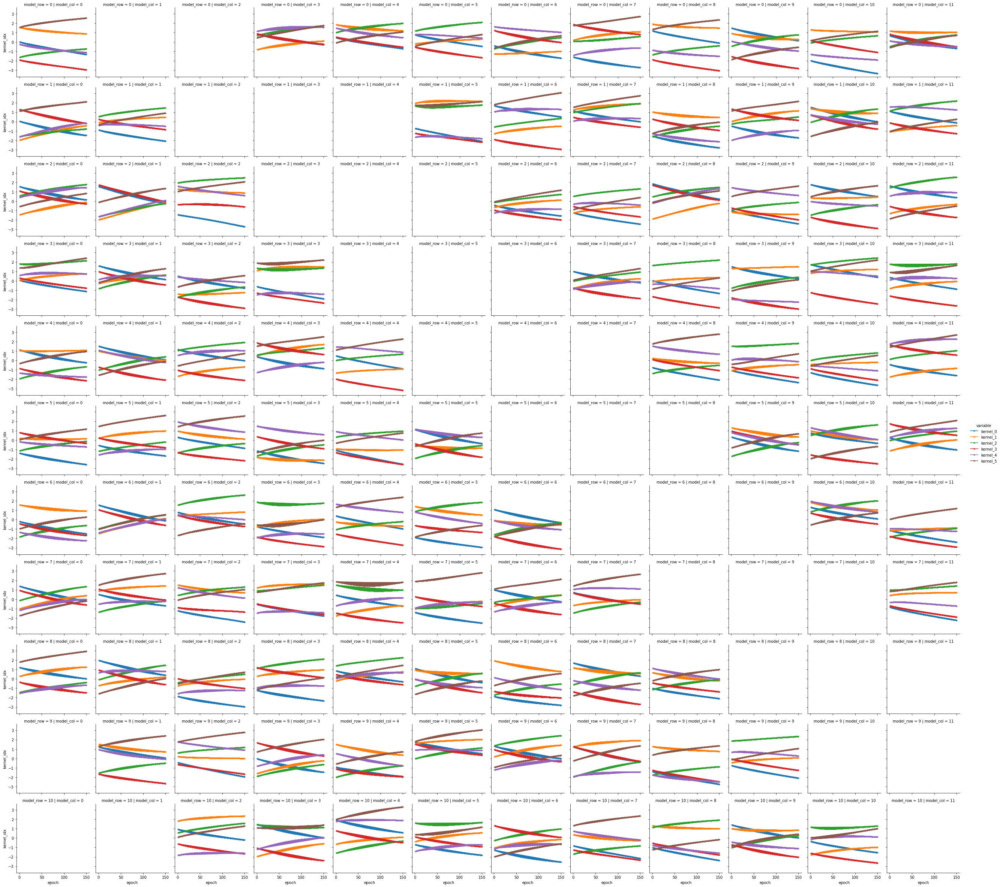

In [95]:
g=sns.FacetGrid(data2,col='model_col',row='model_row',hue='variable')
g=(g.map(plt.plot,'epoch','kernel_idx',marker='.').add_legend())

In [110]:
# X=data.loc[data['epoch']==1,['kernel_0', 'kernel_1', 'kernel_2', 'kernel_3', 'kernel_4','kernel_5']].to_numpy()
# Y=data.loc[data['epoch']==150,['kernel_0', 'kernel_1', 'kernel_2', 'kernel_3', 'kernel_4','kernel_5']].to_numpy()

X=data.loc[data['epoch']==1,['kernel_1',  'kernel_4']].to_numpy()
Y=data.loc[data['epoch']==150,[ 'kernel_1', 'kernel_4']].to_numpy()

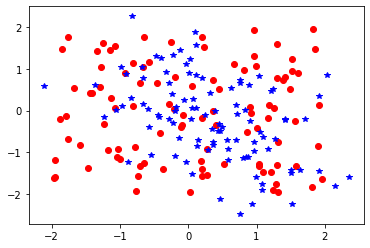

In [111]:

# Plot data
plt.plot(X[:,0], X[:,1], 'ro', Y[:,0], Y[:,1], 'b*');

In [132]:
X=X[0:196,:]

# Train a GP with the data above
gp = GP(X, Y)

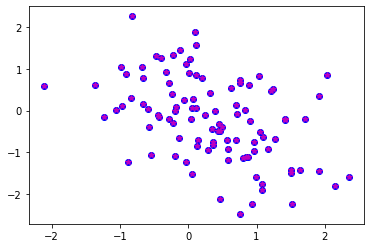

In [133]:
Z=gp.predict(X.reshape(-1,2))

# Plot data
plt.plot(Y[:,0], Y[:,1], 'bo', Z[:,0], Z[:,1], 'm*');


In [134]:
print("Dim 0 stats : min mean median max")
print([np.min(abs(Y[:,0]-Z[:,0])),np.mean(abs(Y[:,0]-Z[:,0])),np.median(abs(Y[:,0]-Z[:,0])),np.max(abs(Y[:,0]-Z[:,0]))])
print("Dim 1 stats : min mean median max")
print([np.min(abs(Y[:,1]-Z[:,1])),np.mean(abs(Y[:,1]-Z[:,1])),np.median(abs(Y[:,1]-Z[:,1])),np.max(abs(Y[:,1]-Z[:,1]))])

Dim 0 stats : min mean median max
[4.508877172668124e-08, 7.14592030092033e-06, 6.422177254550299e-06, 2.3472516534450705e-05]
Dim 1 stats : min mean median max
[7.435704406019705e-08, 8.20785605944347e-06, 7.142117666392167e-06, 2.4787161835959637e-05]


# Use the map F above to compute the Morse graph

In [135]:
# Methods to compute the map F

# Returns corner points of a rectangle
def CornerPoints(rect):
    dim = int(len(rect) / 2)
    # Get list of intervals
    list_intvals = [[rect[d], rect[d + dim]] for d in range(dim)]
    # Get points in the cartesian product of intervals
    X = [list(u) for u in itertools.product(*list_intvals)]
    return X

# Returns center point of a rectangle
def CenterPoint(rect):
    dim = int(len(rect) / 2)
    x_center = [(rect[d] + rect[dim + d]) / 2 for d in range(dim)]
    return [x_center]

# Return sample points in rectangle
def SamplePoints(lower_bounds, upper_bounds, num_pts):
    # Sample num_pts in dimension dim, where each
    # component of the sampled points are in the
    # ranges given by lower_bounds and upper_bounds
    dim = len(lower_bounds)
    X = np.random.uniform(lower_bounds, upper_bounds, size=(num_pts,dim))
    return list(X)

# Map that takes a rectangle and returns a rectangle
def BoxMap(f, rect, mode='corners', padding=False, num_pts=10):
    dim = int(len(rect) / 2)
    if mode == 'corners': # Compute at corner points
        X = CornerPoints(rect)
    elif mode == 'center': # Compute at center point
        padding = True # Must be true for this case
        X = CenterPoint(rect)
    elif mode == 'random': # Compute at random point
        # Get lower and upper bounds
        lower_bounds = rect[:dim]
        upper_nounds = rect[dim:]
        X = SamplePoints(lower_bounds, upper_bounds, num_pts)
    else: # Unknown mode
        return []
    # Evaluate f at point in X
    #print(X)
    Y = [f(x) for x in X]
#     print(Y)
    # Get lower and upper bounds of Y
    Y_l_bounds = [min([y[d] for y in Y]) - ((rect[d + dim] - rect[d]) if padding else 0) for d in range(dim)]
    Y_u_bounds = [max([y[d] for y in Y]) + ((rect[d + dim] - rect[d]) if padding else 0) for d in range(dim)]
    f_rect = Y_l_bounds + Y_u_bounds
    return f_rect

In [117]:
from sklearn.ensemble import RandomForestRegressor

# Define an RF model
def RF(X_train, Y_train):
    rf_list=[]
    for y_ax in range(Y_train.shape[1]):
        RF = RandomForestRegressor(criterion='mae')
        RF.fit(X_train,Y_train[:,y_ax])
        rf_list.append(RF)
    return rf_list

In [136]:
# Use the GP to define a map F
# Notice that the GP takes lists as
# input and output, so we need to
# add the [] below
#def F(X):
#    return gp.predict([X])[0]

def f(X):
    return gp.predict([X])[0]

def f_rf(X):
    return [rf.predict([X]) for rf in rfs]

# Define box map for f
def F(rect):
    return BoxMap(f, rect, padding=True)

In [137]:
rfs = RF(X,Y)

In [82]:
data.columns

Index(['Unnamed: 0', 'model_id', 'epoch', 'val_loss', 'bias_0', 'bias_1',
       'bias_2', 'kernel_0', 'kernel_1', 'kernel_2', 'kernel_3', 'kernel_4',
       'kernel_5'],
      dtype='object')

In [138]:
# Define the parameters for CMGDB
# lower_bounds = [data[x].min()-0.5 for x in data.columns if 'kernel' in x]
# upper_bounds = [data[x].max()+0.5 for x in data.columns if 'kernel' in x]
lower_bounds = [data[x].min()-0.05 for x in ['kernel_1','kernel_4']]
upper_bounds = [data[x].max()+0.05 for x in ['kernel_1','kernel_4']]
phase_subdiv = 20

morse_fname = 'morse_sets.csv'

In [139]:
lower_bounds,upper_bounds
#print(len(X))
#print(len(Y))
#X
#Y

([-2.2510869979858397, -2.5287161350250242],
 [2.3972516536712645, 2.3585203170776365])

In [140]:
%%time
model = CMGDB.Model(phase_subdiv, lower_bounds, upper_bounds, F)
morse_graph, map_graph = CMGDB.ComputeMorseGraph(model)

CPU times: user 13min 52s, sys: 3.86 s, total: 13min 55s
Wall time: 13min 55s


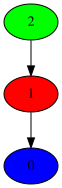

In [154]:
# Plot Morse graph
CMGDB.PlotMorseGraph(morse_graph)

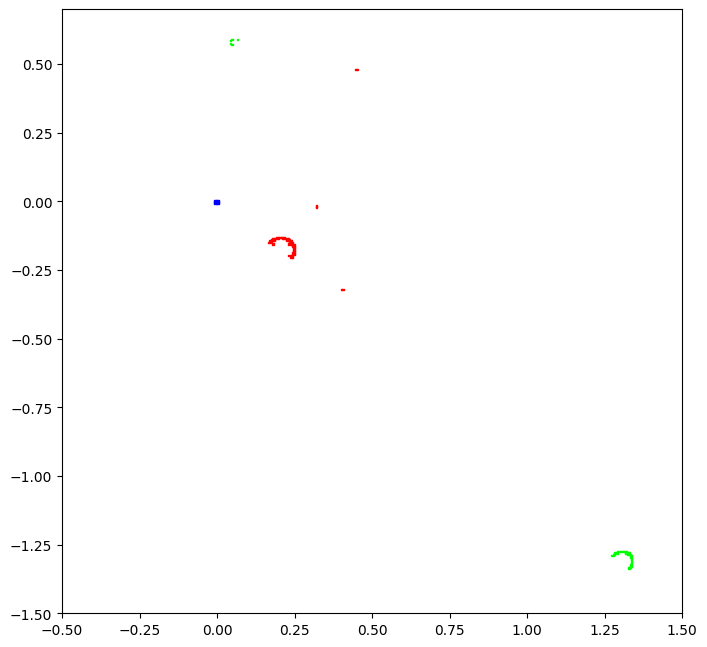

In [155]:
# Plot Morse sets
#CMGDB.PlotMorseSets(morse_fname,proj_dims=[0,1])
# Plot Morse sets
CMGDB.PlotMorseSets(morse_graph, xlim=[-.5, 1.5], ylim=[-1.5, .7])

<b><h1>Compute Retraction</h1></b>

In [143]:
%%time
# Save MVMap to file for CMGDB_Retract
with open('CMGDB_mvmap.txt','w') as outfile:
    outfile.write('%d\n' % map_graph.num_vertices())
    for k in range(0,map_graph.num_vertices()):
        l=len(map_graph.adjacencies(k))
        outfile.write('%d ' % k)
        outfile.write('%d ' % l)
        for item in map_graph.adjacencies(k):
            outfile.write('%d ' % item)
        outfile.write('\n')

CPU times: user 15min 10s, sys: 4.49 s, total: 15min 15s
Wall time: 15min 17s


In [144]:
%%time
# Compute order retraction
!./CMGDB_RETRACT
!rm RETRACT_LOG.txt

Loading boxes and images from CMGDB.... Thu Nov 19 11:37:45 2020

Loading 1048576 boxes...
Loading mvmap on 1048576 boxes...
Number of BOXES = 1048576
--------------------------------

Computing recurrence ...Thu Nov 19 11:38:37 2020

Number of recurrent components = 3 :: 41 + 57 + 9 = 107

--------------------------------

Creating poset....Thu Nov 19 11:38:50 2020

Computing P-relations....Thu Nov 19 11:39:28 2020

Writing Hasse.dot ...Thu Nov 19 11:39:36 2020

RC size 3 : 3
H 0 -> 1 
H 1 -> 2 
H 2 -> 
Computing initial candidates....Thu Nov 19 11:39:36 2020

RC : succ : pred : parallel : empty == 3 : 1048469 : 0 : 0 : 0

Trimming candidates....Thu Nov 19 11:39:36 2020

empty candidiates list after trimming 0

Order retraction exists? : 1
Computing retraction....Thu Nov 19 11:39:50 2020

Writing tiles....Thu Nov 19 11:39:50 2020

noretract_count: 0

FINISHED! Thu Nov 19 11:39:55 2020


CPU times: user 1.38 s, sys: 364 ms, total: 1.75 s
Wall time: 2min 10s


In [145]:
# Load retraction from file
with open('CMGDB_retract.txt','r') as infile:
    retract_indices=[]
    retract_tiles=[]
    for i in range(0,map_graph.num_vertices()): 
        index, tile = [int(x) for x in next(infile).split()]
        retract_indices.append(index)
        retract_tiles.append(tile)

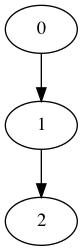

In [146]:
# Display Hasse diagram using Graphviz to compare to Morse graph
# The index labels of the Morse sets may have changed!! 
!dot -Tpng Hasse.dot -o Hasse.png 
Image("Hasse.png")

In [147]:
morse_graph.phase_space_box(0)

[-2.2510869979858397,
 -2.5287161350250242,
 -2.2465476047713304,
 -2.5239434431772674]

CPU times: user 2min 53s, sys: 729 ms, total: 2min 54s
Wall time: 2min 53s


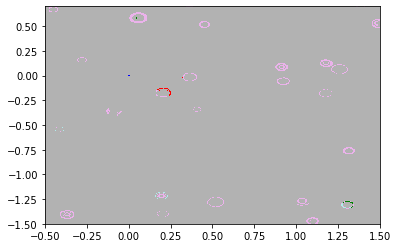

In [153]:
%%time
# Plot order retraction: you may need to change the colors to match CMGDB output
bx=morse_graph.phase_space_box(0)
bx_width=bx[2]-bx[0];
bx_height=bx[3]-bx[1];
#print(bx_width);
#print(bx_height);
fig, ax=plt.subplots();
#ax.set(xlim=(lower_bounds[0],upper_bounds[0]),ylim=(lower_bounds[1],upper_bounds[1]));
ax.set(xlim=[-.5, 1.5], ylim=[-1.5, .7]);
boxes_array=[]
for j in range(0,morse_graph.num_vertices()):
    boxes_array.append([])
for i in range(0,map_graph.num_vertices()): 
    for j in range(0,morse_graph.num_vertices()):
        if retract_tiles[i]==j:
            bx=morse_graph.phase_space_box(retract_indices[i])
            rect=Rectangle(((bx[2]+bx[0])/2,(bx[3]+bx[1])/2),bx_width,bx_height);
            boxes_array[j].append(rect)
for j in range(0,morse_graph.num_vertices()):
    #print(len(boxes_array[j]))
    if j==0:
        #color='b'
        color='c' # I changed the color because the alpha wan't working for some strange reason
    if j==1:
        color='m'
    if j==2:
        color='k'
    if j==3:
        color='g'
    if j==4:
        color='k'
    if j==5:
        color='k'    
    if j==6:
        color='k'
    if j==7:
        color='k'
    if j==8:
        color='k'        
    pc=PatchCollection(boxes_array[j],facecolor=color,alpha=0.3,edgecolor='none') 
    ax.add_collection(pc)

for j in range(0,morse_graph.num_vertices()):
    #print(len(morse_graph.morse_set(j)))
    boxes=[]
    for index in morse_graph.morse_set(j):
        bx=morse_graph.phase_space_box(index)
        rect=Rectangle(((bx[2]+bx[0])/2,(bx[3]+bx[1])/2),bx_width,bx_height);
        boxes.append(rect)
    if j==0:
        color='b'
    if j==1:
        color='r'
    if j==2:
        color='g'
    if j==3:
        color='g'
    if j==4:
        color='k'
    if j==5:
        color='k'    
    if j==6:
        color='k'
    if j==7:
        color='k'
    if j==8:
        color='k'        
    pc2=PatchCollection(boxes,facecolor=color,alpha=1.0,edgecolor='none')        
    ax.add_collection(pc2)         